# Import library and Dataset

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
! pip install kaggle

In [ ]:
! mkdir ~/.kaggle

In [ ]:
#! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
import json
import zipfile
import os
from pathlib import Path
api_token = {"username":"rattapornk","key":"9a9017f57e099d1b52bfccf94afccf30"}
kaggle_path = Path('/root/.kaggle')
os.makedirs(kaggle_path, exist_ok=True)

with open (kaggle_path/'kaggle.json', 'w') as handl:
    json.dump(api_token,handl)

In [ ]:
! kaggle datasets download -d rattapornk/memcat-datacat

100% 255k/255k [00:00<00:00, 813kB/s]
100% 255k/255k [00:00<00:00, 812kB/s]


In [ ]:
! unzip /content/memcat-datacat.zip

Archive:  /content/memcat-datacat.zip
  inflating: animal.csv              
  inflating: food.csv                
  inflating: landscape.csv           
  inflating: sports.csv              
  inflating: vehicle.csv             


In [ ]:
!kaggle datasets download -d rattapornk/memcat-split-csv

100% 66.1k/66.1k [00:00<00:00, 650kB/s]
100% 66.1k/66.1k [00:00<00:00, 648kB/s]


In [ ]:
! unzip /content/memcat-split-csv.zip

Archive:  /content/memcat-split-csv.zip
  inflating: test_animal_new.csv     
  inflating: test_food_new.csv       
  inflating: test_landscape_new.csv  
  inflating: train_animal_new.csv    
  inflating: train_food_new.csv      
  inflating: train_landscape_new.csv  
  inflating: val_animal_new.csv      
  inflating: val_food_new.csv        
  inflating: val_landscape_new.csv   


In [ ]:
! kaggle datasets download -d rattapornk/memcat-cat

100% 1.09G/1.09G [00:41<00:00, 39.5MB/s]
100% 1.09G/1.09G [00:41<00:00, 28.2MB/s]


In [ ]:
! unzip /content/memcat-cat.zip

Streaming output truncated to the last 5000 lines.
  inflating: landscape/n09376198_10845.jpg  
  inflating: landscape/n09376198_10901.jpg  
  inflating: landscape/n09376198_11171.jpg  
  inflating: landscape/n09376198_11360.jpg  
  inflating: landscape/n09376198_12294.jpg  
  inflating: landscape/n09376198_12692.jpg  
  inflating: landscape/n09376198_13588.jpg  
  inflating: landscape/n09376198_13928.jpg  
  inflating: landscape/n09376198_1396.jpg  
  inflating: landscape/n09376198_14485.jpg  
  inflating: landscape/n09376198_14571.jpg  
  inflating: landscape/n09376198_15308.jpg  
  inflating: landscape/n09376198_15319.jpg  
  inflating: landscape/n09376198_15467.jpg  
  inflating: landscape/n09376198_15858.jpg  
  inflating: landscape/n09376198_16065.jpg  
  inflating: landscape/n09376198_16253.jpg  
  inflating: landscape/n09376198_16513.jpg  
  inflating: landscape/n09376198_16757.jpg  
  inflating: landscape/n09376198_17428.jpg  
  inflating: landscape/n09376198_178.jpg  
  infla

In [ ]:
!pip install einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 2.1 MB/s eta 0:00:00


In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import os
import cv2

import numpy as np
from torch import nn
from torch import Tensor
from PIL import Image
from torchvision import transforms
import torchvision
from einops import rearrange, reduce, repeat
from einops.layers.torch import Rearrange, Reduce
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
from sklearn.utils import shuffle
import torchvision.models as models
import gc
from tqdm import tqdm
import torch.optim as optim
import random
import pandas as pd
from sklearn.utils import shuffle
import time

from transformers import ViTConfig, ViTModel, ViTFeatureExtractor
import tensorflow as tf

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

MessageError: Error: credential propagation was unsuccessful

In [ ]:
!pip install timm

In [ ]:
import timm

In [ ]:
import torch

# Check if GPU is available
if torch.cuda.is_available():
    # Get the CUDA version
    cuda_version = torch.version.cuda
    print(f"CUDA version: {cuda_version}")
else:
    print("CUDA is not available.")


In [ ]:
pip install scipy

In [ ]:
from scipy.stats import spearmanr
from torchsummary import summary
import time

# Preprocess & Split

In [ ]:
df_sports = pd.read_csv("/content/sports.csv")
df_sports["image_file"] =df_sports["image_file"].apply(lambda file: "/content/sports" +"/"+ file) # Create image path
df_sports["memorability_wo_fa_correction"] = df_sports["memorability_wo_fa_correction"].values.astype(np.float32)

In [ ]:
df_sports.head()

In [ ]:
import pandas as pd
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

# Sample data (replace this with your DataFrame)
df_sports = pd.DataFrame({
    'image_file': df_sports["image_file"],
    'memoscore': df_sports["memorability_wo_fa_correction"]
})

# Create a new column to store the paths of preprocessed images
df_sports['preprocessed_image_path'] = ''

# Empty lists to store preprocessed images
images = []

# Padding parameters
padding_size = 10  # You can adjust this value as needed

# Load and preprocess images
for index, row in df_sports.iterrows():
    image_path = row['image_file']
    image = cv2.imread(image_path)

    if image is None:
        print(f"Error reading image: {image_path}")
        continue

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, (224, 224))  # Resize image if necessary

    # Add padding to the image
    #image = np.pad(image, ((padding_size, padding_size), (padding_size, padding_size), (0, 0)), mode='constant', constant_values=0)

    # Save preprocessed image to the same path
    preprocessed_path = os.path.splitext(image_path)[0] + '_preprocessed.jpg'
    cv2.imwrite(preprocessed_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))

    # Store preprocessed image path in the DataFrame
    df_sports.at[index, 'preprocessed_image_path'] = preprocessed_path

    images.append(image)

# Convert the list of images into a NumPy array
images = np.array(images)

# Save preprocessed images as NumPy array (if needed)
# np.save('/content/drive/MyDrive/your_folder/preprocessed_images.npy', images)

# Calculate basic image statistics
print('Image shape:', images.shape)
print('Minimum pixel value:', np.min(images))
print('Maximum pixel value:', np.max(images))
print('Mean pixel value:', np.mean(images))
print('Standard deviation of pixel values:', np.std(images))

# Visualize sample images
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
axes = axes.flatten()
for i in range(min(10, len(images))):
    axes[i].imshow(images[i])
    axes[i].axis('off')
    axes[i].set_title(os.path.basename(df_sports.at[i, 'preprocessed_image_path']))  # Display file name as title
plt.tight_layout()
plt.show()




In [ ]:
df_sports.head()

In [ ]:
del df_sports["image_file"]

In [ ]:
df_sports.head()

In [ ]:
from sklearn.model_selection import train_test_split

# Split the DataFrame into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(pd.DataFrame(df_sports.drop('memoscore', axis=1)), pd.DataFrame(df_sports['memoscore']), test_size=0.1)

# Split the validation set into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_val, y_val, test_size=0.5)

# Print the train, validation, and test set sizes
print('Train set size:', len(X_train))
print('Validation set size:', len(X_val))
print('Test set size:', len(X_test))

In [ ]:
X_train.head()

In [ ]:
merged_train_sports= pd.concat([X_train, y_train], axis=1)
merged_train_sports

In [ ]:
merged_val_sports = pd.concat([X_val, y_val], axis=1)
merged_val_sports

In [ ]:
merged_test_sports = pd.concat([X_test, y_test], axis=1)
merged_test_sports

# Save CSV To GGDrive

In [ ]:
# บันทึกตารางเป็นไฟล์ CSV
csv_train_sports = '/content/drive/MyDrive/IS/MemCat_data/dataproject/train/sports_Vit.csv'
merged_train_sports.to_csv(csv_train_sports, index=False)

In [ ]:
csv_val_sports = '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/sports_Vit.csv'
merged_val_sports.to_csv(csv_val_sports, index=False)

In [ ]:
csv_test_sports = '/content/drive/MyDrive/IS/MemCat_data/dataproject/test/sports_Vit.csv'
merged_test_sports.to_csv(csv_test_sports, index=False)

#Load Dataset

In [ ]:
df_train_sports = pd.read_csv("/content/drive/MyDrive/IS/MemCat_data/dataproject/train/sports_Vit.csv")
df_val_sports = pd.read_csv( '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/sports_Vit.csv')
df_test_sports = pd.read_csv('/content/drive/MyDrive/IS/MemCat_data/dataproject/test/sports_Vit.csv')

In [ ]:
df_train_sports.head()

In [ ]:
df_train_sports.info()

#Load Pretrain

In [ ]:
# Define function to add data/model in to GPU (cuda)
def get_default_device():
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
def to_device(data, device):
    # if data is list or tuple, move each of them to device
    if isinstance(data, (list, tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    def __init__(self, dl, device) -> None:
        self.dl = dl
        self.device = device

    def __iter__(self):
        for b in self.dl:
            # yield only execuate when the function is called
            yield to_device(b, self. device)

    def __len__(self):
        return len(self.dl)

## Train

In [ ]:
class Dataset_sport(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_train_sports["memoscore"]
        self.images = df_train_sports["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
train_ds = Dataset_sport(df_train_sports, trans_transform=trans_transform)
train_dl = DataLoader(train_ds, batch_size=32, shuffle=False)

# เรียกดูข้อมูลจาก DataLoader
'''for image_trans, label in train_dl:
    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch
    print(image_trans)
    break'''


In [ ]:
class ViTMem_model_sport(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))


    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit =  ViTMem_model_sport( arch="vit_base_patch16_224_miil")



In [ ]:
# Assuming your model is an instance of YourModelClass and is already on GPU
model = ViTMem_model_sport().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)




In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model_vit  = to_device(model_vit  , device)

In [ ]:
params = [param for param in list(model_vit.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)


In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/50) Loss = 0.005200375337153673

 Epoch: (1/50) Loss_rmse = 0.07211362570524216

 Epoch: (1/50) R^2 = 0.1756846308708191

 Epoch: (1/50) MAE = 0.0655374825000763
Spearman correlation coefficient: SignificanceResult(statistic=0.2445900367512071, pvalue=8.042035305545265e-26)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.

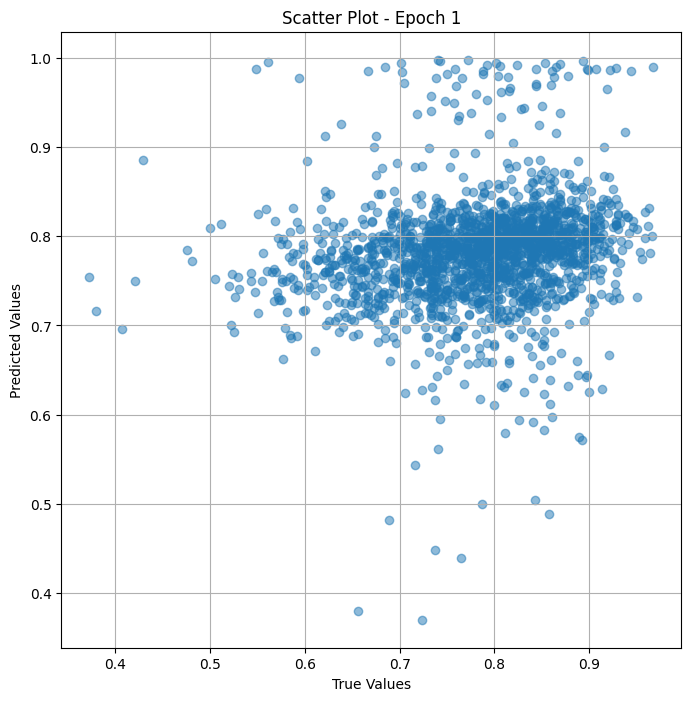

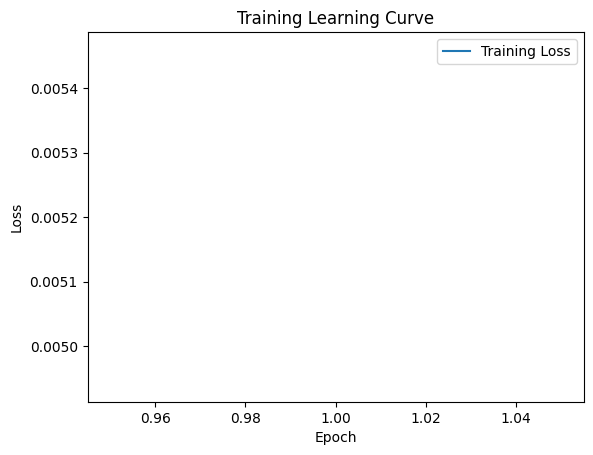


 Epoch: (2/50) Loss = 0.00304397358559072

 Epoch: (2/50) Loss_rmse = 0.05517221614718437

 Epoch: (2/50) R^2 = 0.5174974799156189

 Epoch: (2/50) MAE = 0.047690458595752716
Spearman correlation coefficient: SignificanceResult(statistic=0.48356877329326176, pvalue=1.1396293432413495e-105)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165

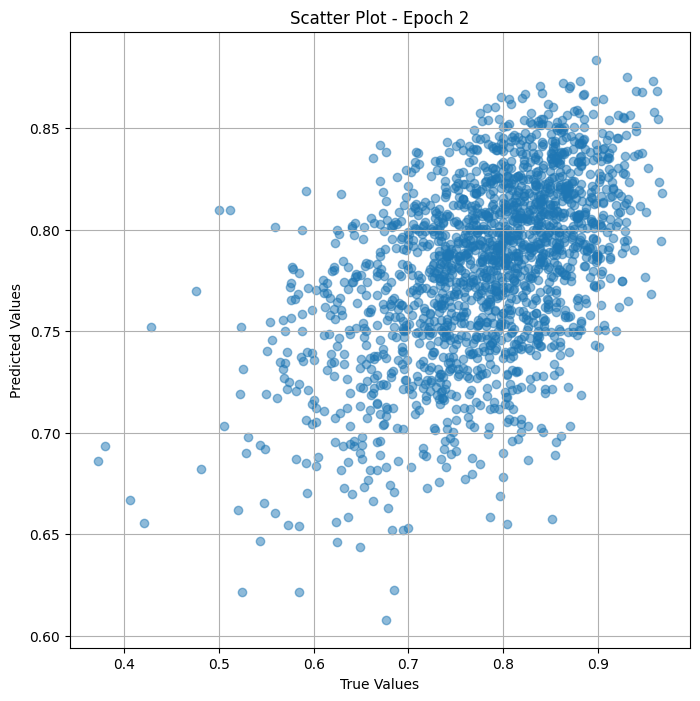

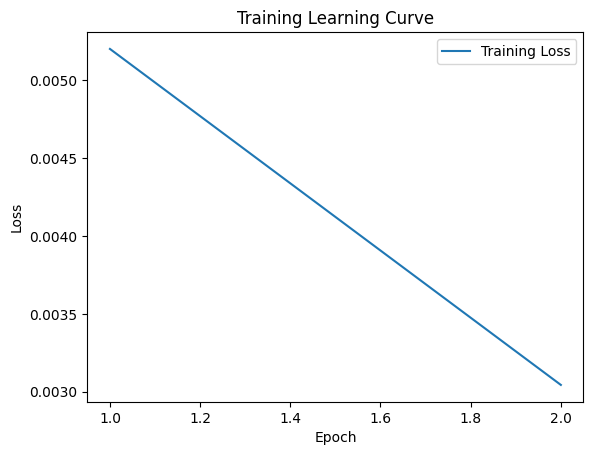


 Epoch: (3/50) Loss = 0.002816366497427225

 Epoch: (3/50) Loss_rmse = 0.053069449961185455

 Epoch: (3/50) R^2 = 0.5535756349563599

 Epoch: (3/50) MAE = 0.04880645126104355
Spearman correlation coefficient: SignificanceResult(statistic=0.6428901332371614, pvalue=1.564065307471585e-209)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165,

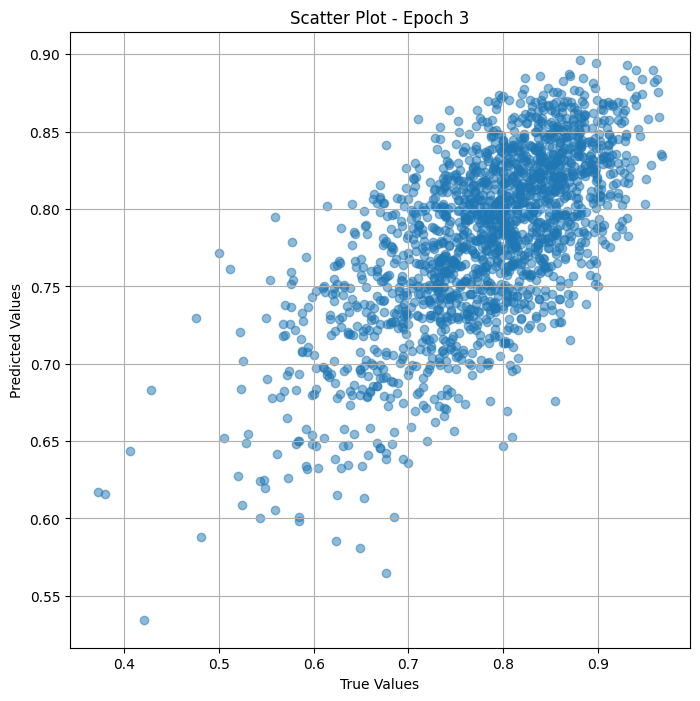

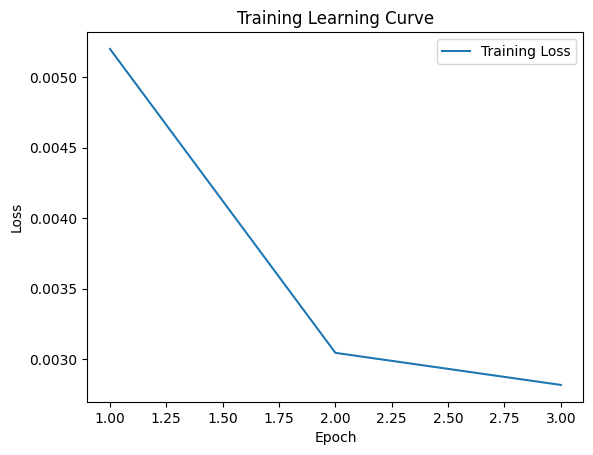


 Epoch: (4/50) Loss = 0.0015362470876425505

 Epoch: (4/50) Loss_rmse = 0.0391949862241745

 Epoch: (4/50) R^2 = 0.7564883232116699

 Epoch: (4/50) MAE = 0.031319282948970795
Spearman correlation coefficient: SignificanceResult(statistic=0.7459612187895694, pvalue=2.564616e-318)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.548076

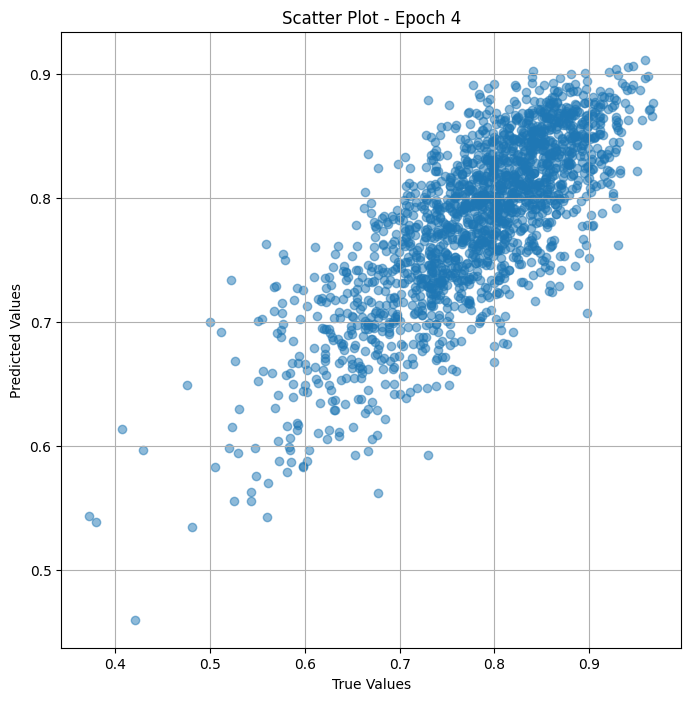

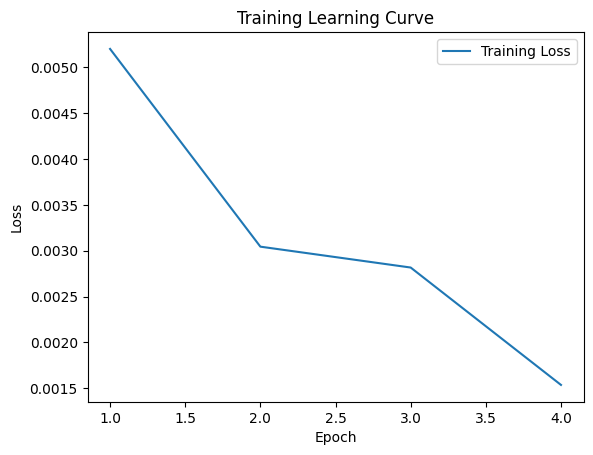


 Epoch: (5/50) Loss = 0.0004867513489443809

 Epoch: (5/50) Loss_rmse = 0.02206244133412838

 Epoch: (5/50) R^2 = 0.922844648361206

 Epoch: (5/50) MAE = 0.017217859625816345
Spearman correlation coefficient: SignificanceResult(statistic=0.7581417716304459, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.80180

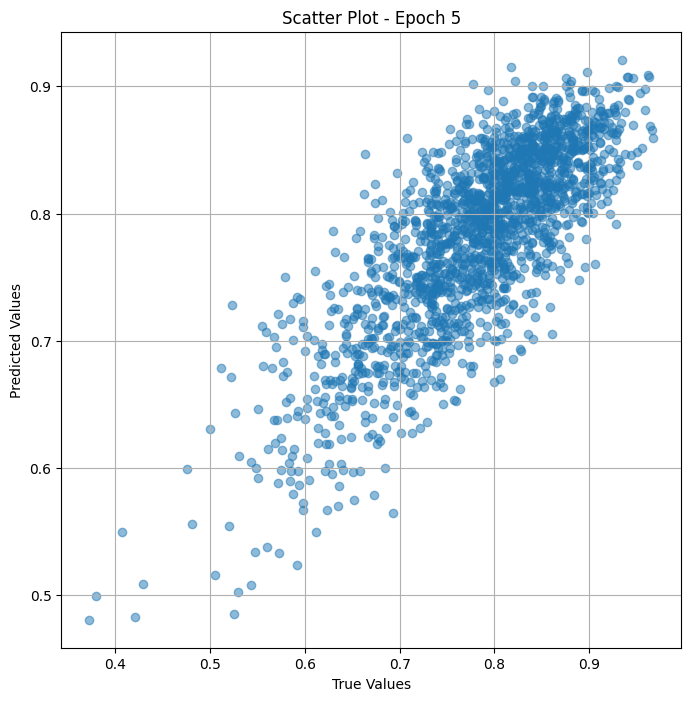

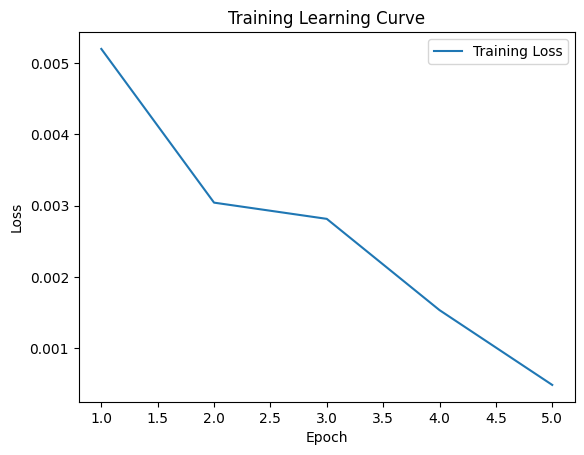


 Epoch: (6/50) Loss = 0.0007950703147798777

 Epoch: (6/50) Loss_rmse = 0.028196990489959717

 Epoch: (6/50) R^2 = 0.8739727735519409

 Epoch: (6/50) MAE = 0.02499290555715561
Spearman correlation coefficient: SignificanceResult(statistic=0.7471895946240452, pvalue=6.2756e-320)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769

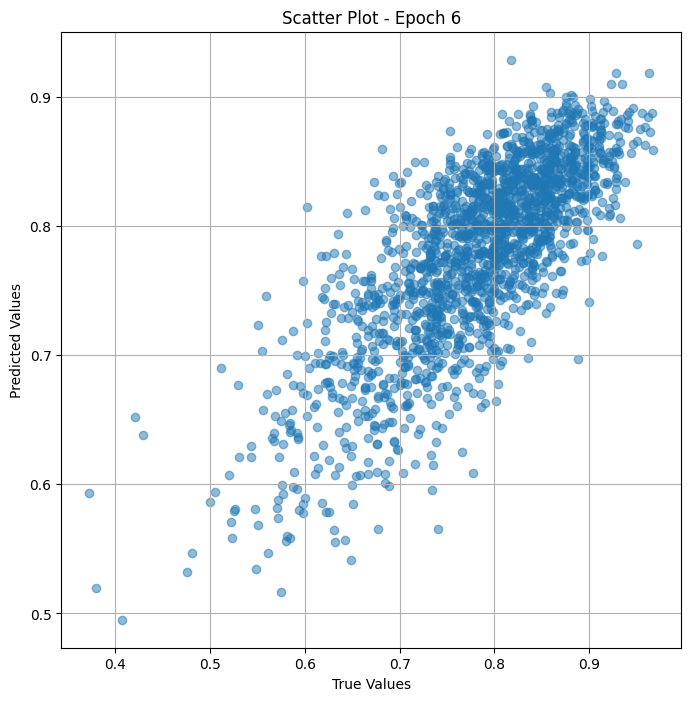

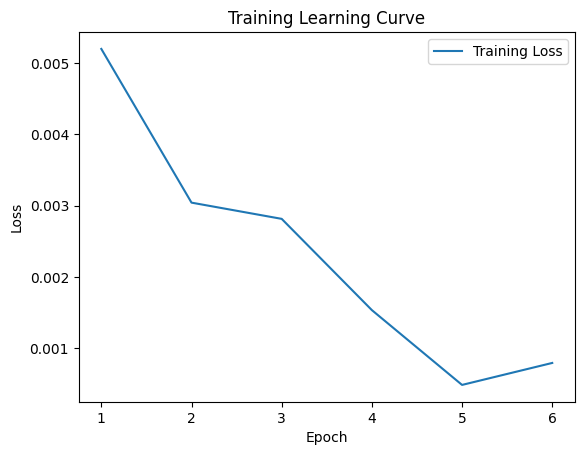


 Epoch: (7/50) Loss = 0.0013680784031748772

 Epoch: (7/50) Loss_rmse = 0.0369875431060791

 Epoch: (7/50) R^2 = 0.7831448316574097

 Epoch: (7/50) MAE = 0.02579103410243988
Spearman correlation coefficient: SignificanceResult(statistic=0.8489103838315077, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.801801

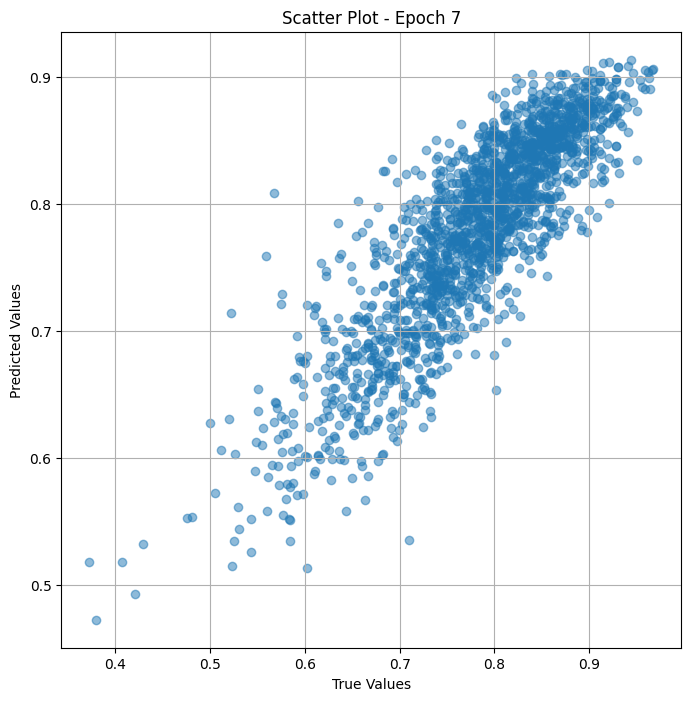

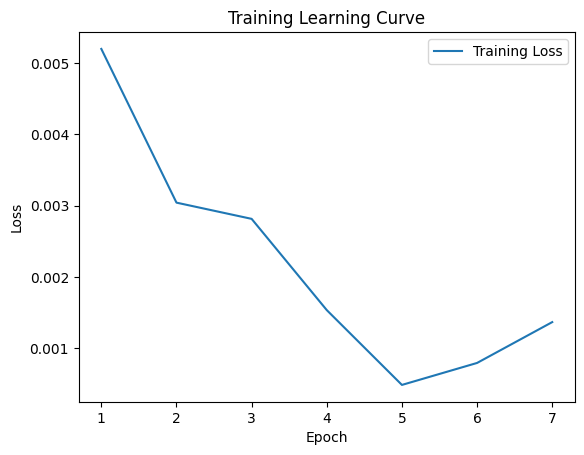

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (8/50) Loss = 0.0005336476606316864

 Epoch: (8/50) Loss_rmse = 0.02310081571340561

 Epoch: (8/50) R^2 = 0.915411114692688

 Epoch: (8/50) MAE = 0.02076912671327591
Spearman correlation coefficient: SignificanceResult(statistic=0.8782947657743665, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.79

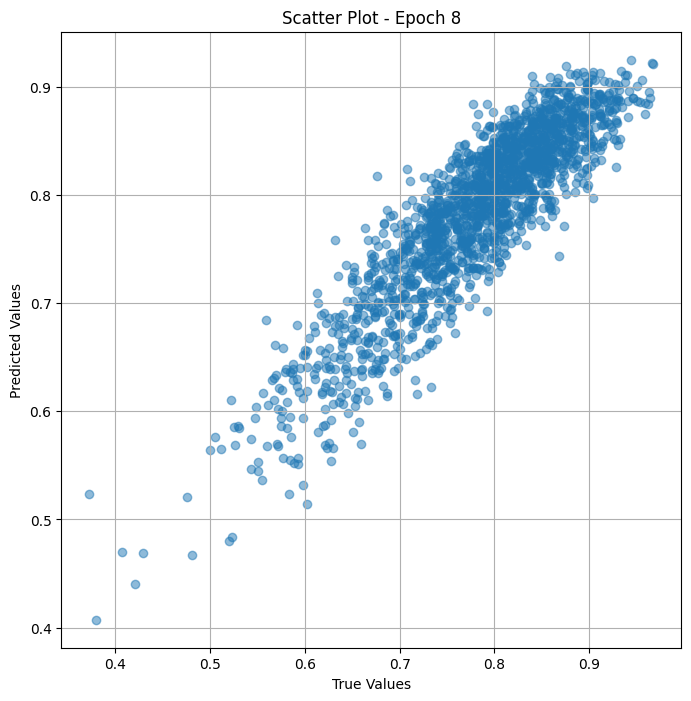

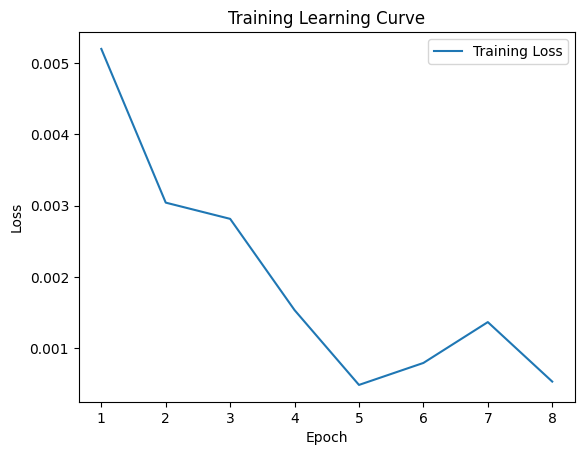


 Epoch: (9/50) Loss = 0.0004290782962925732

 Epoch: (9/50) Loss_rmse = 0.020714204758405685

 Epoch: (9/50) R^2 = 0.9319864511489868

 Epoch: (9/50) MAE = 0.017160721123218536
Spearman correlation coefficient: SignificanceResult(statistic=0.9118009457281481, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.801

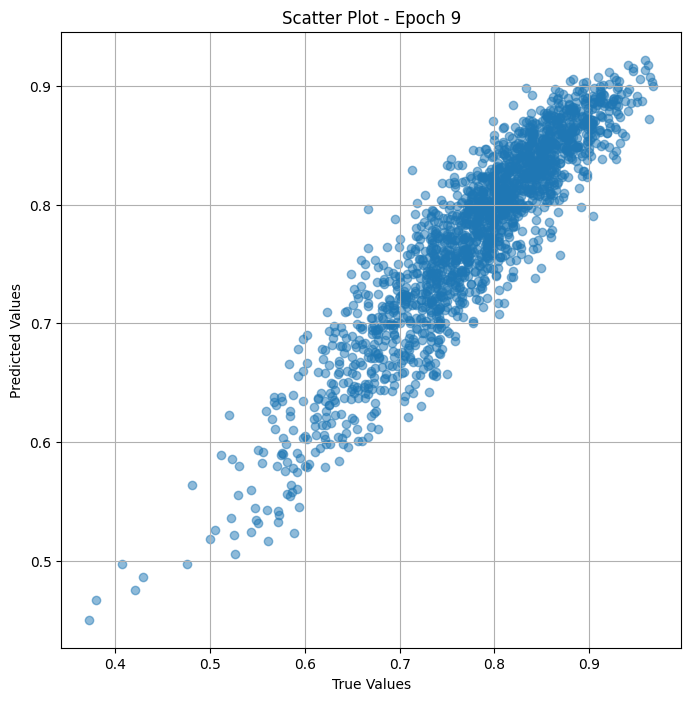

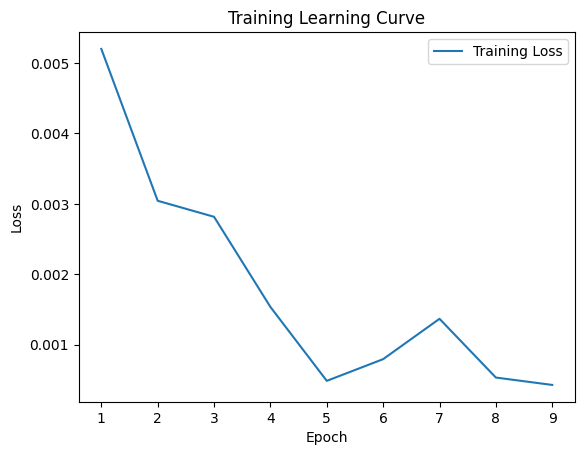


 Epoch: (10/50) Loss = 0.00033015530789270997

 Epoch: (10/50) Loss_rmse = 0.018170176073908806

 Epoch: (10/50) R^2 = 0.9476668238639832

 Epoch: (10/50) MAE = 0.013740763068199158
Spearman correlation coefficient: SignificanceResult(statistic=0.9478346725561897, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 

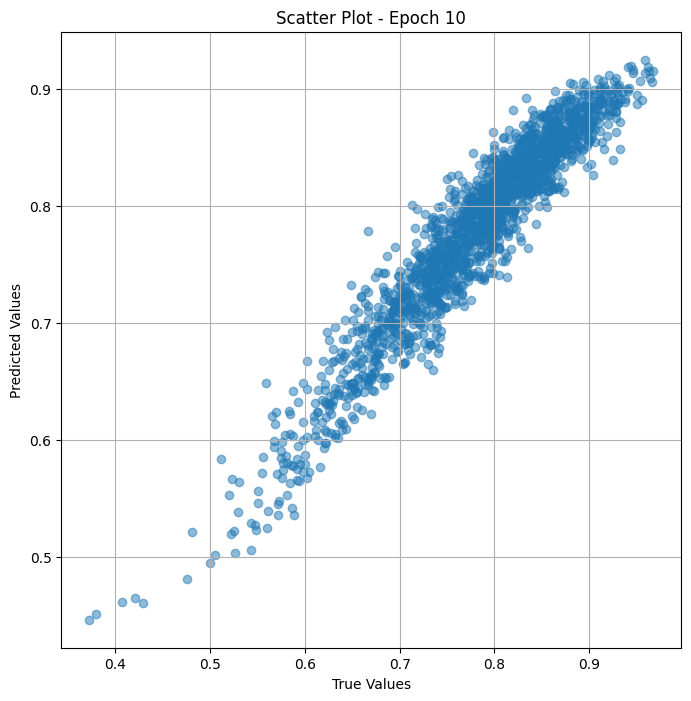

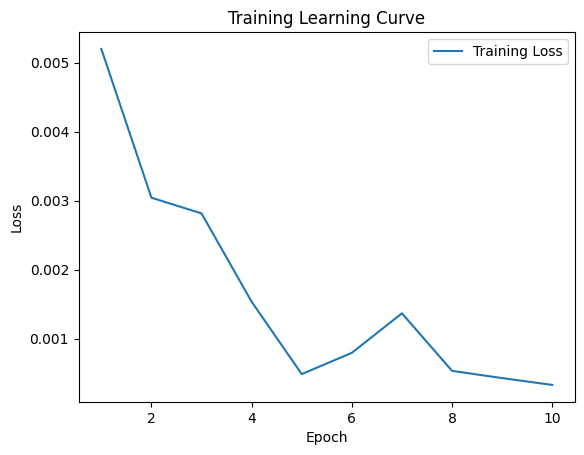


 Epoch: (11/50) Loss = 0.0002727207320276648

 Epoch: (11/50) Loss_rmse = 0.016514258459210396

 Epoch: (11/50) R^2 = 0.9567708373069763

 Epoch: (11/50) MAE = 0.01207973062992096
Spearman correlation coefficient: SignificanceResult(statistic=0.9566485883228896, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.

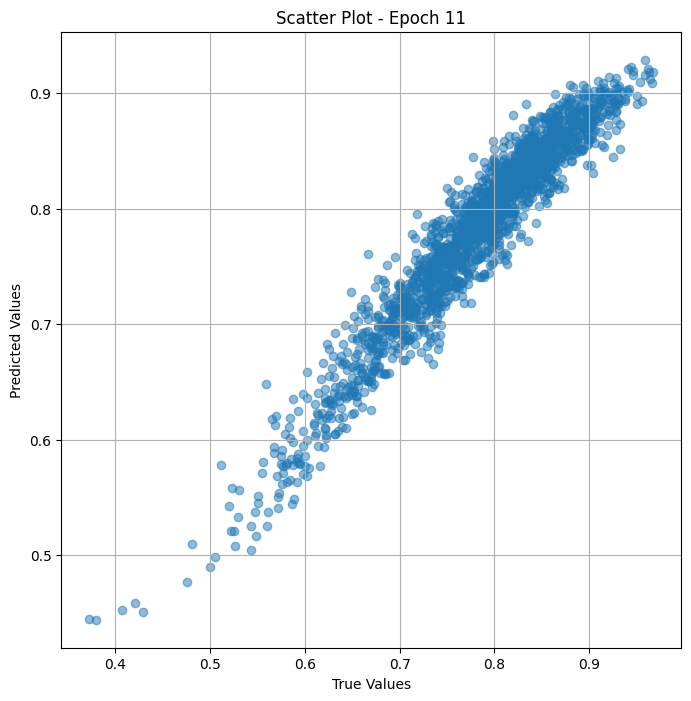

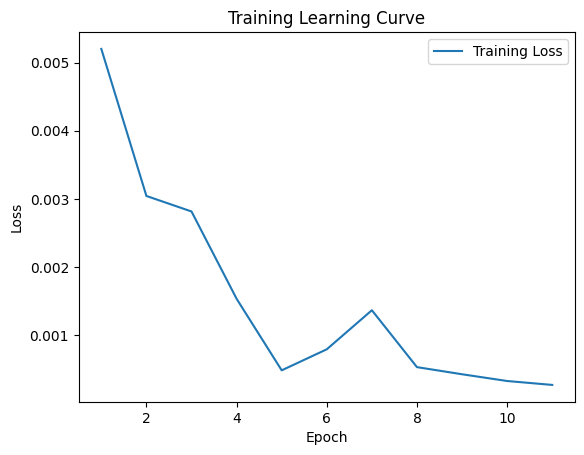


 Epoch: (12/50) Loss = 0.00023046207206789404

 Epoch: (12/50) Loss_rmse = 0.015180977061390877

 Epoch: (12/50) R^2 = 0.9634692668914795

 Epoch: (12/50) MAE = 0.01045585423707962
Spearman correlation coefficient: SignificanceResult(statistic=0.9635990211689724, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0

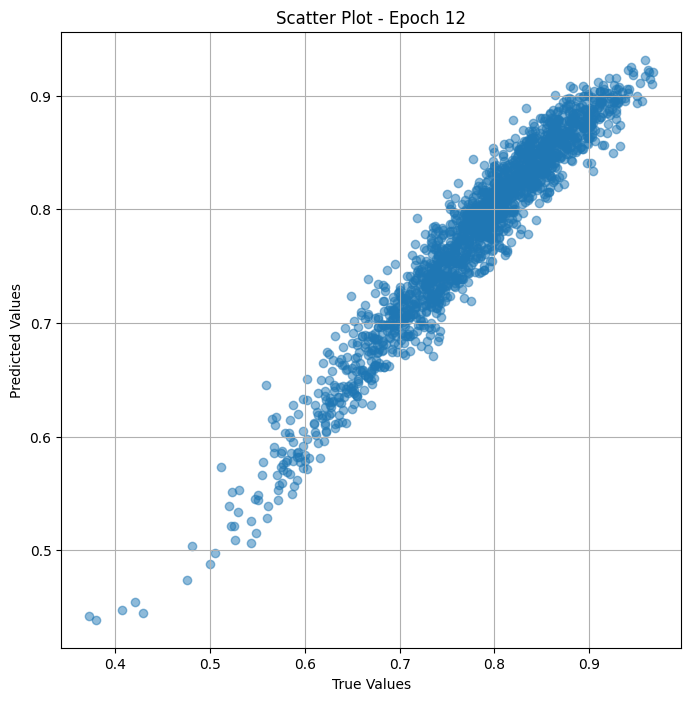

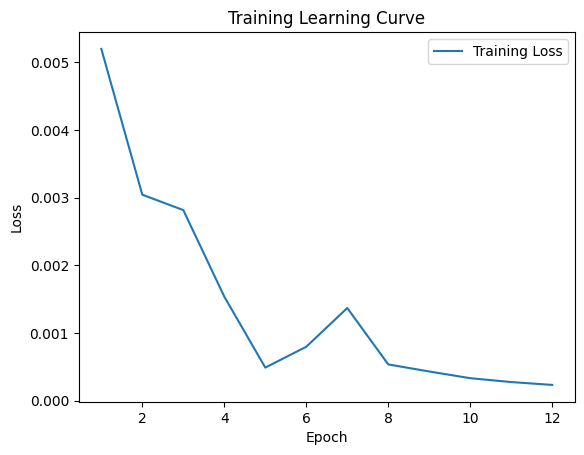


 Epoch: (13/50) Loss = 0.00019737474212888628

 Epoch: (13/50) Loss_rmse = 0.014049012213945389

 Epoch: (13/50) R^2 = 0.9687139987945557

 Epoch: (13/50) MAE = 0.008939467370510101
Spearman correlation coefficient: SignificanceResult(statistic=0.969422951856531, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0

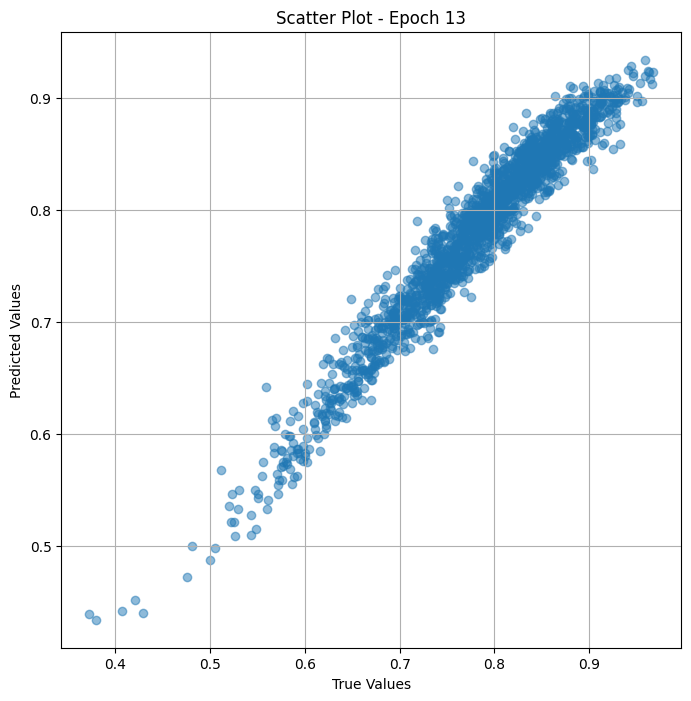

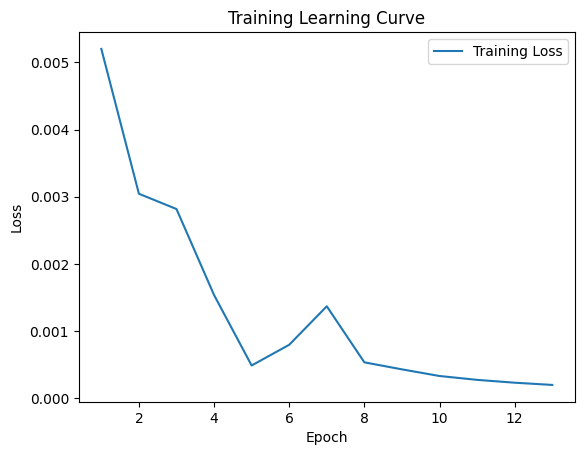


 Epoch: (14/50) Loss = 0.00016845912614371628

 Epoch: (14/50) Loss_rmse = 0.012979180552065372

 Epoch: (14/50) R^2 = 0.9732974171638489

 Epoch: (14/50) MAE = 0.00763547420501709
Spearman correlation coefficient: SignificanceResult(statistic=0.9743436541850105, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0

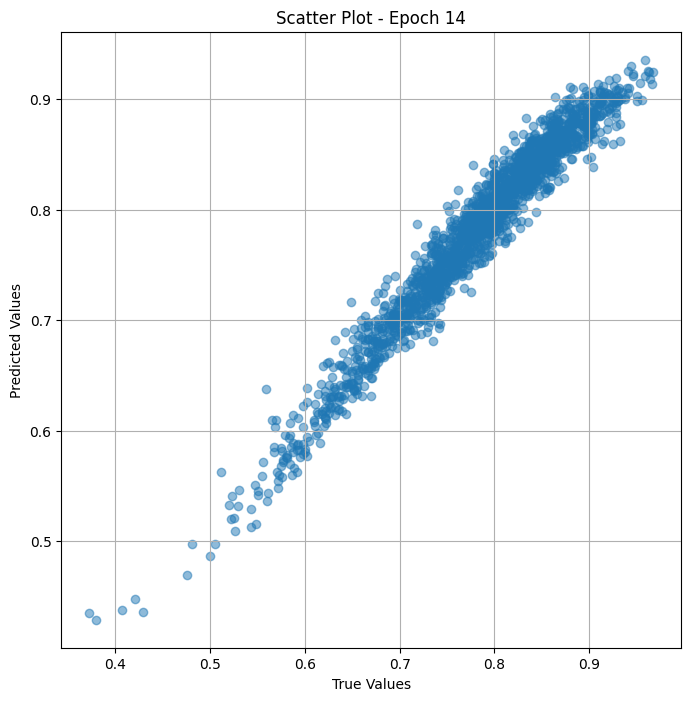

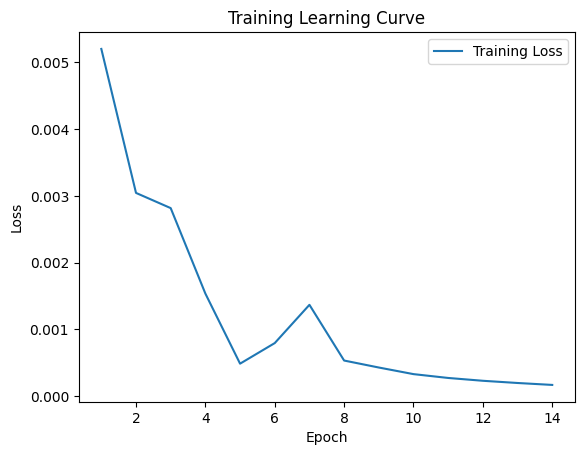


 Epoch: (15/50) Loss = 0.0001428112736903131

 Epoch: (15/50) Loss_rmse = 0.011950367130339146

 Epoch: (15/50) R^2 = 0.977362871170044

 Epoch: (15/50) MAE = 0.006620272994041443
Spearman correlation coefficient: SignificanceResult(statistic=0.9786167518112283, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.

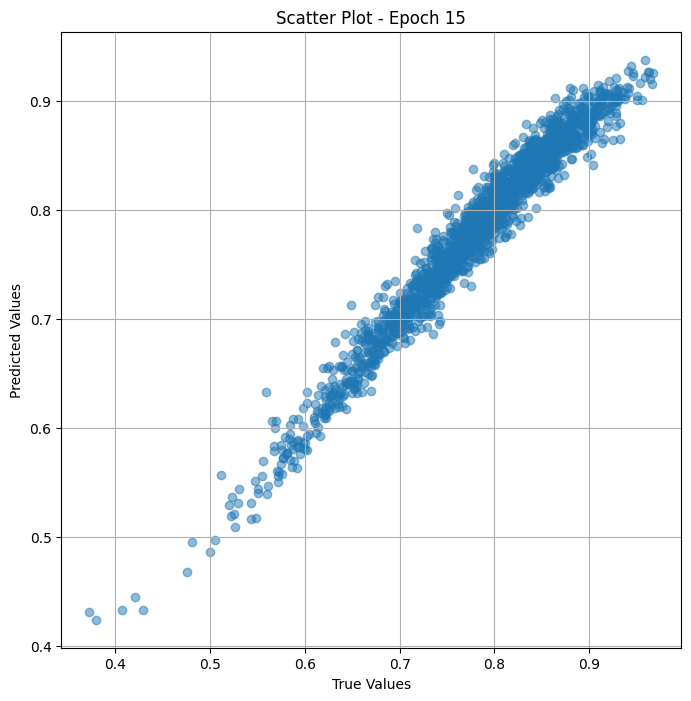

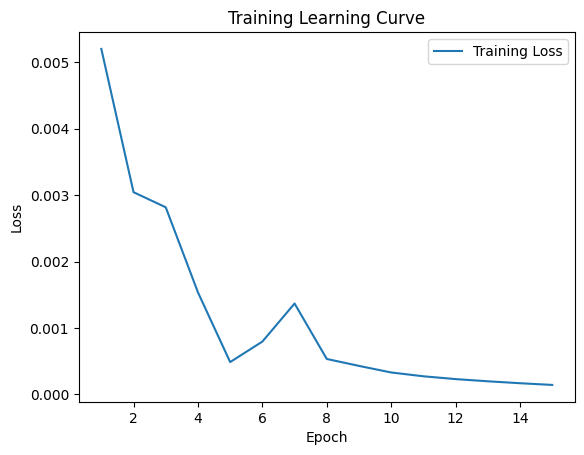


 Epoch: (16/50) Loss = 0.00011996670946246013

 Epoch: (16/50) Loss_rmse = 0.010952931828796864

 Epoch: (16/50) R^2 = 0.9809839725494385

 Epoch: (16/50) MAE = 0.006093740463256836
Spearman correlation coefficient: SignificanceResult(statistic=0.9822474230954581, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 

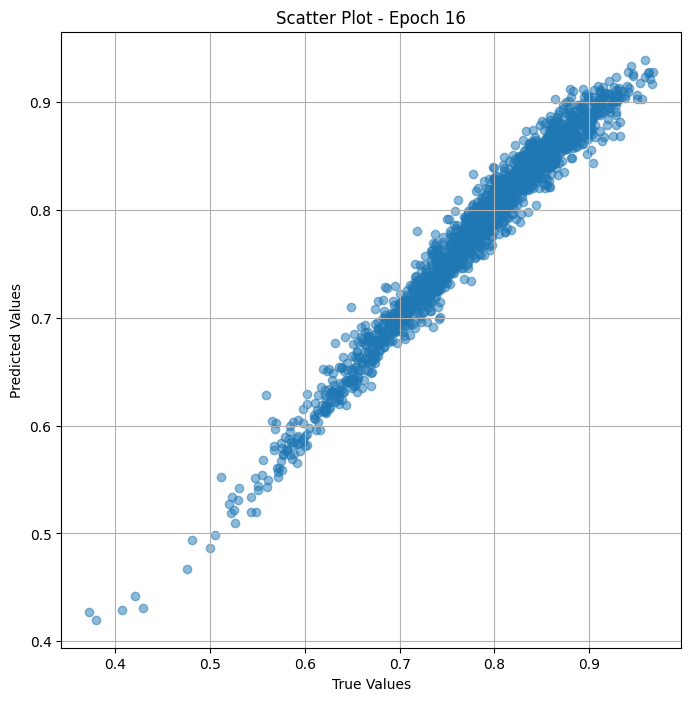

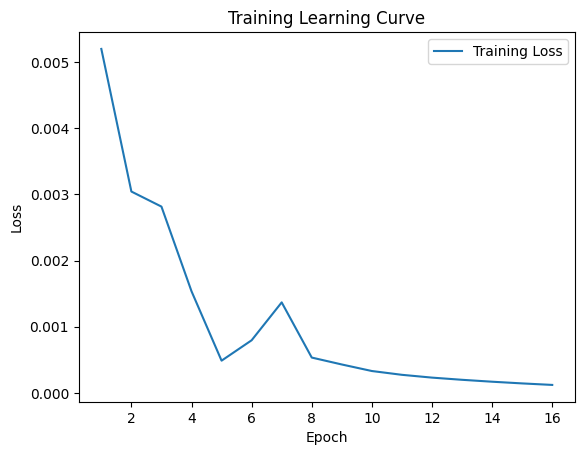


 Epoch: (17/50) Loss = 9.90752741927281e-05

 Epoch: (17/50) Loss_rmse = 0.009953656233847141

 Epoch: (17/50) R^2 = 0.9842954874038696

 Epoch: (17/50) MAE = 0.005581974983215332
Spearman correlation coefficient: SignificanceResult(statistic=0.985327663719863, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.8

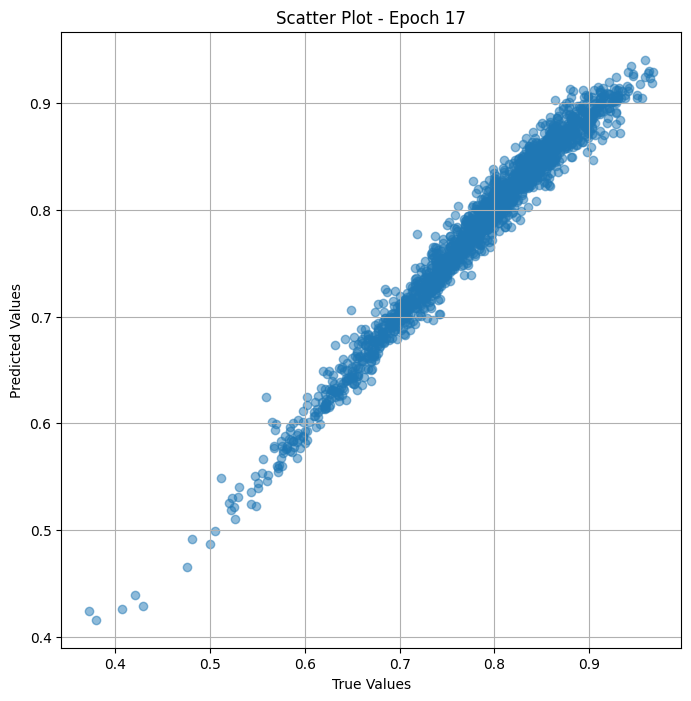

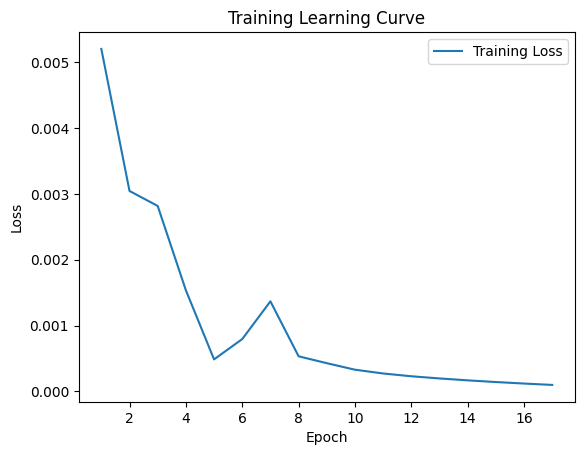


 Epoch: (18/50) Loss = 8.003663242561743e-05

 Epoch: (18/50) Loss_rmse = 0.008946319110691547

 Epoch: (18/50) R^2 = 0.9873133301734924

 Epoch: (18/50) MAE = 0.004996292293071747
Spearman correlation coefficient: SignificanceResult(statistic=0.9879702676757507, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0

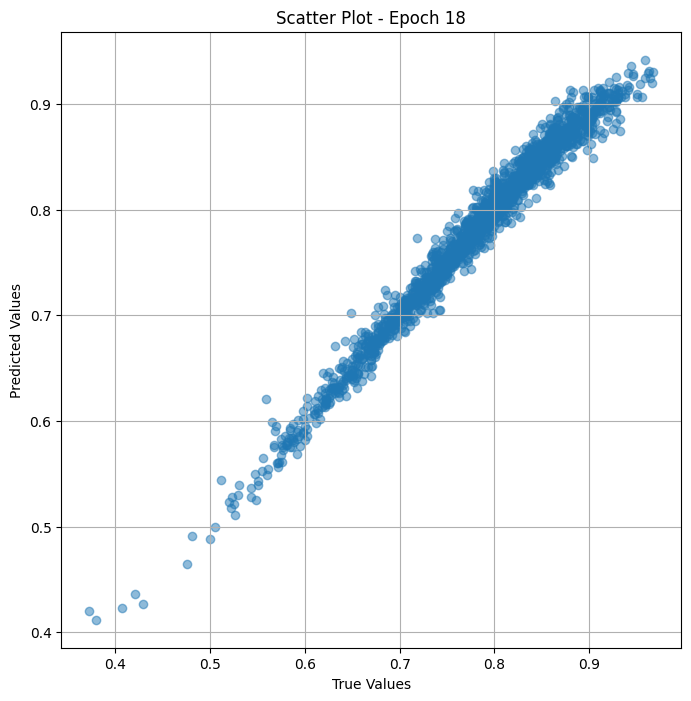

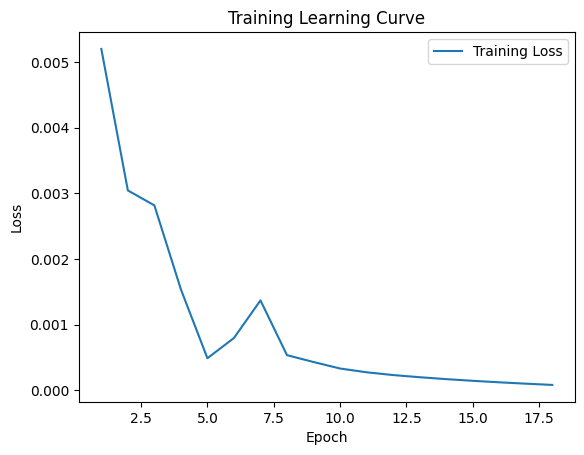


 Epoch: (19/50) Loss = 6.337938975775614e-05

 Epoch: (19/50) Loss_rmse = 0.007961117662489414

 Epoch: (19/50) R^2 = 0.9899536967277527

 Epoch: (19/50) MAE = 0.004382751882076263
Spearman correlation coefficient: SignificanceResult(statistic=0.9901193494404706, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0

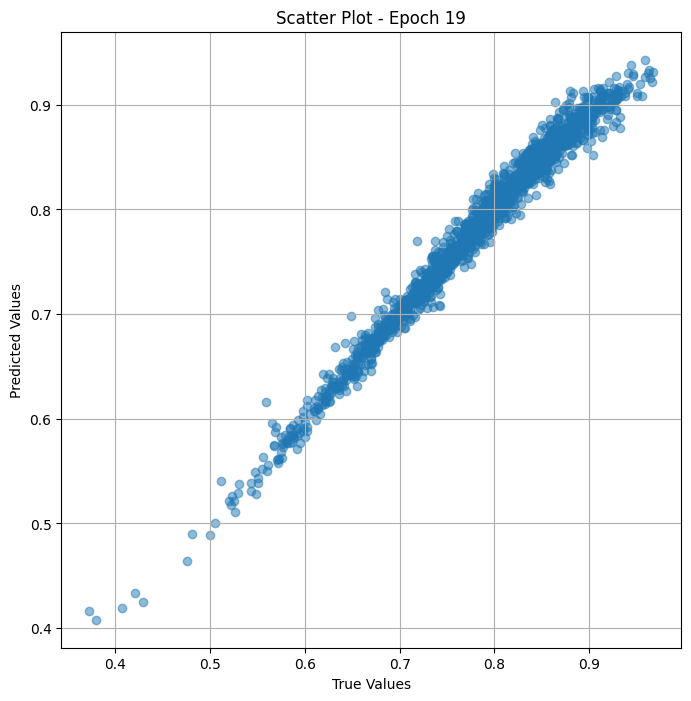

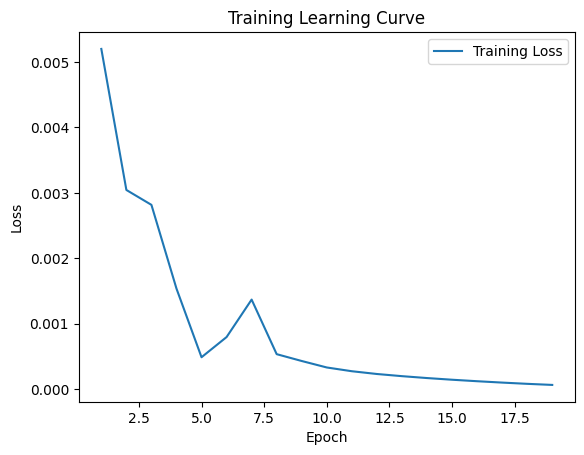


 Epoch: (20/50) Loss = 4.8741334467194974e-05

 Epoch: (20/50) Loss_rmse = 0.006981499493122101

 Epoch: (20/50) R^2 = 0.9922739863395691

 Epoch: (20/50) MAE = 0.0037713348865509033
Spearman correlation coefficient: SignificanceResult(statistic=0.9919353771324901, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769,

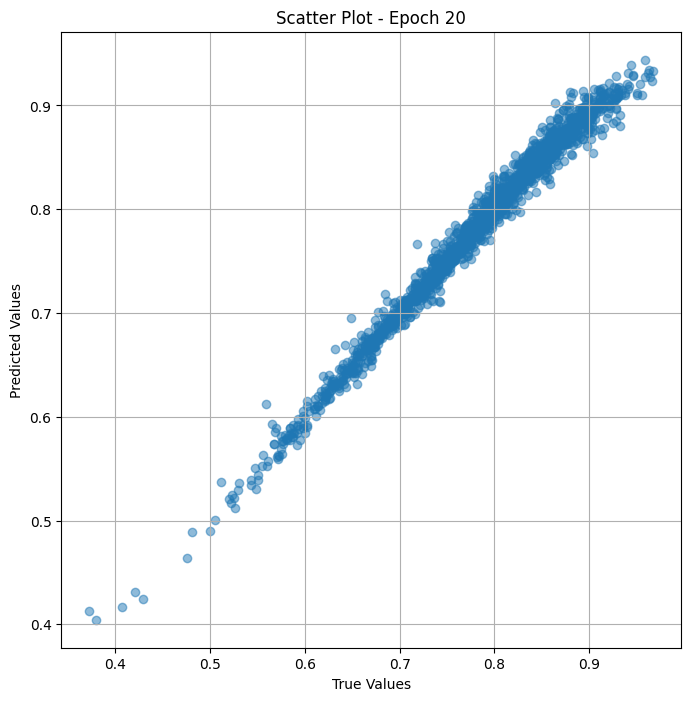

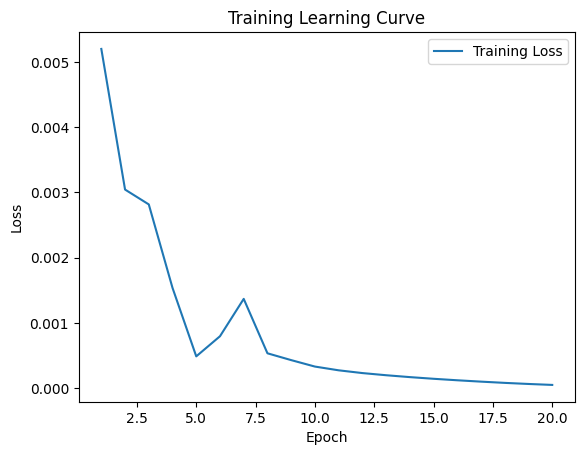


 Epoch: (21/50) Loss = 3.653094609035179e-05

 Epoch: (21/50) Loss_rmse = 0.0060440837405622005

 Epoch: (21/50) R^2 = 0.9942094683647156

 Epoch: (21/50) MAE = 0.0031822770833969116
Spearman correlation coefficient: SignificanceResult(statistic=0.9934349904525936, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769,

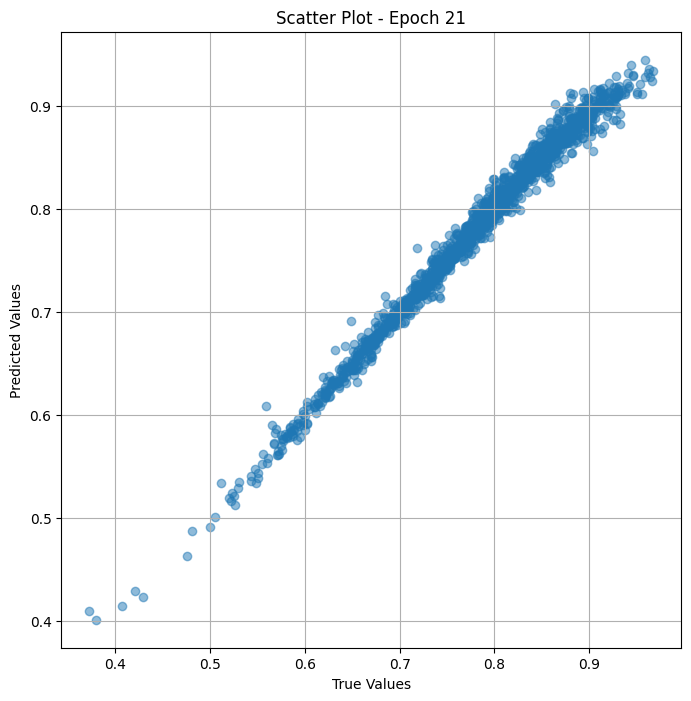

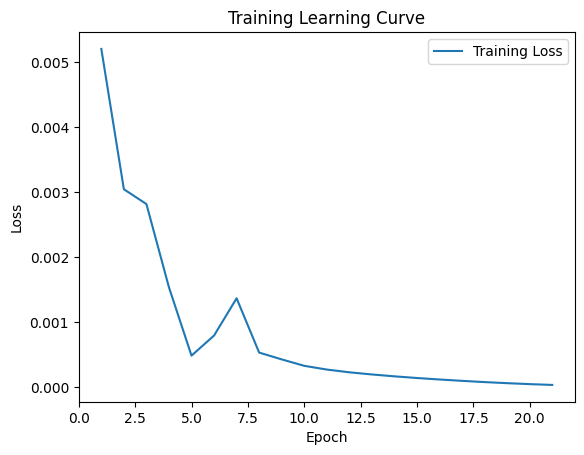


 Epoch: (22/50) Loss = 2.6635800168151036e-05

 Epoch: (22/50) Loss_rmse = 0.005160988308489323

 Epoch: (22/50) R^2 = 0.99577796459198

 Epoch: (22/50) MAE = 0.002646617591381073
Spearman correlation coefficient: SignificanceResult(statistic=0.9946458180790649, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.

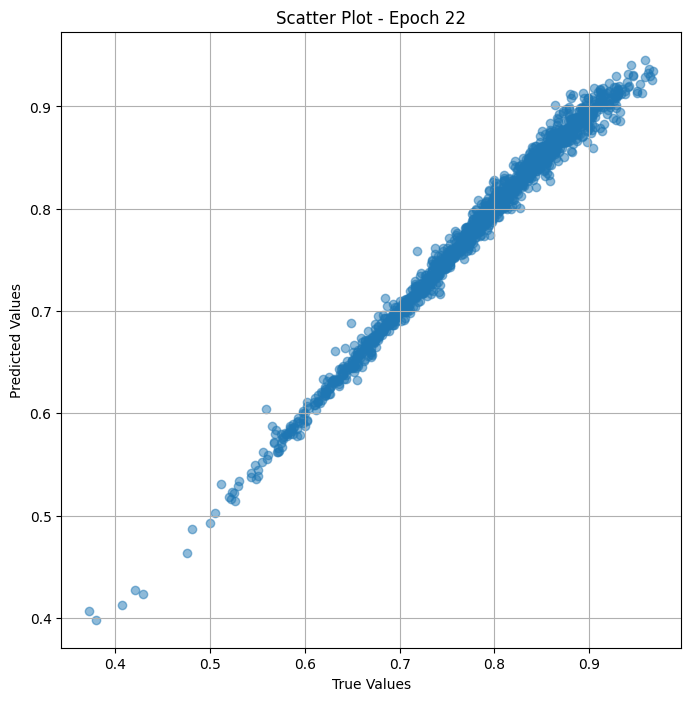

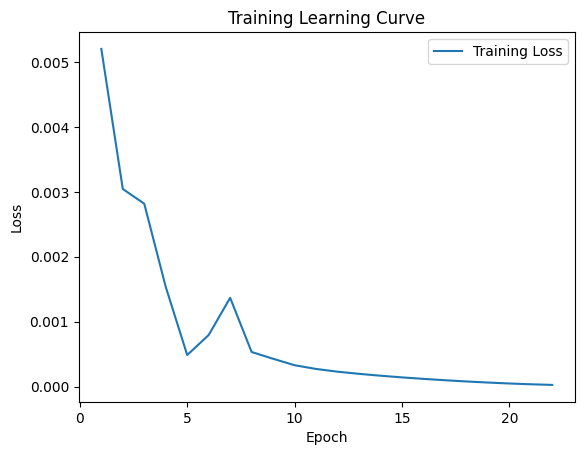


 Epoch: (23/50) Loss = 1.896713365567848e-05

 Epoch: (23/50) Loss_rmse = 0.004355127457529306

 Epoch: (23/50) R^2 = 0.9969934821128845

 Epoch: (23/50) MAE = 0.0022694915533065796
Spearman correlation coefficient: SignificanceResult(statistic=0.9955915996183087, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 

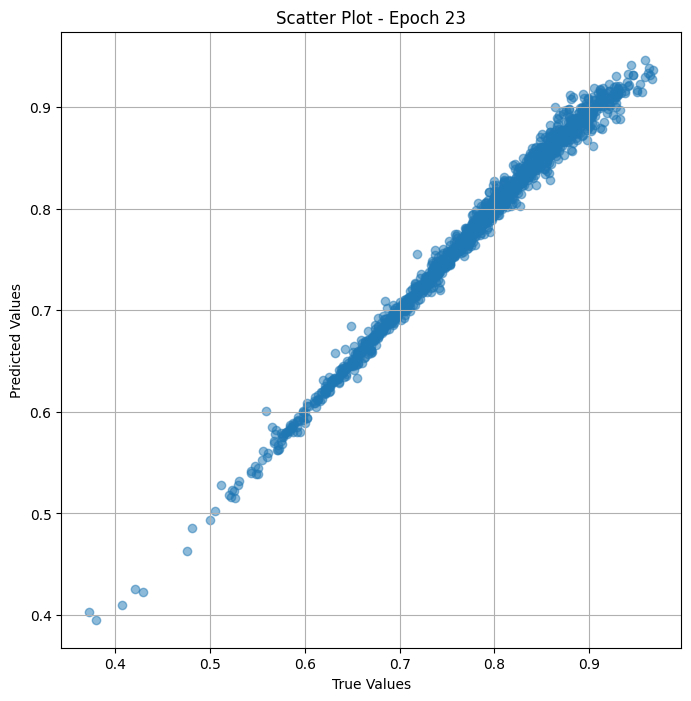

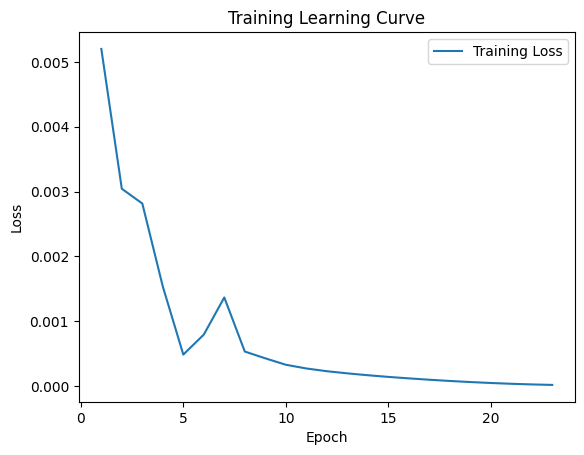


 Epoch: (24/50) Loss = 1.3286631656228565e-05

 Epoch: (24/50) Loss_rmse = 0.0036450831685215235

 Epoch: (24/50) R^2 = 0.9978939294815063

 Epoch: (24/50) MAE = 0.0019229352474212646
Spearman correlation coefficient: SignificanceResult(statistic=0.9963900889588324, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769

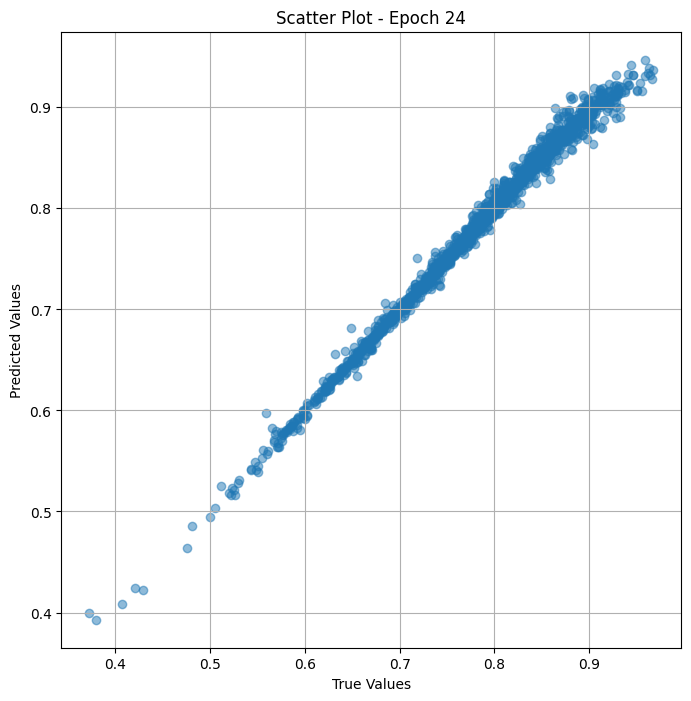

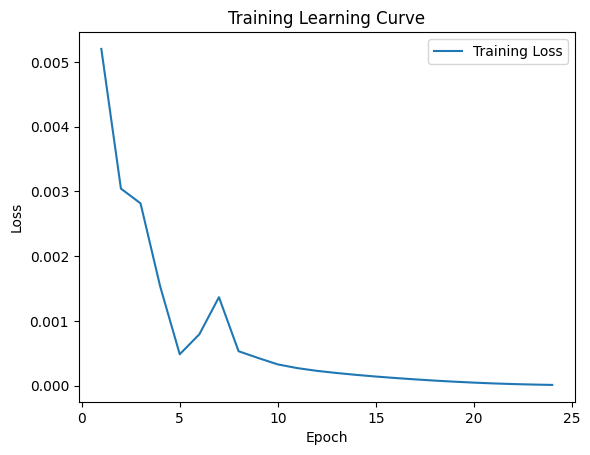


 Epoch: (25/50) Loss = 9.085108104045503e-06

 Epoch: (25/50) Loss_rmse = 0.0030141512397676706

 Epoch: (25/50) R^2 = 0.9985598921775818

 Epoch: (25/50) MAE = 0.0016105175018310547
Spearman correlation coefficient: SignificanceResult(statistic=0.9970482885512608, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769,

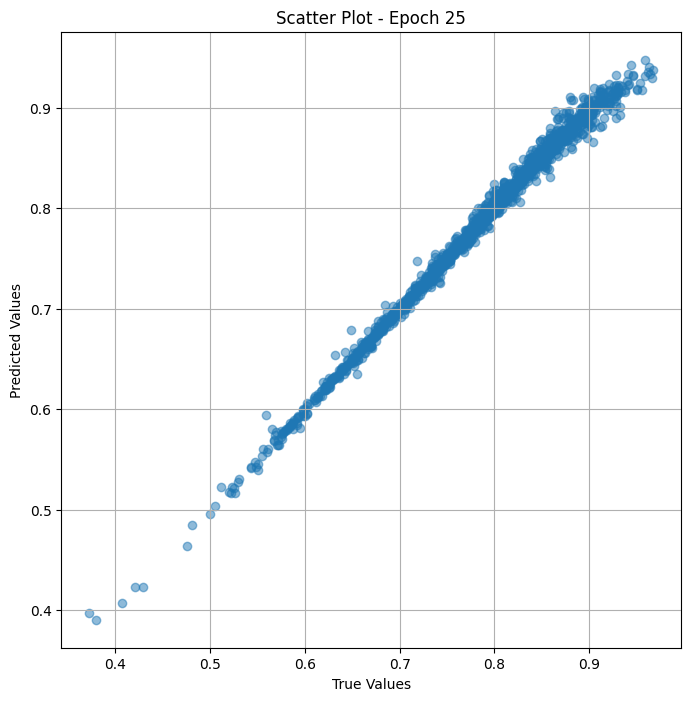

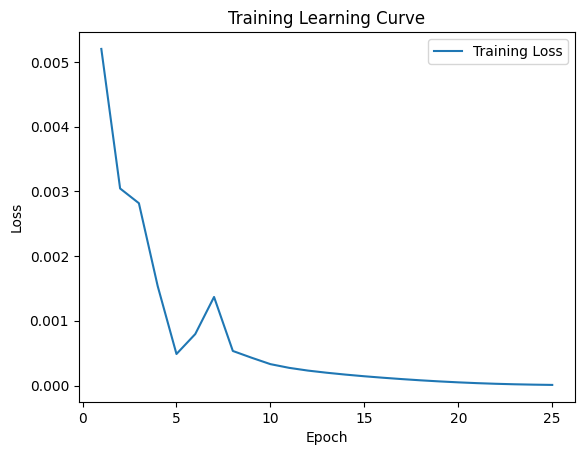


 Epoch: (26/50) Loss = 6.196159574756166e-06

 Epoch: (26/50) Loss_rmse = 0.002489208709448576

 Epoch: (26/50) R^2 = 0.9990178346633911

 Epoch: (26/50) MAE = 0.001366645097732544
Spearman correlation coefficient: SignificanceResult(statistic=0.9975902137721053, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0

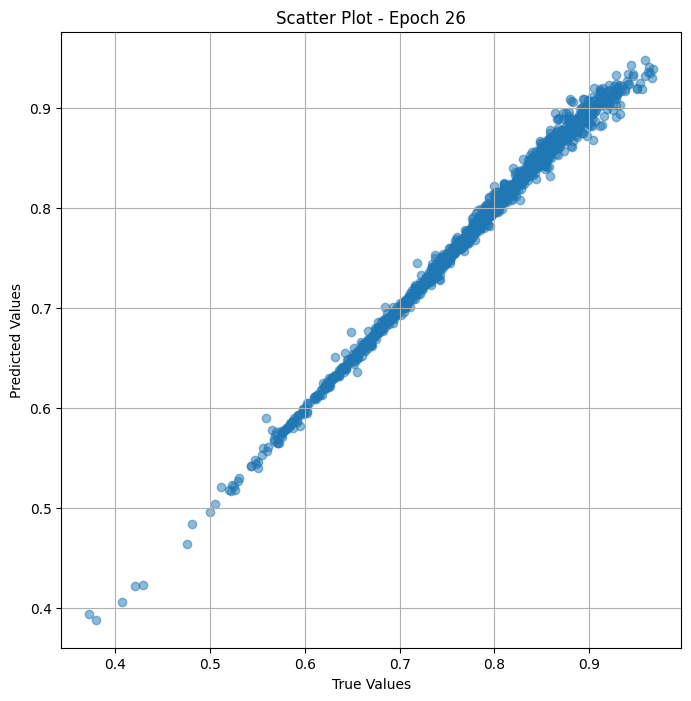

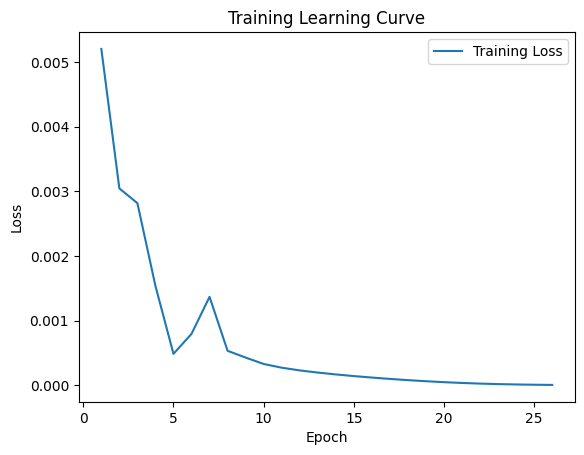


 Epoch: (27/50) Loss = 4.219988568365807e-06

 Epoch: (27/50) Loss_rmse = 0.0020542610436677933

 Epoch: (27/50) R^2 = 0.9993310570716858

 Epoch: (27/50) MAE = 0.0011566504836082458
Spearman correlation coefficient: SignificanceResult(statistic=0.9980281924116003, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769,

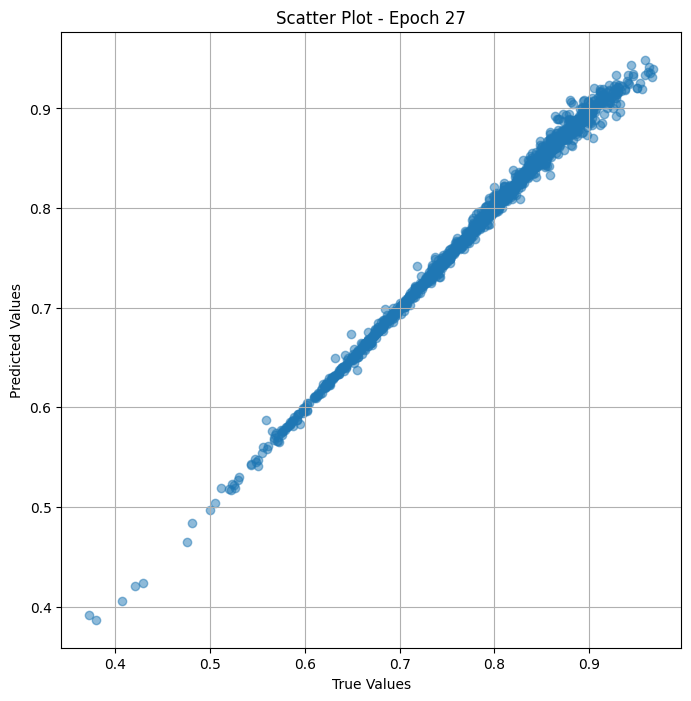

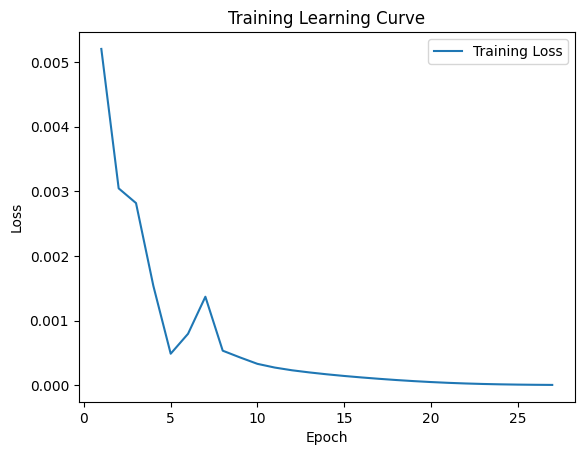


 Epoch: (28/50) Loss = 2.8842168831033632e-06

 Epoch: (28/50) Loss_rmse = 0.0016982982633635402

 Epoch: (28/50) R^2 = 0.9995428323745728

 Epoch: (28/50) MAE = 0.0009789690375328064
Spearman correlation coefficient: SignificanceResult(statistic=0.9983872965794003, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769

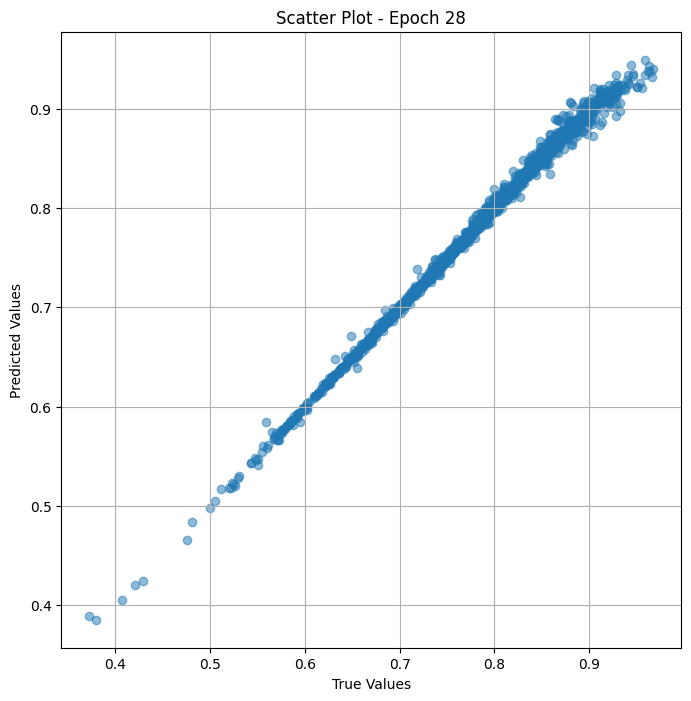

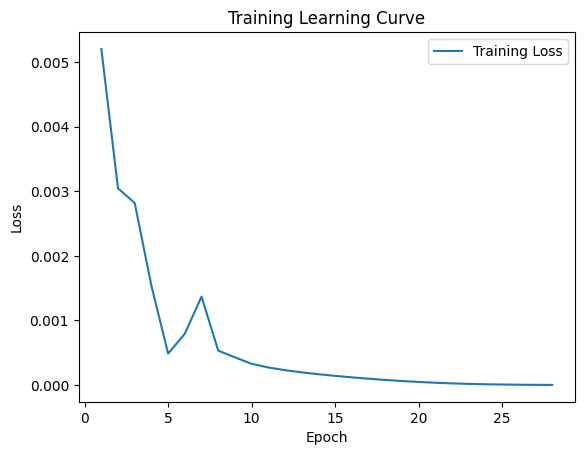


 Epoch: (29/50) Loss = 1.9974668248323724e-06

 Epoch: (29/50) Loss_rmse = 0.0014133176300674677

 Epoch: (29/50) R^2 = 0.9996833801269531

 Epoch: (29/50) MAE = 0.0008277595043182373
Spearman correlation coefficient: SignificanceResult(statistic=0.9986916558273927, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769

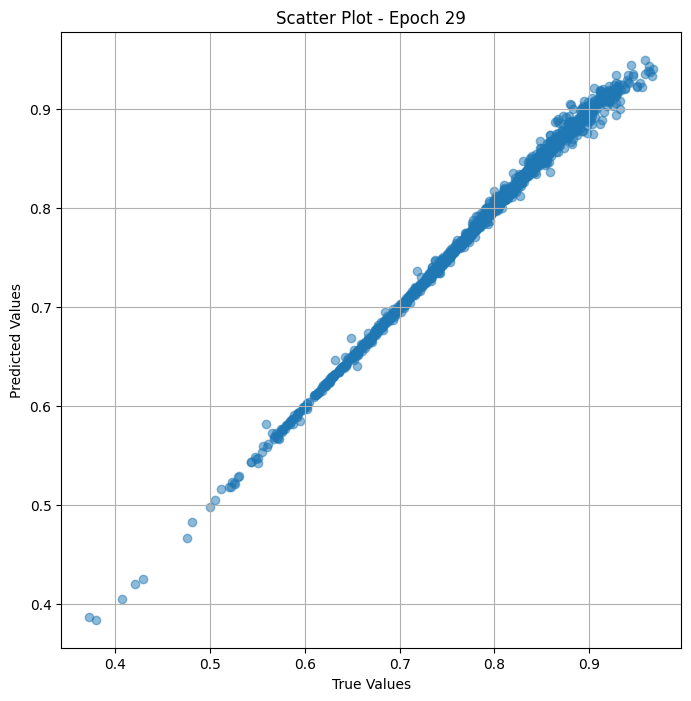

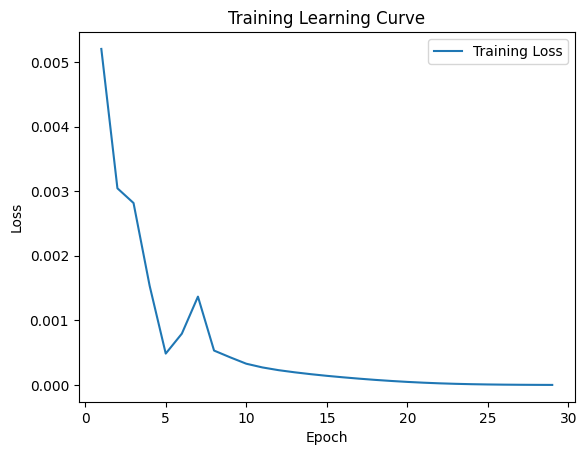


 Epoch: (30/50) Loss = 1.3767081554760807e-06

 Epoch: (30/50) Loss_rmse = 0.0011733321007341146

 Epoch: (30/50) R^2 = 0.9997817873954773

 Epoch: (30/50) MAE = 0.0006955116987228394
Spearman correlation coefficient: SignificanceResult(statistic=0.9989200746231608, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769

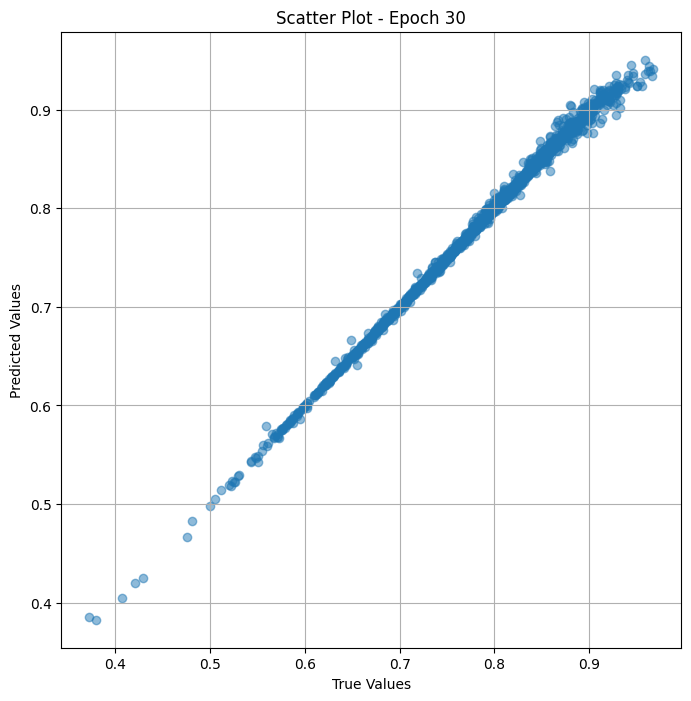

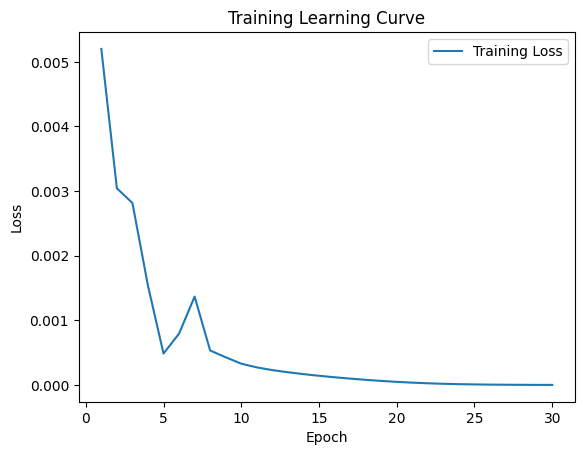


 Epoch: (31/50) Loss = 9.810629535422777e-07

 Epoch: (31/50) Loss_rmse = 0.0009904862381517887

 Epoch: (31/50) R^2 = 0.999844491481781

 Epoch: (31/50) MAE = 0.0006028339266777039
Spearman correlation coefficient: SignificanceResult(statistic=0.9991023488079769, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 

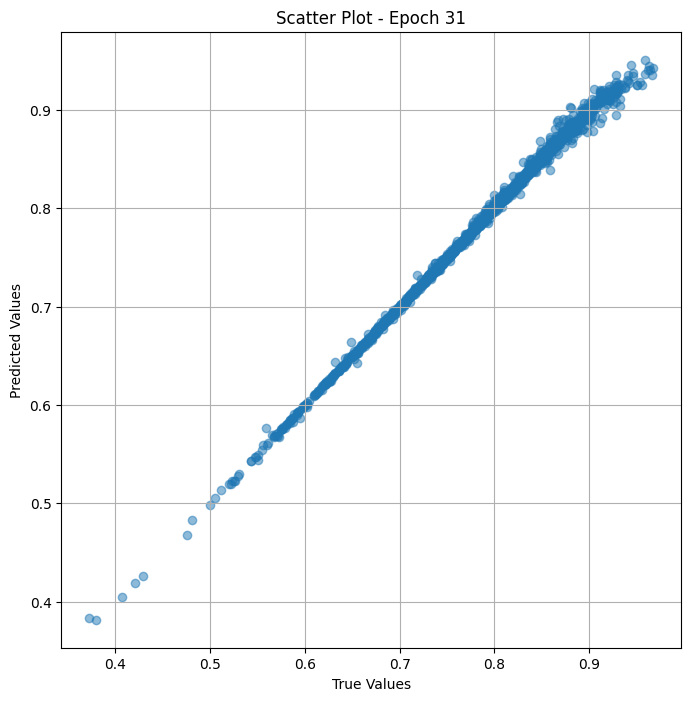

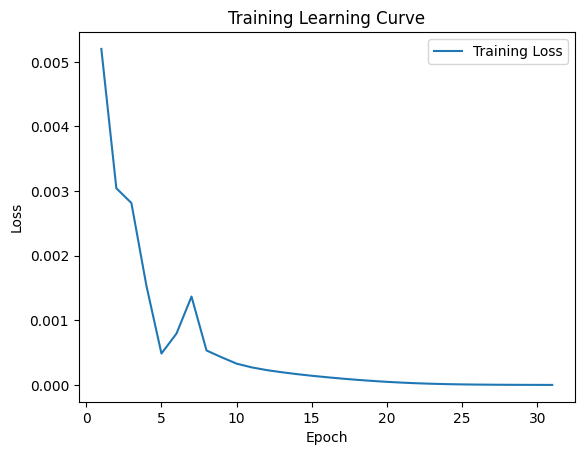


 Epoch: (32/50) Loss = 7.253777880578127e-07

 Epoch: (32/50) Loss_rmse = 0.0008516911184415221

 Epoch: (32/50) R^2 = 0.9998850226402283

 Epoch: (32/50) MAE = 0.000515475869178772
Spearman correlation coefficient: SignificanceResult(statistic=0.9992617529612491, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 

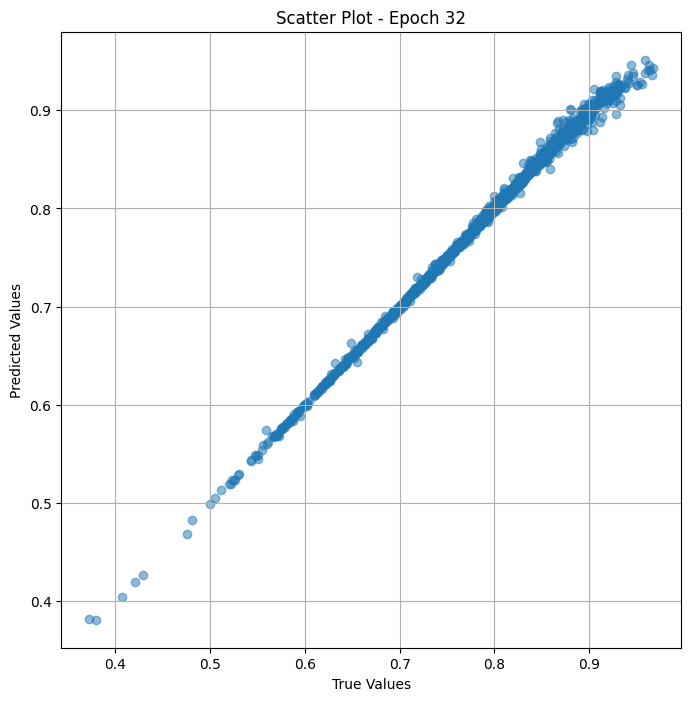

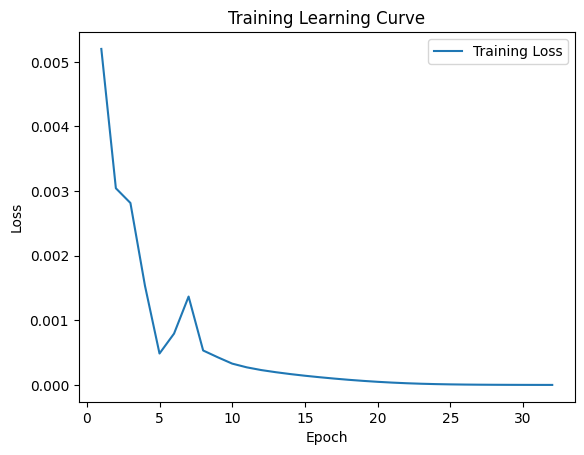


 Epoch: (33/50) Loss = 5.362792308005737e-07

 Epoch: (33/50) Loss_rmse = 0.000732310872990638

 Epoch: (33/50) R^2 = 0.9999150037765503

 Epoch: (33/50) MAE = 0.0004248768091201782
Spearman correlation coefficient: SignificanceResult(statistic=0.9993808284123322, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 

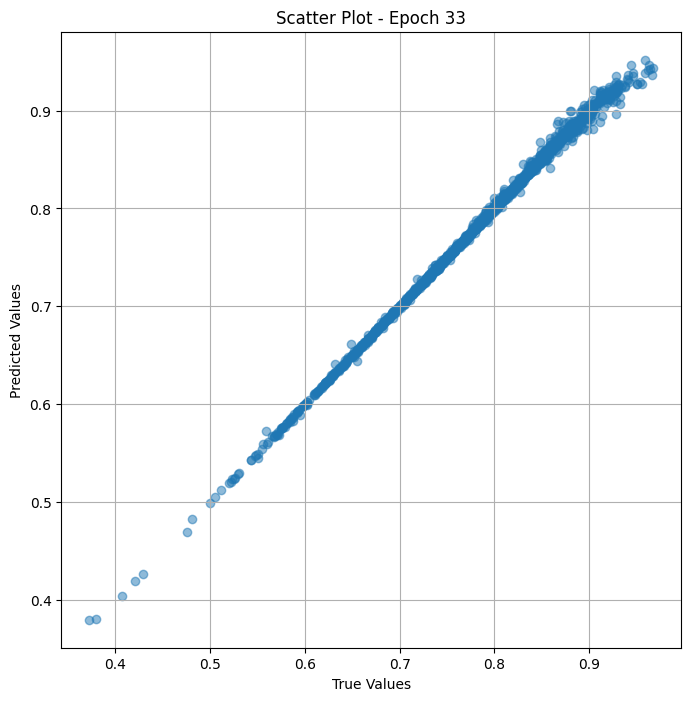

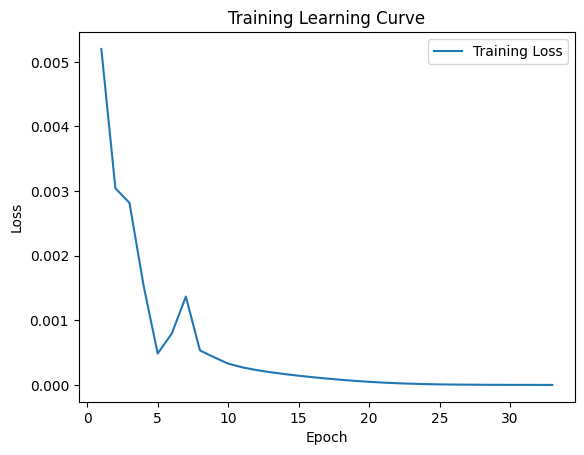


 Epoch: (34/50) Loss = 4.0433209846924e-07

 Epoch: (34/50) Loss_rmse = 0.0006358711398206651

 Epoch: (34/50) R^2 = 0.9999359250068665

 Epoch: (34/50) MAE = 0.00036369264125823975
Spearman correlation coefficient: SignificanceResult(statistic=0.9994775499441795, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 

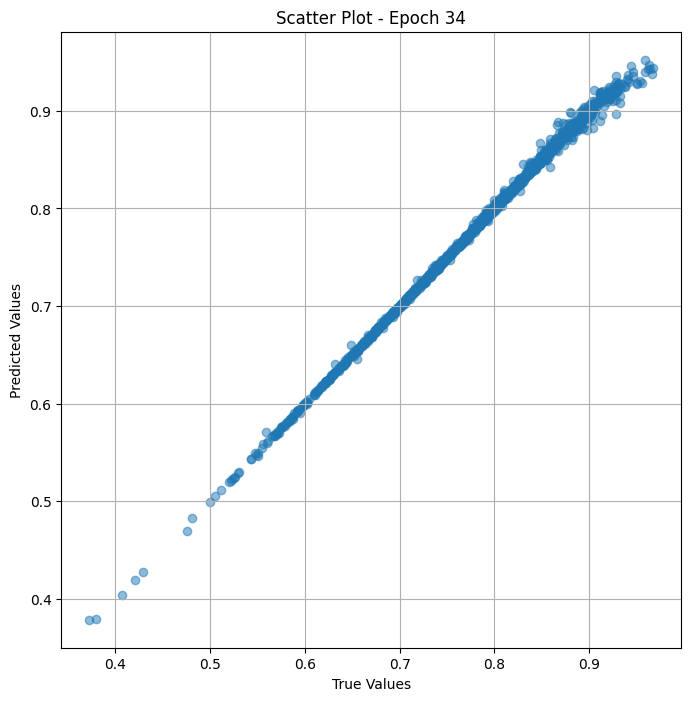

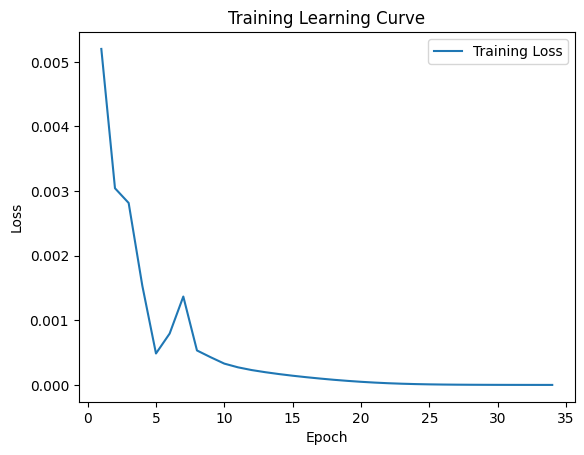


 Epoch: (35/50) Loss = 2.971519563743641e-07

 Epoch: (35/50) Loss_rmse = 0.0005451164324767888

 Epoch: (35/50) R^2 = 0.9999529123306274

 Epoch: (35/50) MAE = 0.00030209869146347046
Spearman correlation coefficient: SignificanceResult(statistic=0.9995572720918104, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769

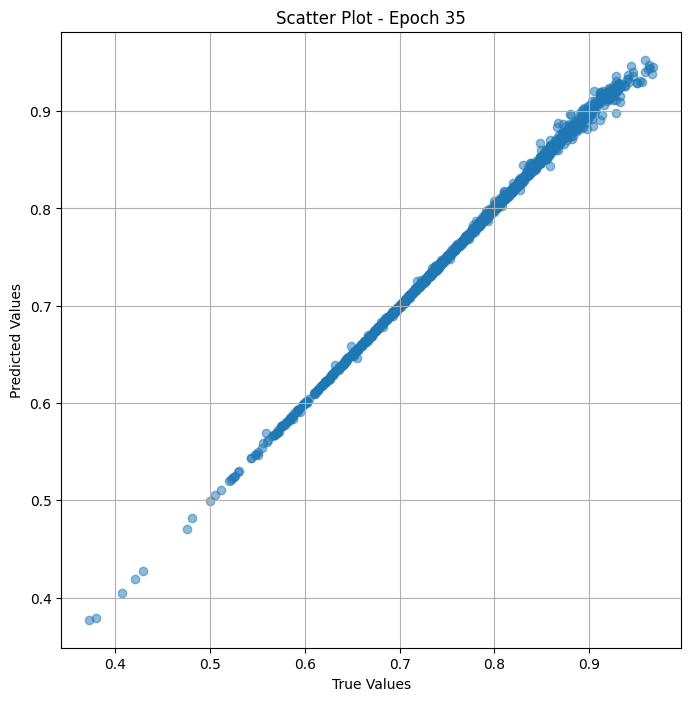

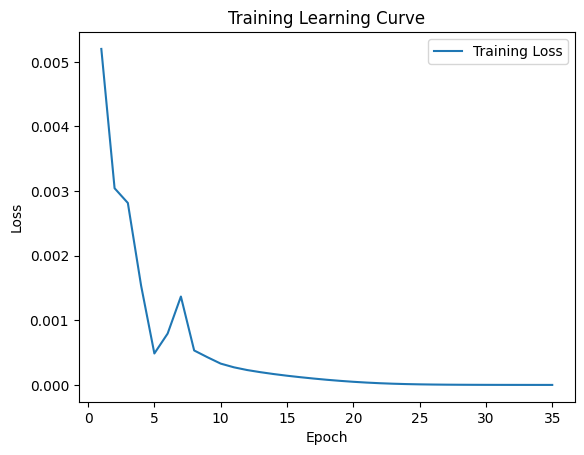


 Epoch: (36/50) Loss = 2.327404047264281e-07

 Epoch: (36/50) Loss_rmse = 0.00048243175842799246

 Epoch: (36/50) R^2 = 0.999963104724884

 Epoch: (36/50) MAE = 0.0002642422914505005
Spearman correlation coefficient: SignificanceResult(statistic=0.999618088889662, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 

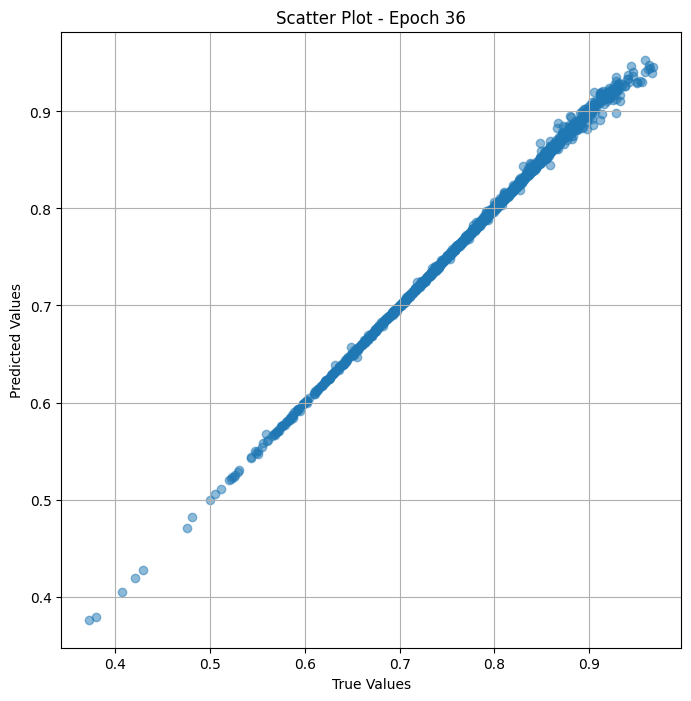

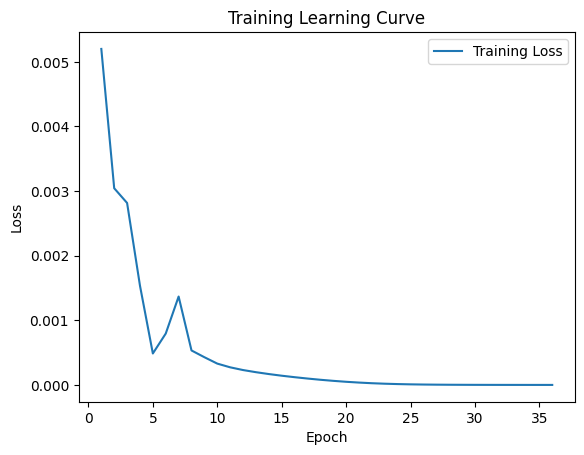


 Epoch: (37/50) Loss = 1.7180755662593583e-07

 Epoch: (37/50) Loss_rmse = 0.0004144967533648014

 Epoch: (37/50) R^2 = 0.9999727606773376

 Epoch: (37/50) MAE = 0.00028207898139953613
Spearman correlation coefficient: SignificanceResult(statistic=0.9996670888005513, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.548076

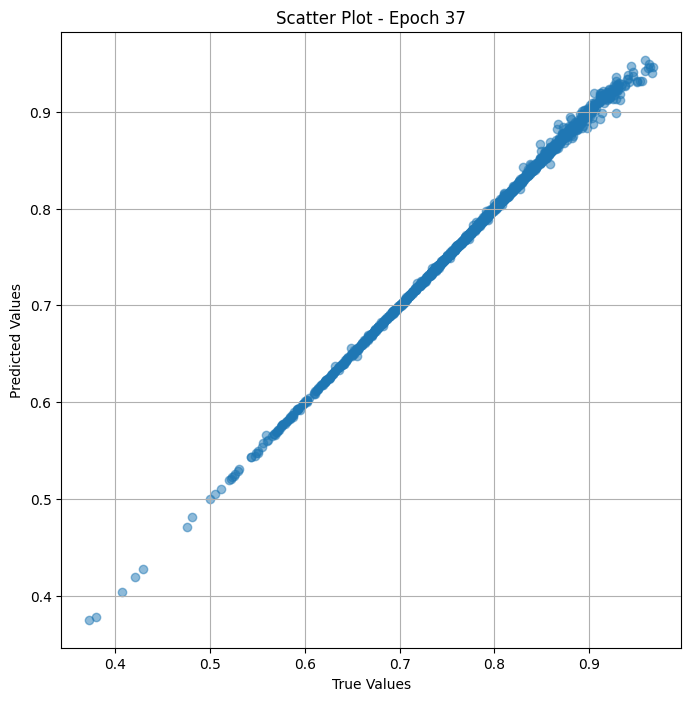

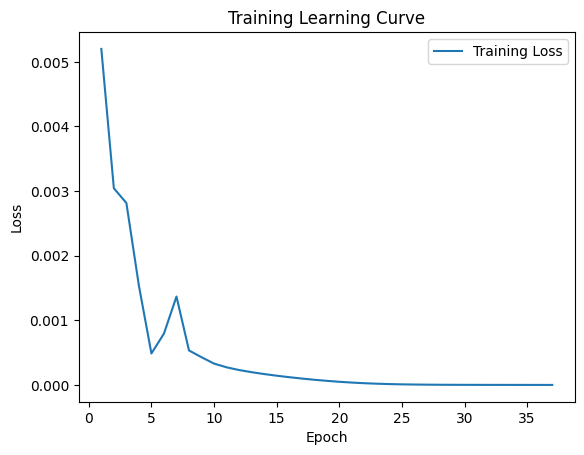


 Epoch: (38/50) Loss = 1.773067737076417e-07

 Epoch: (38/50) Loss_rmse = 0.0004210781189613044

 Epoch: (38/50) R^2 = 0.999971866607666

 Epoch: (38/50) MAE = 0.00032276660203933716
Spearman correlation coefficient: SignificanceResult(statistic=0.9997123137930806, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769,

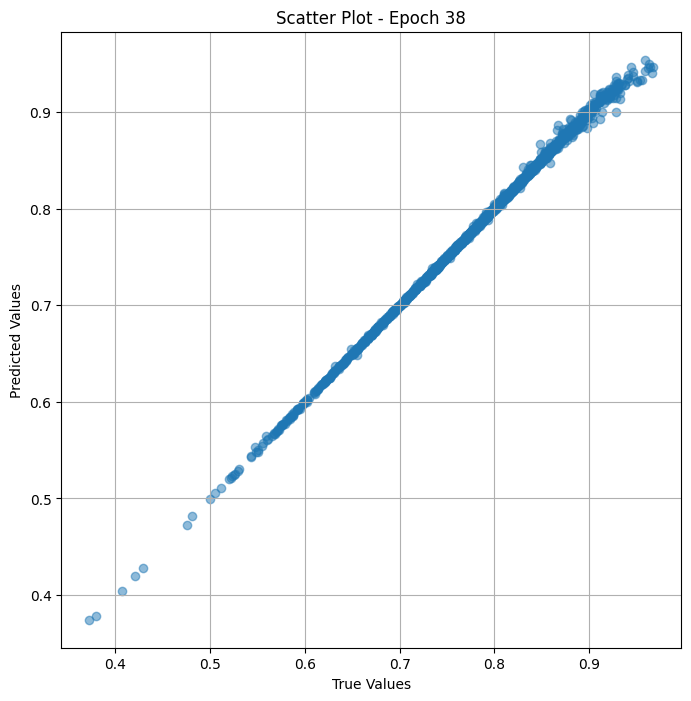

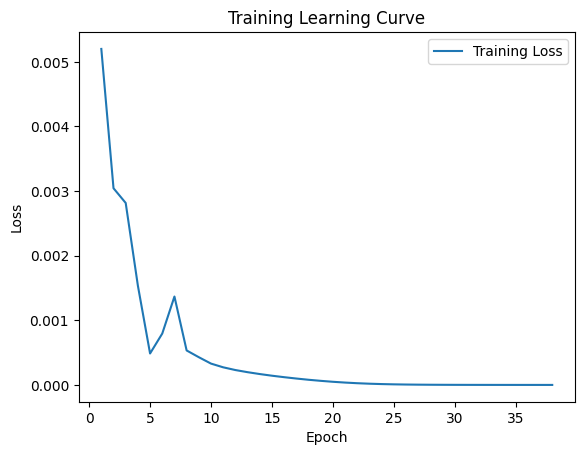


 Epoch: (39/50) Loss = 1.4361106082105835e-07

 Epoch: (39/50) Loss_rmse = 0.00037896051071584225

 Epoch: (39/50) R^2 = 0.9999772310256958

 Epoch: (39/50) MAE = 0.00034358352422714233
Spearman correlation coefficient: SignificanceResult(statistic=0.9997476502826148, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.54807

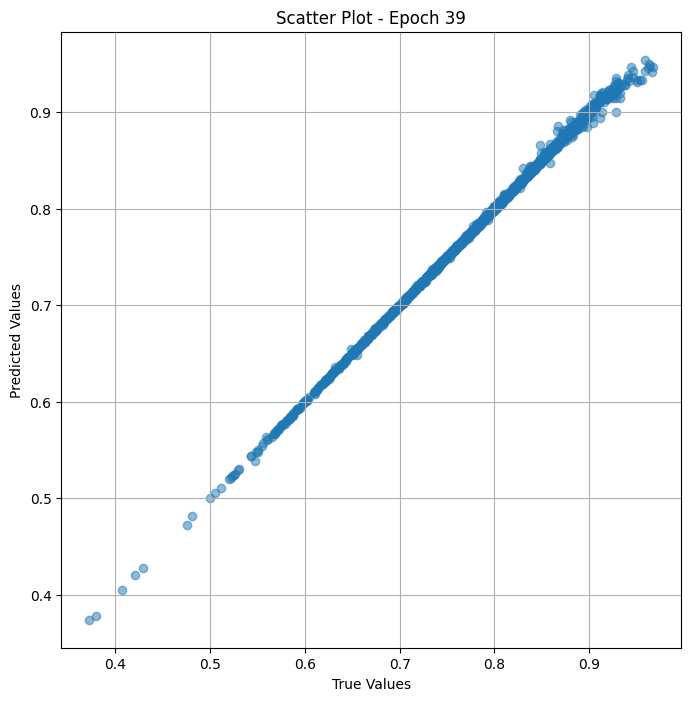

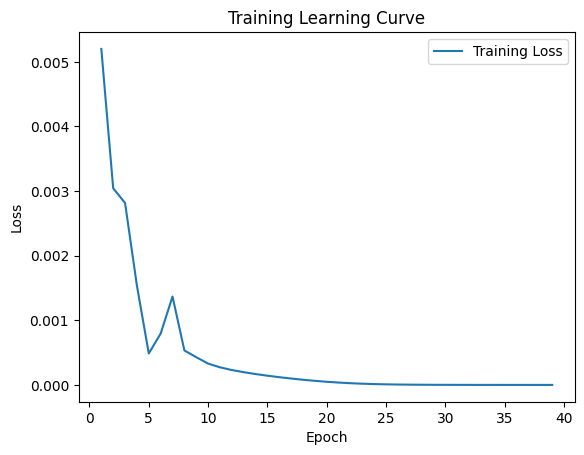


 Epoch: (40/50) Loss = 3.5130682363160304e-07

 Epoch: (40/50) Loss_rmse = 0.0005927114398218691

 Epoch: (40/50) R^2 = 0.9999443292617798

 Epoch: (40/50) MAE = 0.0005466938018798828
Spearman correlation coefficient: SignificanceResult(statistic=0.9997707476118514, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769

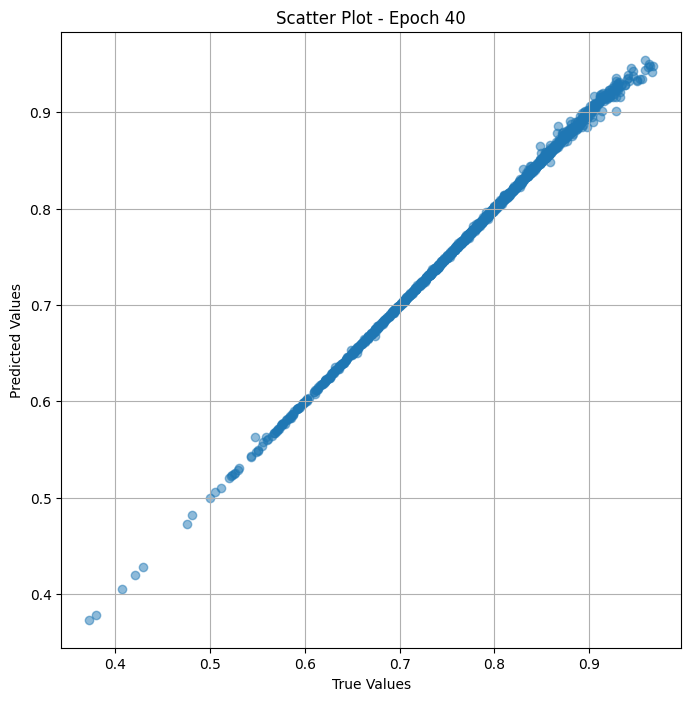

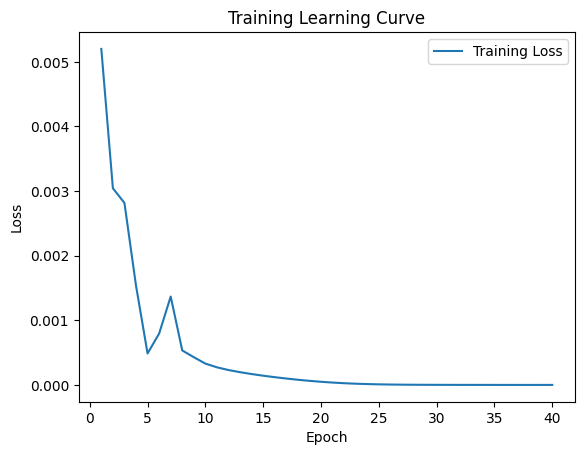


 Epoch: (41/50) Loss = 6.027542553965759e-07

 Epoch: (41/50) Loss_rmse = 0.0007763725006952882

 Epoch: (41/50) R^2 = 0.999904453754425

 Epoch: (41/50) MAE = 0.0007309094071388245
Spearman correlation coefficient: SignificanceResult(statistic=0.9997908812051244, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 

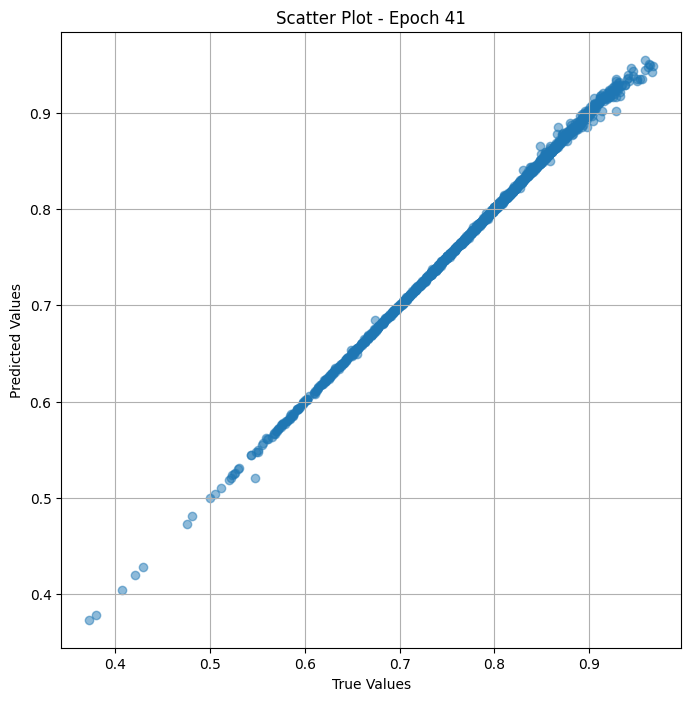

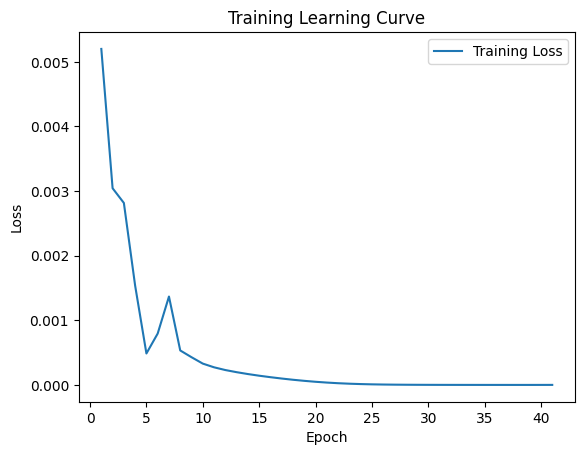

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (42/50) Loss = 1.806043087526632e-06

 Epoch: (42/50) Loss_rmse = 0.0013438910245895386

 Epoch: (42/50) R^2 = 0.9997137188911438

 Epoch: (42/50) MAE = 0.0011693239212036133
Spearman correlation coefficient: SignificanceResult(statistic=0.9997928361759884, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468

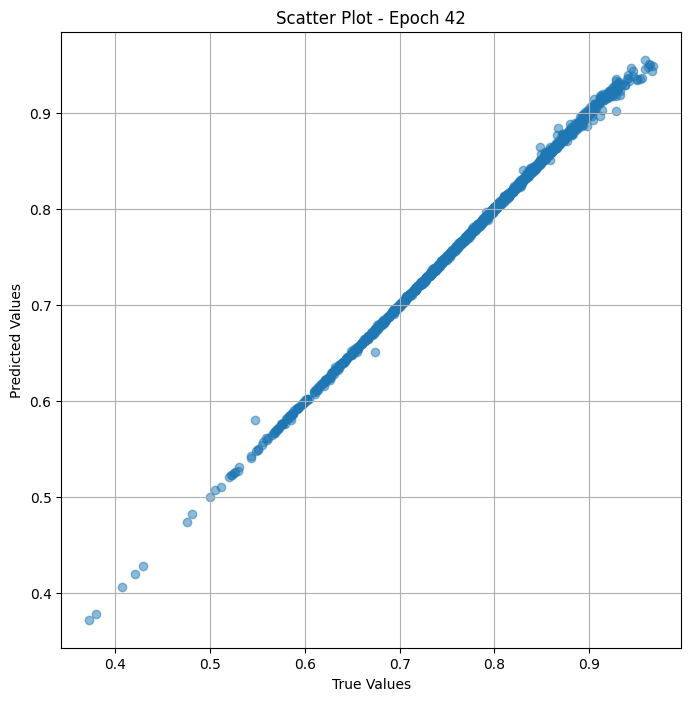

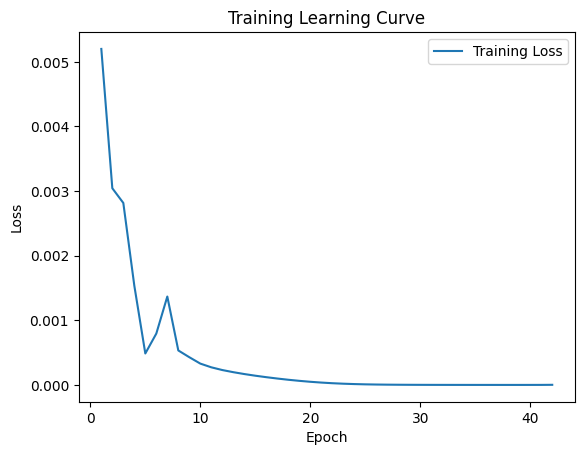


 Epoch: (43/50) Loss = 8.803058904049976e-07

 Epoch: (43/50) Loss_rmse = 0.0009382462012581527

 Epoch: (43/50) R^2 = 0.9998604655265808

 Epoch: (43/50) MAE = 0.0006434395909309387
Spearman correlation coefficient: SignificanceResult(statistic=0.9989077311966446, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769,

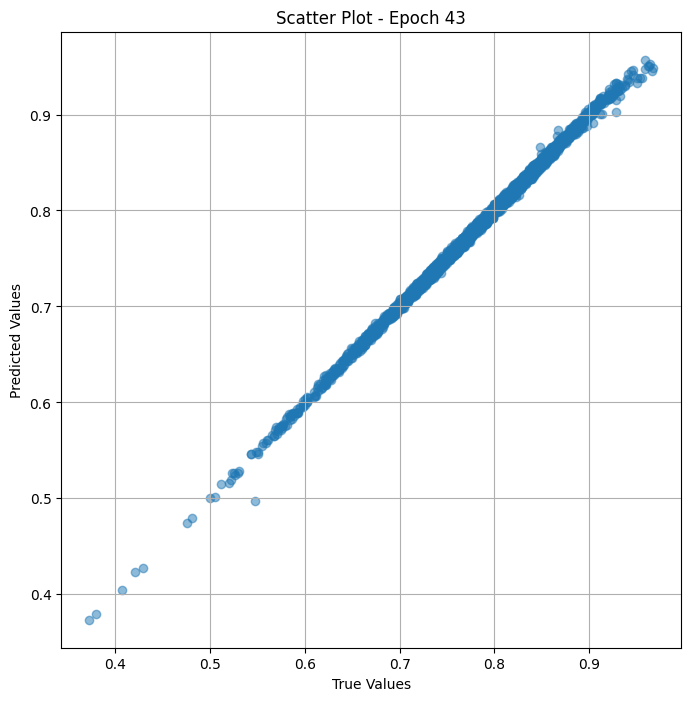

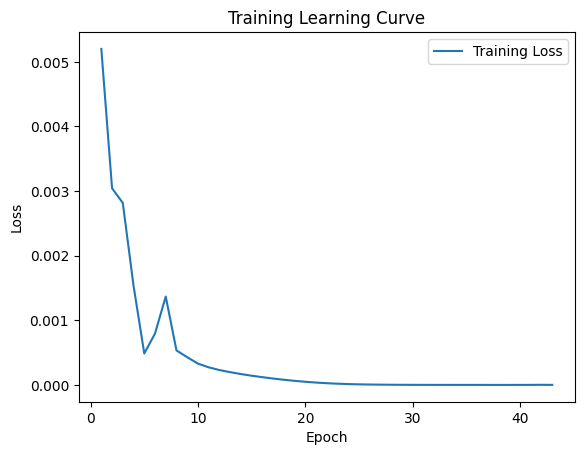


 Epoch: (44/50) Loss = 8.654425300846924e-07

 Epoch: (44/50) Loss_rmse = 0.0009302916587330401

 Epoch: (44/50) R^2 = 0.999862790107727

 Epoch: (44/50) MAE = 0.00077095627784729
Spearman correlation coefficient: SignificanceResult(statistic=0.9988629623649979, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.

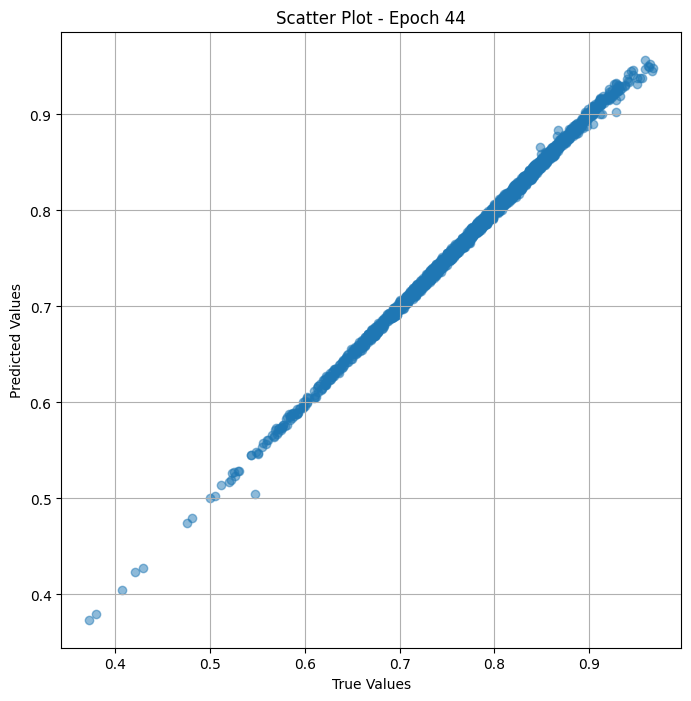

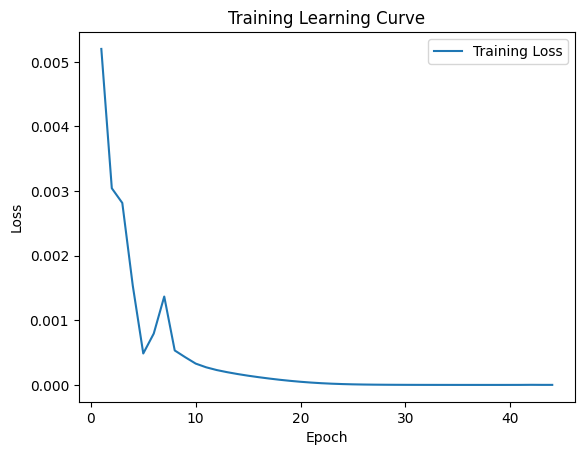

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (45/50) Loss = 6.809514729866351e-07

 Epoch: (45/50) Loss_rmse = 0.0008251978433690965

 Epoch: (45/50) R^2 = 0.9998920559883118

 Epoch: (45/50) MAE = 0.0007394477725028992
Spearman correlation coefficient: SignificanceResult(statistic=0.9990343064380439, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468

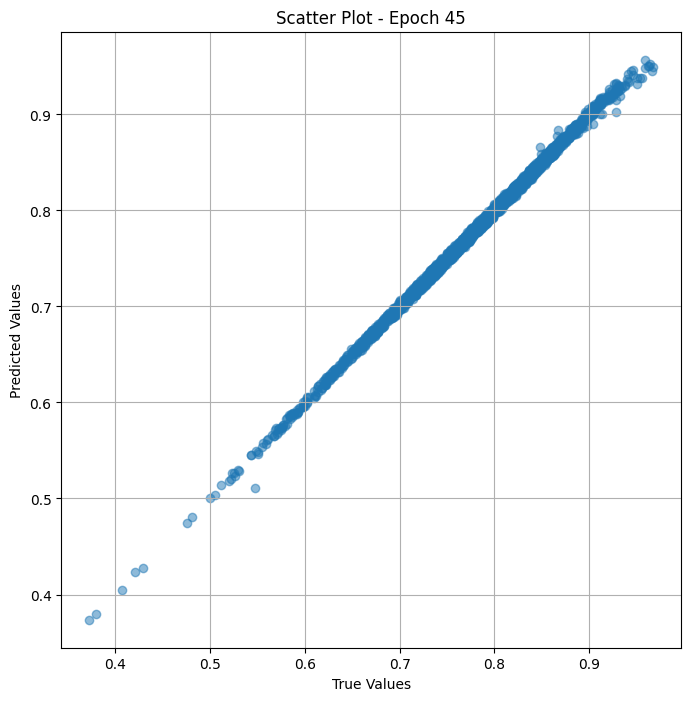

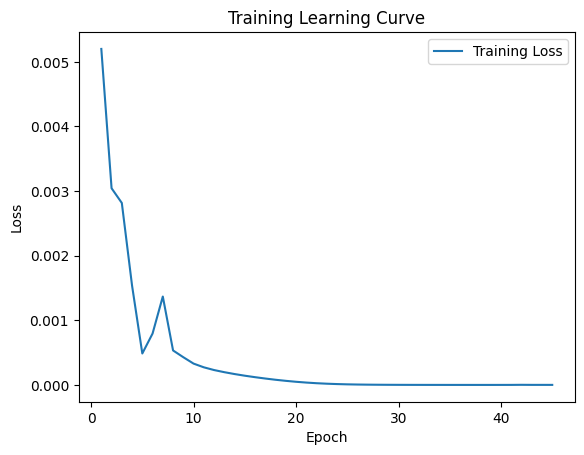


 Epoch: (46/50) Loss = 9.038984103426628e-07

 Epoch: (46/50) Loss_rmse = 0.0009507357026450336

 Epoch: (46/50) R^2 = 0.99985671043396

 Epoch: (46/50) MAE = 0.0008885413408279419
Spearman correlation coefficient: SignificanceResult(statistic=0.9994090300400302, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0

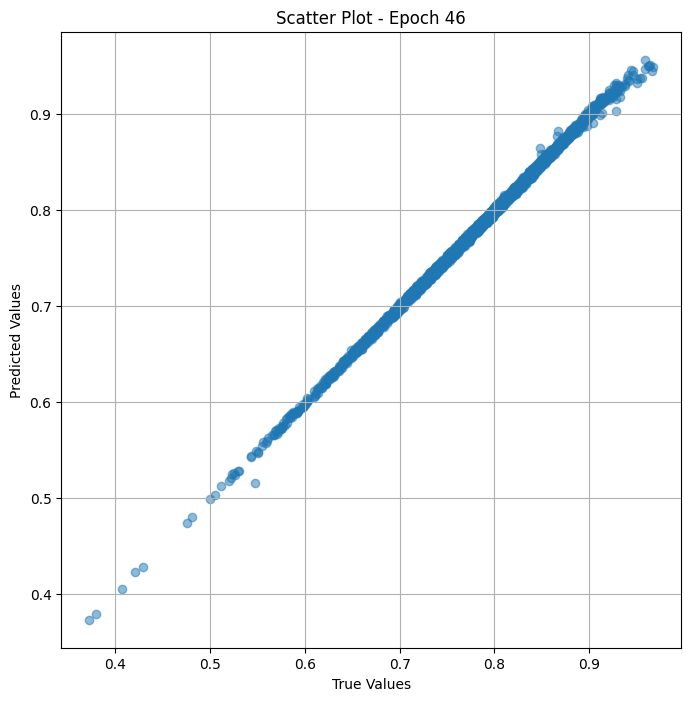

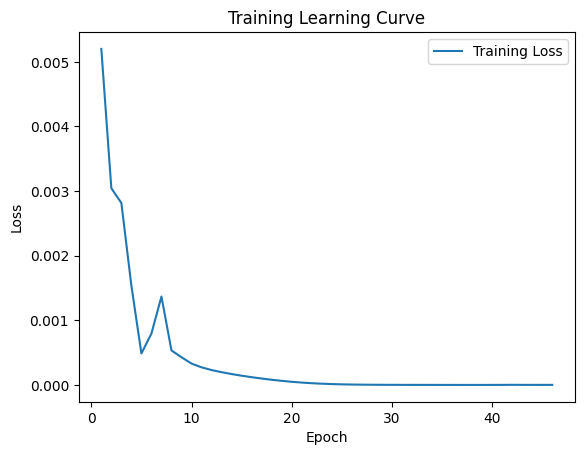


 Epoch: (47/50) Loss = 1.3629074828713783e-06

 Epoch: (47/50) Loss_rmse = 0.0011674362467601895

 Epoch: (47/50) R^2 = 0.999783992767334

 Epoch: (47/50) MAE = 0.0011207982897758484
Spearman correlation coefficient: SignificanceResult(statistic=0.999431839597124, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 

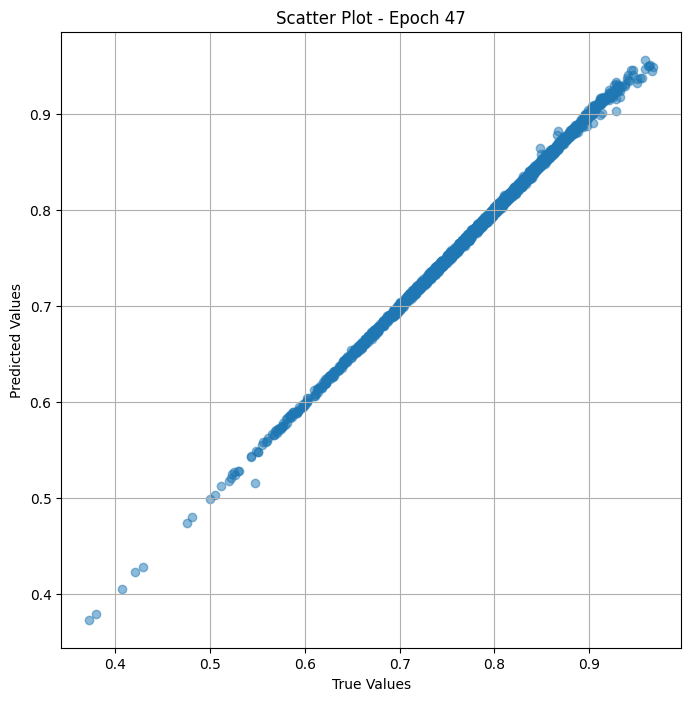

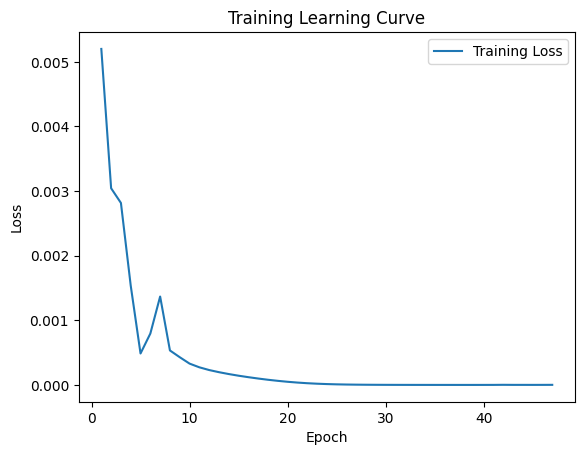

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (48/50) Loss = 1.6853493889357196e-06

 Epoch: (48/50) Loss_rmse = 0.0012982101179659367

 Epoch: (48/50) R^2 = 0.9997328519821167

 Epoch: (48/50) MAE = 0.001258745789527893
Spearman correlation coefficient: SignificanceResult(statistic=0.9994485559016246, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468

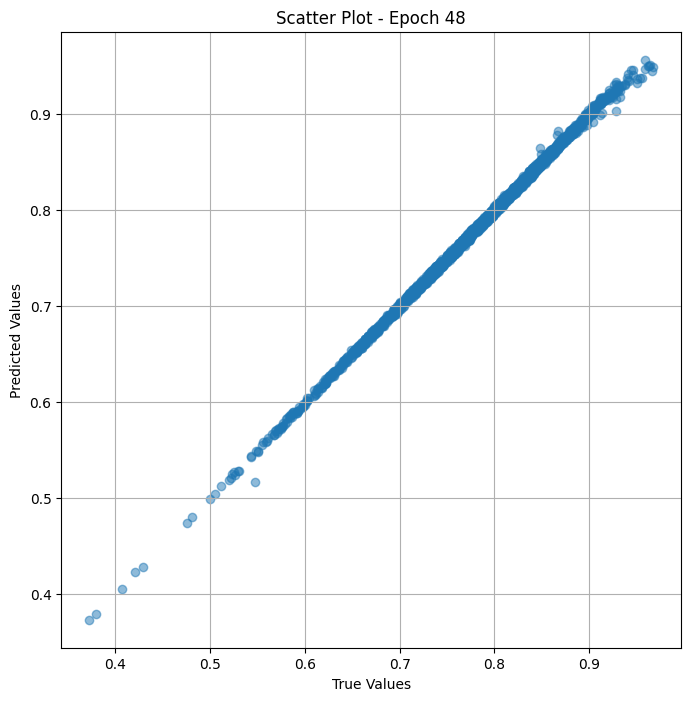

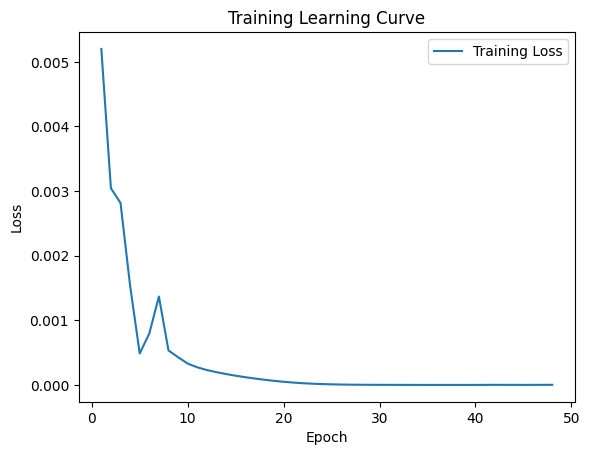


 Epoch: (49/50) Loss = 1.6744971844673273e-06

 Epoch: (49/50) Loss_rmse = 0.0012940235901623964

 Epoch: (49/50) R^2 = 0.9997345805168152

 Epoch: (49/50) MAE = 0.0012549236416816711
Spearman correlation coefficient: SignificanceResult(statistic=0.9994941312250608, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769

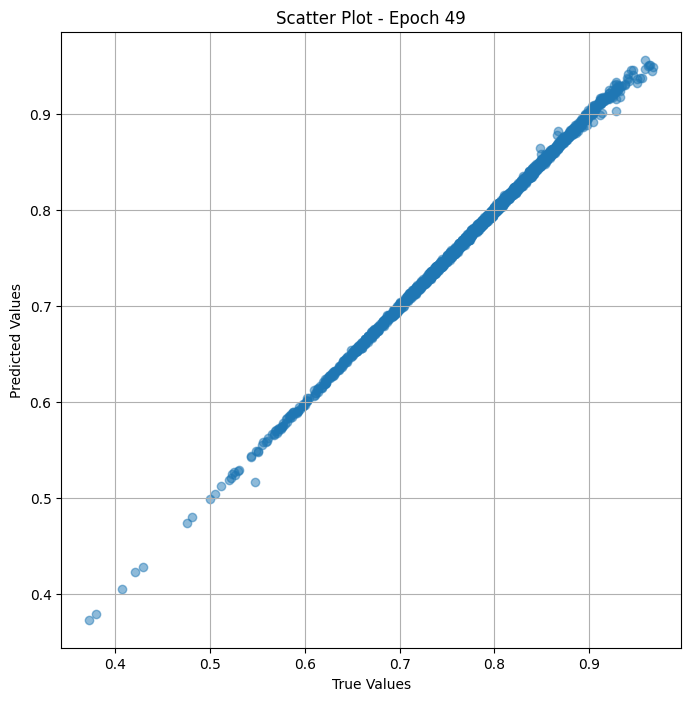

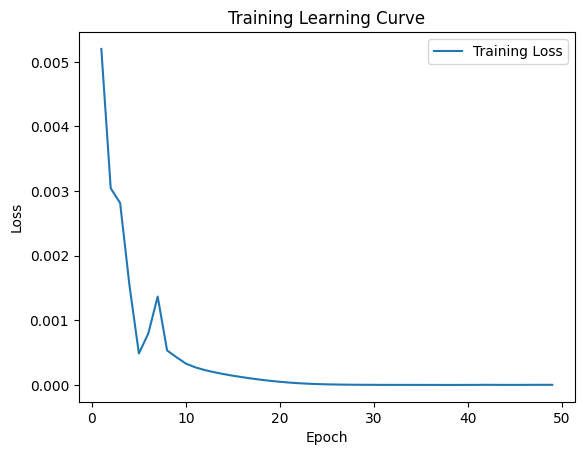


 Epoch: (50/50) Loss = 1.6951478301052703e-06

 Epoch: (50/50) Loss_rmse = 0.0013019784819334745

 Epoch: (50/50) R^2 = 0.9997313022613525

 Epoch: (50/50) MAE = 0.001263163983821869
Spearman correlation coefficient: SignificanceResult(statistic=0.9994946118872308, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769,

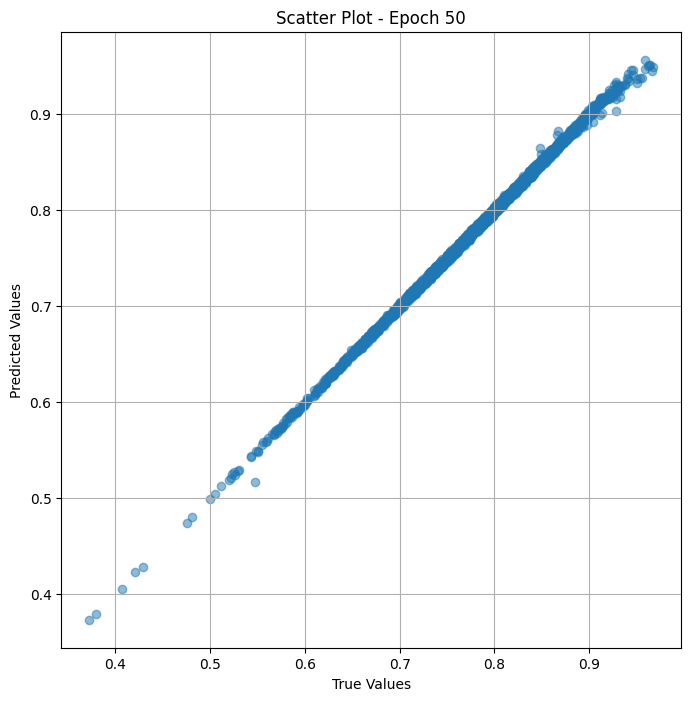

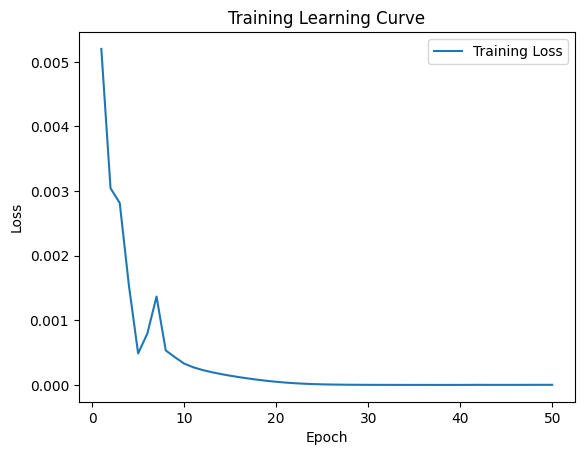

In [ ]:
# Training the model and save weights
fit(50, model_vit , train_dl)
torch.save(model_vit.state_dict(), "model_weights_sport")

In [ ]:
true_values_list = []
predicted_values_list = []

for x_trans, yb in train_dl:
    preds = model_vit(x_trans)
    true_values_list.extend(yb.cpu().detach().numpy())
    predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_vehicle' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_train_sports['preprocessed_image_path'],
    'True Value': true_values_list,  # Replace with your actual true values
    'Predicted Value': predicted_values_list  # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)



In [ ]:
from prettytable import PrettyTable

# Assuming 'df_result' is your DataFrame
# The 'Image Path' column should contain the paths to your images

# Create a PrettyTable instance
table = PrettyTable()

# Add column names
table.field_names = df_result.columns.tolist()

# Add rows
for _, row in df_result.iterrows():
    table.add_row(row.tolist())

# Display the table
print(table)

## Valid

In [ ]:
class Dataset_val_sports(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_val_sports["memoscore"]
        self.images = df_val_sports["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
val_ds = Dataset_val_sports(df_val_sports, trans_transform=trans_transform)
val_dl = DataLoader(val_ds, batch_size=32, shuffle=False)

In [ ]:
class ViTMem_model_val_sport(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))

    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit_sval =  ViTMem_model_val_sport( arch="vit_base_patch16_224_miil")

In [ ]:


# Assuming your model is an instance of YourModelClass and is already on GPU
model = ViTMem_model_val_sport().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 768, 14, 14]         590,592
          Identity-2             [-1, 196, 768]               0
        PatchEmbed-3             [-1, 196, 768]               0
           Dropout-4             [-1, 197, 768]               0
          Identity-5             [-1, 197, 768]               0
          Identity-6             [-1, 197, 768]               0
         LayerNorm-7             [-1, 197, 768]           1,536
            Linear-8            [-1, 197, 2304]       1,769,472
          Identity-9          [-1, 12, 197, 64]               0
         Identity-10          [-1, 12, 197, 64]               0
           Linear-11             [-1, 197, 768]         590,592
          Dropout-12             [-1, 197, 768]               0
        Attention-13             [-1, 197, 768]               0
         Identity-14             [-1, 1

In [ ]:
device = get_default_device()
val_dl = DeviceDataLoader(val_dl, device)
model_vit_sval  = to_device(model_vit_sval  , device)

In [ ]:
params = [param for param in list(model_vit_sval.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Val Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_sval, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_sval.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_sval(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/50) Loss = 0.04911285266280174

 Epoch: (1/50) Loss_rmse = 0.22161419689655304

 Epoch: (1/50) R^2 = -4.542602062225342

 Epoch: (1/50) MAE = 0.20035767555236816
Spearman correlation coefficient: SignificanceResult(statistic=-0.15872488344799823, pvalue=0.1224388452895734)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.77777

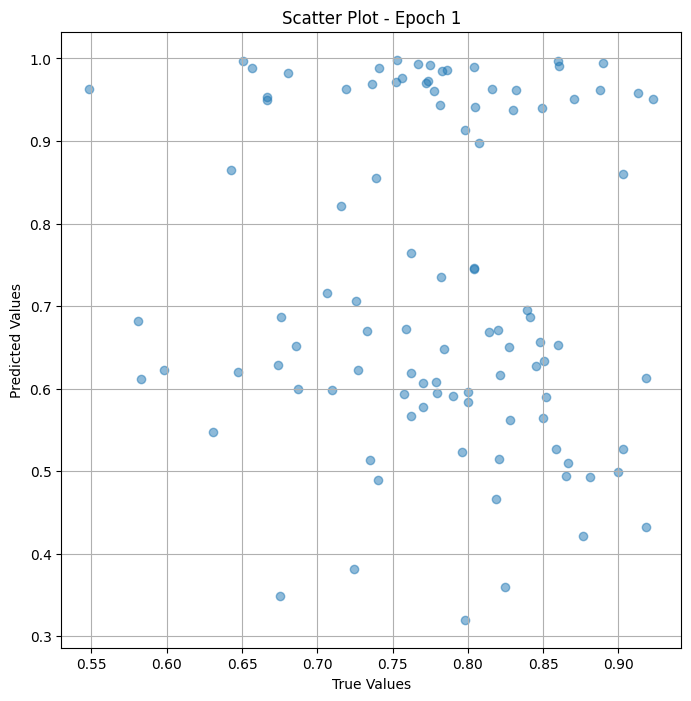

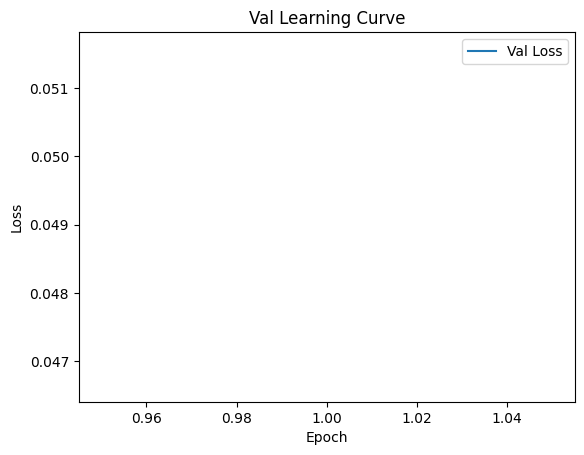


 Epoch: (2/50) Loss = 0.024205882102251053

 Epoch: (2/50) Loss_rmse = 0.15558239817619324

 Epoch: (2/50) R^2 = -1.7317407131195068

 Epoch: (2/50) MAE = 0.1378777027130127
Spearman correlation coefficient: SignificanceResult(statistic=0.1547706655584938, pvalue=0.13215438953465009)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.77777

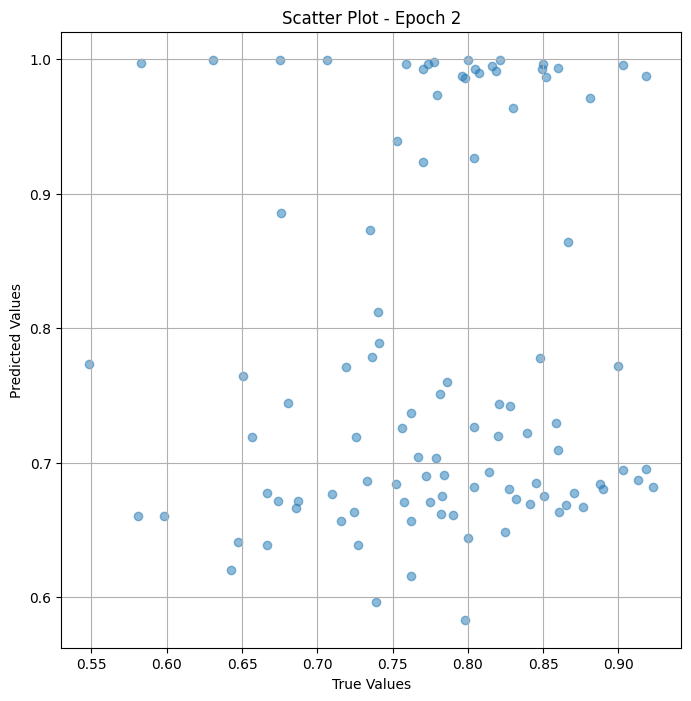

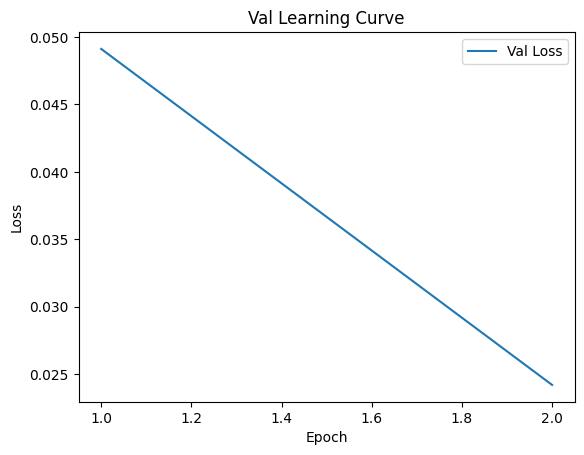


 Epoch: (3/50) Loss = 0.00880772341042757

 Epoch: (3/50) Loss_rmse = 0.09384947270154953

 Epoch: (3/50) R^2 = 0.006009519100189209

 Epoch: (3/50) MAE = 0.07298603653907776
Spearman correlation coefficient: SignificanceResult(statistic=0.10046969056128527, pvalue=0.3300714647601344)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.7777

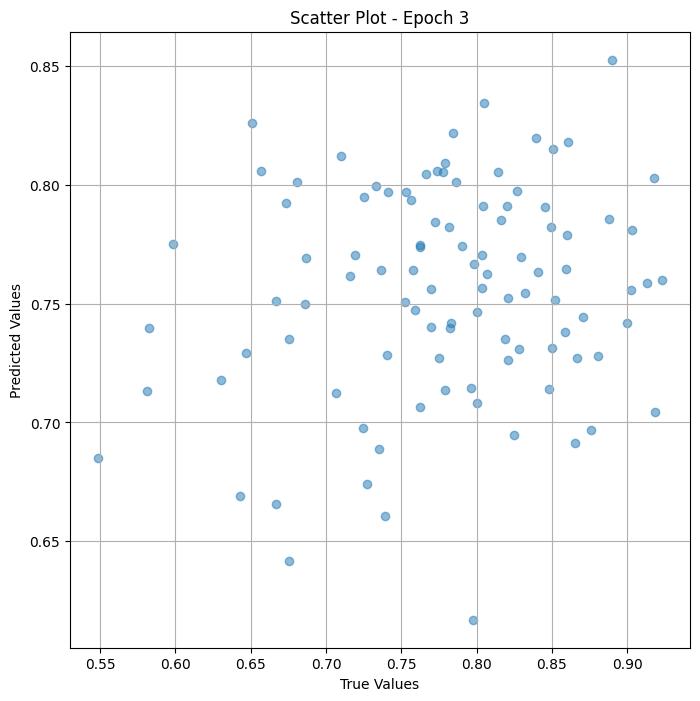

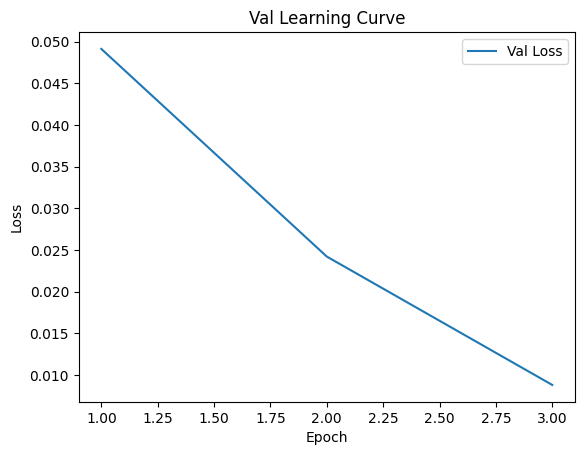


 Epoch: (4/50) Loss = 0.0028721706476062536

 Epoch: (4/50) Loss_rmse = 0.05359263718128204

 Epoch: (4/50) R^2 = 0.6758628487586975

 Epoch: (4/50) MAE = 0.049998000264167786
Spearman correlation coefficient: SignificanceResult(statistic=0.4080712166758745, pvalue=3.674596447832392e-05)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.7

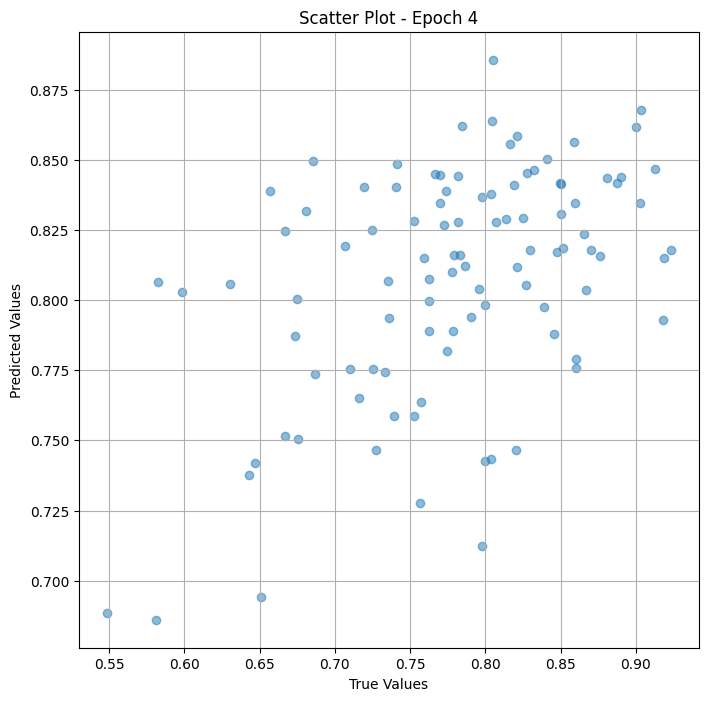

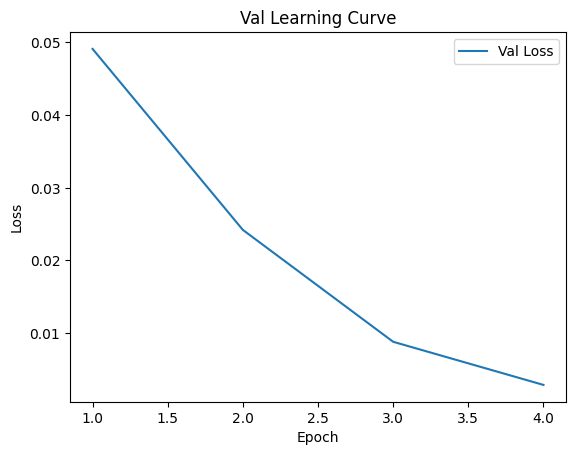


 Epoch: (5/50) Loss = 0.0023202840238809586

 Epoch: (5/50) Loss_rmse = 0.0481693260371685

 Epoch: (5/50) R^2 = 0.7381457090377808

 Epoch: (5/50) MAE = 0.038457468152046204
Spearman correlation coefficient: SignificanceResult(statistic=0.3690309453688632, pvalue=0.0002157085836435188)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.77

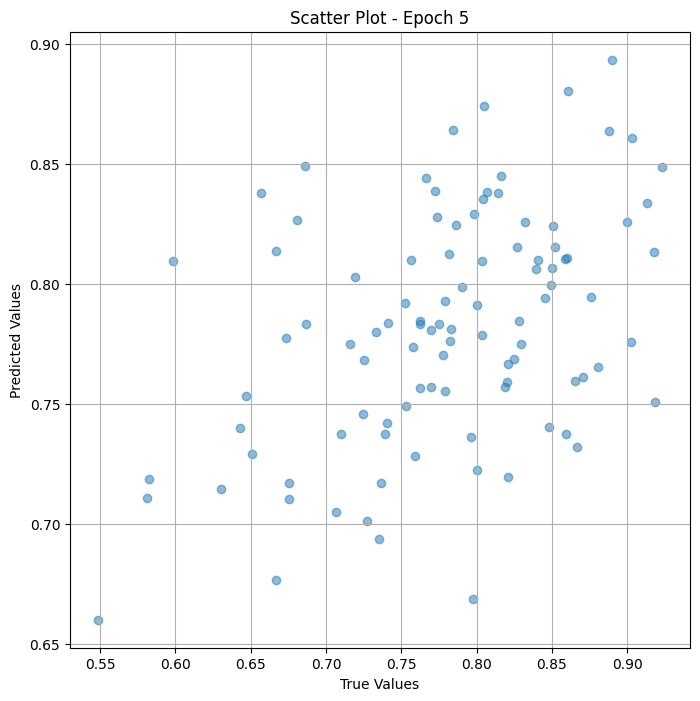

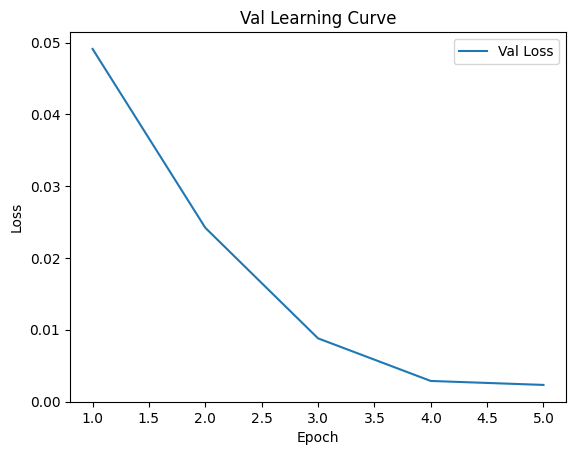


 Epoch: (6/50) Loss = 0.00014059740351513028

 Epoch: (6/50) Loss_rmse = 0.011857377365231514

 Epoch: (6/50) R^2 = 0.9841329455375671

 Epoch: (6/50) MAE = 0.010188326239585876
Spearman correlation coefficient: SignificanceResult(statistic=0.5862212802877506, pvalue=3.4922406933565335e-10)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 

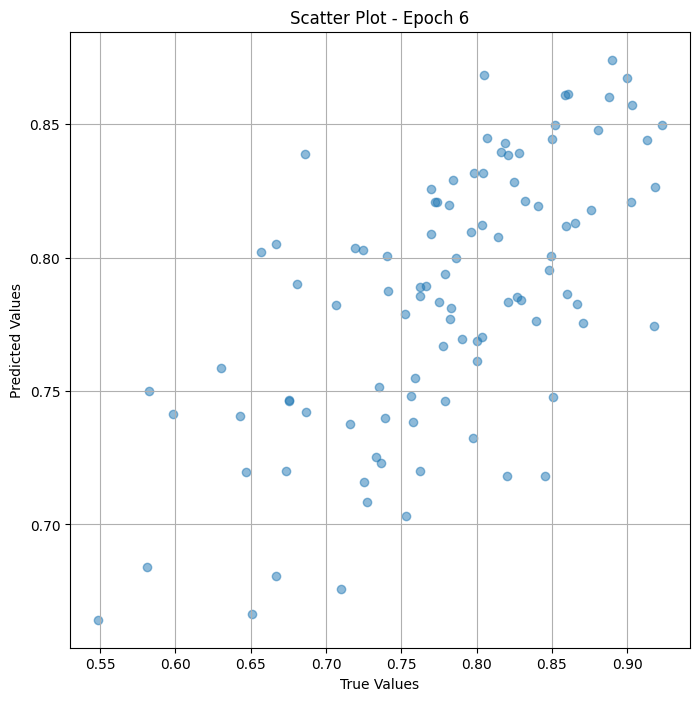

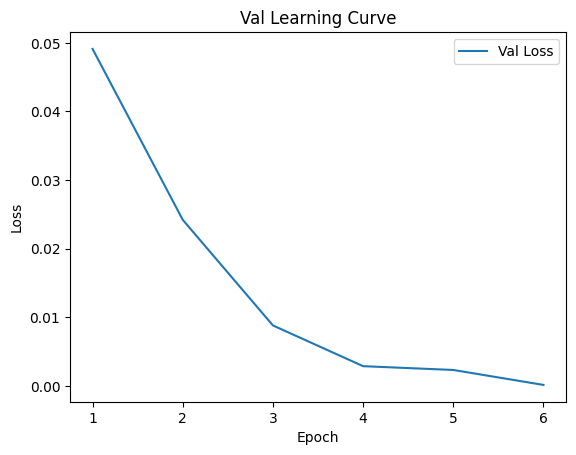


 Epoch: (7/50) Loss = 0.00015584116044919938

 Epoch: (7/50) Loss_rmse = 0.012483635917305946

 Epoch: (7/50) R^2 = 0.9824126362800598

 Epoch: (7/50) MAE = 0.010810211300849915
Spearman correlation coefficient: SignificanceResult(statistic=0.6728885121781241, pvalue=5.951419067656863e-14)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0

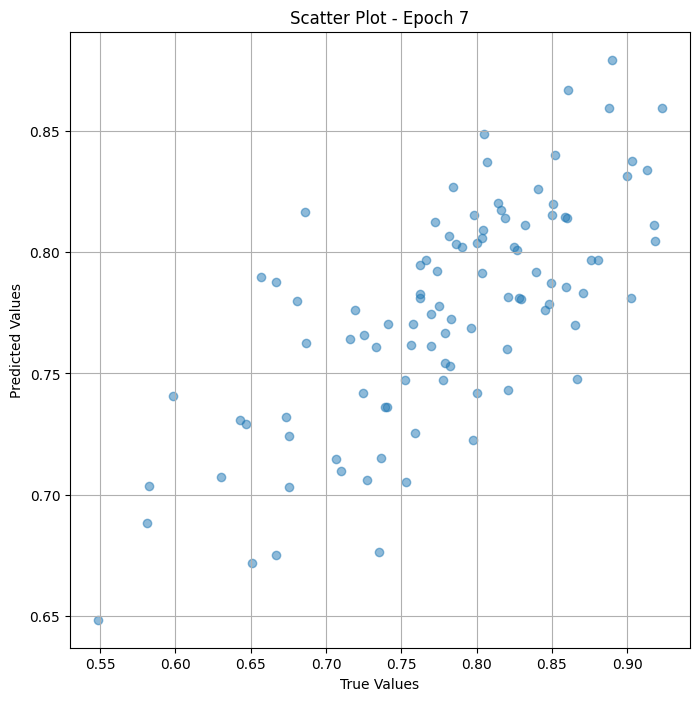

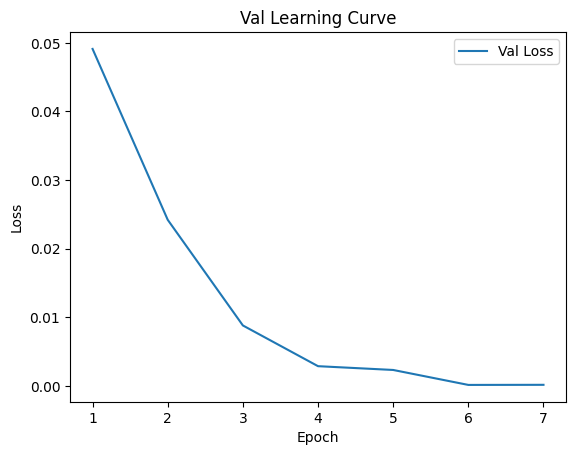


 Epoch: (8/50) Loss = 8.644583431305364e-05

 Epoch: (8/50) Loss_rmse = 0.009297625161707401

 Epoch: (8/50) R^2 = 0.9902442097663879

 Epoch: (8/50) MAE = 0.007131204009056091
Spearman correlation coefficient: SignificanceResult(statistic=0.8410546843091244, pvalue=8.022736495892133e-27)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.

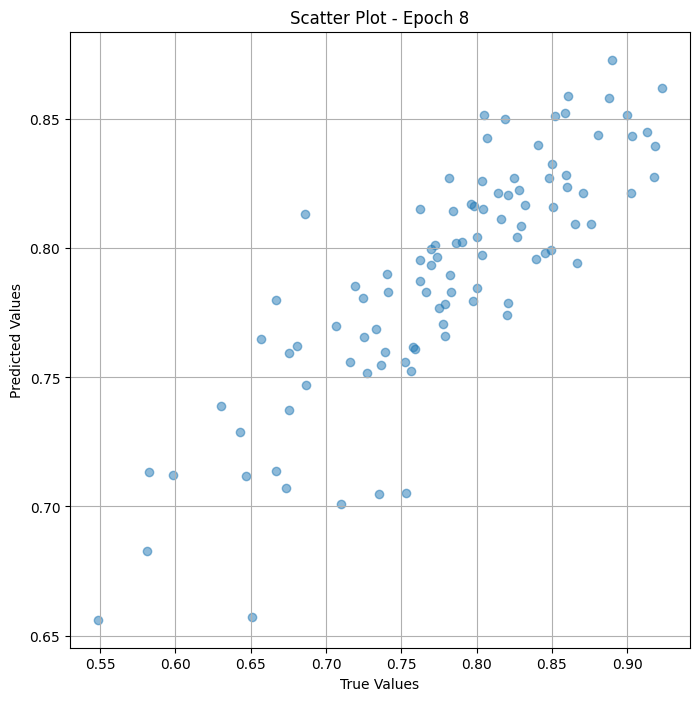

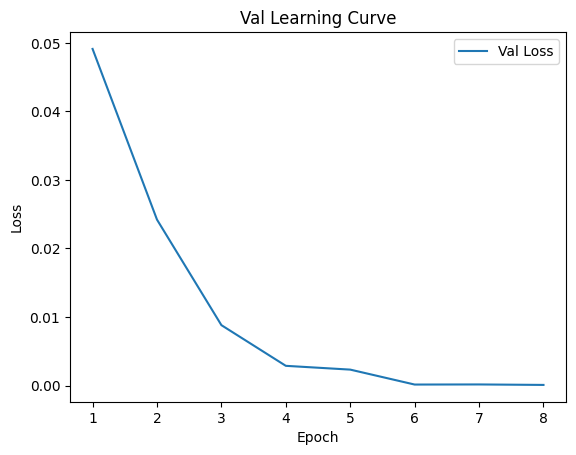


 Epoch: (9/50) Loss = 4.644754881155677e-05

 Epoch: (9/50) Loss_rmse = 0.006815243978053331

 Epoch: (9/50) R^2 = 0.9947581887245178

 Epoch: (9/50) MAE = 0.005659446120262146
Spearman correlation coefficient: SignificanceResult(statistic=0.8726341671453725, pvalue=5.185128863709602e-31)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.

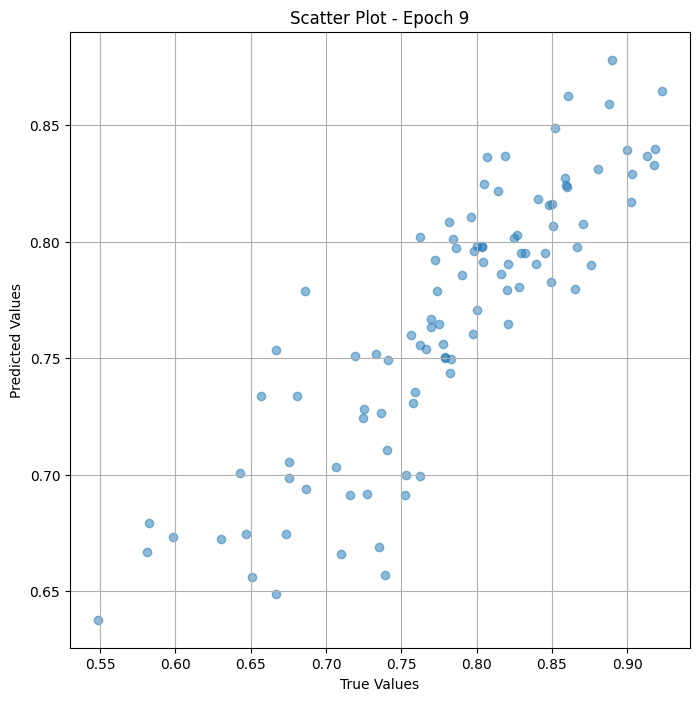

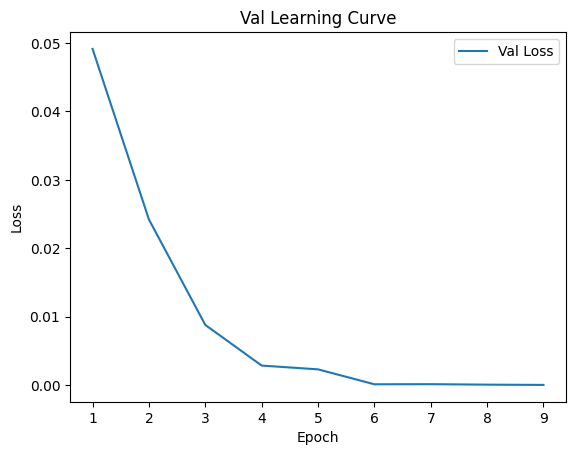


 Epoch: (10/50) Loss = 1.6930520359892398e-05

 Epoch: (10/50) Loss_rmse = 0.004114671144634485

 Epoch: (10/50) R^2 = 0.9980893135070801

 Epoch: (10/50) MAE = 0.0035745948553085327
Spearman correlation coefficient: SignificanceResult(statistic=0.9070012718556968, pvalue=4.472587581112193e-37)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

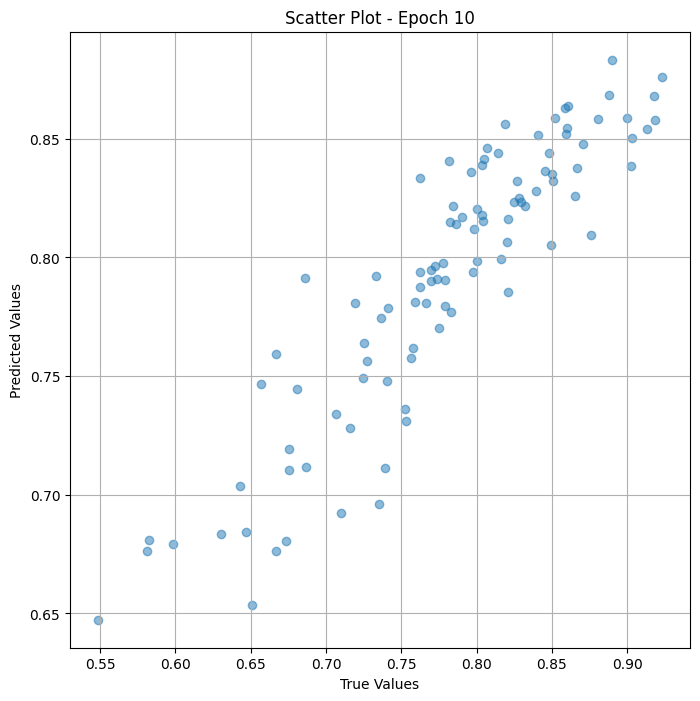

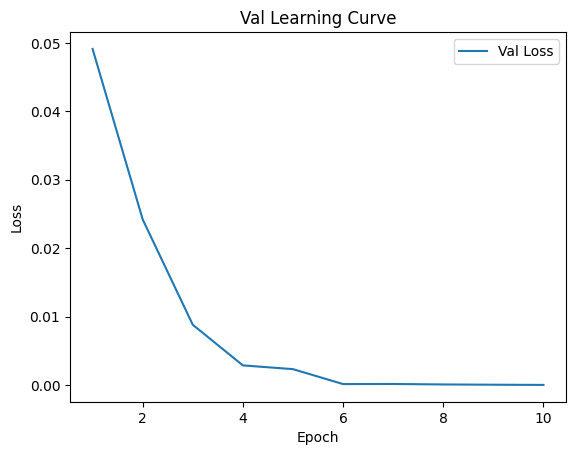


 Epoch: (11/50) Loss = 5.7624143664725125e-05

 Epoch: (11/50) Loss_rmse = 0.007591056637465954

 Epoch: (11/50) R^2 = 0.993496835231781

 Epoch: (11/50) MAE = 0.0061935484409332275
Spearman correlation coefficient: SignificanceResult(statistic=0.9394624842384895, pvalue=1.6478697114407245e-45)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

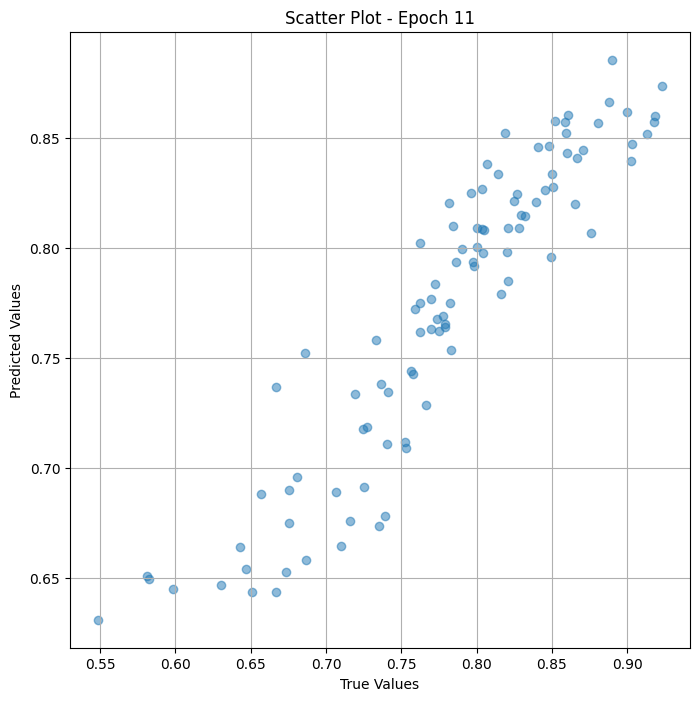

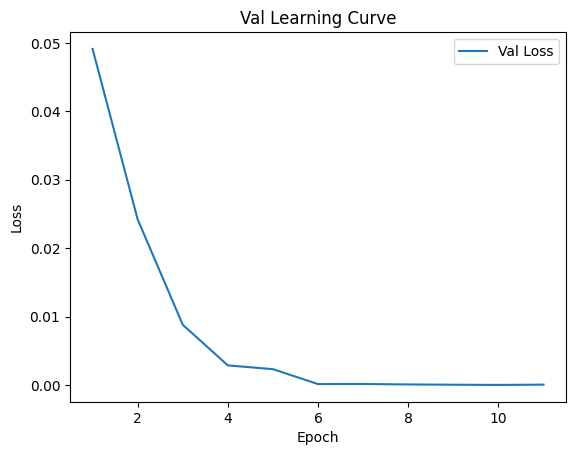


 Epoch: (12/50) Loss = 1.4139304767013527e-05

 Epoch: (12/50) Loss_rmse = 0.003760226769372821

 Epoch: (12/50) R^2 = 0.998404324054718

 Epoch: (12/50) MAE = 0.0031281858682632446
Spearman correlation coefficient: SignificanceResult(statistic=0.9508842731337306, pvalue=1.1584125108054276e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

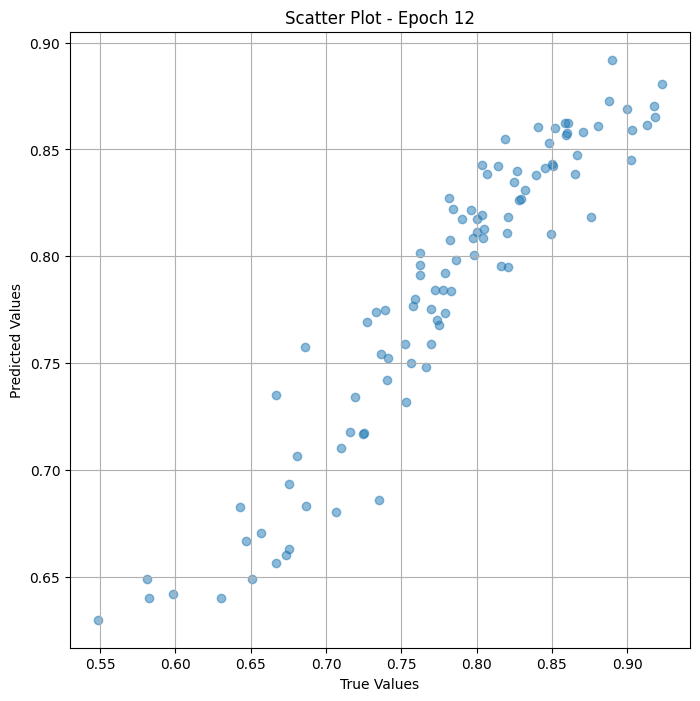

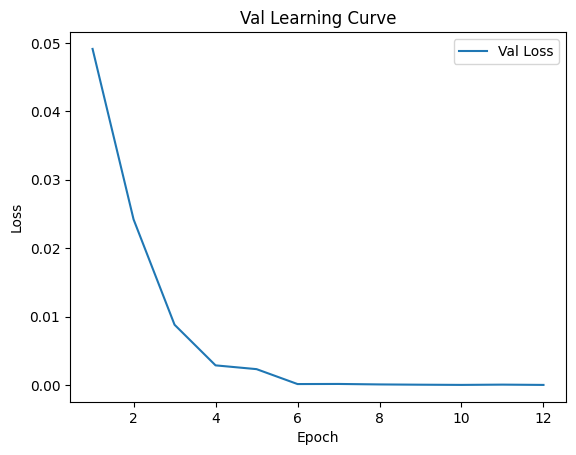


 Epoch: (13/50) Loss = 1.920839713420719e-05

 Epoch: (13/50) Loss_rmse = 0.0043827383778989315

 Epoch: (13/50) R^2 = 0.9978322386741638

 Epoch: (13/50) MAE = 0.003971993923187256
Spearman correlation coefficient: SignificanceResult(statistic=0.9694548538909573, pvalue=3.5805649757413957e-59)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

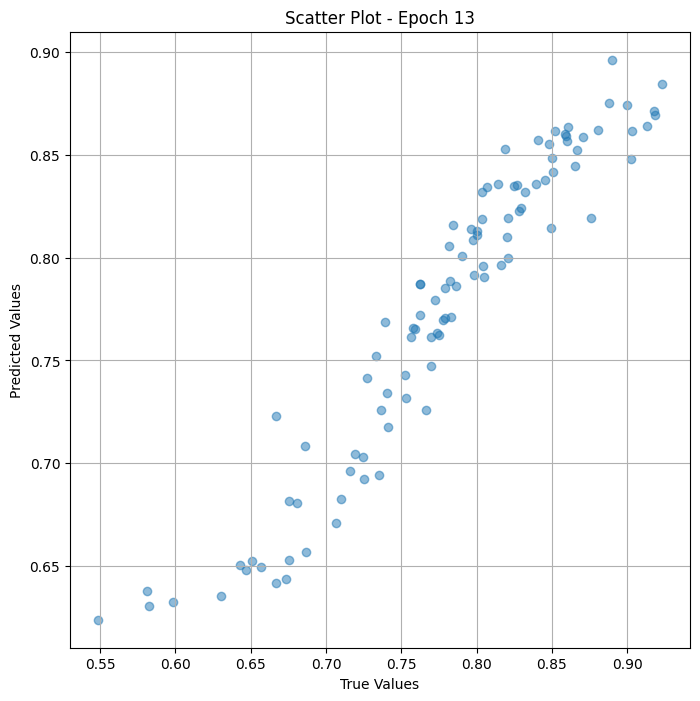

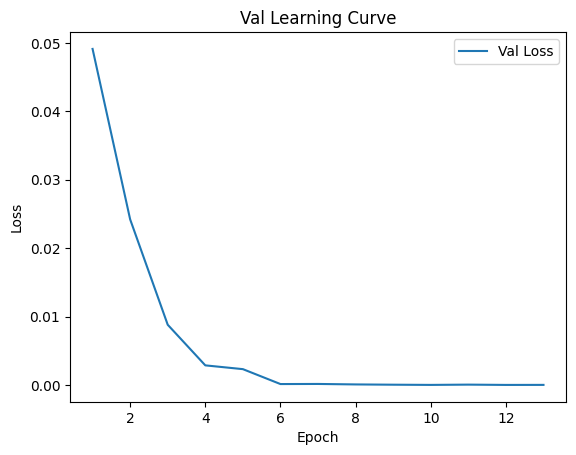


 Epoch: (14/50) Loss = 1.4111452401266433e-05

 Epoch: (14/50) Loss_rmse = 0.0037565212696790695

 Epoch: (14/50) R^2 = 0.9984074831008911

 Epoch: (14/50) MAE = 0.0035090893507003784
Spearman correlation coefficient: SignificanceResult(statistic=0.9756269607167705, pvalue=1.0176454578447286e-63)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.7523

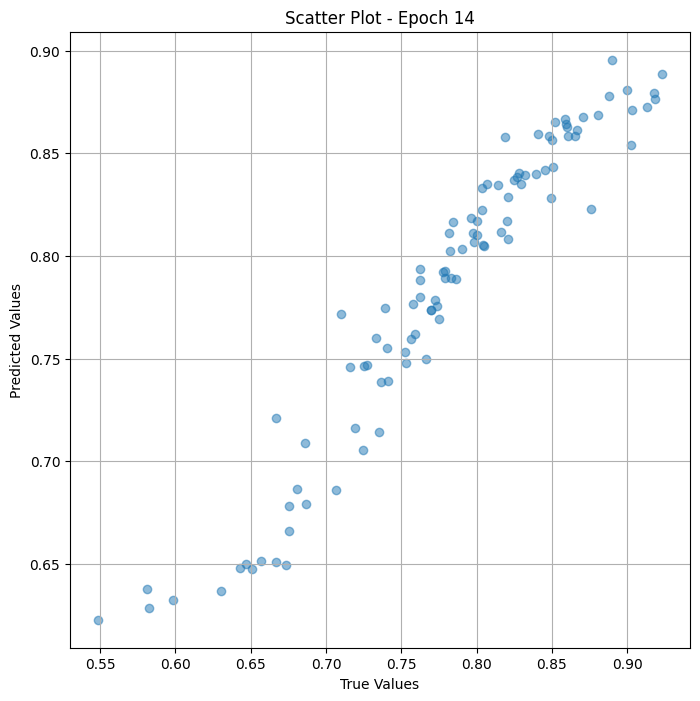

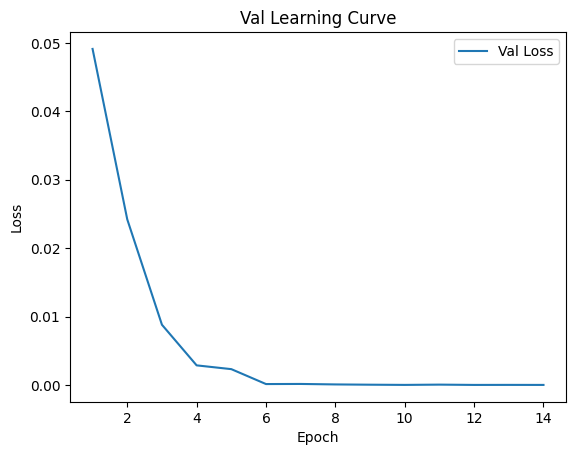


 Epoch: (15/50) Loss = 9.758492524269968e-05

 Epoch: (15/50) Loss_rmse = 0.009878507815301418

 Epoch: (15/50) R^2 = 0.9889870882034302

 Epoch: (15/50) MAE = 0.008403420448303223
Spearman correlation coefficient: SignificanceResult(statistic=0.9785502332903149, pvalue=2.6829430939283127e-66)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.7523809

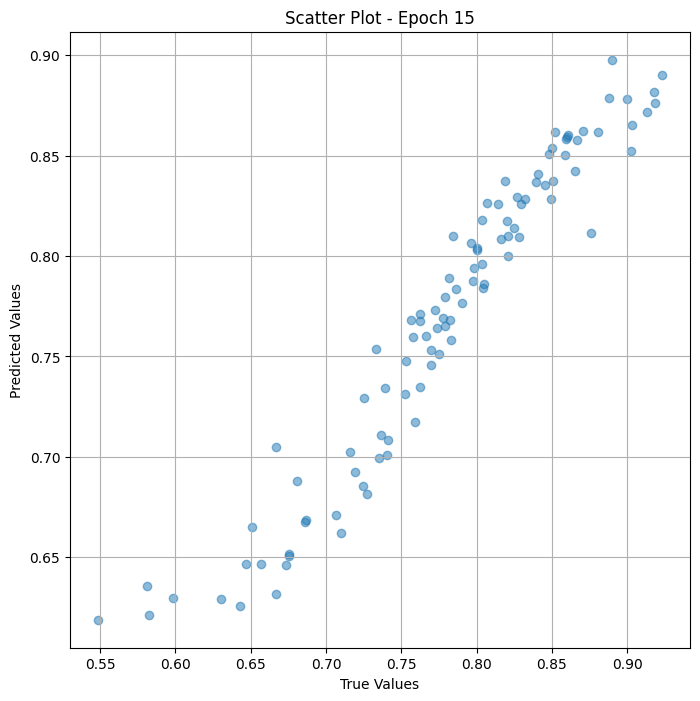

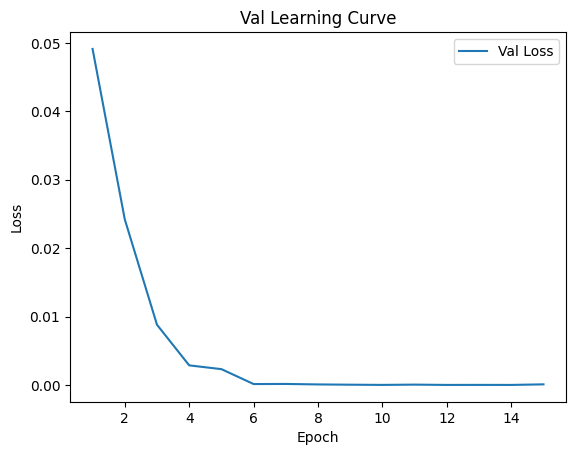


 Epoch: (16/50) Loss = 0.0001936254120664671

 Epoch: (16/50) Loss_rmse = 0.013914935290813446

 Epoch: (16/50) R^2 = 0.9781485199928284

 Epoch: (16/50) MAE = 0.011527076363563538
Spearman correlation coefficient: SignificanceResult(statistic=0.97172022057208, pvalue=1.0081255209018074e-60)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097,

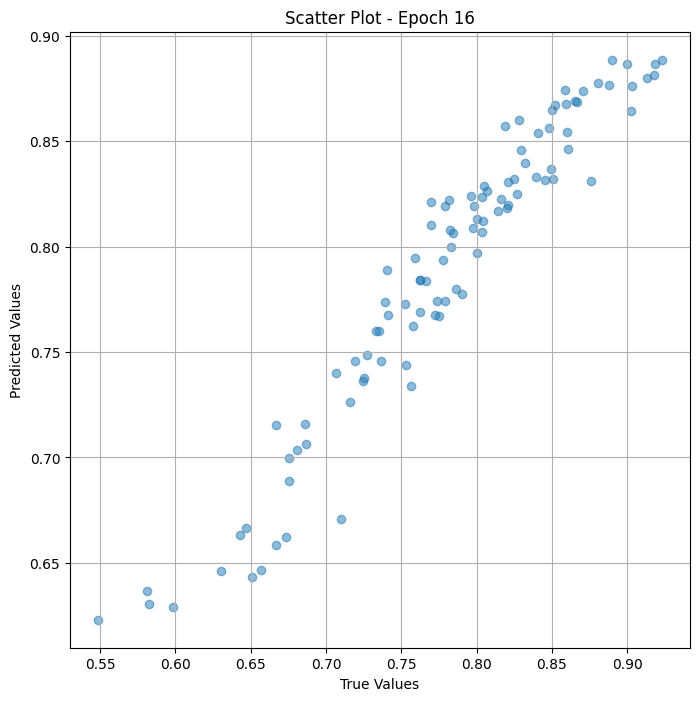

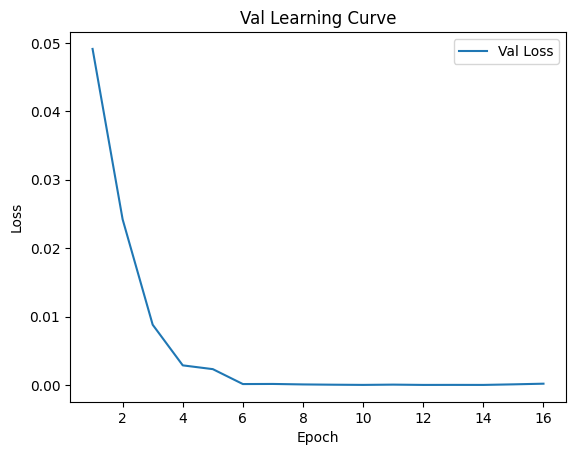


 Epoch: (17/50) Loss = 1.0238172762910835e-05

 Epoch: (17/50) Loss_rmse = 0.003199714468792081

 Epoch: (17/50) R^2 = 0.998844563961029

 Epoch: (17/50) MAE = 0.0028321146965026855
Spearman correlation coefficient: SignificanceResult(statistic=0.987849088738875, pvalue=8.318688077176545e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097

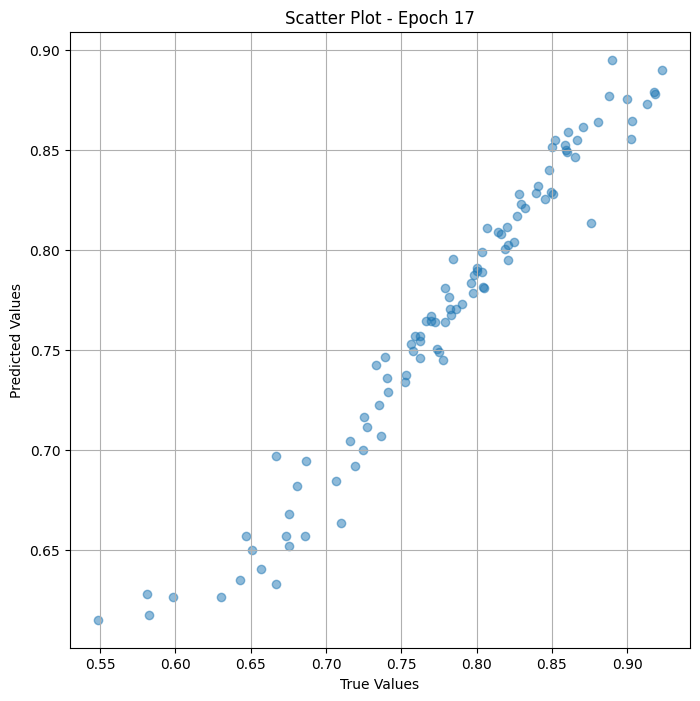

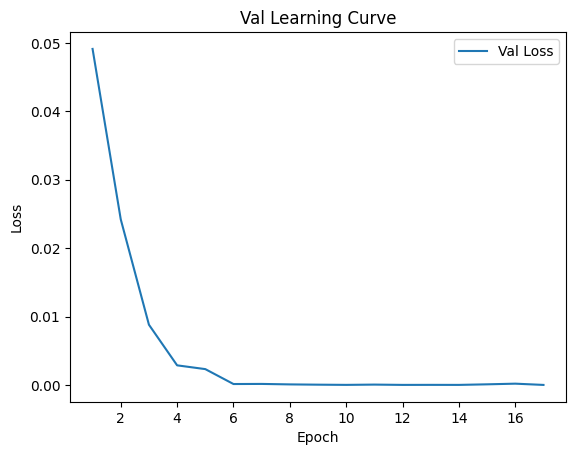


 Epoch: (18/50) Loss = 1.8624905351316556e-05

 Epoch: (18/50) Loss_rmse = 0.004315658006817102

 Epoch: (18/50) R^2 = 0.9978981018066406

 Epoch: (18/50) MAE = 0.00349368155002594
Spearman correlation coefficient: SignificanceResult(statistic=0.9811818568600023, pvalue=6.065250622285676e-69)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097

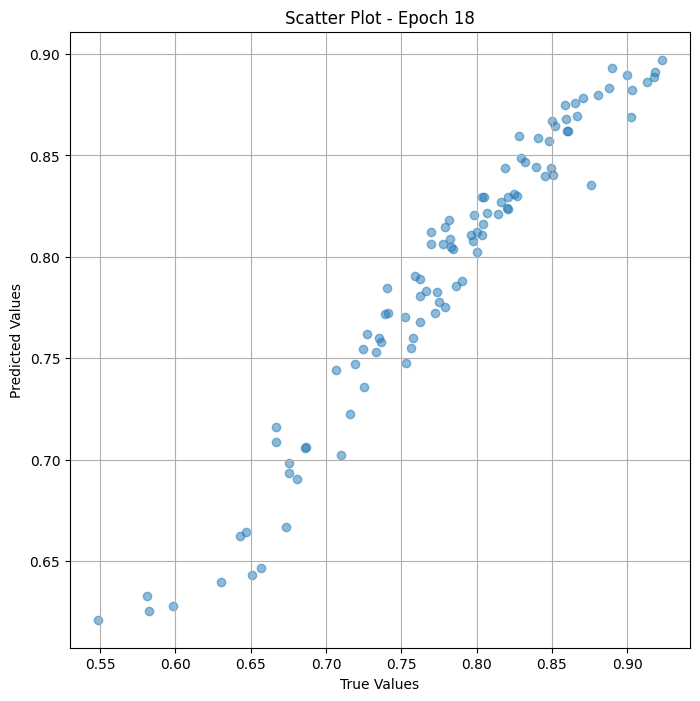

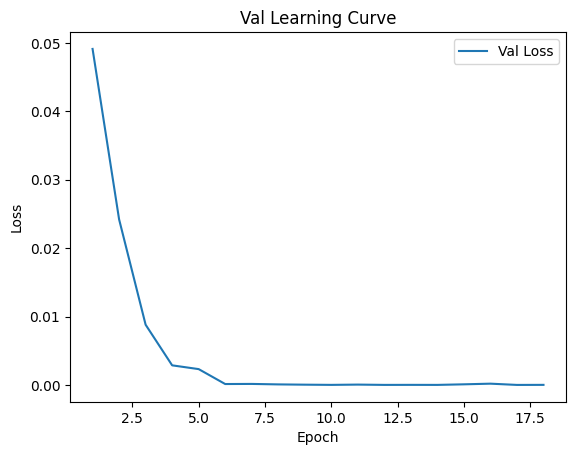


 Epoch: (19/50) Loss = 0.0001318490831181407

 Epoch: (19/50) Loss_rmse = 0.01148255541920662

 Epoch: (19/50) R^2 = 0.9851202368736267

 Epoch: (19/50) MAE = 0.010812073945999146
Spearman correlation coefficient: SignificanceResult(statistic=0.9892937686882137, pvalue=2.241651227363038e-80)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097,

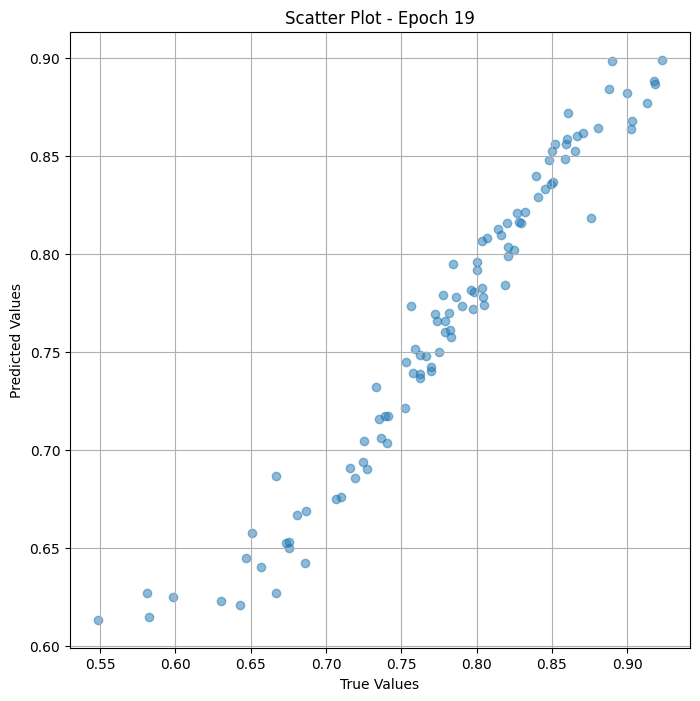

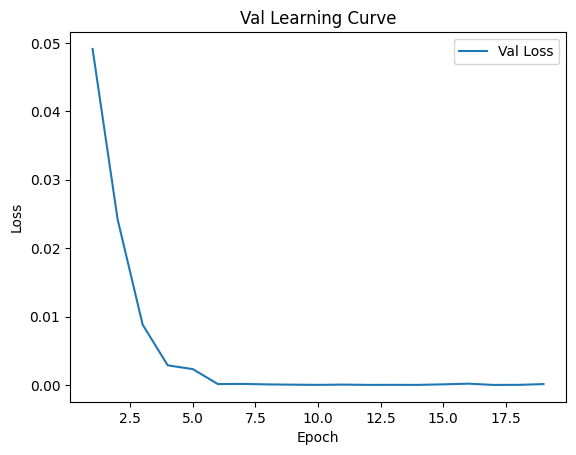

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (20/50) Loss = 7.57108282414265e-05

 Epoch: (20/50) Loss_rmse = 0.008701196871697903

 Epoch: (20/50) R^2 = 0.9914556741714478

 Epoch: (20/50) MAE = 0.008269205689430237
Spearman correlation coefficient: SignificanceResult(statistic=0.9765629505431025, pvalue=1.6502129273203324e-64)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0

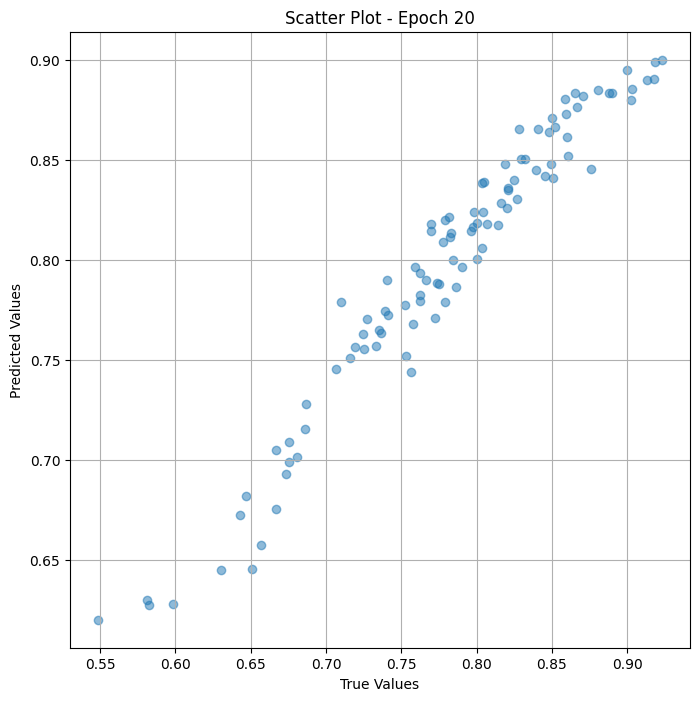

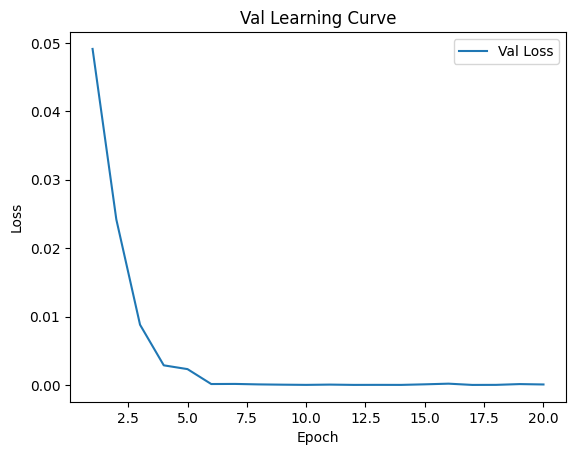


 Epoch: (21/50) Loss = 0.00021714027388952672

 Epoch: (21/50) Loss_rmse = 0.01473568007349968

 Epoch: (21/50) R^2 = 0.9754947423934937

 Epoch: (21/50) MAE = 0.014282405376434326
Spearman correlation coefficient: SignificanceResult(statistic=0.9927528615246584, pvalue=2.6269618076276787e-88)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.7523809

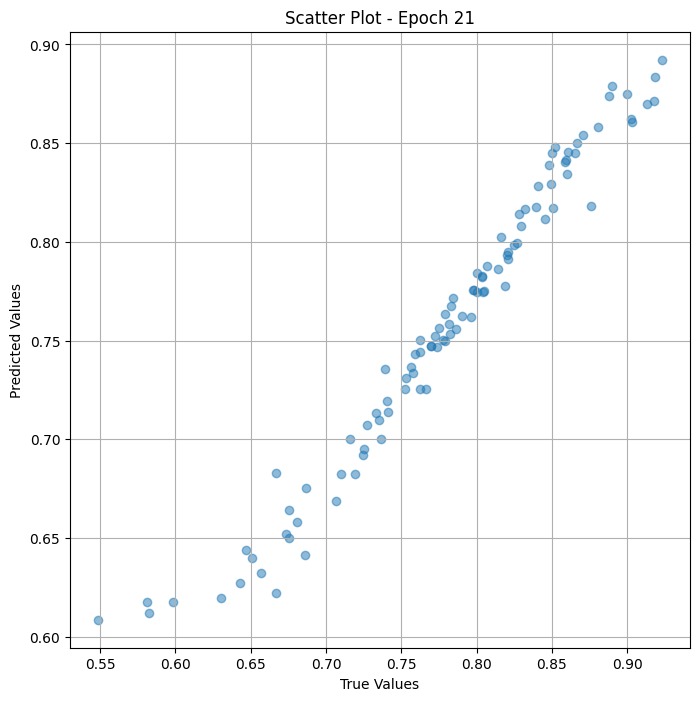

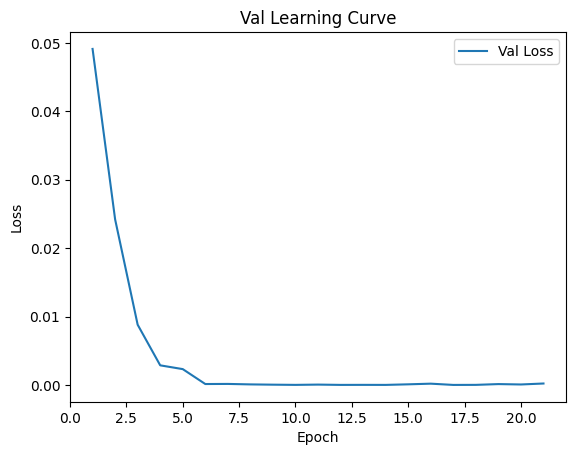


 Epoch: (22/50) Loss = 4.402956255944446e-05

 Epoch: (22/50) Loss_rmse = 0.006635477766394615

 Epoch: (22/50) R^2 = 0.9950310587882996

 Epoch: (22/50) MAE = 0.006396278738975525
Spearman correlation coefficient: SignificanceResult(statistic=0.9933972023471335, pvalue=3.350919558043969e-90)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097

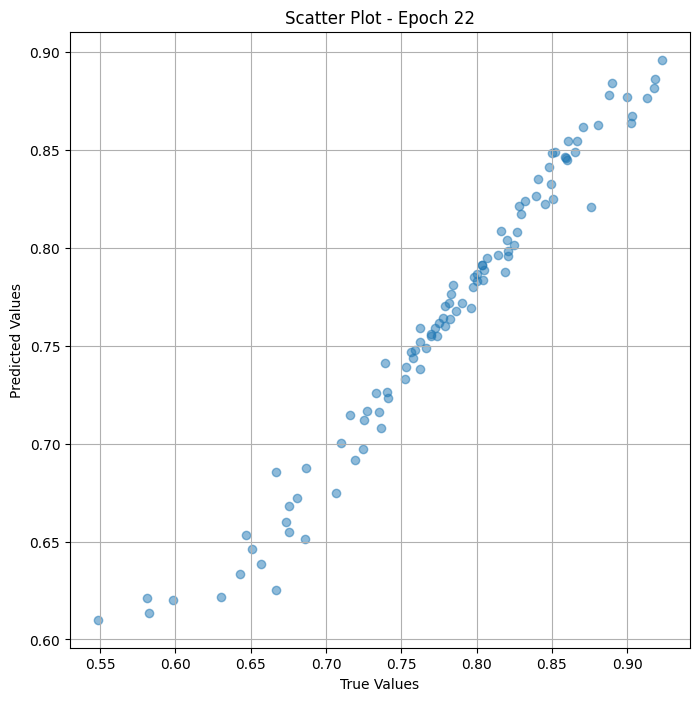

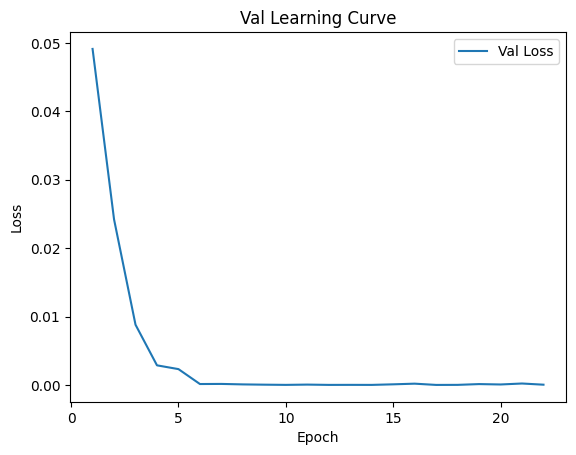


 Epoch: (23/50) Loss = 3.1120412131713238e-06

 Epoch: (23/50) Loss_rmse = 0.0017640978330746293

 Epoch: (23/50) R^2 = 0.9996488094329834

 Epoch: (23/50) MAE = 0.001325860619544983
Spearman correlation coefficient: SignificanceResult(statistic=0.9932276389727979, pvalue=1.0991818701818802e-89)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238

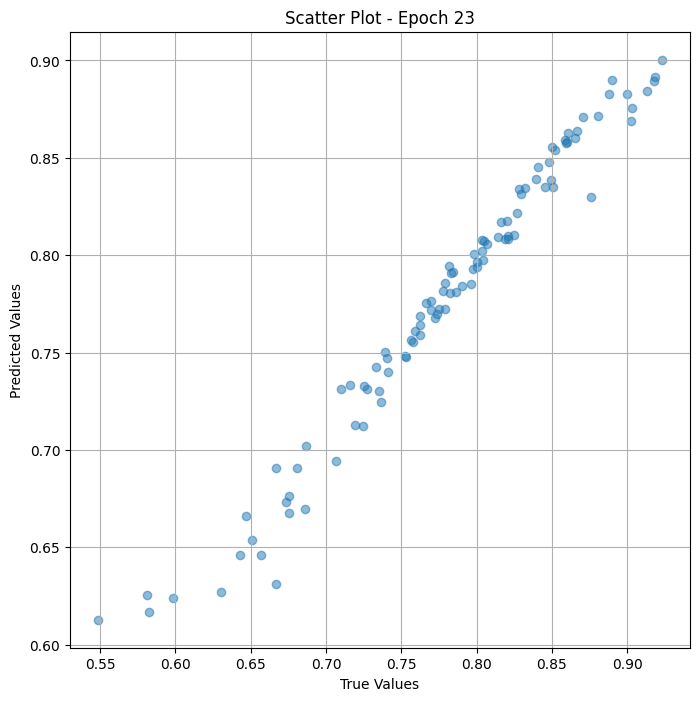

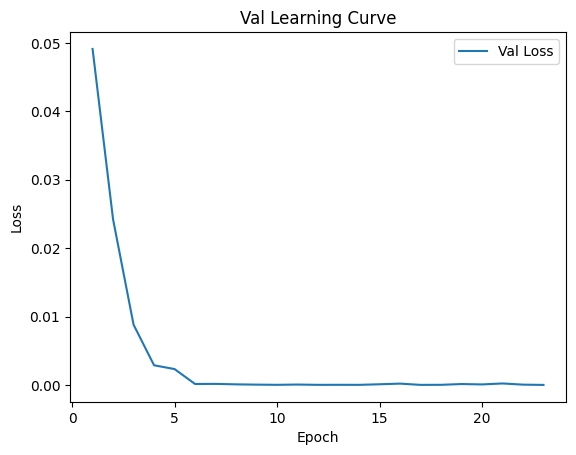


 Epoch: (24/50) Loss = 3.37075543939136e-05

 Epoch: (24/50) Loss_rmse = 0.005805820692330599

 Epoch: (24/50) R^2 = 0.9961959719657898

 Epoch: (24/50) MAE = 0.005493536591529846
Spearman correlation coefficient: SignificanceResult(statistic=0.9914709624146818, pvalue=5.386929541320047e-85)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097,

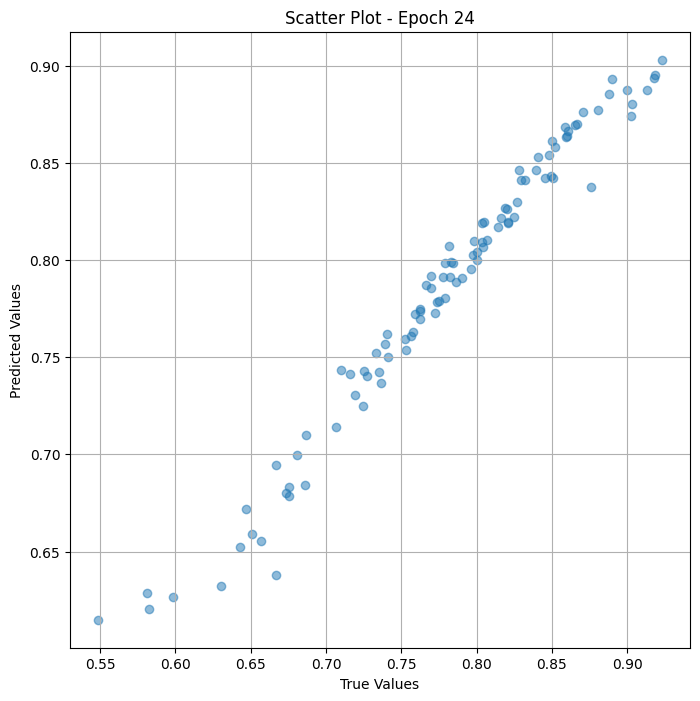

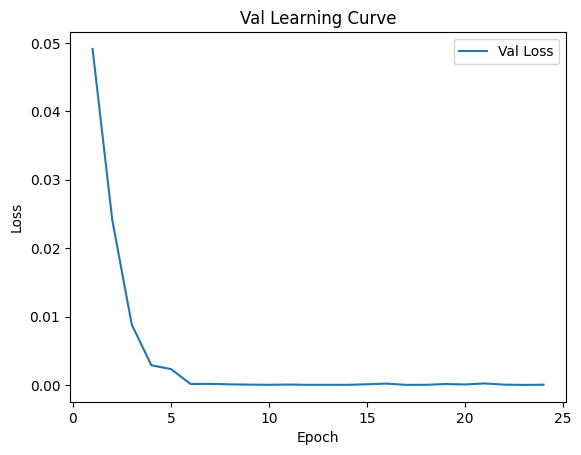


 Epoch: (25/50) Loss = 2.3287537260330282e-05

 Epoch: (25/50) Loss_rmse = 0.004825716372579336

 Epoch: (25/50) R^2 = 0.9973719120025635

 Epoch: (25/50) MAE = 0.004703238606452942
Spearman correlation coefficient: SignificanceResult(statistic=0.9913963545299743, pvalue=8.098135296846217e-85)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.7523809

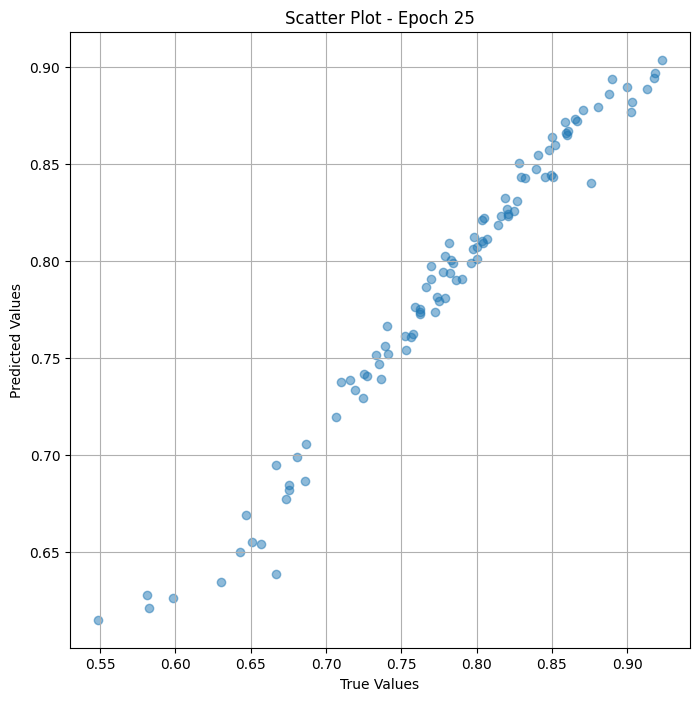

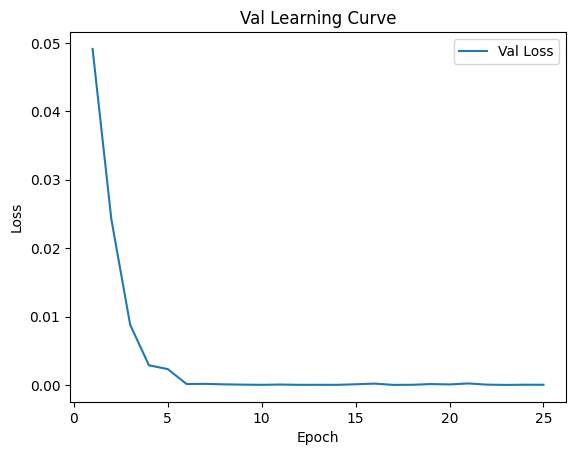

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (26/50) Loss = 7.235302746266825e-06

 Epoch: (26/50) Loss_rmse = 0.00268985191360116

 Epoch: (26/50) R^2 = 0.9991834759712219

 Epoch: (26/50) MAE = 0.002270817756652832
Spearman correlation coefficient: SignificanceResult(statistic=0.9922645190065722, pvalue=5.568472725340432e-87)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.

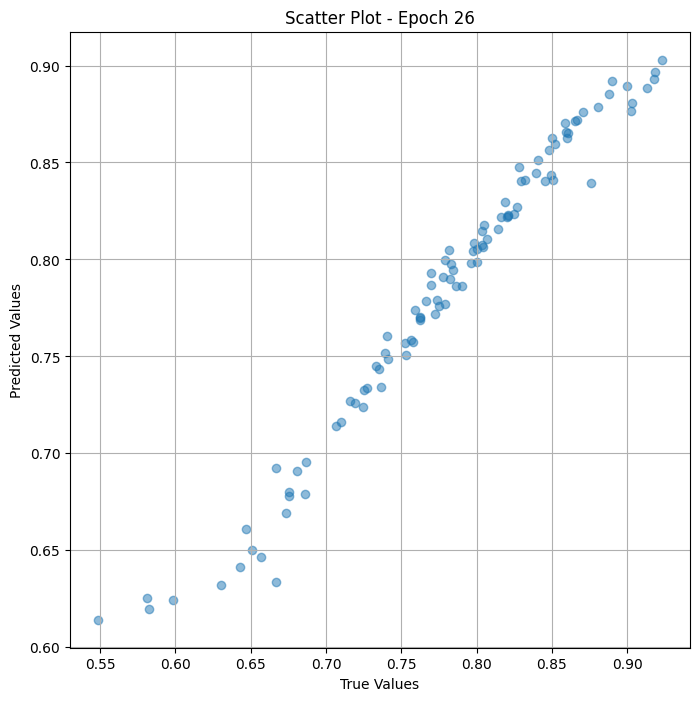

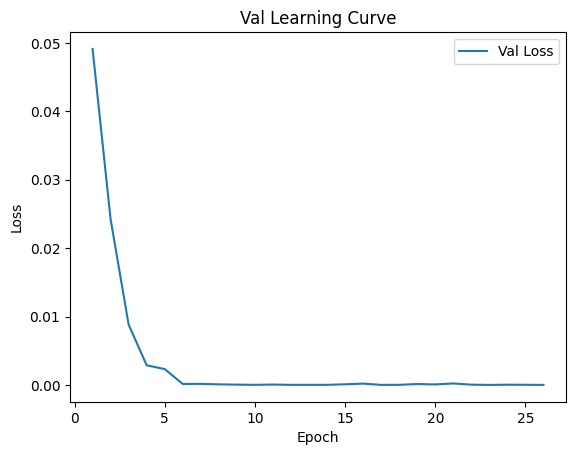


 Epoch: (27/50) Loss = 5.443544068839401e-06

 Epoch: (27/50) Loss_rmse = 0.002333140466362238

 Epoch: (27/50) R^2 = 0.9993856549263

 Epoch: (27/50) MAE = 0.0020528435707092285
Spearman correlation coefficient: SignificanceResult(statistic=0.9936074609313095, pvalue=7.356323742280661e-91)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 

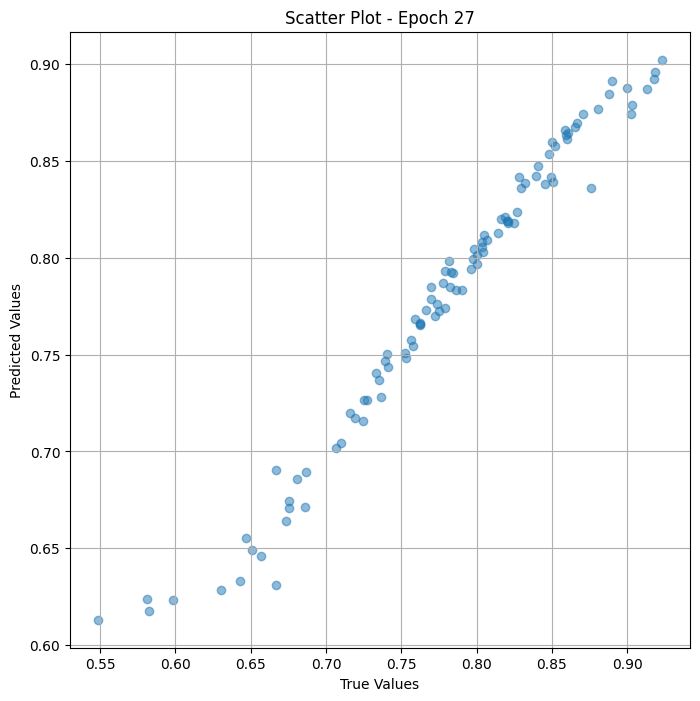

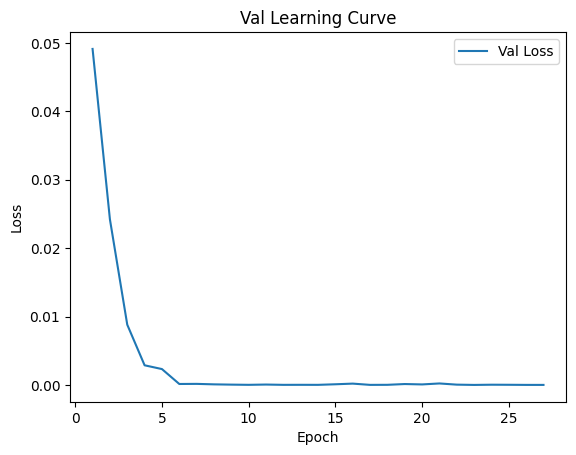


 Epoch: (28/50) Loss = 5.21048696100479e-06

 Epoch: (28/50) Loss_rmse = 0.0022826490458101034

 Epoch: (28/50) R^2 = 0.9994120001792908

 Epoch: (28/50) MAE = 0.001994788646697998
Spearman correlation coefficient: SignificanceResult(statistic=0.9937227640258577, pvalue=3.135162273659139e-91)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097

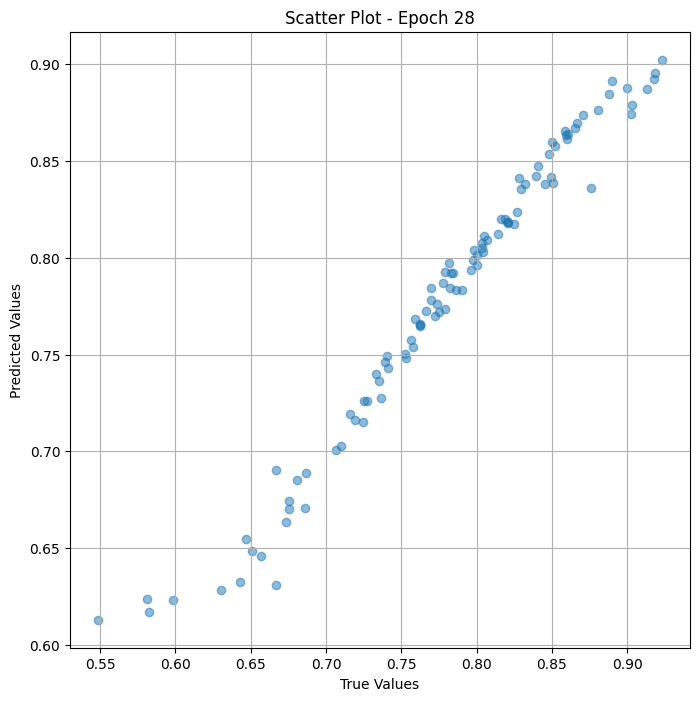

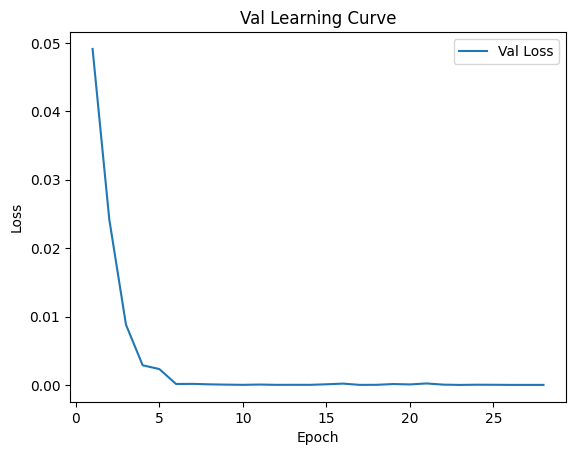

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (29/50) Loss = 5.05303478348651e-06

 Epoch: (29/50) Loss_rmse = 0.0022478955797851086

 Epoch: (29/50) R^2 = 0.9994297623634338

 Epoch: (29/50) MAE = 0.0019467025995254517
Spearman correlation coefficient: SignificanceResult(statistic=0.9937227640258577, pvalue=3.135162273659139e-91)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 

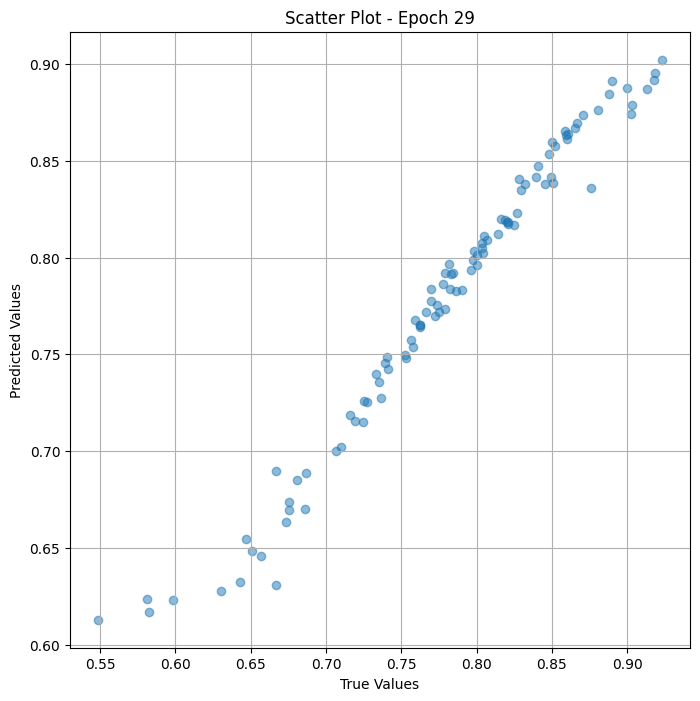

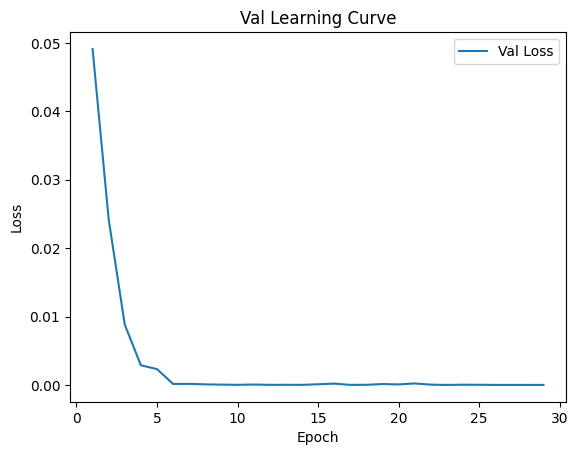


 Epoch: (30/50) Loss = 5.009014330425998e-06

 Epoch: (30/50) Loss_rmse = 0.0022380826994776726

 Epoch: (30/50) R^2 = 0.9994347095489502

 Epoch: (30/50) MAE = 0.001932978630065918
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.7523809

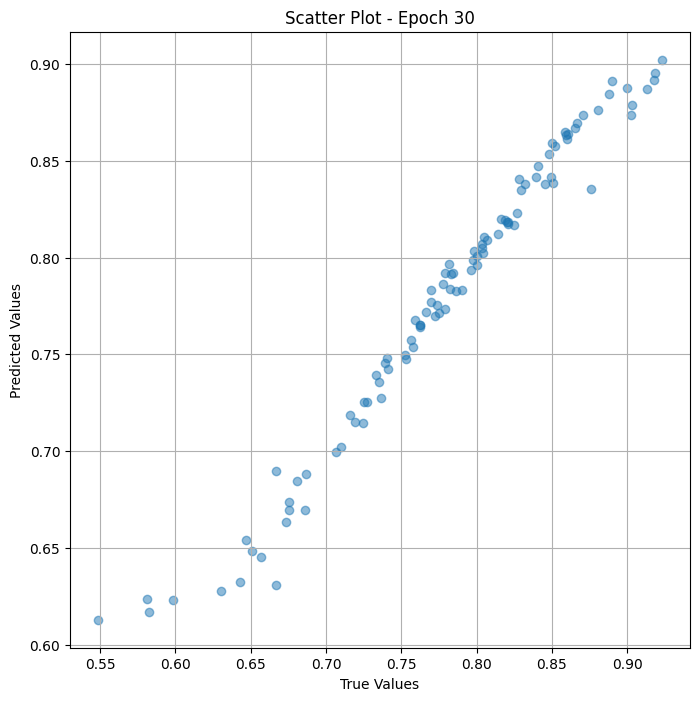

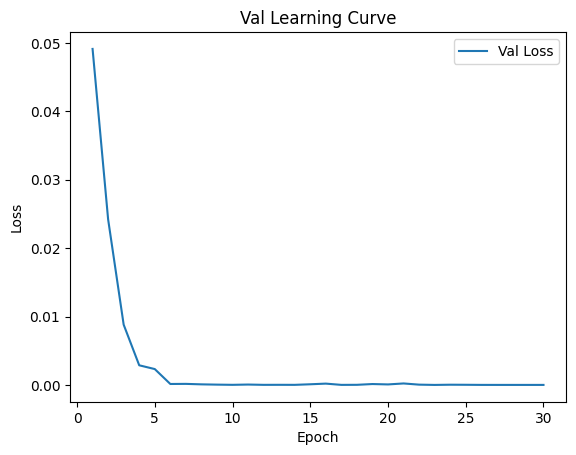


 Epoch: (31/50) Loss = 5.0006983656203374e-06

 Epoch: (31/50) Loss_rmse = 0.0022362242452800274

 Epoch: (31/50) R^2 = 0.9994356632232666

 Epoch: (31/50) MAE = 0.0019305795431137085
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238

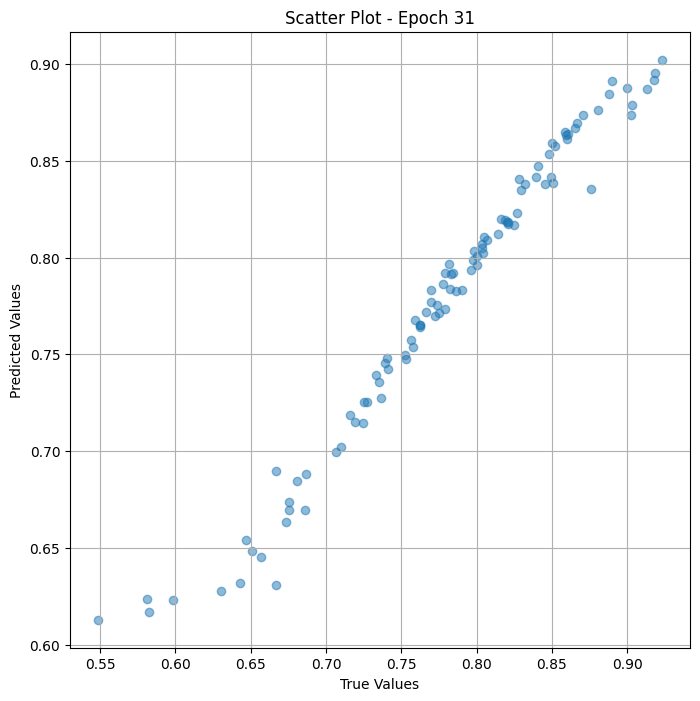

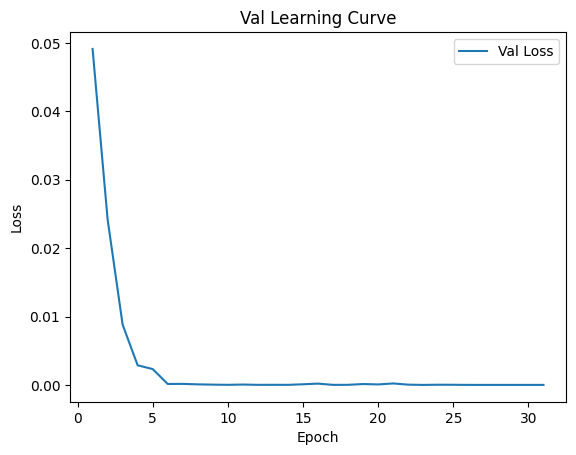

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (32/50) Loss = 4.992394678993151e-06

 Epoch: (32/50) Loss_rmse = 0.002234366722404957

 Epoch: (32/50) R^2 = 0.9994365572929382

 Epoch: (32/50) MAE = 0.0019285380840301514
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 

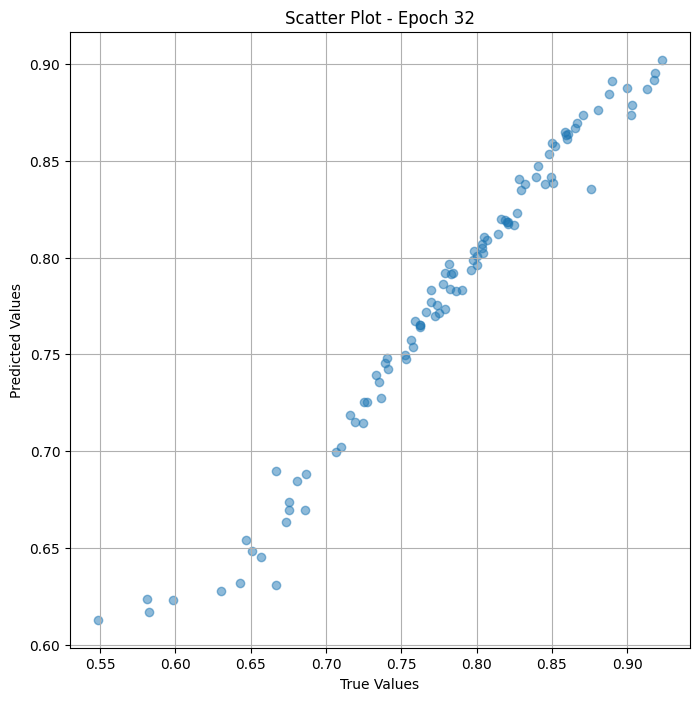

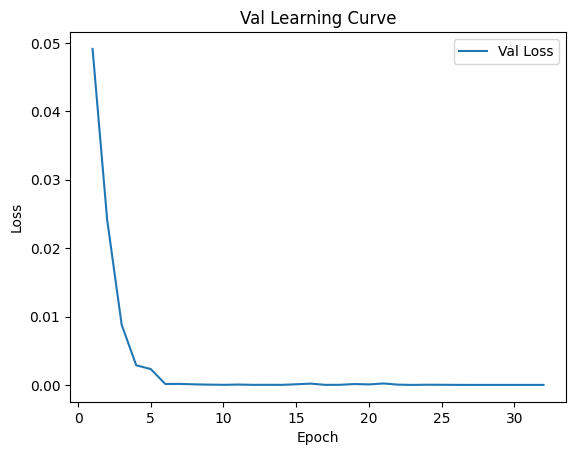


 Epoch: (33/50) Loss = 4.989720309822587e-06

 Epoch: (33/50) Loss_rmse = 0.0022337681148201227

 Epoch: (33/50) R^2 = 0.9994369149208069

 Epoch: (33/50) MAE = 0.0019279122352600098
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

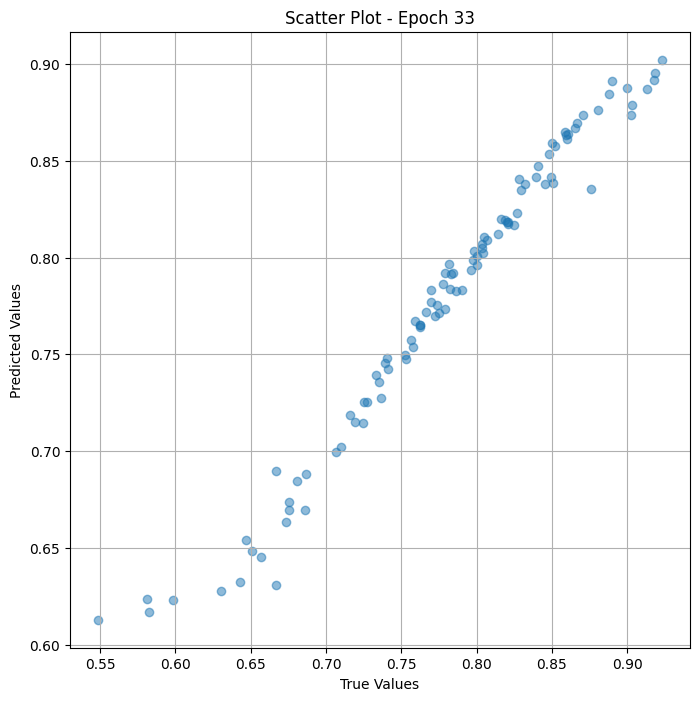

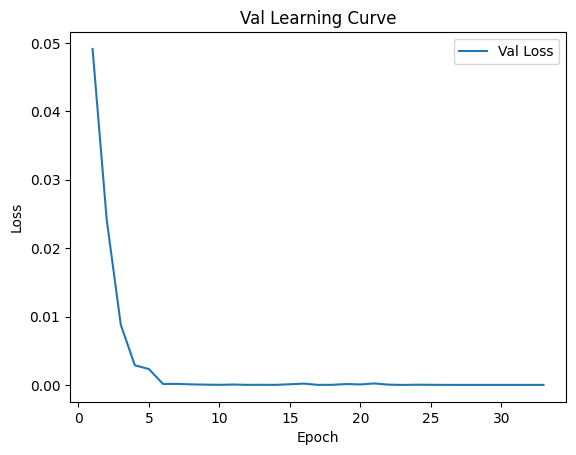


 Epoch: (34/50) Loss = 4.98963981954148e-06

 Epoch: (34/50) Loss_rmse = 0.0022337501868605614

 Epoch: (34/50) R^2 = 0.9994369149208069

 Epoch: (34/50) MAE = 0.001927897334098816
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097

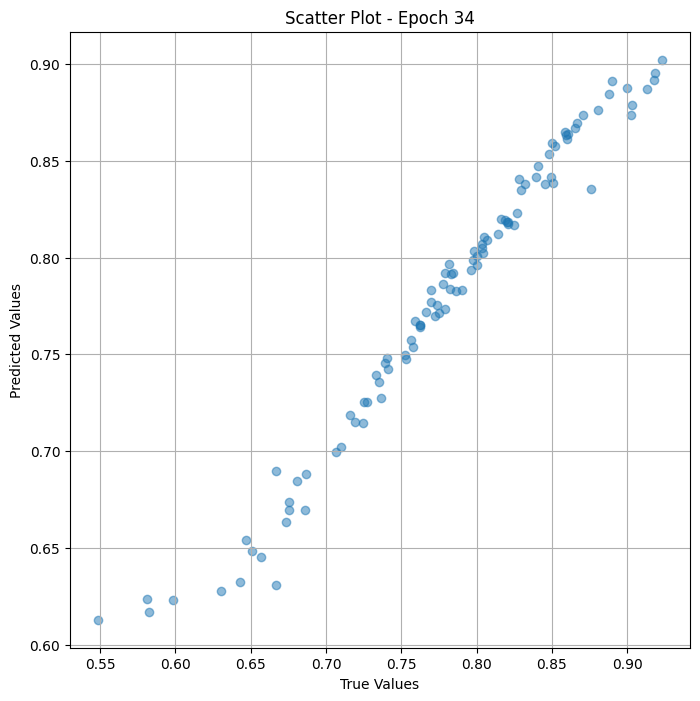

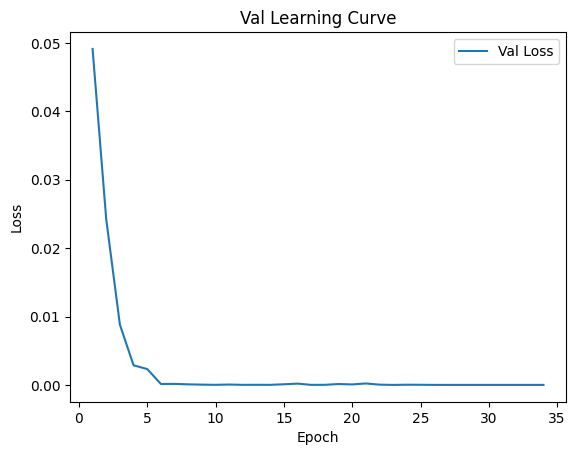


 Epoch: (35/50) Loss = 4.989522494724952e-06

 Epoch: (35/50) Loss_rmse = 0.0022337238769978285

 Epoch: (35/50) R^2 = 0.9994369149208069

 Epoch: (35/50) MAE = 0.0019278675317764282
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

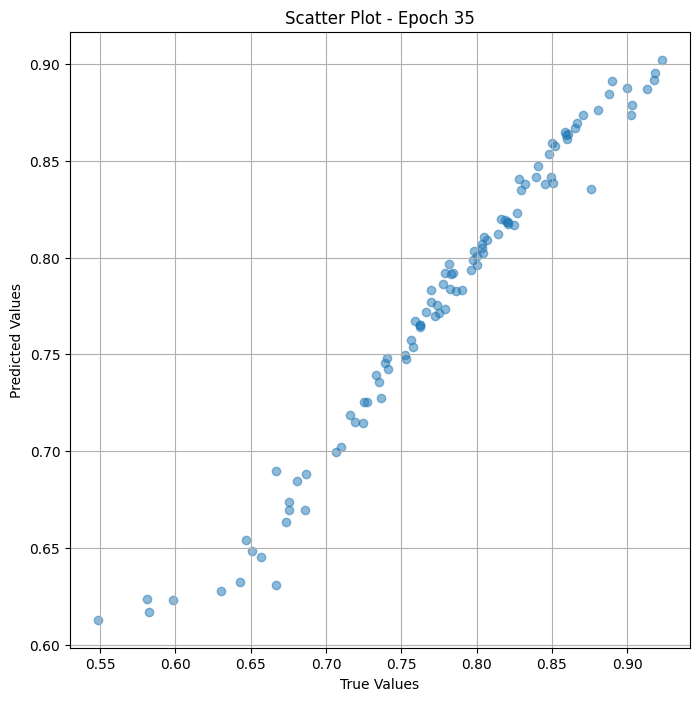

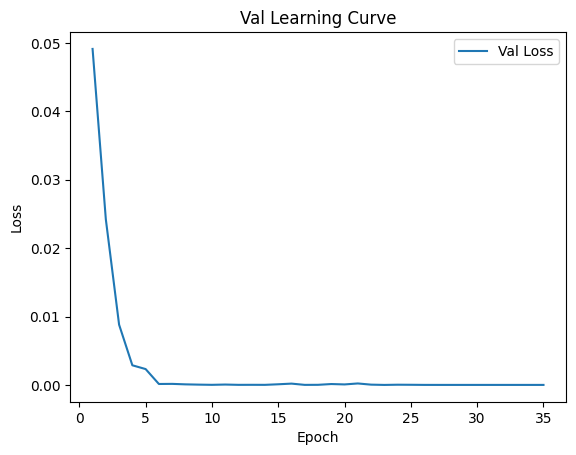


 Epoch: (36/50) Loss = 4.989188710169401e-06

 Epoch: (36/50) Loss_rmse = 0.0022336491383612156

 Epoch: (36/50) R^2 = 0.9994369745254517

 Epoch: (36/50) MAE = 0.0019278079271316528
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

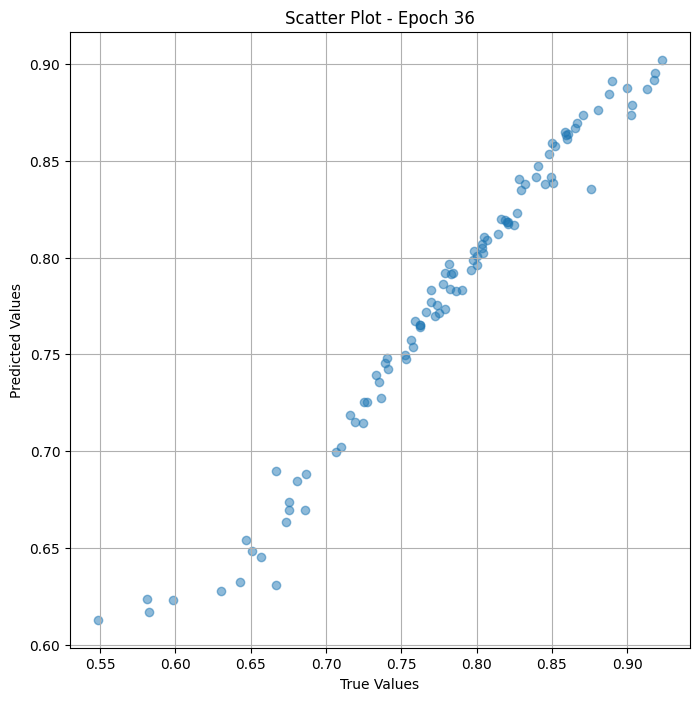

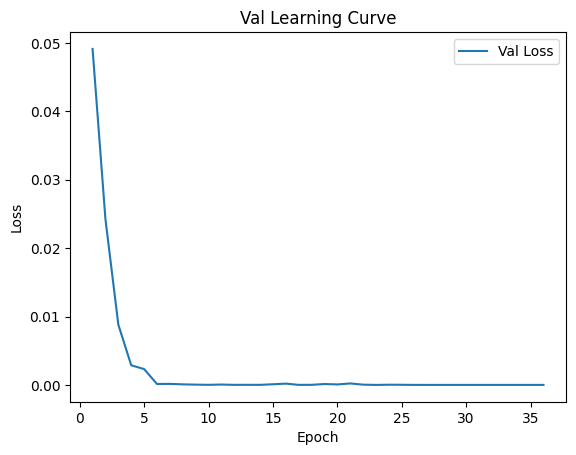


 Epoch: (37/50) Loss = 4.989188710169401e-06

 Epoch: (37/50) Loss_rmse = 0.0022336491383612156

 Epoch: (37/50) R^2 = 0.9994369745254517

 Epoch: (37/50) MAE = 0.0019278079271316528
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

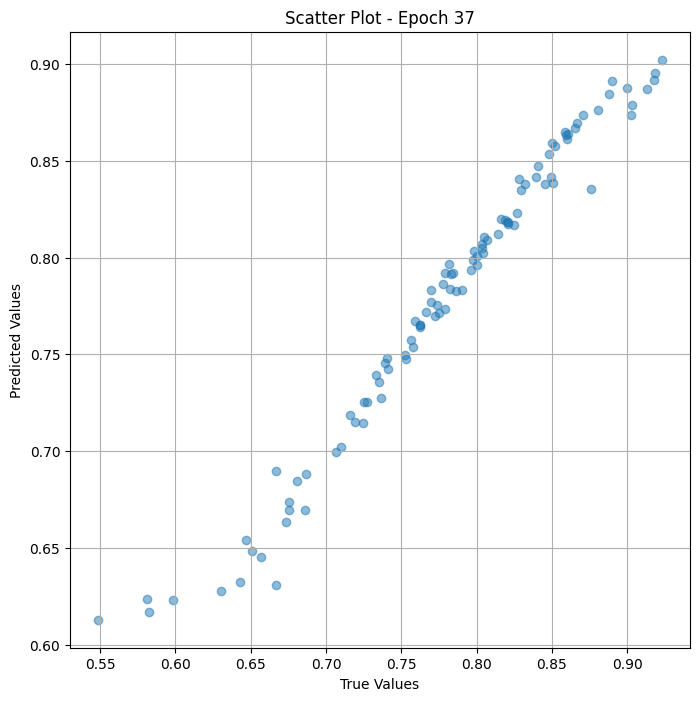

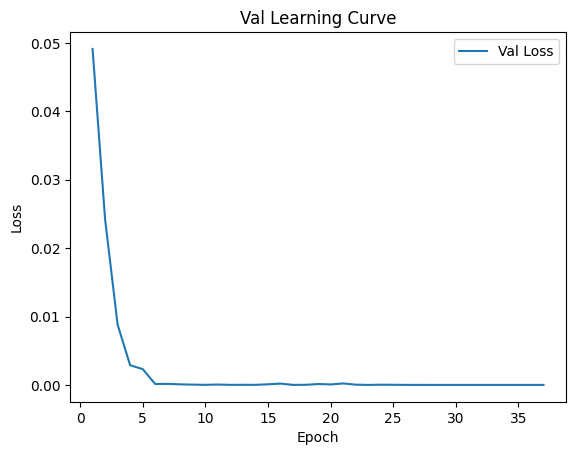


 Epoch: (38/50) Loss = 4.989075023331679e-06

 Epoch: (38/50) Loss_rmse = 0.0022336237598210573

 Epoch: (38/50) R^2 = 0.9994369745254517

 Epoch: (38/50) MAE = 0.0019278079271316528
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

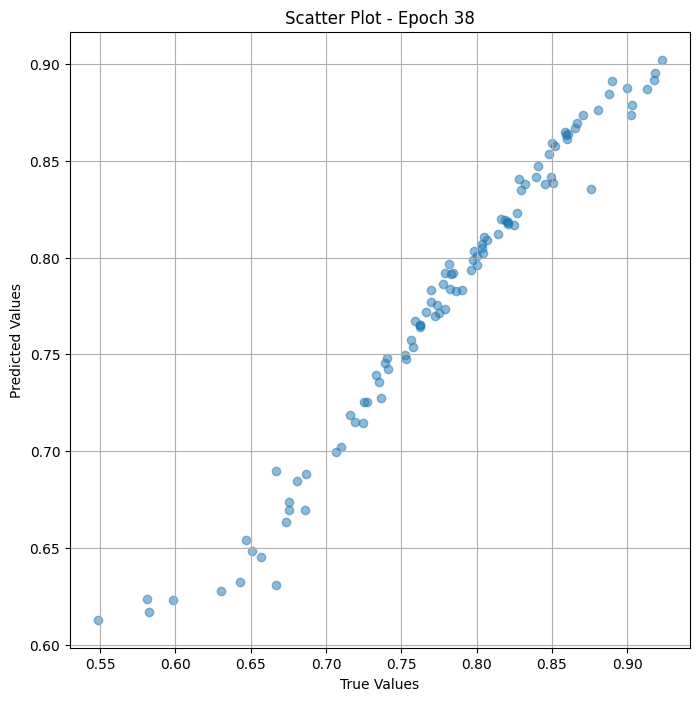

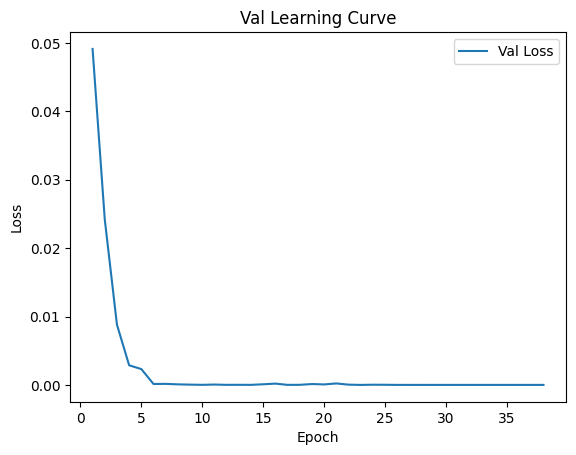


 Epoch: (39/50) Loss = 4.988801720173797e-06

 Epoch: (39/50) Loss_rmse = 0.0022335625253617764

 Epoch: (39/50) R^2 = 0.9994369745254517

 Epoch: (39/50) MAE = 0.0019277483224868774
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

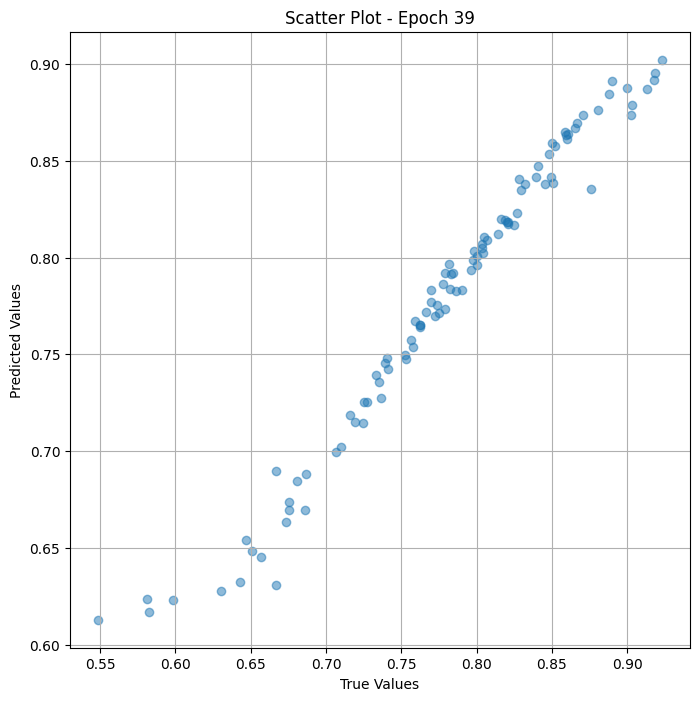

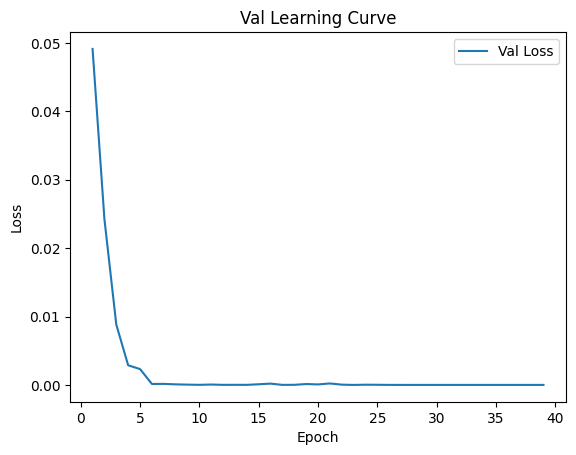


 Epoch: (40/50) Loss = 4.988657110516215e-06

 Epoch: (40/50) Loss_rmse = 0.0022335301619023085

 Epoch: (40/50) R^2 = 0.9994370341300964

 Epoch: (40/50) MAE = 0.001927703619003296
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.7523809

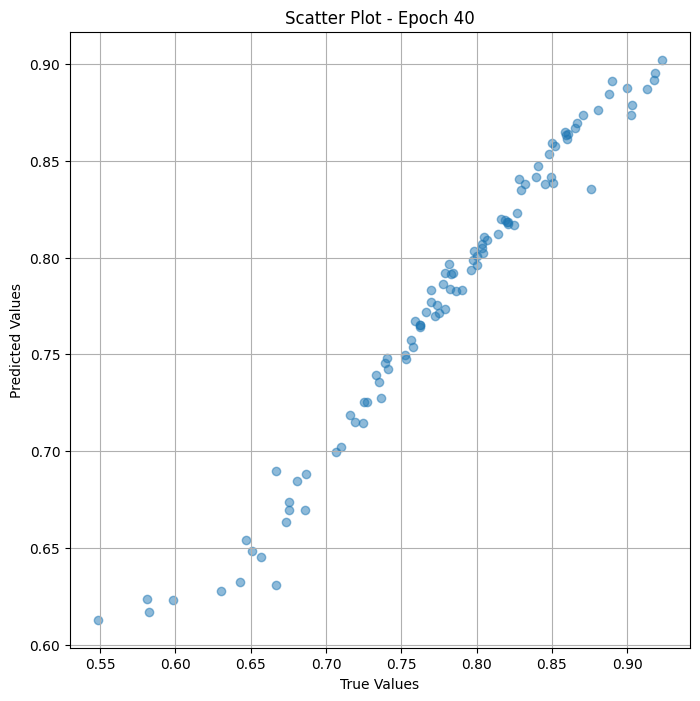

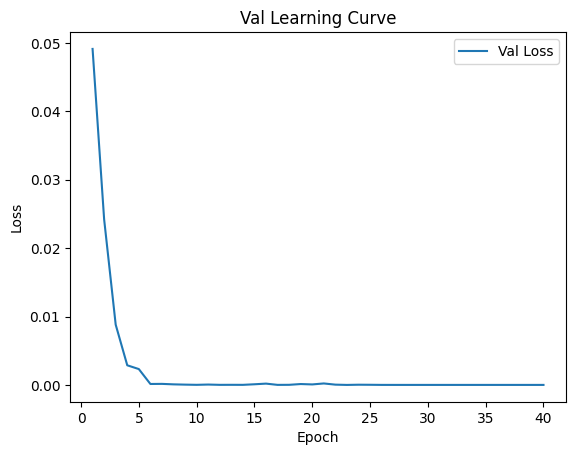


 Epoch: (41/50) Loss = 4.988414730178192e-06

 Epoch: (41/50) Loss_rmse = 0.002233475912362337

 Epoch: (41/50) R^2 = 0.9994370341300964

 Epoch: (41/50) MAE = 0.001927688717842102
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097

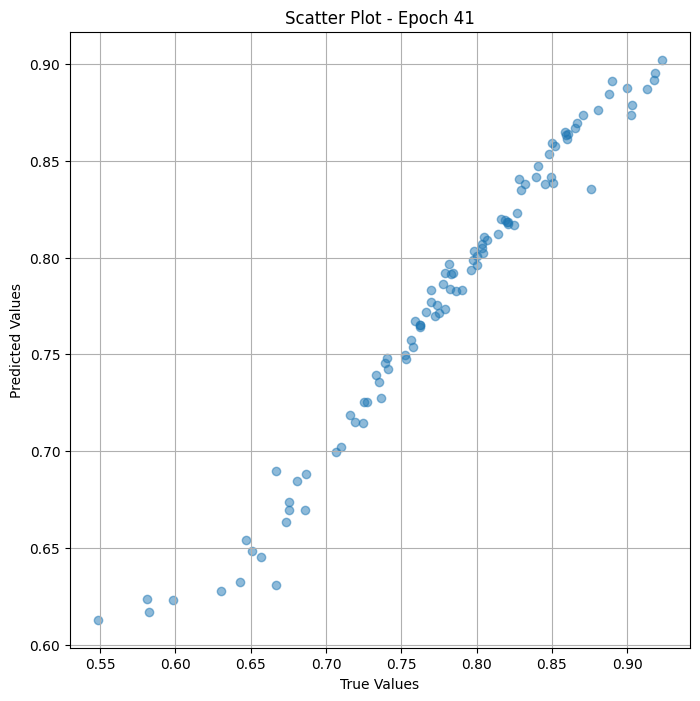

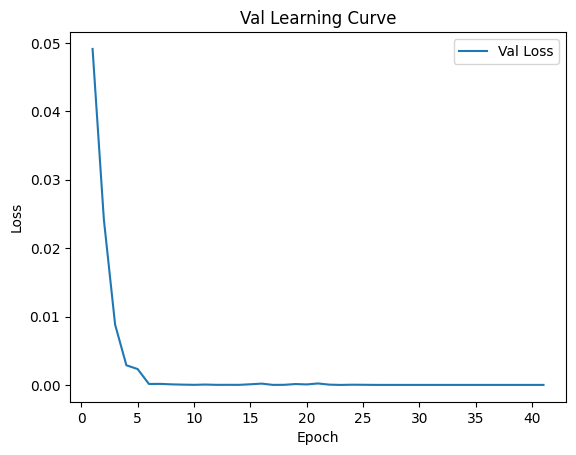


 Epoch: (42/50) Loss = 4.9883415158546995e-06

 Epoch: (42/50) Loss_rmse = 0.0022334596142172813

 Epoch: (42/50) R^2 = 0.9994370341300964

 Epoch: (42/50) MAE = 0.0019276738166809082
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238

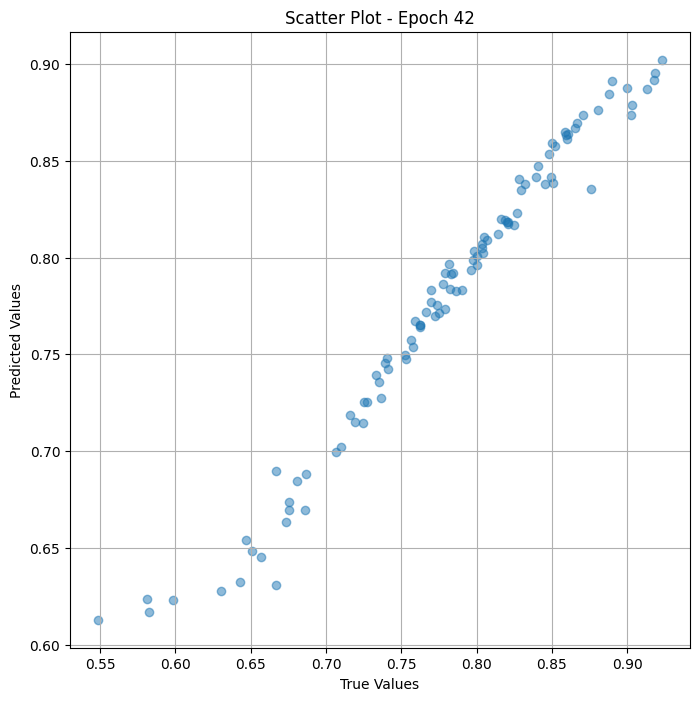

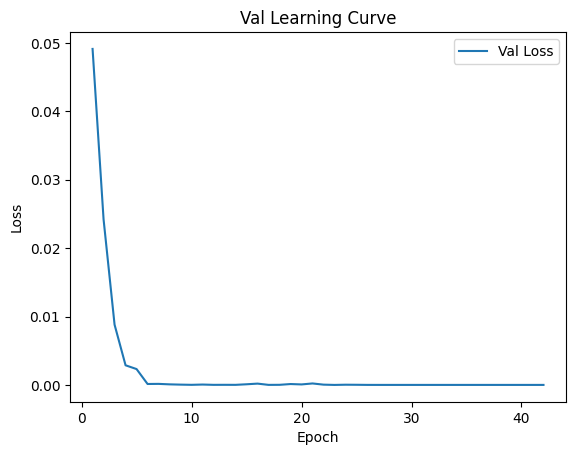


 Epoch: (43/50) Loss = 4.988027740182588e-06

 Epoch: (43/50) Loss_rmse = 0.002233389299362898

 Epoch: (43/50) R^2 = 0.9994370937347412

 Epoch: (43/50) MAE = 0.0019276291131973267
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.7523809

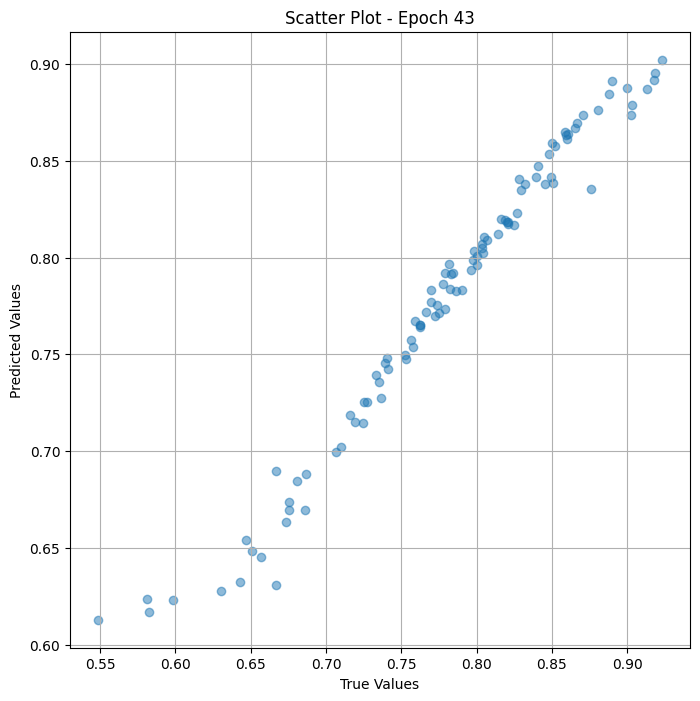

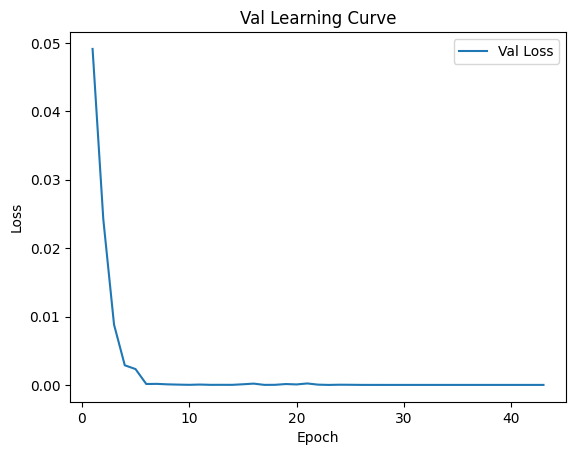


 Epoch: (44/50) Loss = 4.987849933968391e-06

 Epoch: (44/50) Loss_rmse = 0.002233349485322833

 Epoch: (44/50) R^2 = 0.9994370937347412

 Epoch: (44/50) MAE = 0.001927599310874939
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097

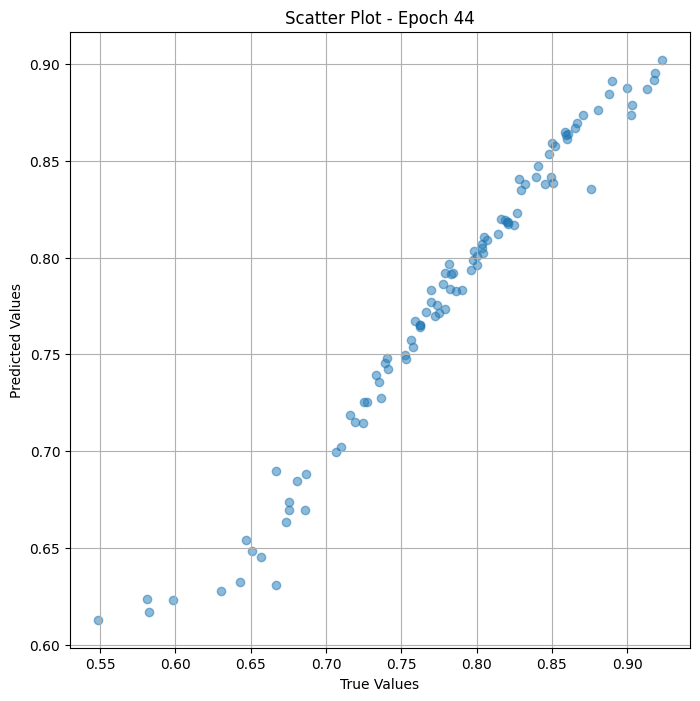

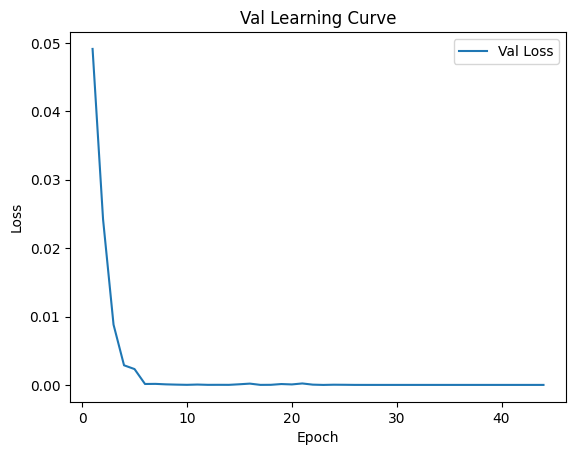


 Epoch: (45/50) Loss = 4.987849933968391e-06

 Epoch: (45/50) Loss_rmse = 0.002233349485322833

 Epoch: (45/50) R^2 = 0.9994370937347412

 Epoch: (45/50) MAE = 0.001927599310874939
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097

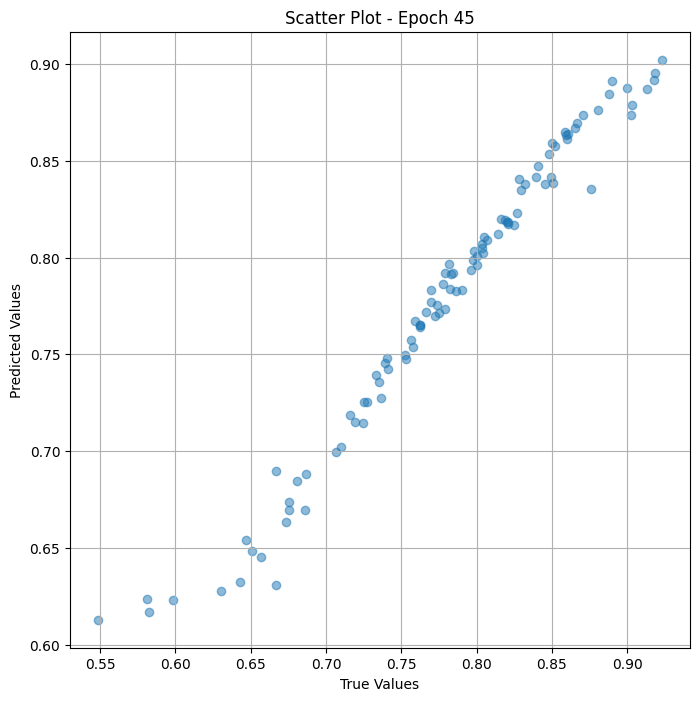

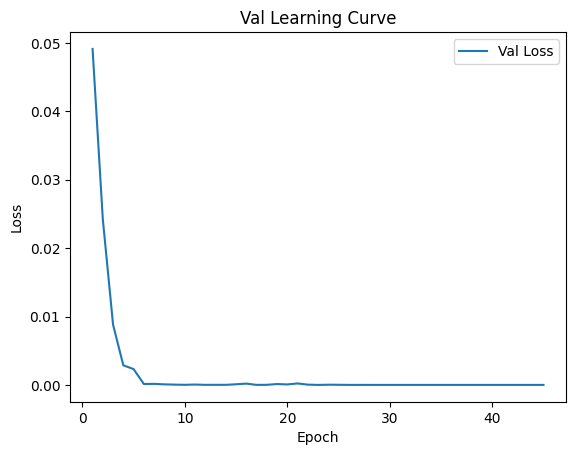


 Epoch: (46/50) Loss = 4.987317879567854e-06

 Epoch: (46/50) Loss_rmse = 0.0022332302760332823

 Epoch: (46/50) R^2 = 0.999437153339386

 Epoch: (46/50) MAE = 0.0019274801015853882
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.7523809

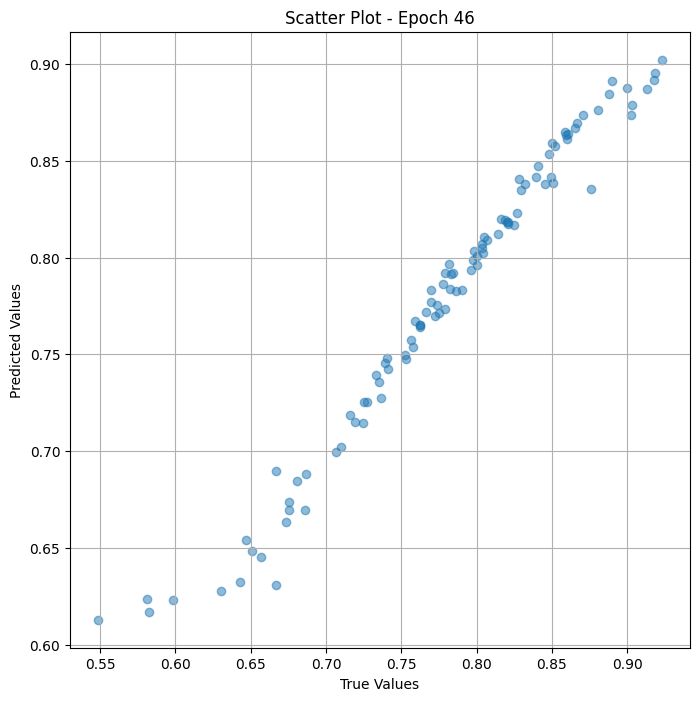

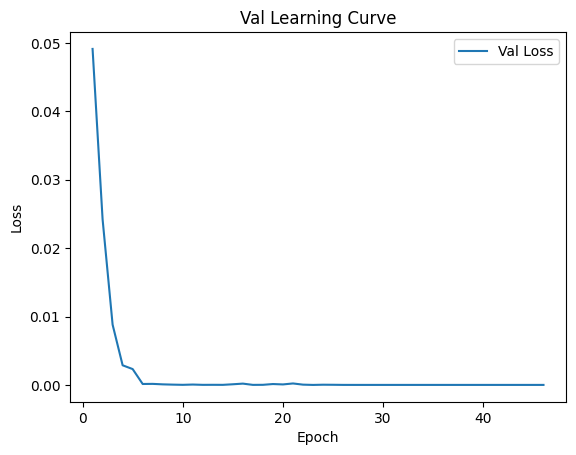


 Epoch: (47/50) Loss = 4.987120519217569e-06

 Epoch: (47/50) Loss_rmse = 0.0022331862710416317

 Epoch: (47/50) R^2 = 0.999437153339386

 Epoch: (47/50) MAE = 0.0019274502992630005
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.7523809

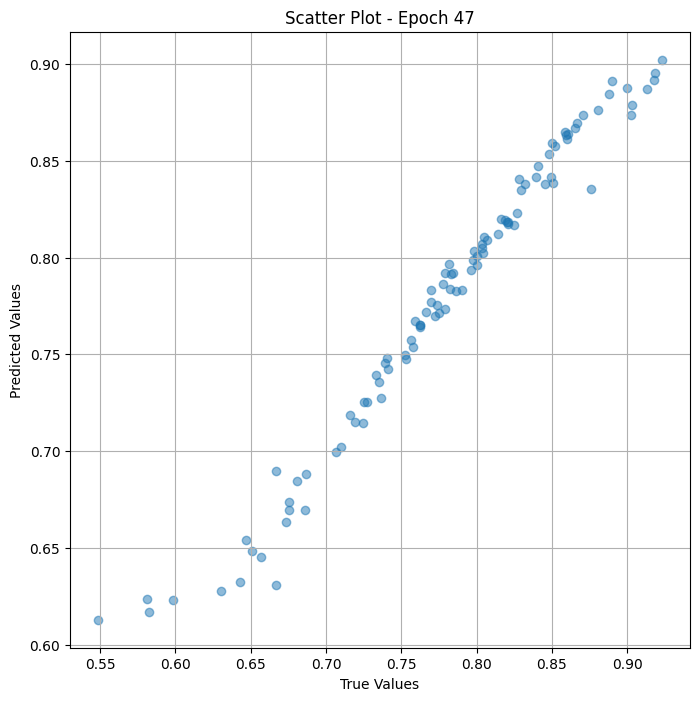

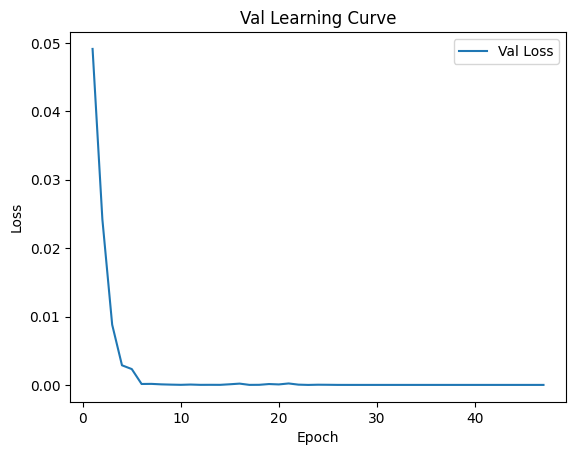


 Epoch: (48/50) Loss = 4.9870477596414275e-06

 Epoch: (48/50) Loss_rmse = 0.002233169972896576

 Epoch: (48/50) R^2 = 0.9994372129440308

 Epoch: (48/50) MAE = 0.0019274353981018066
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

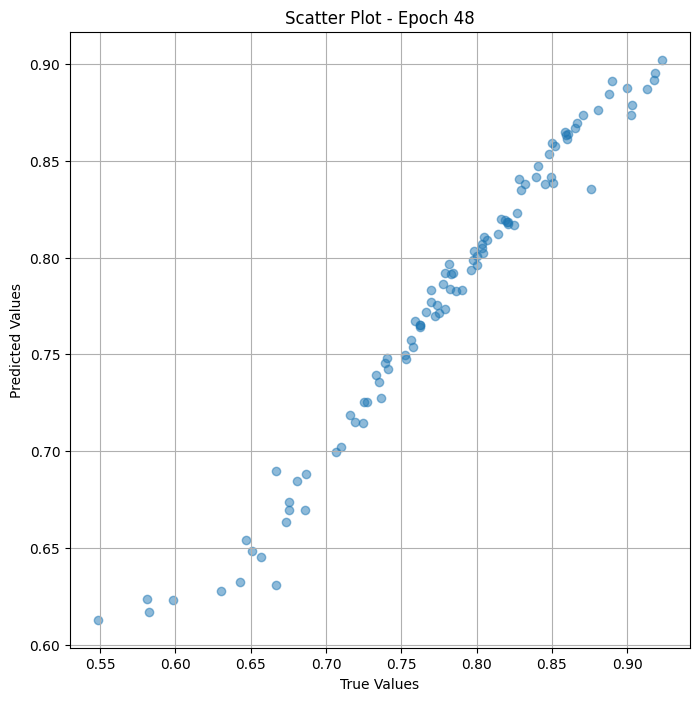

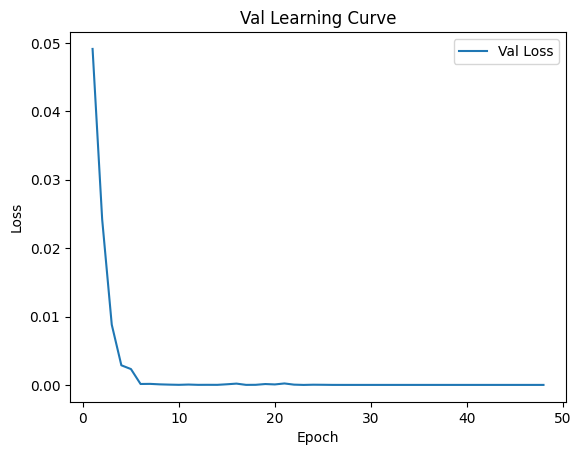


 Epoch: (49/50) Loss = 4.986680778529262e-06

 Epoch: (49/50) Loss_rmse = 0.002233087783679366

 Epoch: (49/50) R^2 = 0.9994372129440308

 Epoch: (49/50) MAE = 0.001927390694618225
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097

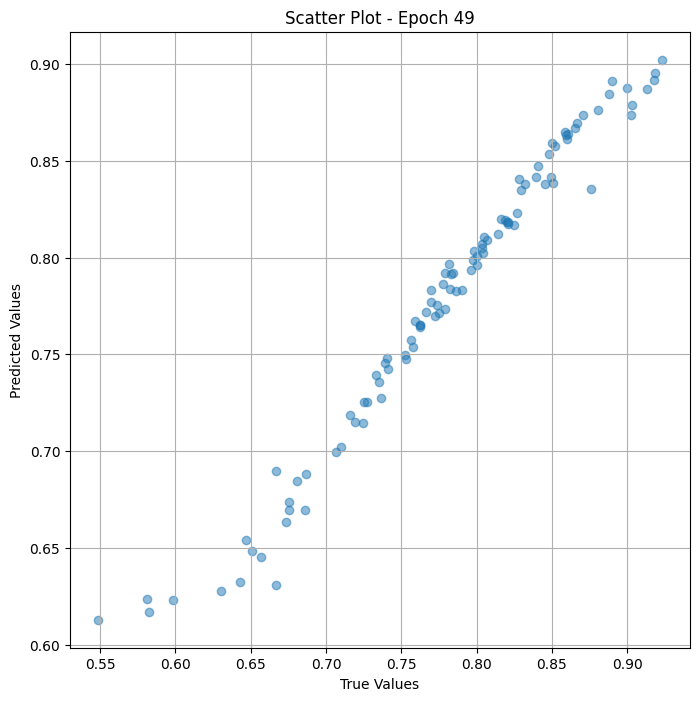

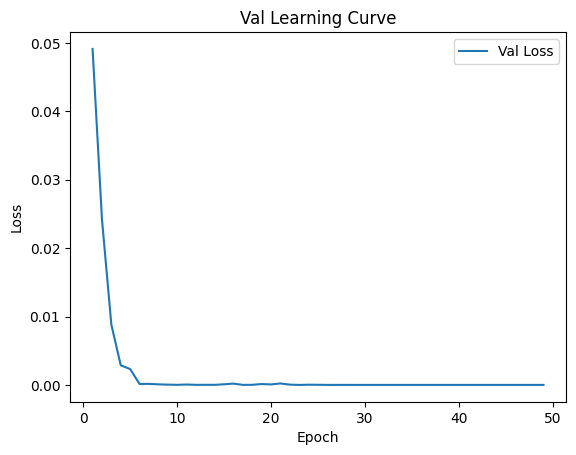


 Epoch: (50/50) Loss = 4.986523890693206e-06

 Epoch: (50/50) Loss_rmse = 0.0022330526262521744

 Epoch: (50/50) R^2 = 0.9994372725486755

 Epoch: (50/50) MAE = 0.0019273459911346436
Spearman correlation coefficient: SignificanceResult(statistic=0.9938923274001932, pvalue=8.688928440531294e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

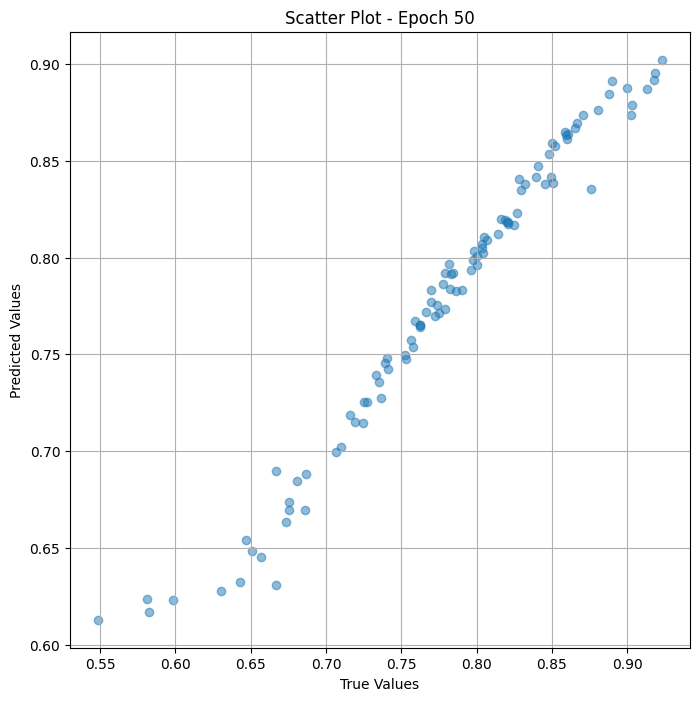

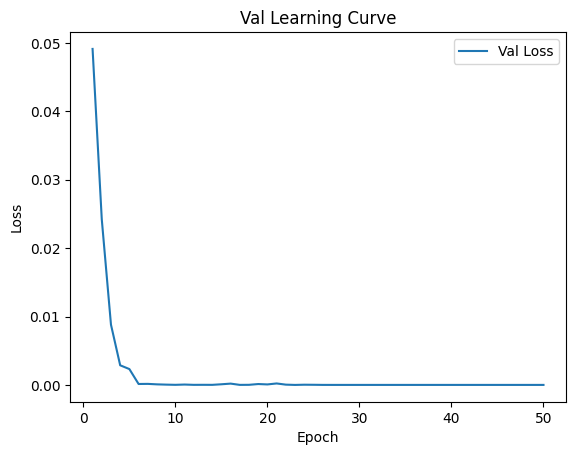

In [ ]:
# val the model and save weights
fit(50, model_vit_sval , val_dl )
torch.save(model_vit_sval.state_dict(), "model_weights_s")

In [ ]:
true_values_list_val = []
predicted_values_list_val = []

for x_trans, yb in val_dl:
    preds = model_vit_sval(x_trans)
    true_values_list_val.extend(yb.cpu().detach().numpy())
    predicted_values_list_val.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_sports' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_val_sports['preprocessed_image_path'],
    'True Value': true_values_list_val,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_val # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

                                           Image Path  True Value  \
0   /content/sports/1e22e1fbfa73a3ca_preprocessed.jpg    0.706522   
1   /content/sports/c1dba2c782343dbc_preprocessed.jpg    0.876289   
2   /content/sports/ea7bb8c2db2718fb_preprocessed.jpg    0.779221   
3   /content/sports/e12fe897897a2ede_preprocessed.jpg    0.918367   
4   /content/sports/d9e93a2678327874_preprocessed.jpg    0.770000   
..                                                ...         ...   
95  /content/sports/c76fd1f8905308f5_preprocessed.jpg    0.845455   
96    /content/sports/n00439826_6437_preprocessed.jpg    0.890110   
97  /content/sports/1537f41b7a4fc016_preprocessed.jpg    0.650943   
98      /content/sports/000000318570_preprocessed.jpg    0.756522   
99      /content/sports/000000085706_preprocessed.jpg    0.860465   

    Predicted Value  
0          0.699652  
1          0.835626  
2          0.791863  
3          0.895568  
4          0.777181  
..              ...  
95         0.8377

## Test

In [ ]:
df_test_sports.head()


,preprocessed_image_path,memoscore
0,/content/sports/000000481014_preprocessed.jpg,0.728395
1,/content/sports/n00470966_19377_preprocessed.jpg,0.867347
2,/content/sports/n00445351_8665_preprocessed.jpg,0.835165
3,/content/sports/a5f627b7166f2f0f_preprocessed.jpg,0.839286
4,/content/sports/aacabf9b3fe435d3_preprocessed.jpg,0.818182


In [ ]:
df_test_sports.shape

(100, 2)

In [ ]:
class Dataset_test(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_test_sports["memoscore"]
        self.images = df_test_sports["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
test_ds = Dataset_test(df_test_sports, trans_transform=trans_transform)
test_dl = DataLoader(test_ds, batch_size=32, shuffle=False)

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
print(test_ds)

In [ ]:
class ViTMem_model_test_sport(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))

    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit_test =  ViTMem_model_test_sport( arch="vit_base_patch16_224_miil")

In [ ]:


# Assuming your model is an instance of YourModelClass and is already on GPU
model = ViTMem_model_test_sport().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 768, 14, 14]         590,592
          Identity-2             [-1, 196, 768]               0
        PatchEmbed-3             [-1, 196, 768]               0
           Dropout-4             [-1, 197, 768]               0
          Identity-5             [-1, 197, 768]               0
          Identity-6             [-1, 197, 768]               0
         LayerNorm-7             [-1, 197, 768]           1,536
            Linear-8            [-1, 197, 2304]       1,769,472
          Identity-9          [-1, 12, 197, 64]               0
         Identity-10          [-1, 12, 197, 64]               0
           Linear-11             [-1, 197, 768]         590,592
          Dropout-12             [-1, 197, 768]               0
        Attention-13             [-1, 197, 768]               0
         Identity-14             [-1, 1

In [ ]:
device = get_default_device()
test_dl = DeviceDataLoader(test_dl, device)
model_vit_test  = to_device(model_vit_test  , device)

In [ ]:
params = [param for param in list(model_vit_test.parameters()) if param.requires_grad ]
optimizer = torch.optim.Adam(params, lr=1e-4)   #,weight_decay=1e-7

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)



/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/50) Loss = 0.055488720536231995

 Epoch: (1/50) Loss_rmse = 0.23556043207645416

 Epoch: (1/50) R^2 = -6.23953914642334

 Epoch: (1/50) MAE = 0.22316956520080566
Spearman correlation coefficient: SignificanceResult(statistic=-0.1765992587411295, pvalue=0.08521419571834492)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0.919191

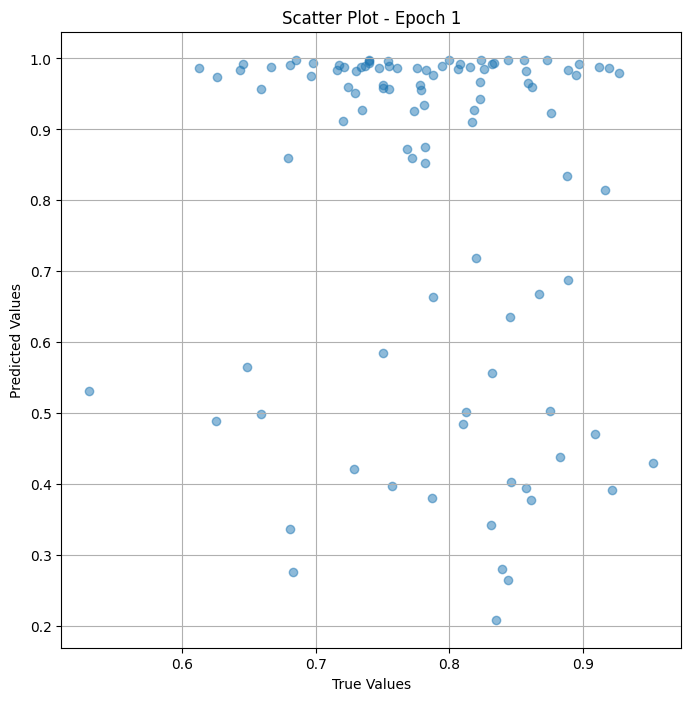

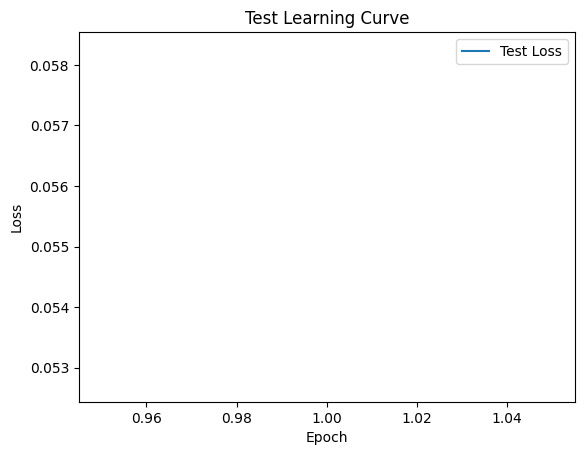


 Epoch: (2/50) Loss = 0.021208612248301506

 Epoch: (2/50) Loss_rmse = 0.14563177525997162

 Epoch: (2/50) R^2 = -1.767059326171875

 Epoch: (2/50) MAE = 0.14388933777809143
Spearman correlation coefficient: SignificanceResult(statistic=0.2477693636676061, pvalue=0.014936597205455829)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0.91919

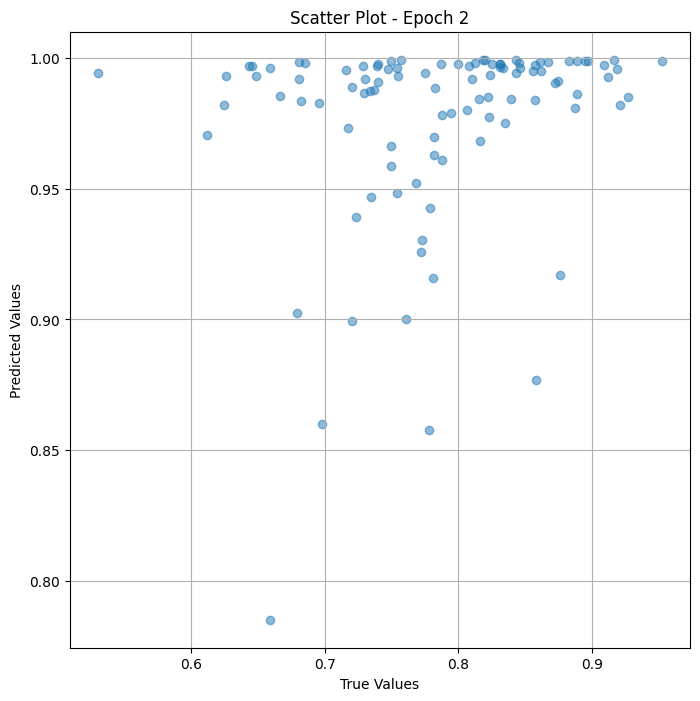

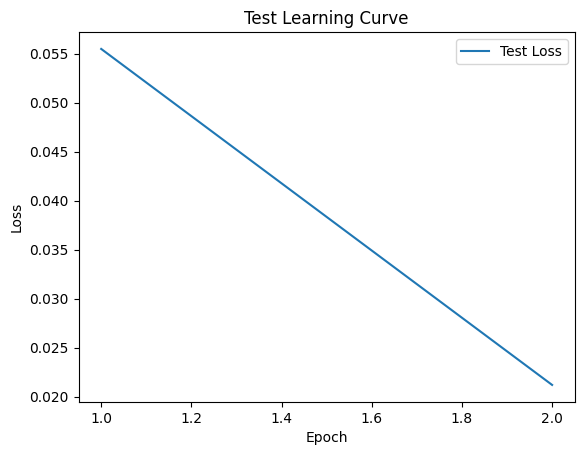


 Epoch: (3/50) Loss = 0.02866244688630104

 Epoch: (3/50) Loss_rmse = 0.1692998707294464

 Epoch: (3/50) R^2 = -2.739551067352295

 Epoch: (3/50) MAE = 0.12911149859428406
Spearman correlation coefficient: SignificanceResult(statistic=0.4106541506502932, pvalue=3.242581709012633e-05)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0.919191

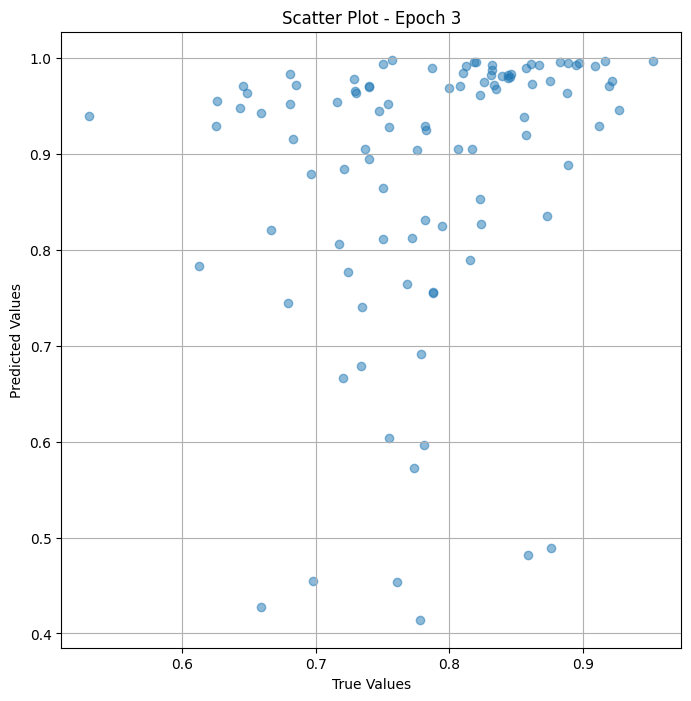

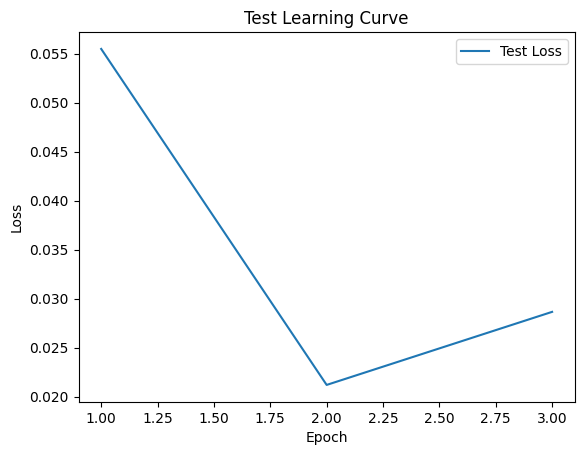


 Epoch: (4/50) Loss = 0.01465561892837286

 Epoch: (4/50) Loss_rmse = 0.12106039375066757

 Epoch: (4/50) R^2 = -0.9120990037918091

 Epoch: (4/50) MAE = 0.10978171229362488
Spearman correlation coefficient: SignificanceResult(statistic=0.6382112859103037, pvalue=2.664851533987877e-12)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0.9191

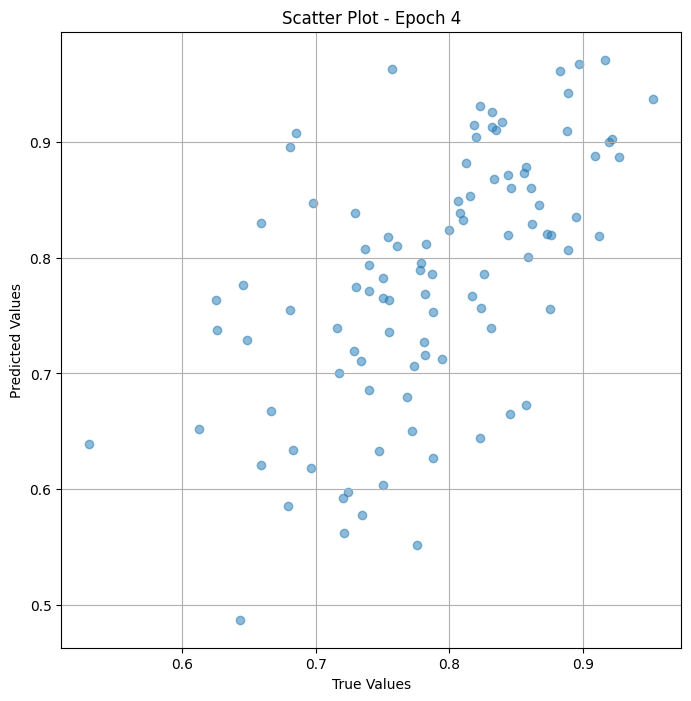

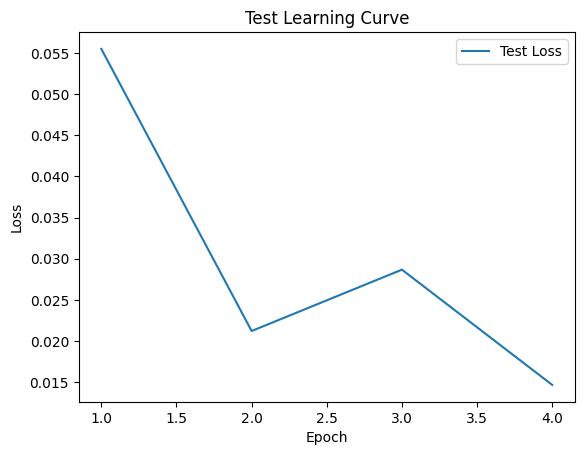


 Epoch: (5/50) Loss = 0.011529050767421722

 Epoch: (5/50) Loss_rmse = 0.10737341642379761

 Epoch: (5/50) R^2 = -0.504179835319519

 Epoch: (5/50) MAE = 0.09966851770877838
Spearman correlation coefficient: SignificanceResult(statistic=0.6138752202974, pvalue=2.9176954169267696e-11)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0.919191

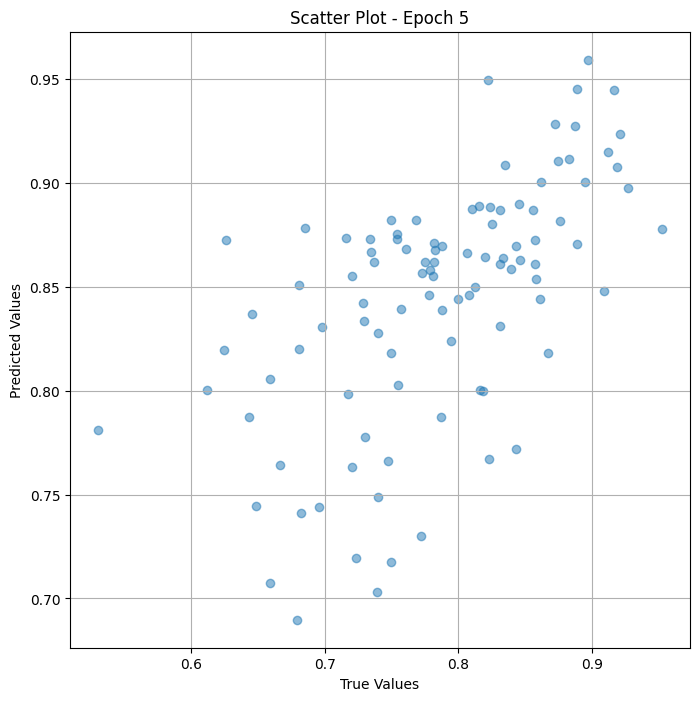

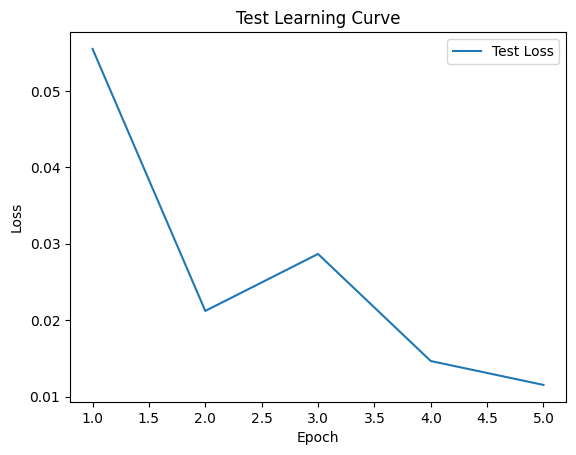


 Epoch: (6/50) Loss = 0.00021738215582445264

 Epoch: (6/50) Loss_rmse = 0.014743885025382042

 Epoch: (6/50) R^2 = 0.9716384410858154

 Epoch: (6/50) MAE = 0.013029918074607849
Spearman correlation coefficient: SignificanceResult(statistic=0.6401172040923623, pvalue=2.1895687575587906e-12)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0

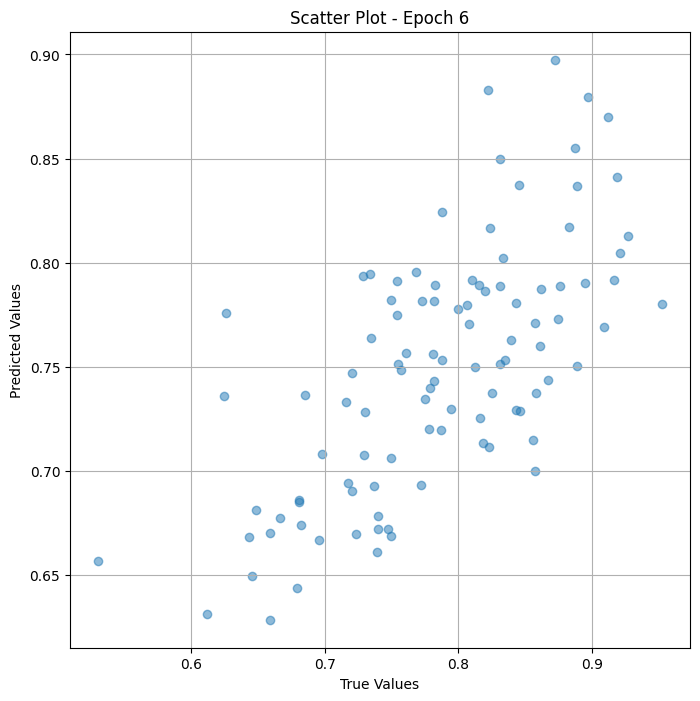

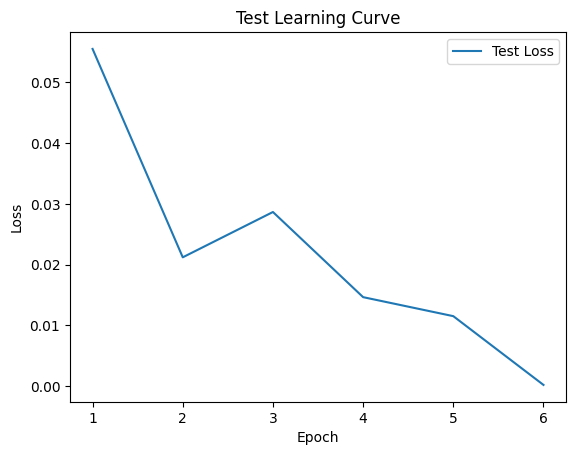


 Epoch: (7/50) Loss = 0.0008065267466008663

 Epoch: (7/50) Loss_rmse = 0.02839941531419754

 Epoch: (7/50) R^2 = 0.894773542881012

 Epoch: (7/50) MAE = 0.021291732788085938
Spearman correlation coefficient: SignificanceResult(statistic=0.7126913128041987, pvalue=3.822514232386249e-16)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0.919

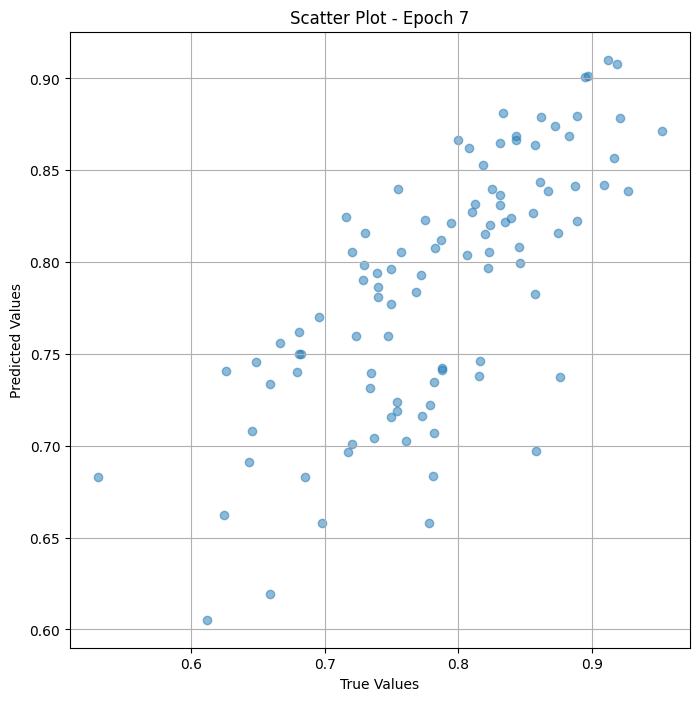

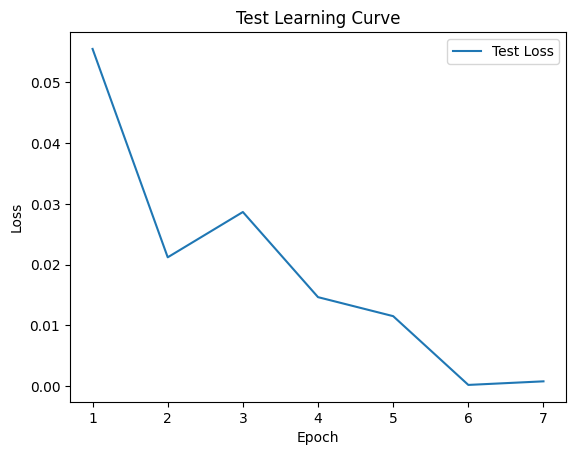


 Epoch: (8/50) Loss = 0.000838970416225493

 Epoch: (8/50) Loss_rmse = 0.02896498516201973

 Epoch: (8/50) R^2 = 0.8905406594276428

 Epoch: (8/50) MAE = 0.02220901846885681
Spearman correlation coefficient: SignificanceResult(statistic=0.7907186536098966, pvalue=9.553179218908226e-22)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0.9191

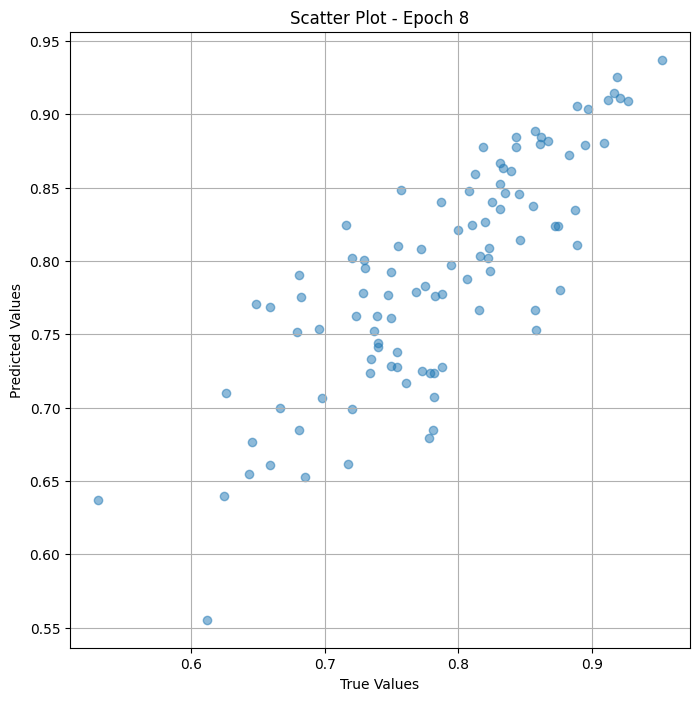

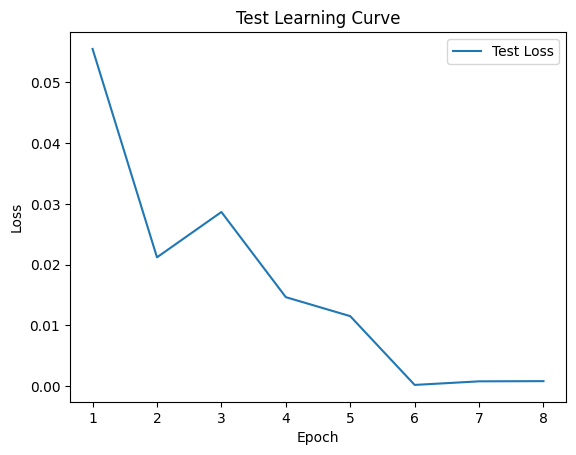

Epoch 0.05: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (9/50) Loss = 0.002053807256743312

 Epoch: (9/50) Loss_rmse = 0.04531894996762276

 Epoch: (9/50) R^2 = 0.7320425510406494

 Epoch: (9/50) MAE = 0.042930662631988525
Spearman correlation coefficient: SignificanceResult(statistic=0.898840510336568, pvalue=1.9219402297366666e-35)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.

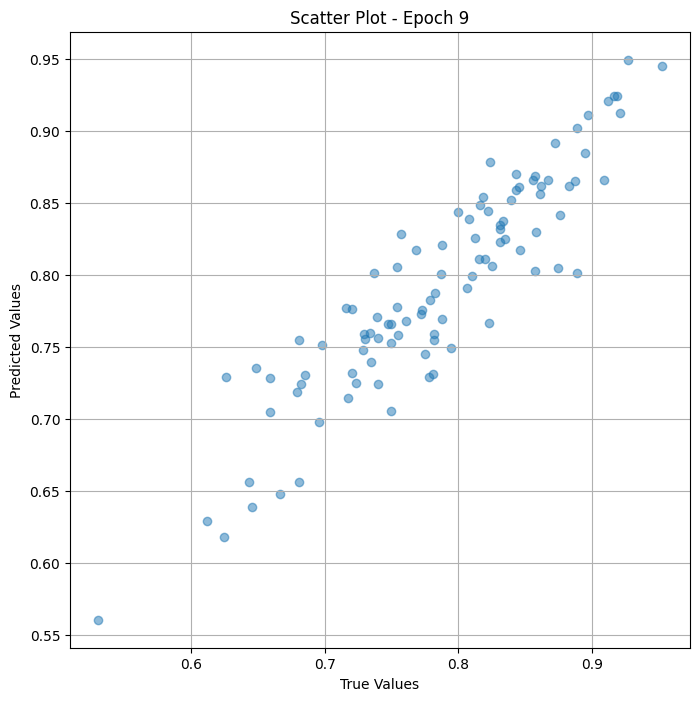

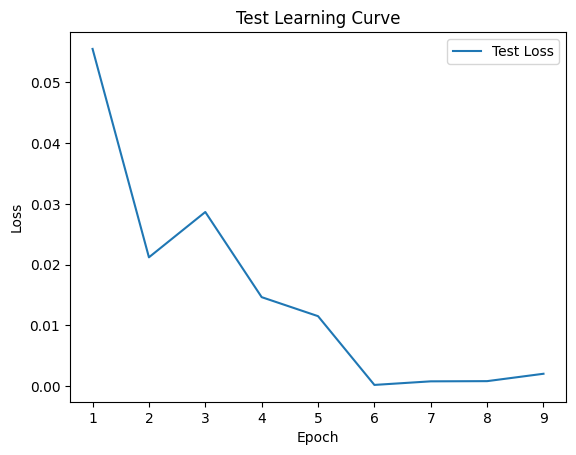


 Epoch: (10/50) Loss = 0.001212564529851079

 Epoch: (10/50) Loss_rmse = 0.034821897745132446

 Epoch: (10/50) R^2 = 0.8417983055114746

 Epoch: (10/50) MAE = 0.032864734530448914
Spearman correlation coefficient: SignificanceResult(statistic=0.9273004131547797, pvalue=6.774704188602747e-42)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 

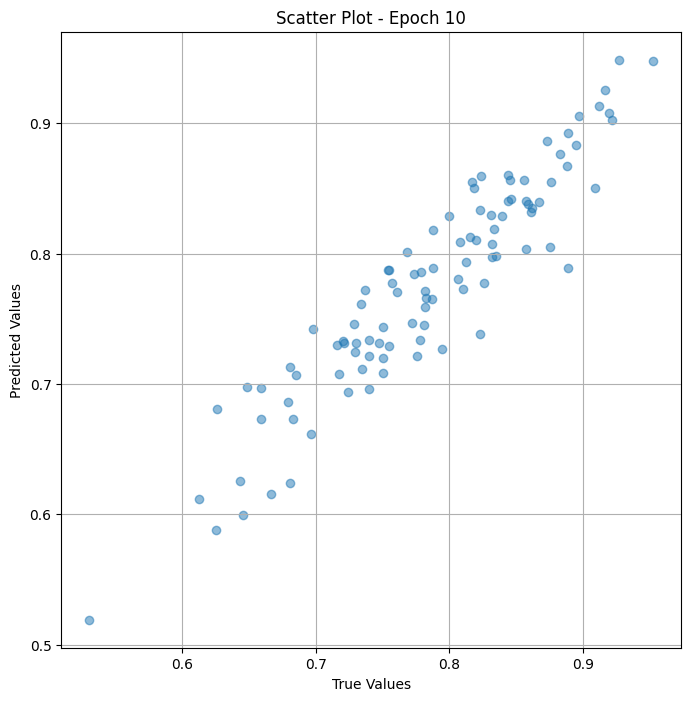

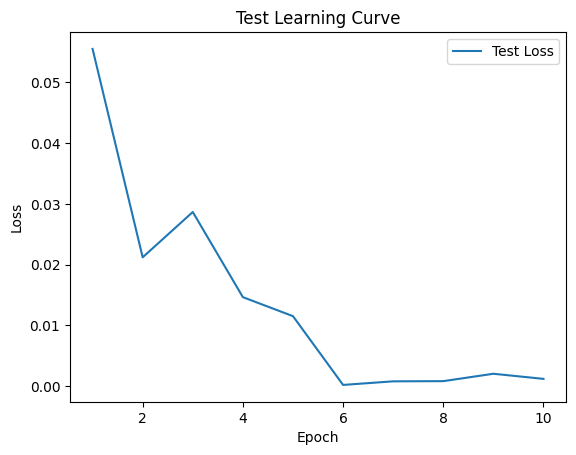


 Epoch: (11/50) Loss = 0.000972214387729764

 Epoch: (11/50) Loss_rmse = 0.031180351972579956

 Epoch: (11/50) R^2 = 0.8731564879417419

 Epoch: (11/50) MAE = 0.029567211866378784
Spearman correlation coefficient: SignificanceResult(statistic=0.9322313829709952, pvalue=2.7999018983262395e-43)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586,

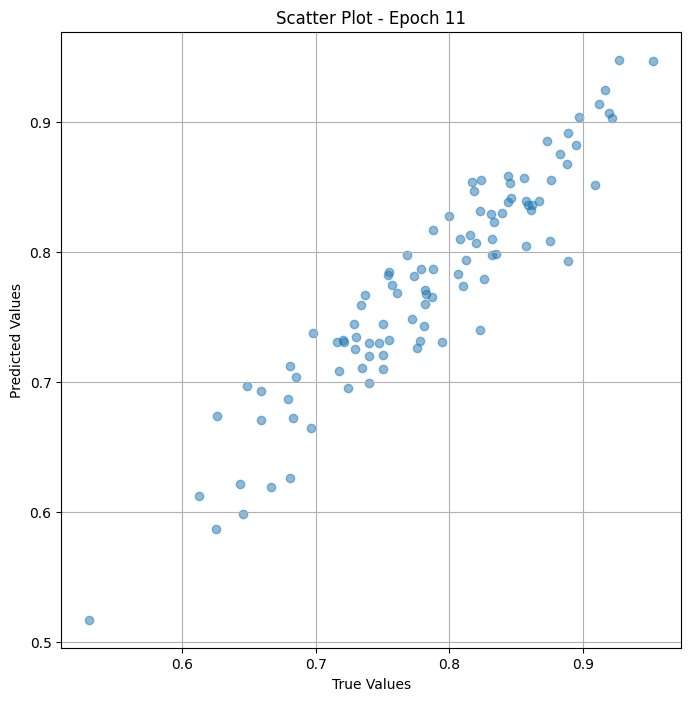

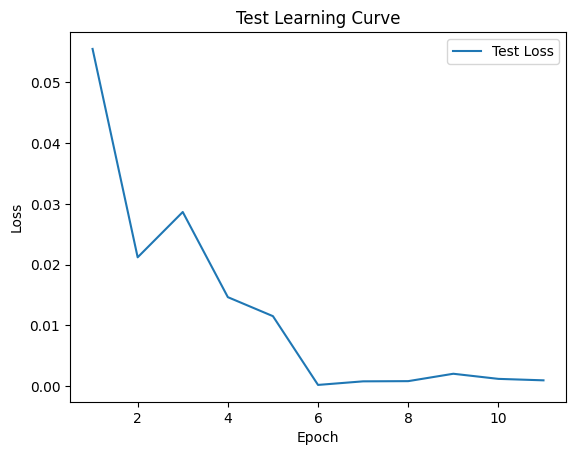

Epoch 0.03: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (12/50) Loss = 0.0007065357640385628

 Epoch: (12/50) Loss_rmse = 0.02658073976635933

 Epoch: (12/50) R^2 = 0.9078192114830017

 Epoch: (12/50) MAE = 0.025394722819328308
Spearman correlation coefficient: SignificanceResult(statistic=0.9419508874367952, pvalue=2.4277826714348627e-46)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.72916

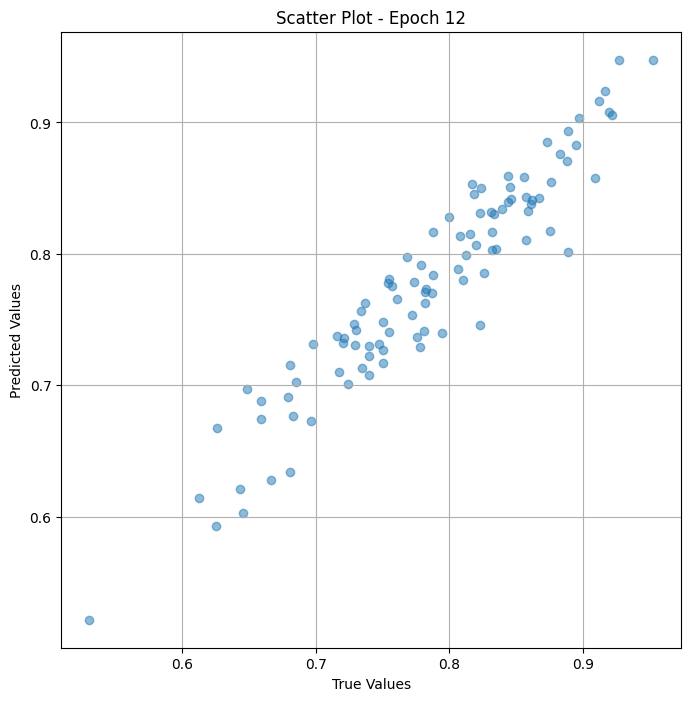

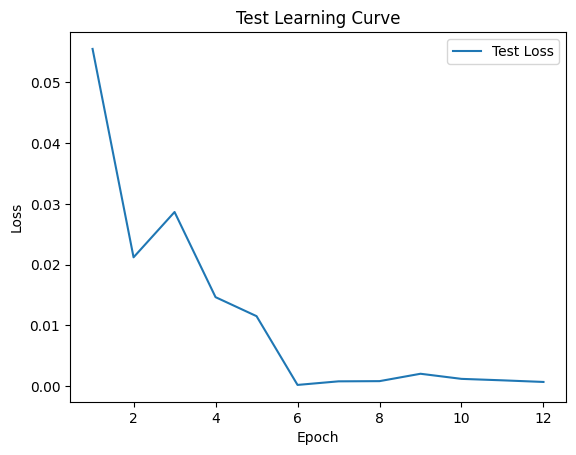


 Epoch: (13/50) Loss = 0.00060472940094769

 Epoch: (13/50) Loss_rmse = 0.024591246619820595

 Epoch: (13/50) R^2 = 0.9211017489433289

 Epoch: (13/50) MAE = 0.023531123995780945
Spearman correlation coefficient: SignificanceResult(statistic=0.9466987263244856, pvalue=4.911279992181139e-48)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0

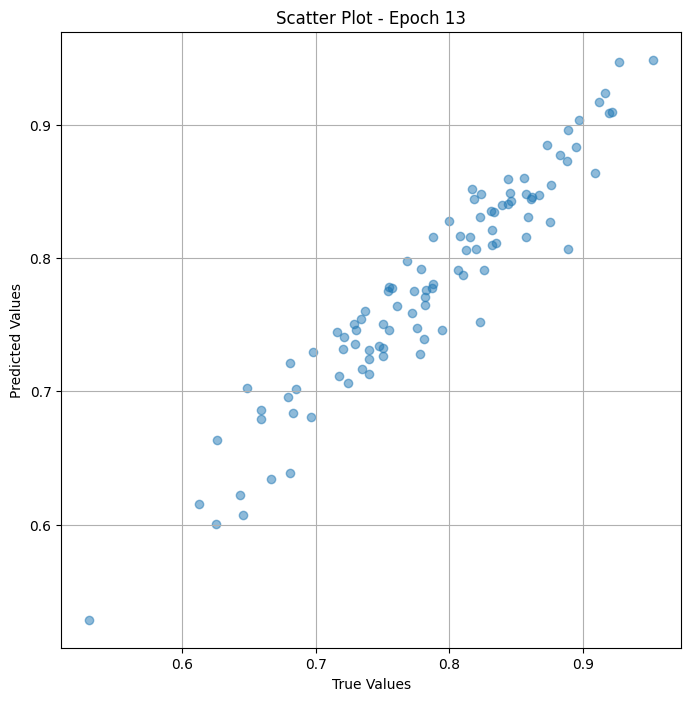

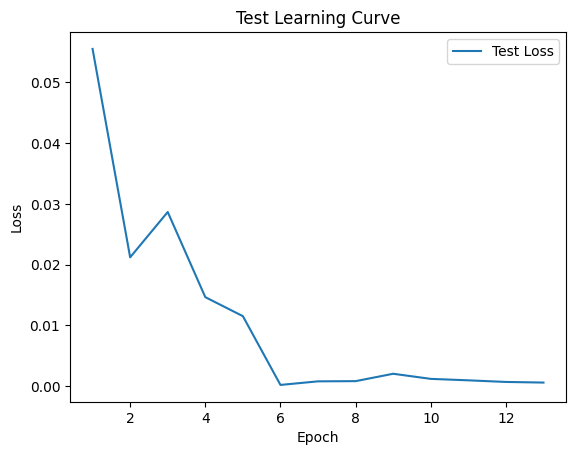


 Epoch: (14/50) Loss = 0.0005772283184342086

 Epoch: (14/50) Loss_rmse = 0.024025576189160347

 Epoch: (14/50) R^2 = 0.924689769744873

 Epoch: (14/50) MAE = 0.022998183965682983
Spearman correlation coefficient: SignificanceResult(statistic=0.9486114271335265, pvalue=9.213941569279365e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 

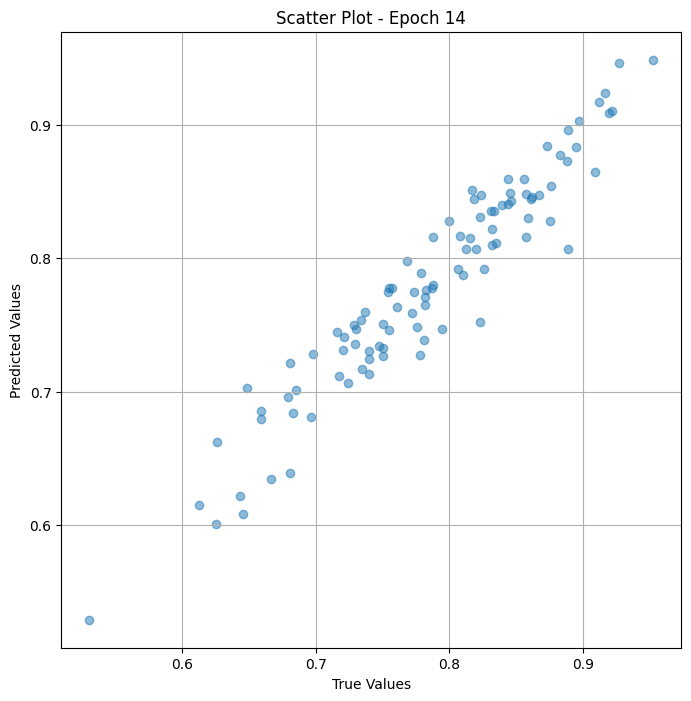

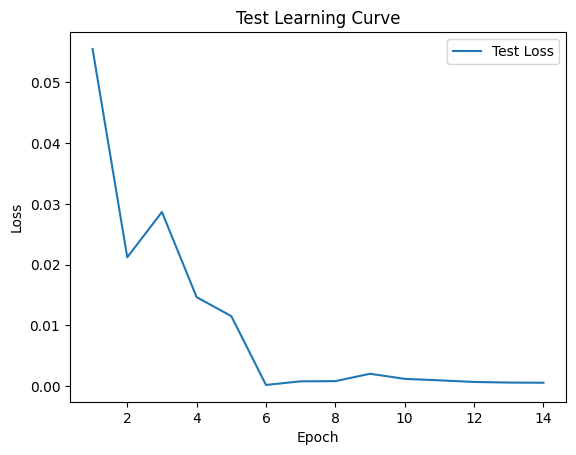

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (15/50) Loss = 0.0005483385175466537

 Epoch: (15/50) Loss_rmse = 0.023416629061102867

 Epoch: (15/50) R^2 = 0.9284589886665344

 Epoch: (15/50) MAE = 0.022417530417442322
Spearman correlation coefficient: SignificanceResult(statistic=0.949472820760293, pvalue=4.246497299672992e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.729166

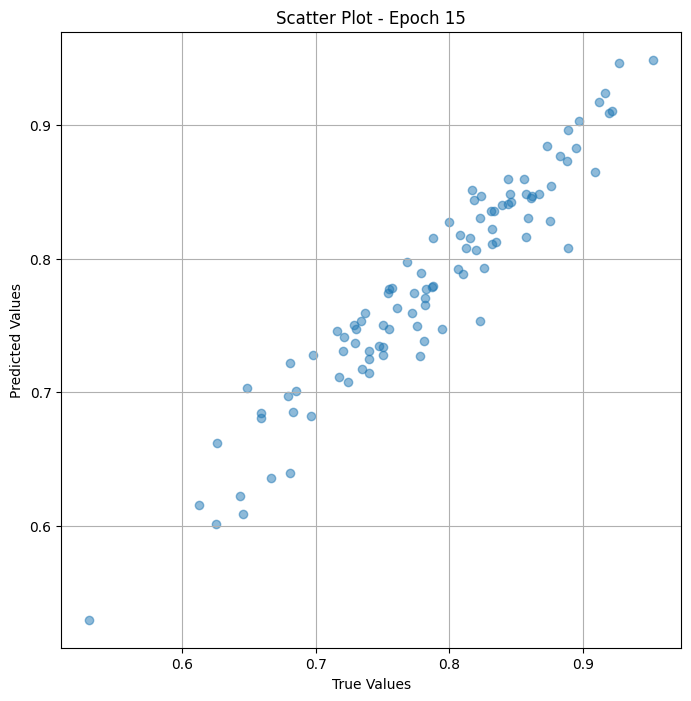

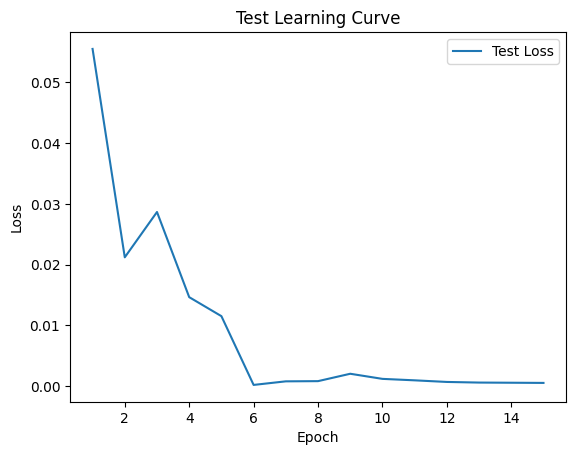


 Epoch: (16/50) Loss = 0.0005369603750295937

 Epoch: (16/50) Loss_rmse = 0.02317240461707115

 Epoch: (16/50) R^2 = 0.9299435019493103

 Epoch: (16/50) MAE = 0.02218109369277954
Spearman correlation coefficient: SignificanceResult(statistic=0.9502731707442181, pvalue=2.042397157343961e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0

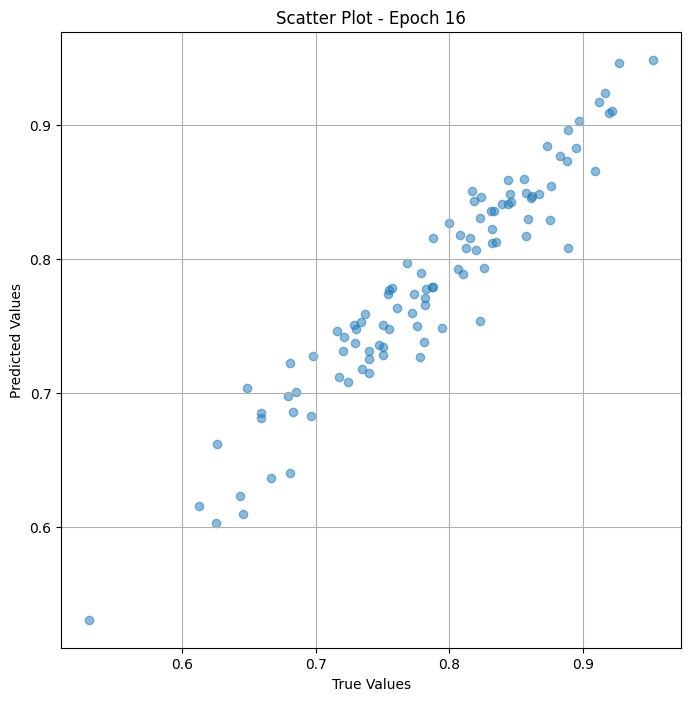

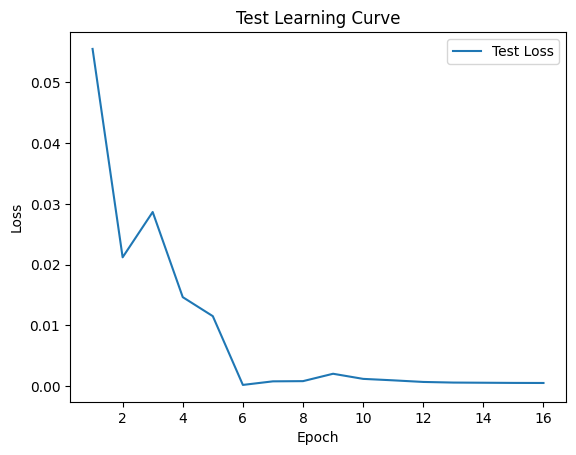


 Epoch: (17/50) Loss = 0.000533939222805202

 Epoch: (17/50) Loss_rmse = 0.023107124492526054

 Epoch: (17/50) R^2 = 0.93033766746521

 Epoch: (17/50) MAE = 0.022118017077445984
Spearman correlation coefficient: SignificanceResult(statistic=0.9503477796410246, pvalue=1.9065110216754973e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0

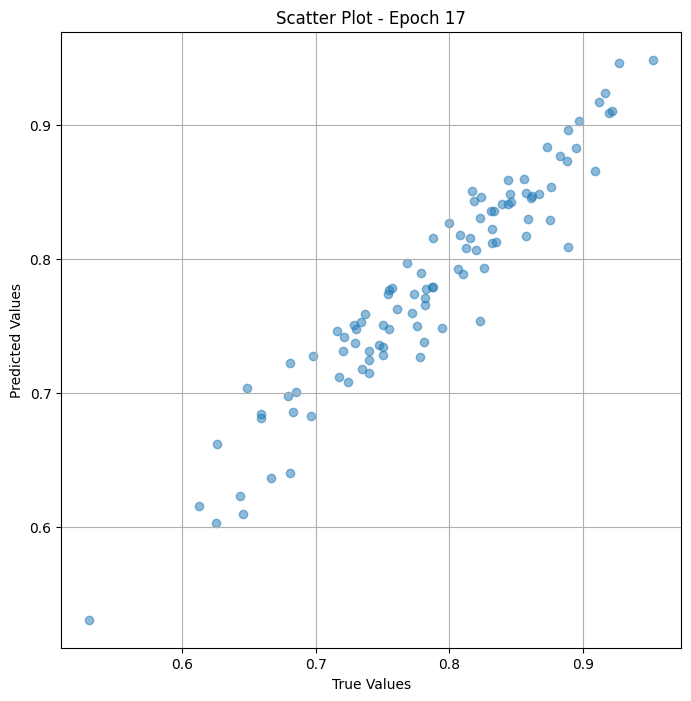

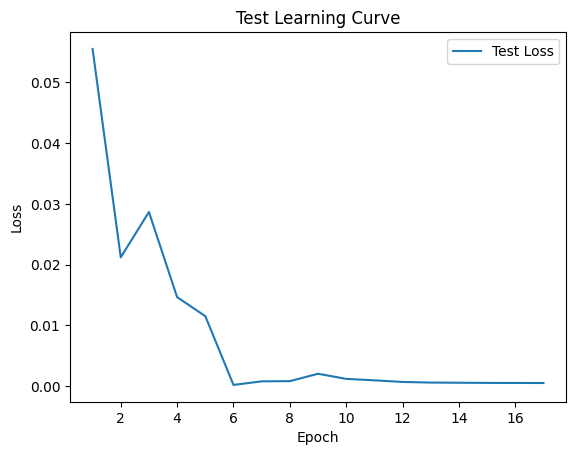

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (18/50) Loss = 0.0005308291292749345

 Epoch: (18/50) Loss_rmse = 0.02303973026573658

 Epoch: (18/50) R^2 = 0.9307434558868408

 Epoch: (18/50) MAE = 0.022052675485610962
Spearman correlation coefficient: SignificanceResult(statistic=0.9503477796410246, pvalue=1.9065110216754973e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.72916

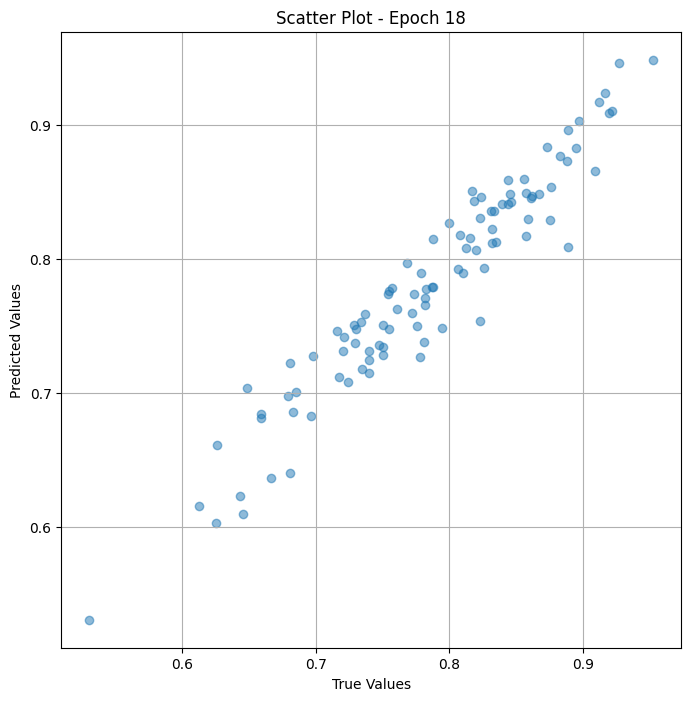

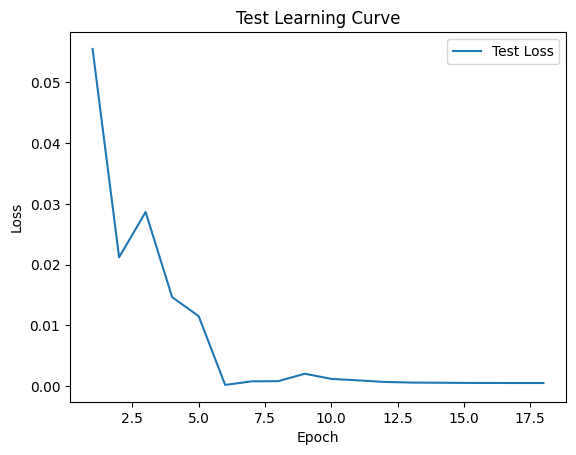


 Epoch: (19/50) Loss = 0.0005297159077599645

 Epoch: (19/50) Loss_rmse = 0.02301555871963501

 Epoch: (19/50) R^2 = 0.9308886528015137

 Epoch: (19/50) MAE = 0.022029012441635132
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586,

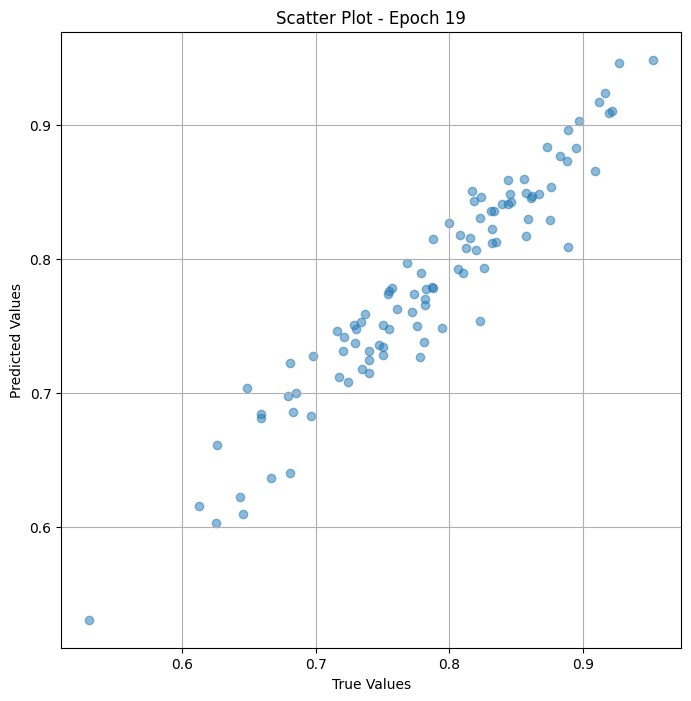

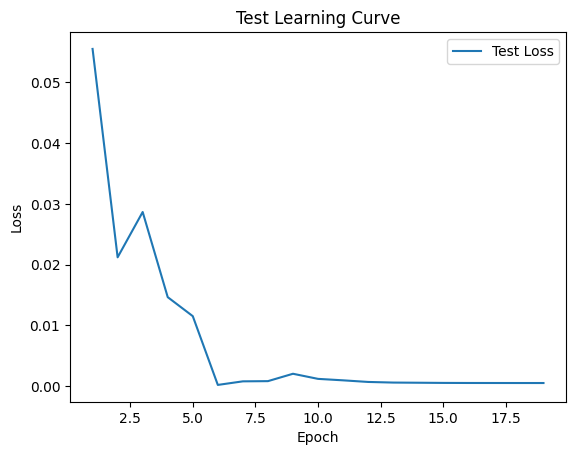


 Epoch: (20/50) Loss = 0.0005295440787449479

 Epoch: (20/50) Loss_rmse = 0.0230118241161108

 Epoch: (20/50) R^2 = 0.9309110641479492

 Epoch: (20/50) MAE = 0.022025391459465027
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 

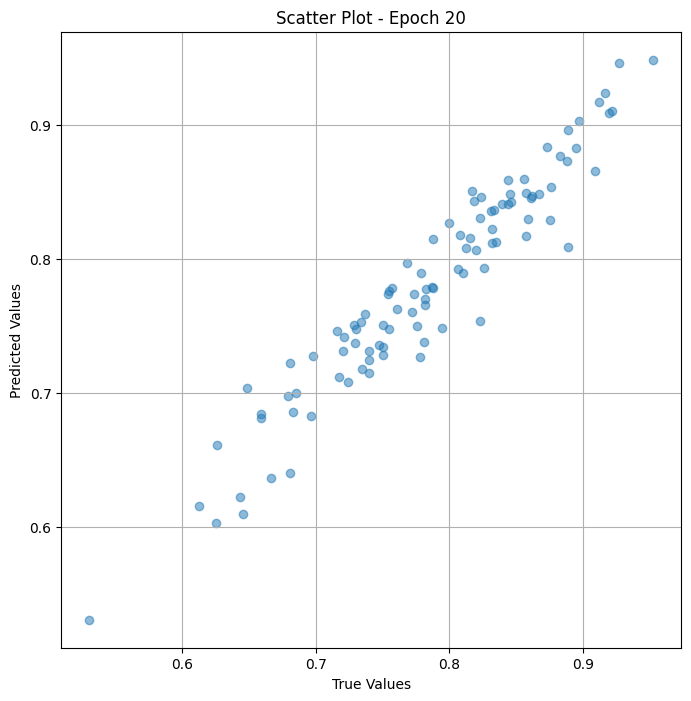

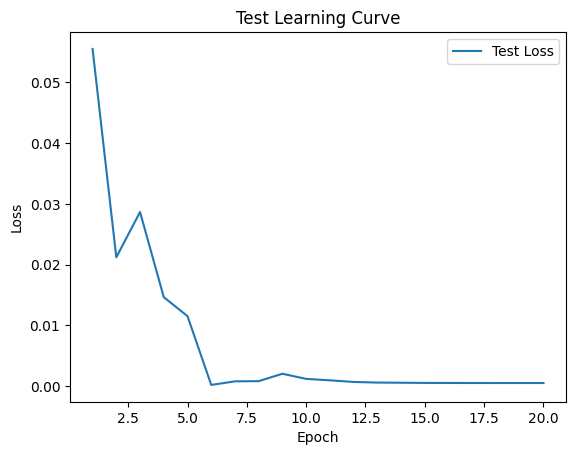


 Epoch: (21/50) Loss = 0.000529371143784374

 Epoch: (21/50) Loss_rmse = 0.023008067160844803

 Epoch: (21/50) R^2 = 0.9309336543083191

 Epoch: (21/50) MAE = 0.022021710872650146
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586,

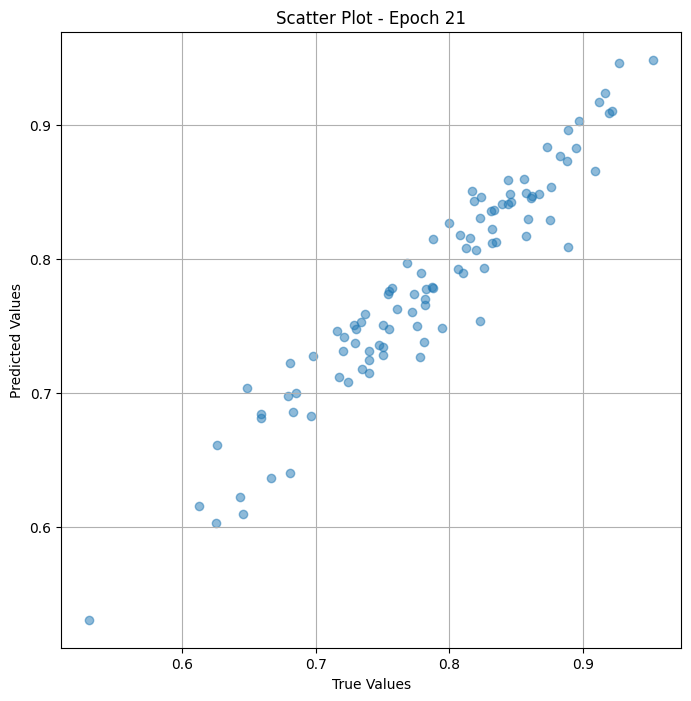

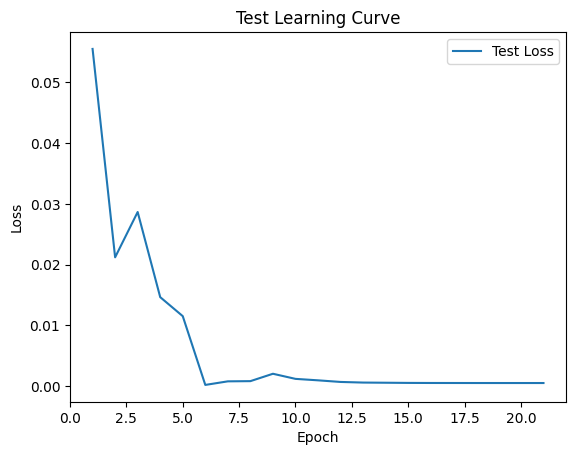


 Epoch: (22/50) Loss = 0.0005291885463520885

 Epoch: (22/50) Loss_rmse = 0.02300409786403179

 Epoch: (22/50) R^2 = 0.9309574961662292

 Epoch: (22/50) MAE = 0.02201785147190094
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 

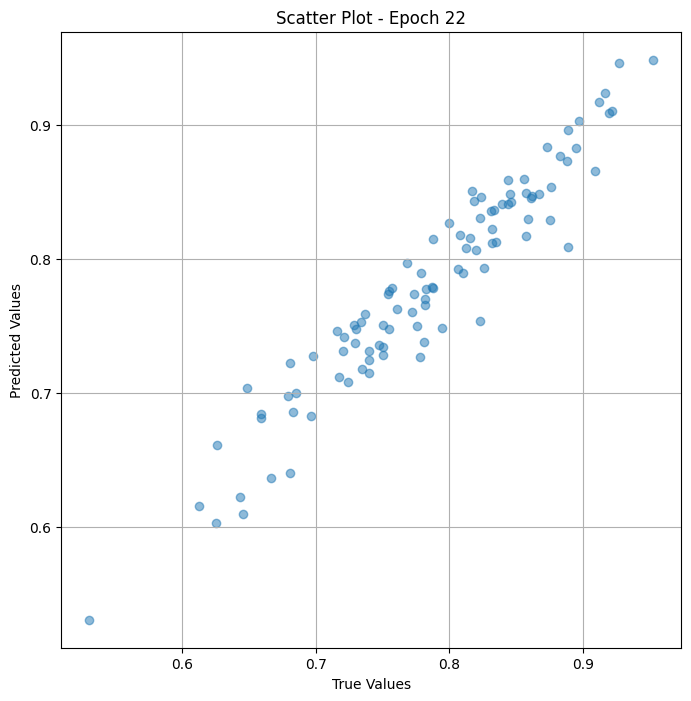

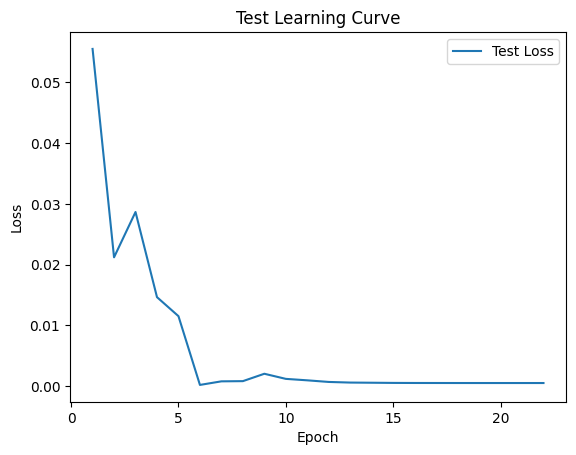


 Epoch: (23/50) Loss = 0.0005290014669299126

 Epoch: (23/50) Loss_rmse = 0.02300003170967102

 Epoch: (23/50) R^2 = 0.9309818744659424

 Epoch: (23/50) MAE = 0.022013887763023376
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586,

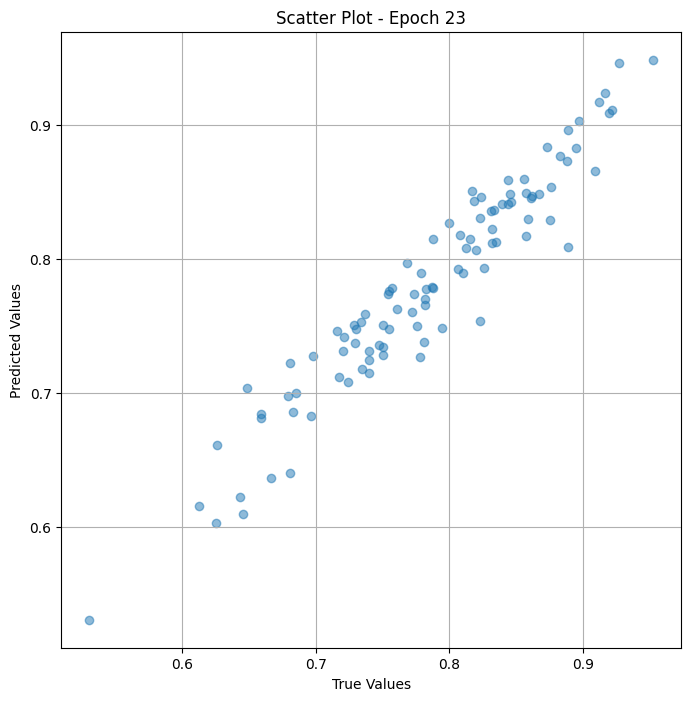

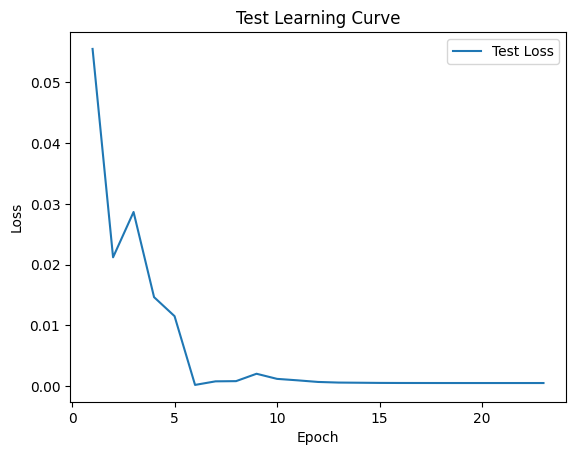


 Epoch: (24/50) Loss = 0.000528811477124691

 Epoch: (24/50) Loss_rmse = 0.022995902225375175

 Epoch: (24/50) R^2 = 0.931006669998169

 Epoch: (24/50) MAE = 0.022009849548339844
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 

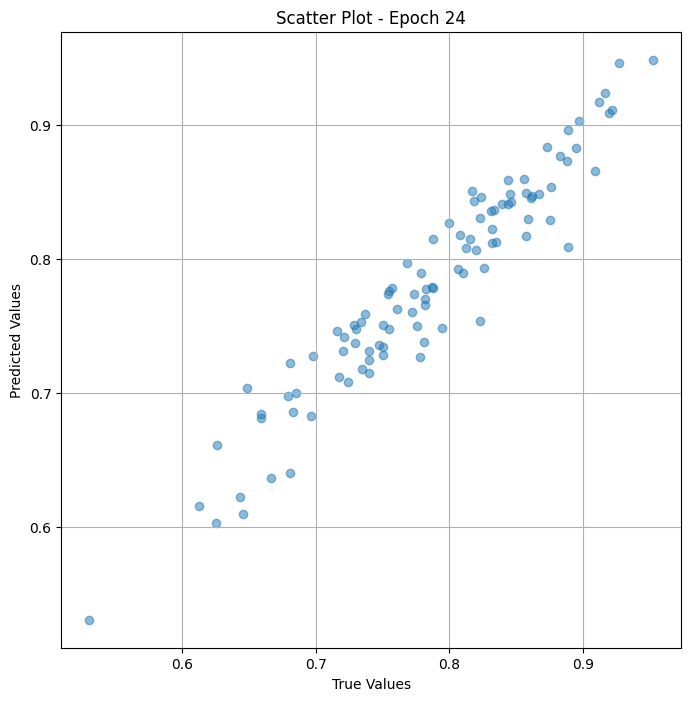

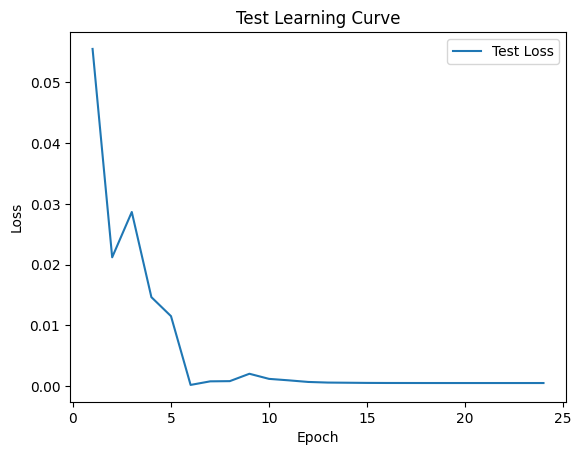


 Epoch: (25/50) Loss = 0.0005286133964546025

 Epoch: (25/50) Loss_rmse = 0.022991593927145004

 Epoch: (25/50) R^2 = 0.9310325384140015

 Epoch: (25/50) MAE = 0.02200564742088318
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586,

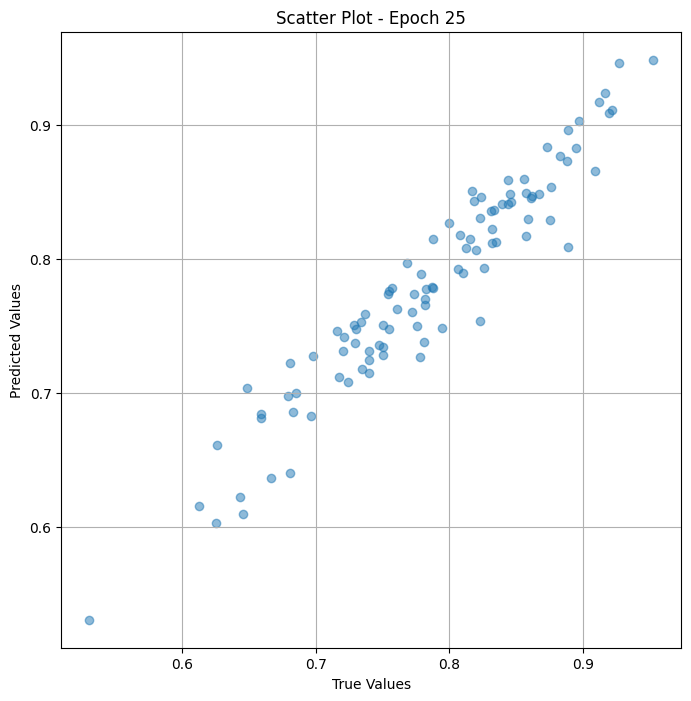

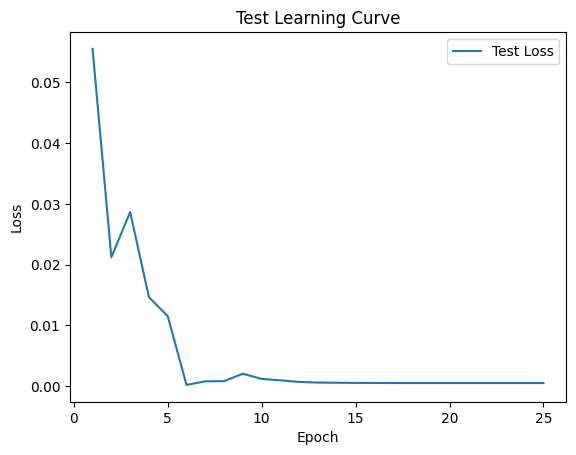


 Epoch: (26/50) Loss = 0.000528410542756319

 Epoch: (26/50) Loss_rmse = 0.022987181320786476

 Epoch: (26/50) R^2 = 0.9310590028762817

 Epoch: (26/50) MAE = 0.022001340985298157
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586,

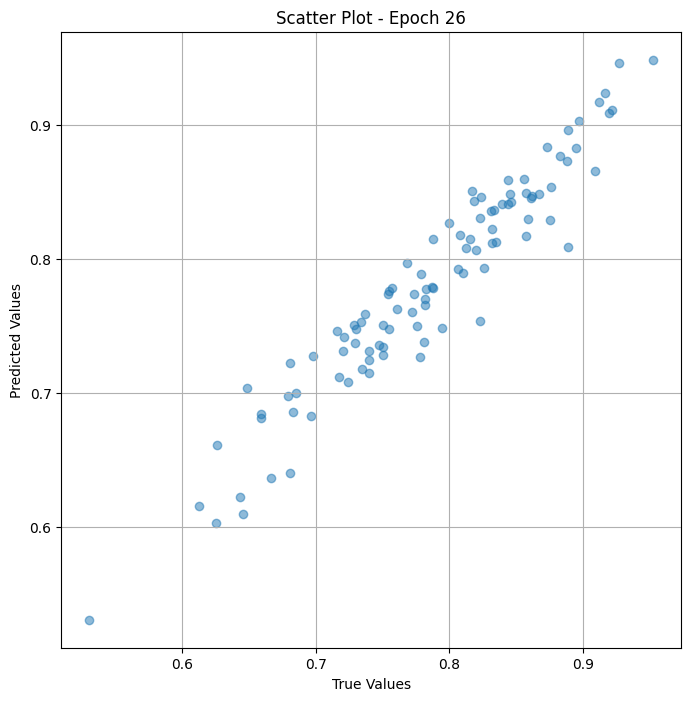

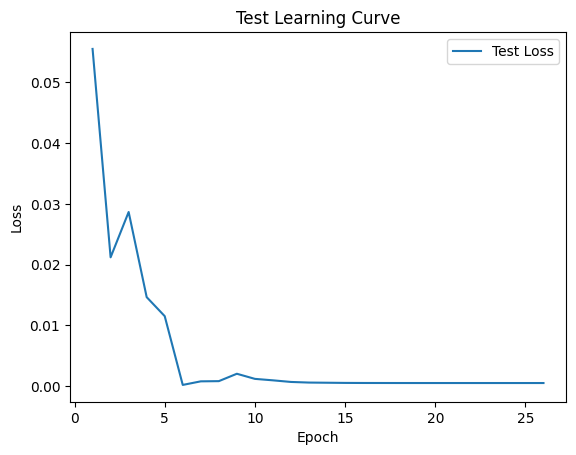


 Epoch: (27/50) Loss = 0.0005282081547193229

 Epoch: (27/50) Loss_rmse = 0.022982779890298843

 Epoch: (27/50) R^2 = 0.9310854077339172

 Epoch: (27/50) MAE = 0.021997034549713135
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586

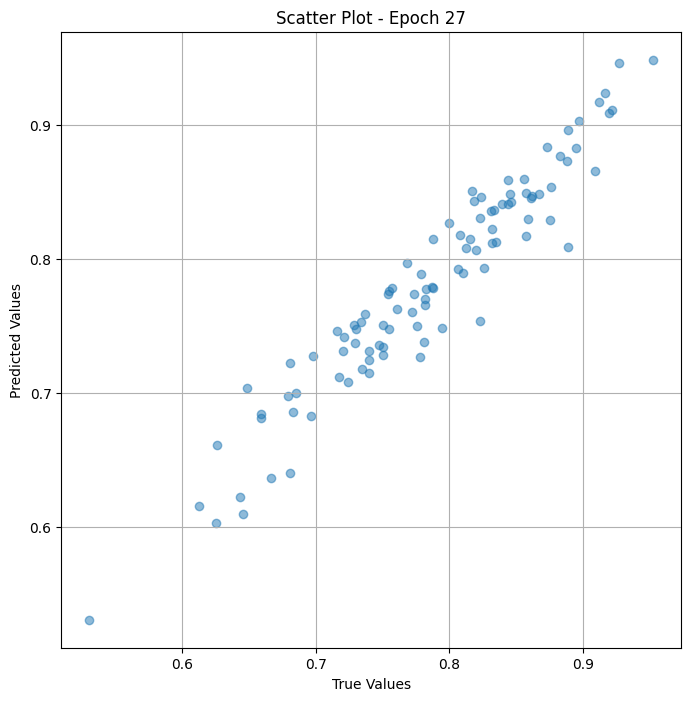

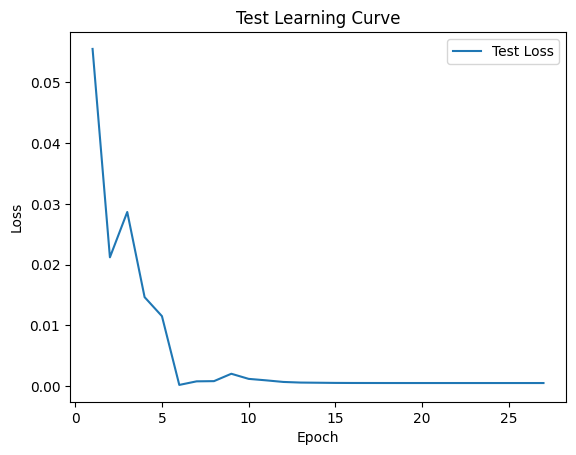


 Epoch: (28/50) Loss = 0.0005279922625049949

 Epoch: (28/50) Loss_rmse = 0.022978082299232483

 Epoch: (28/50) R^2 = 0.9311135411262512

 Epoch: (28/50) MAE = 0.02199244499206543
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586,

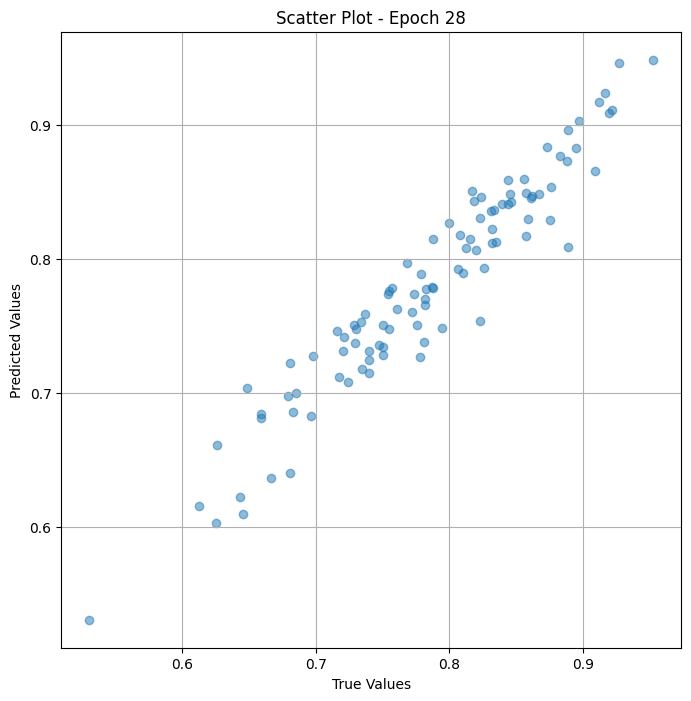

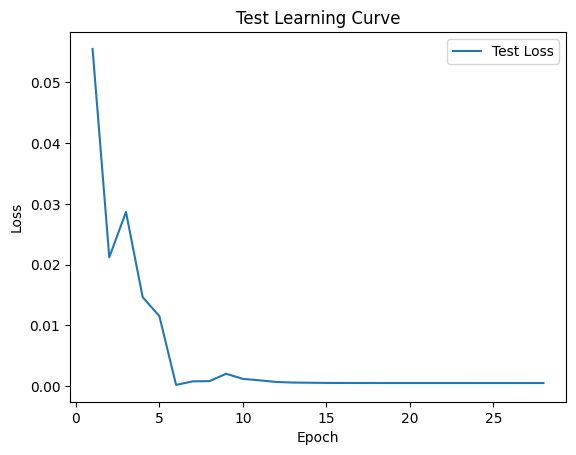


 Epoch: (29/50) Loss = 0.0005277781747281551

 Epoch: (29/50) Loss_rmse = 0.022973423823714256

 Epoch: (29/50) R^2 = 0.9311414957046509

 Epoch: (29/50) MAE = 0.021987885236740112
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586

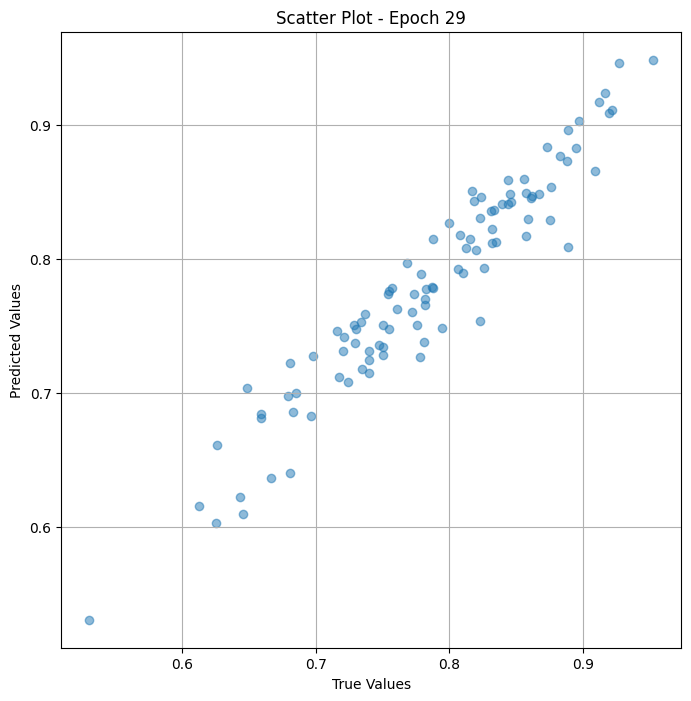

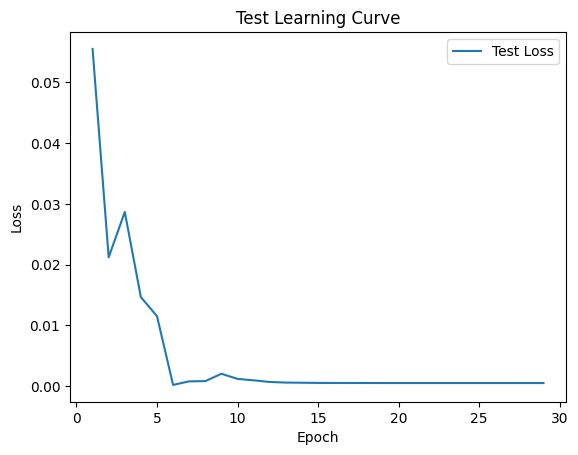


 Epoch: (30/50) Loss = 0.0005275568109937012

 Epoch: (30/50) Loss_rmse = 0.022968605160713196

 Epoch: (30/50) R^2 = 0.9311703443527222

 Epoch: (30/50) MAE = 0.021983176469802856
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586

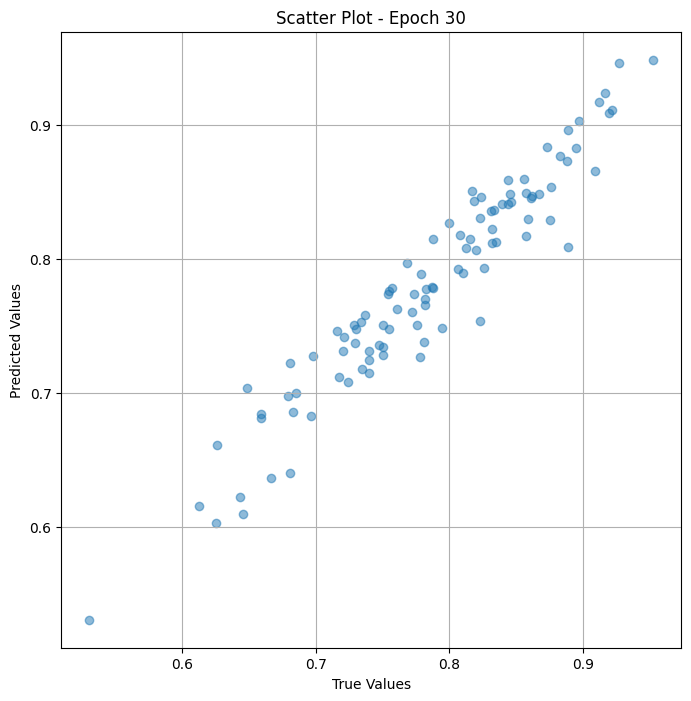

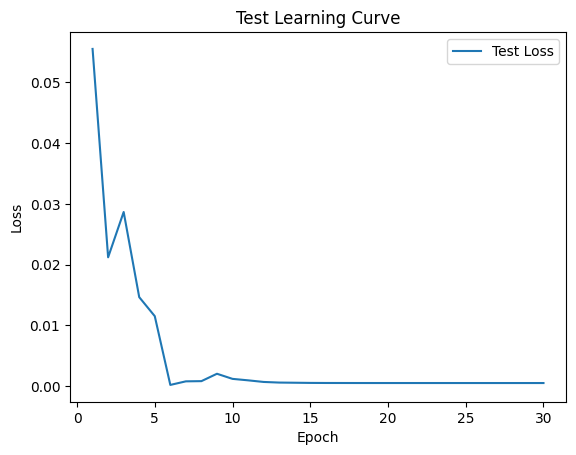


 Epoch: (31/50) Loss = 0.0005273286951705813

 Epoch: (31/50) Loss_rmse = 0.022963639348745346

 Epoch: (31/50) R^2 = 0.9312001466751099

 Epoch: (31/50) MAE = 0.02197834849357605
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586,

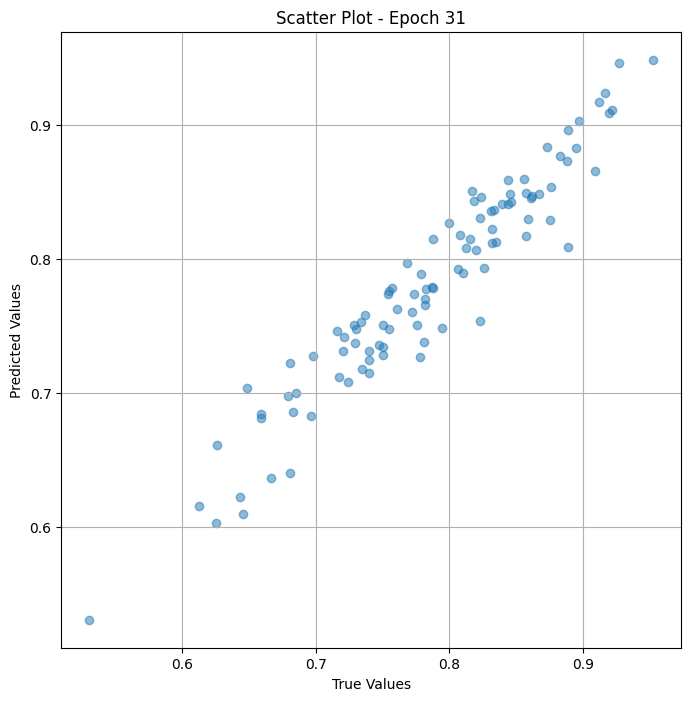

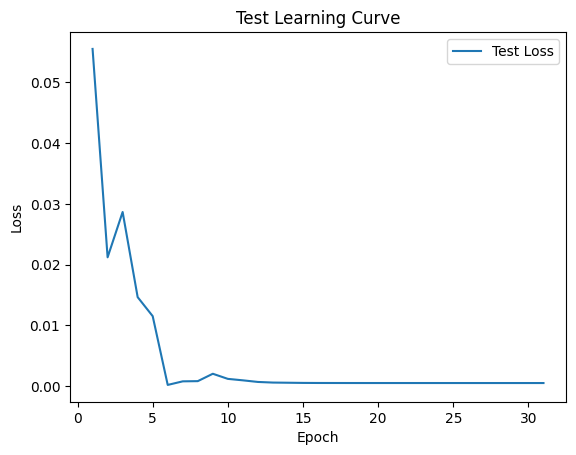


 Epoch: (32/50) Loss = 0.0005271006957627833

 Epoch: (32/50) Loss_rmse = 0.022958673536777496

 Epoch: (32/50) R^2 = 0.9312298893928528

 Epoch: (32/50) MAE = 0.021973490715026855
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586

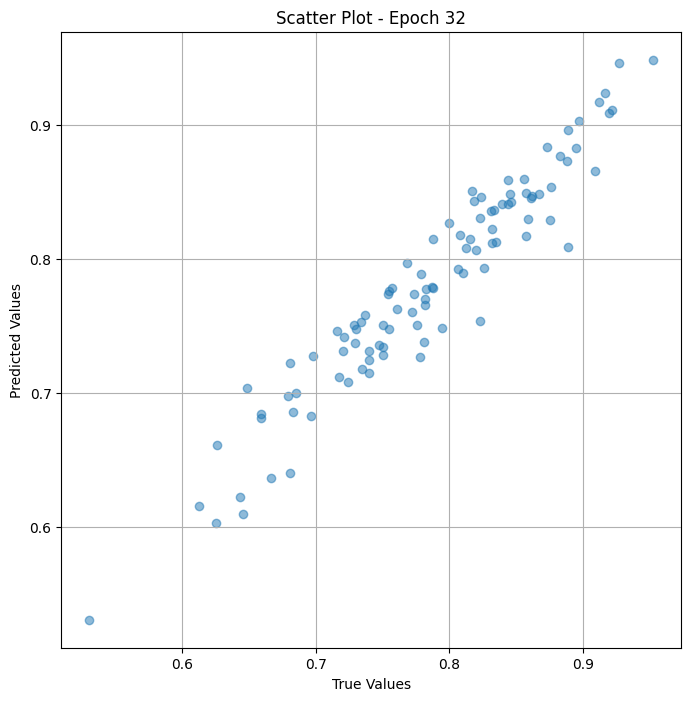

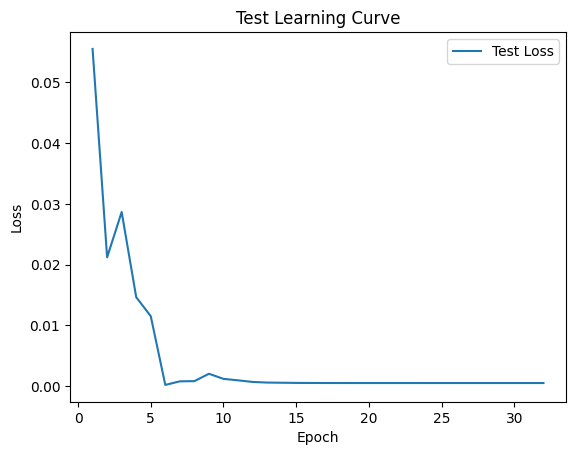


 Epoch: (33/50) Loss = 0.0005268612294457853

 Epoch: (33/50) Loss_rmse = 0.02295345813035965

 Epoch: (33/50) R^2 = 0.9312611222267151

 Epoch: (33/50) MAE = 0.021968409419059753
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586,

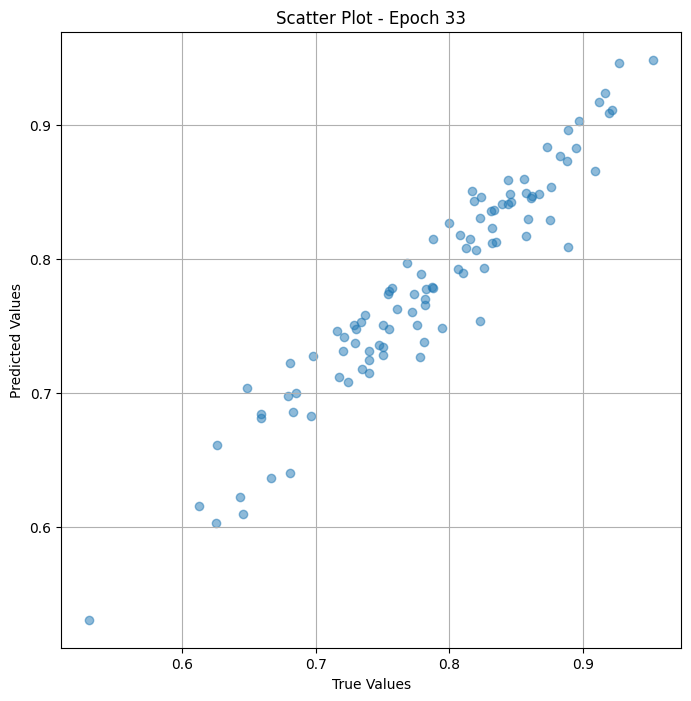

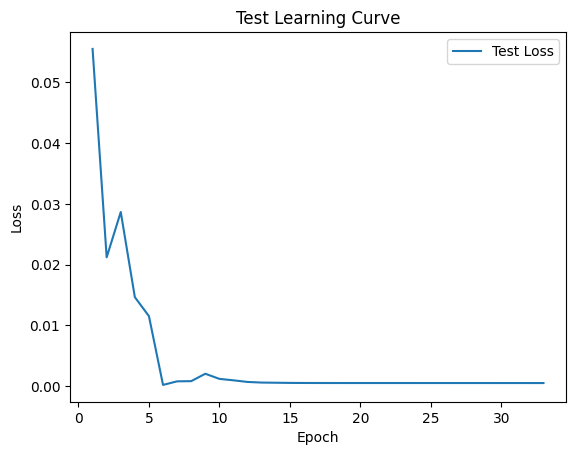


 Epoch: (34/50) Loss = 0.0005266205407679081

 Epoch: (34/50) Loss_rmse = 0.022948214784264565

 Epoch: (34/50) R^2 = 0.9312925338745117

 Epoch: (34/50) MAE = 0.021963268518447876
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586

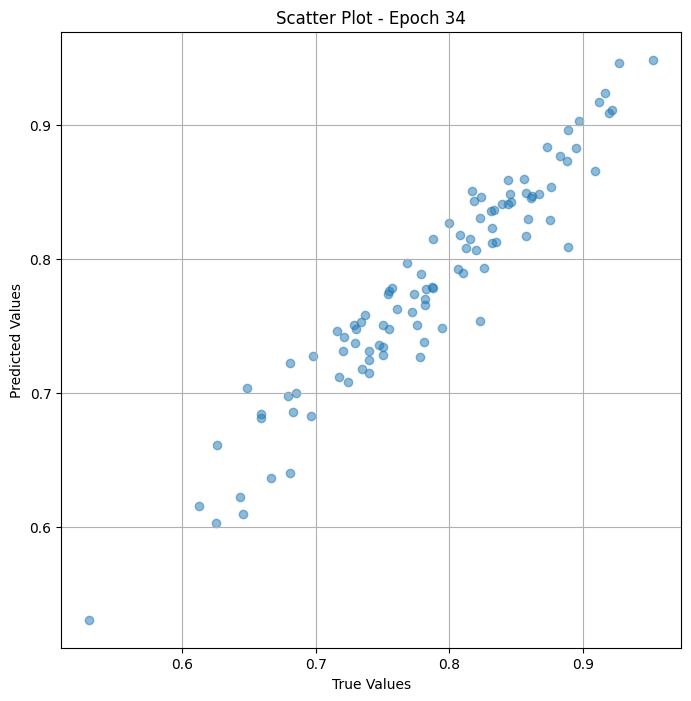

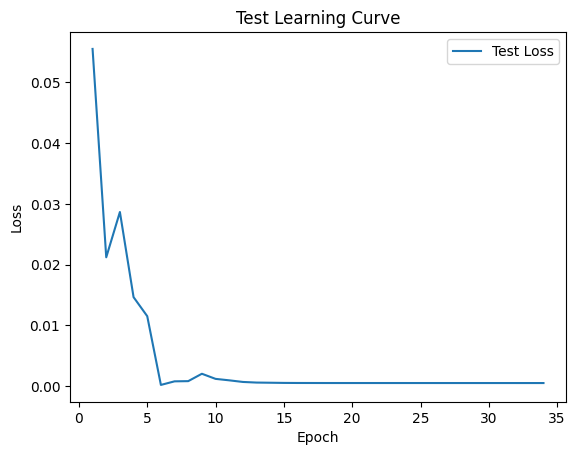


 Epoch: (35/50) Loss = 0.0005263738567009568

 Epoch: (35/50) Loss_rmse = 0.022942839190363884

 Epoch: (35/50) R^2 = 0.9313247203826904

 Epoch: (35/50) MAE = 0.02195802330970764
Spearman correlation coefficient: SignificanceResult(statistic=0.9505105626886025, pvalue=1.6399884290470248e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586,

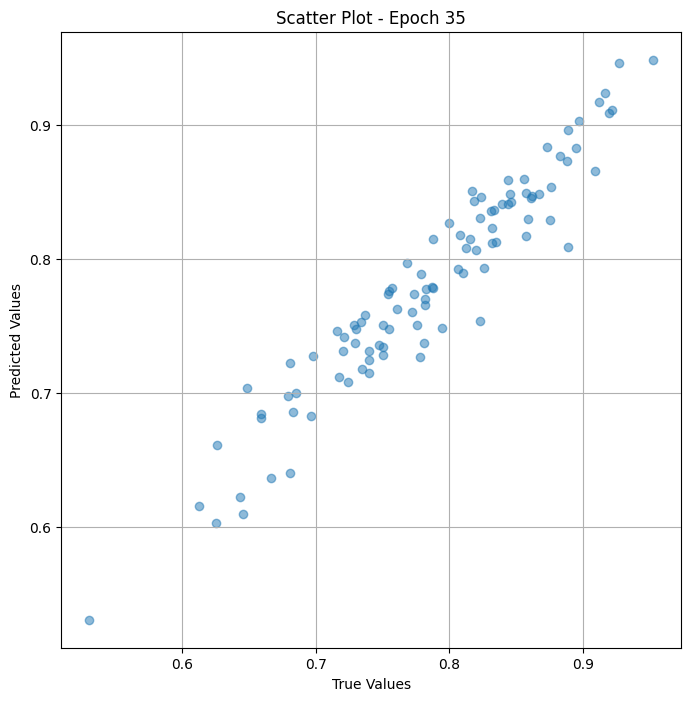

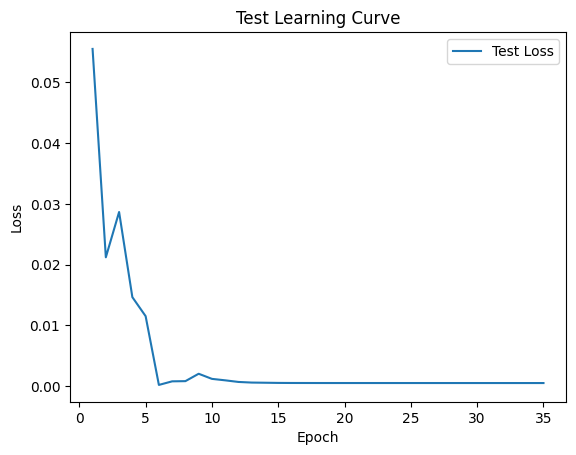


 Epoch: (36/50) Loss = 0.0005261257756501436

 Epoch: (36/50) Loss_rmse = 0.022937431931495667

 Epoch: (36/50) R^2 = 0.9313570857048035

 Epoch: (36/50) MAE = 0.021952733397483826
Spearman correlation coefficient: SignificanceResult(statistic=0.9507954330218641, pvalue=1.2585218429899011e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586

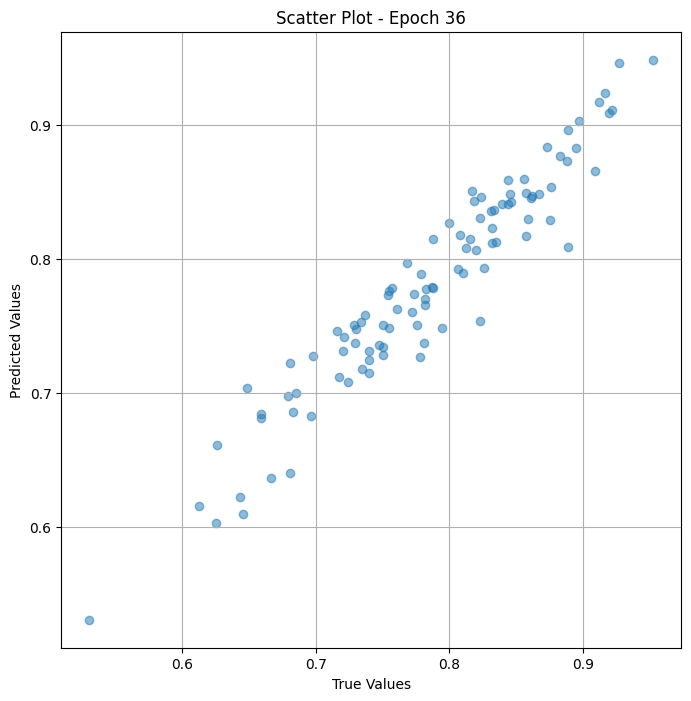

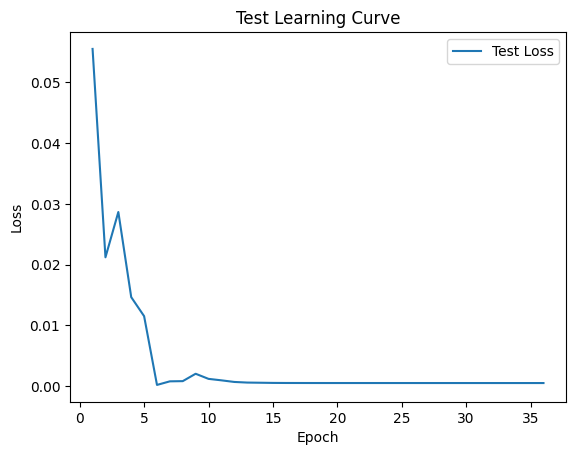


 Epoch: (37/50) Loss = 0.0005258691962808371

 Epoch: (37/50) Loss_rmse = 0.022931838408112526

 Epoch: (37/50) R^2 = 0.9313905239105225

 Epoch: (37/50) MAE = 0.021947279572486877
Spearman correlation coefficient: SignificanceResult(statistic=0.9507954330218641, pvalue=1.2585218429899011e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586

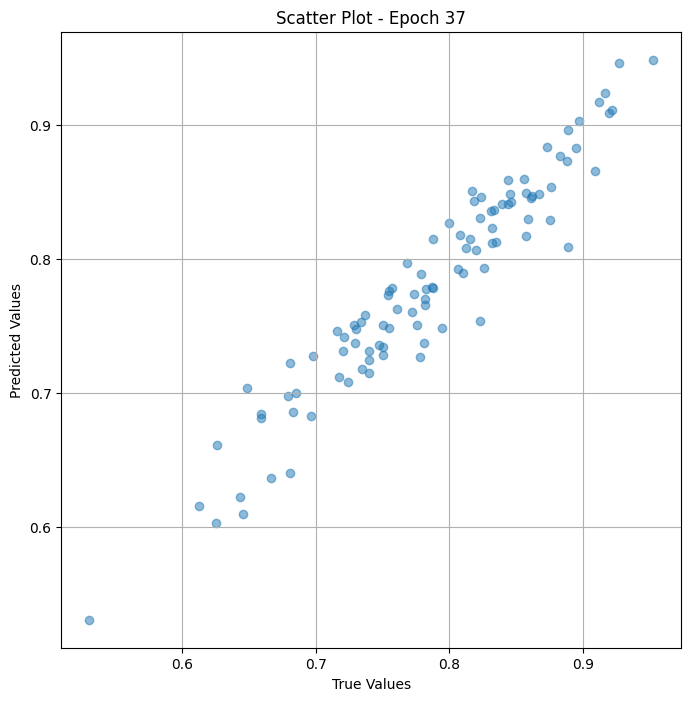

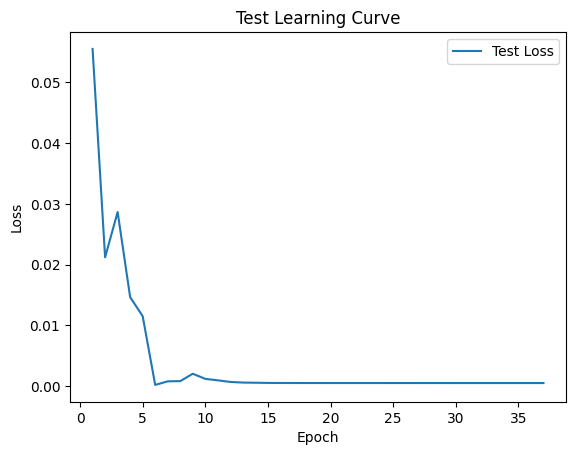


 Epoch: (38/50) Loss = 0.0005256111035123467

 Epoch: (38/50) Loss_rmse = 0.02292620949447155

 Epoch: (38/50) R^2 = 0.9314242005348206

 Epoch: (38/50) MAE = 0.021941781044006348
Spearman correlation coefficient: SignificanceResult(statistic=0.9507954330218641, pvalue=1.2585218429899011e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586,

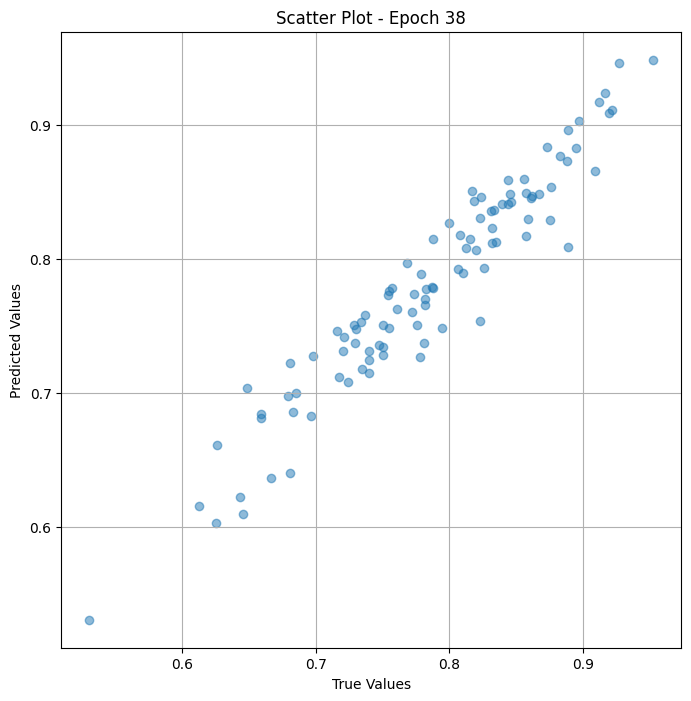

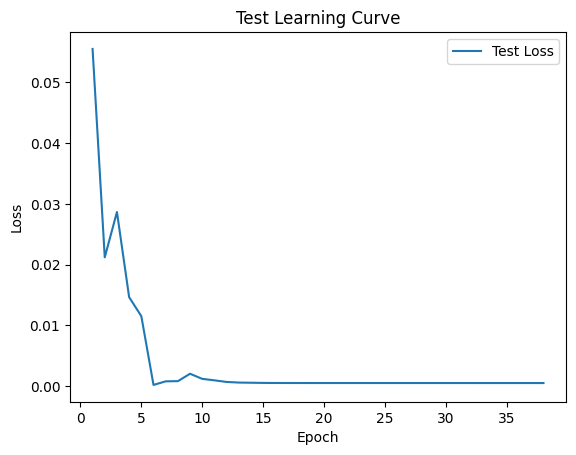


 Epoch: (39/50) Loss = 0.0005253511480987072

 Epoch: (39/50) Loss_rmse = 0.02292053960263729

 Epoch: (39/50) R^2 = 0.9314581155776978

 Epoch: (39/50) MAE = 0.02193625271320343
Spearman correlation coefficient: SignificanceResult(statistic=0.9509175203075475, pvalue=1.1229864084341622e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 

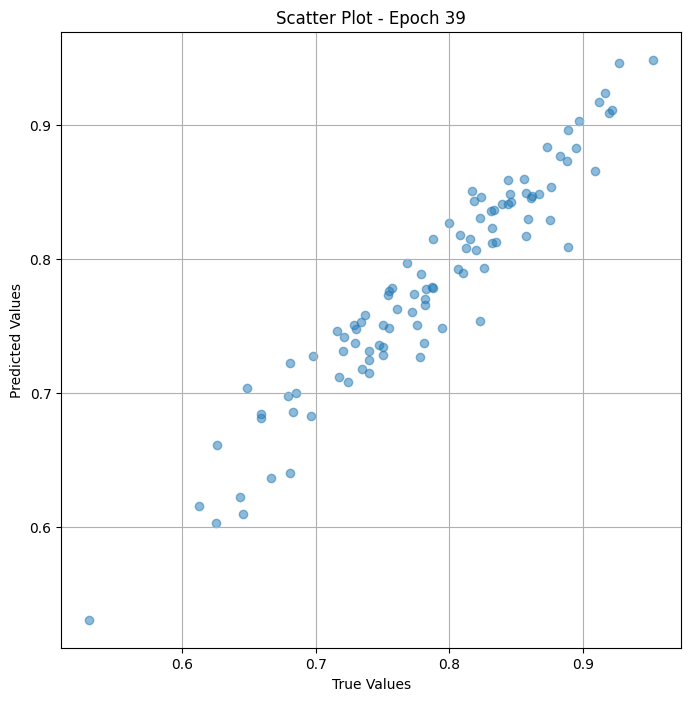

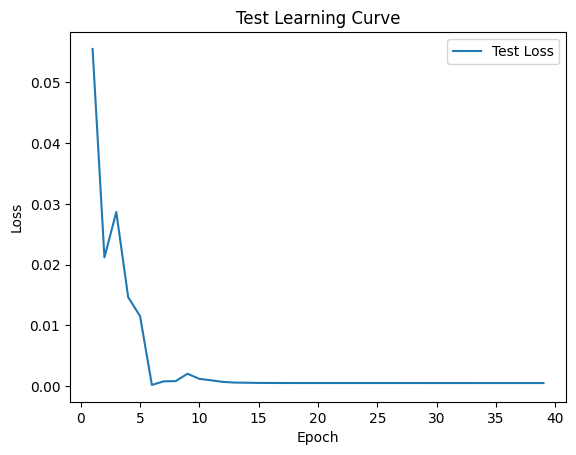


 Epoch: (40/50) Loss = 0.0005250843241810799

 Epoch: (40/50) Loss_rmse = 0.022914718836545944

 Epoch: (40/50) R^2 = 0.9314929246902466

 Epoch: (40/50) MAE = 0.021930575370788574
Spearman correlation coefficient: SignificanceResult(statistic=0.9509175203075475, pvalue=1.1229864084341622e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586

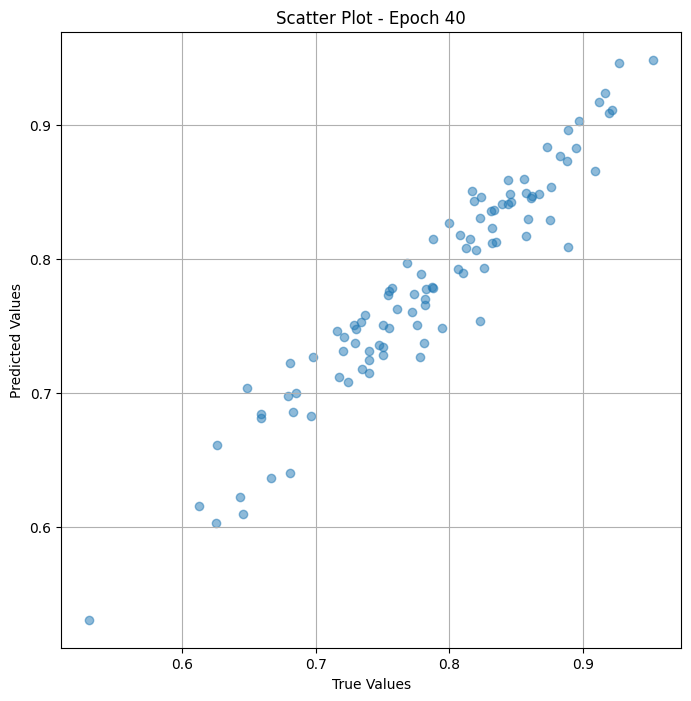

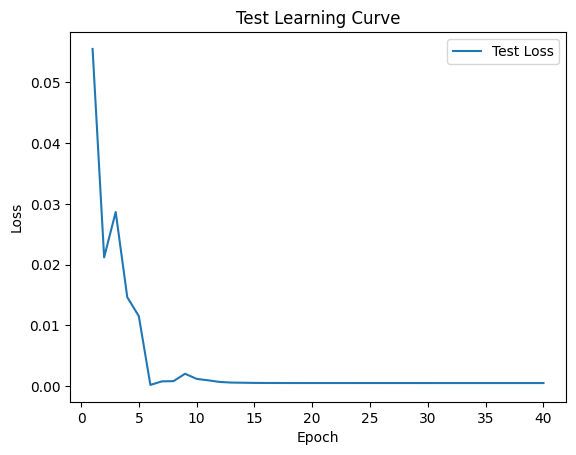


 Epoch: (41/50) Loss = 0.0005248145898804069

 Epoch: (41/50) Loss_rmse = 0.022908832877874374

 Epoch: (41/50) R^2 = 0.9315281510353088

 Epoch: (41/50) MAE = 0.021924808621406555
Spearman correlation coefficient: SignificanceResult(statistic=0.9509175203075475, pvalue=1.1229864084341622e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586

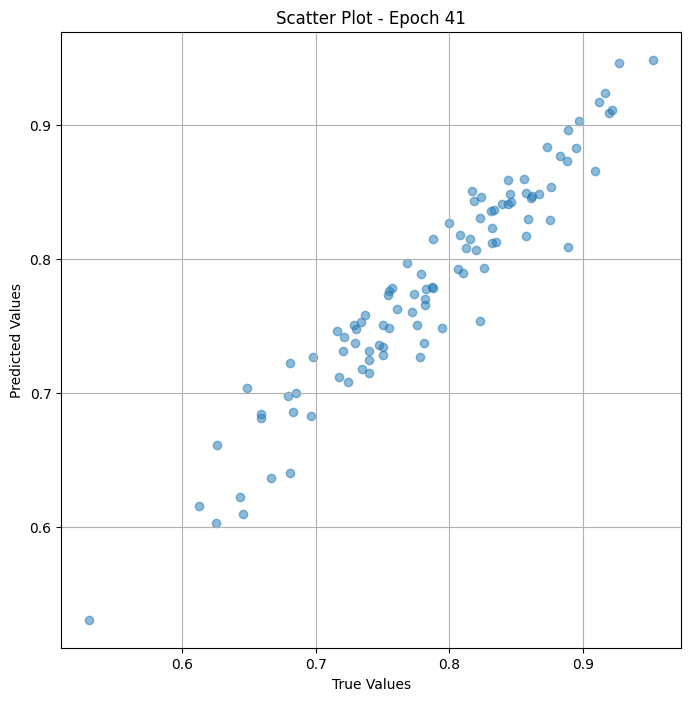

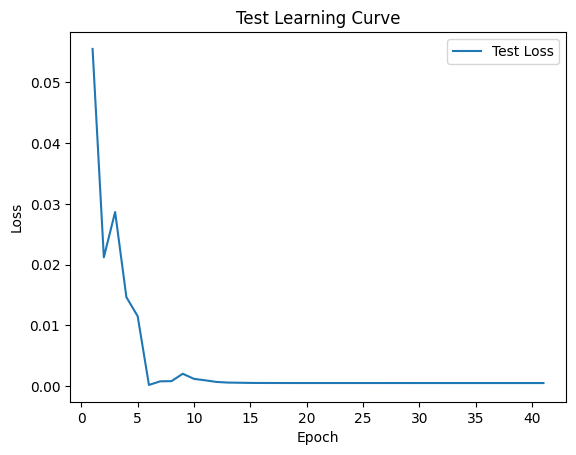


 Epoch: (42/50) Loss = 0.0005245401989668608

 Epoch: (42/50) Loss_rmse = 0.022902842611074448

 Epoch: (42/50) R^2 = 0.9315639734268188

 Epoch: (42/50) MAE = 0.021918967366218567
Spearman correlation coefficient: SignificanceResult(statistic=0.9509175203075475, pvalue=1.1229864084341622e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586

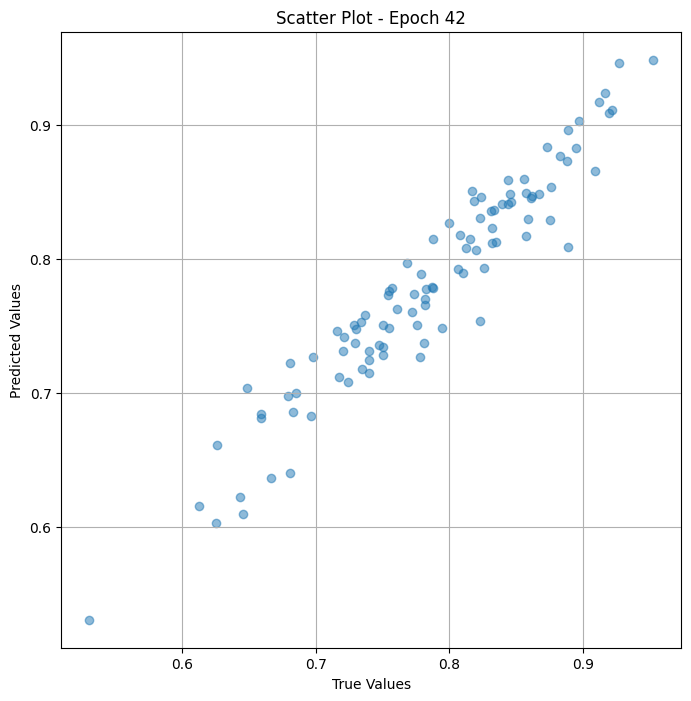

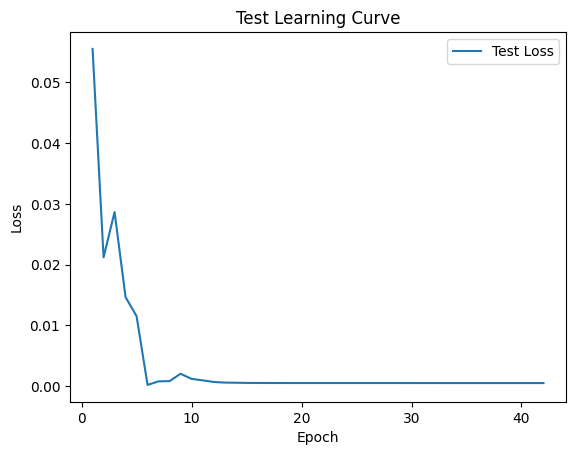


 Epoch: (43/50) Loss = 0.0005242599872872233

 Epoch: (43/50) Loss_rmse = 0.022896723821759224

 Epoch: (43/50) R^2 = 0.9316005110740662

 Epoch: (43/50) MAE = 0.021912992000579834
Spearman correlation coefficient: SignificanceResult(statistic=0.9509175203075475, pvalue=1.1229864084341622e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586

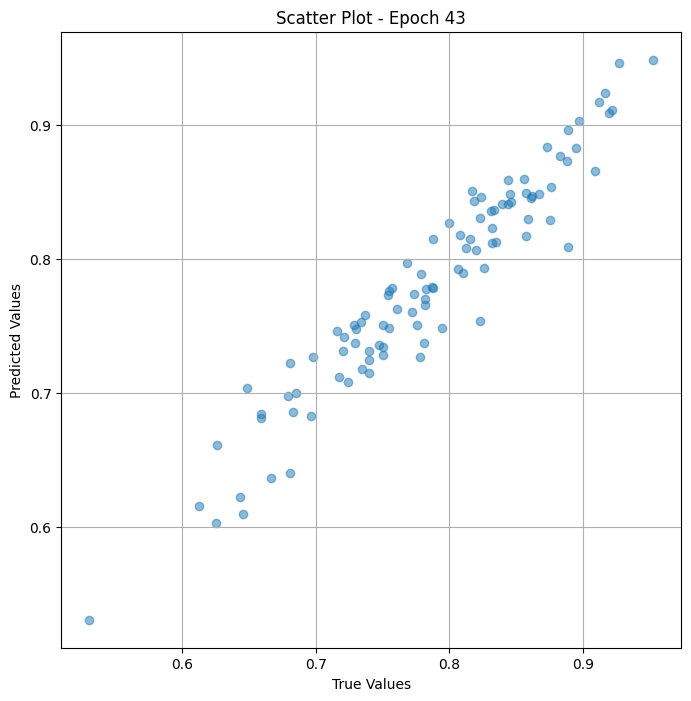

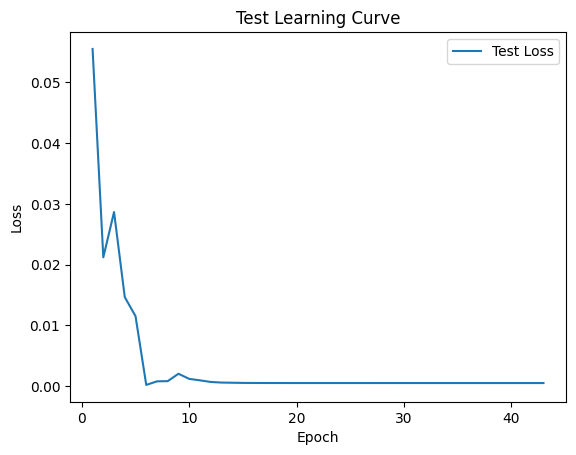


 Epoch: (44/50) Loss = 0.0005239759339019656

 Epoch: (44/50) Loss_rmse = 0.022890521213412285

 Epoch: (44/50) R^2 = 0.9316375851631165

 Epoch: (44/50) MAE = 0.021906927227973938
Spearman correlation coefficient: SignificanceResult(statistic=0.9509175203075475, pvalue=1.1229864084341622e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586

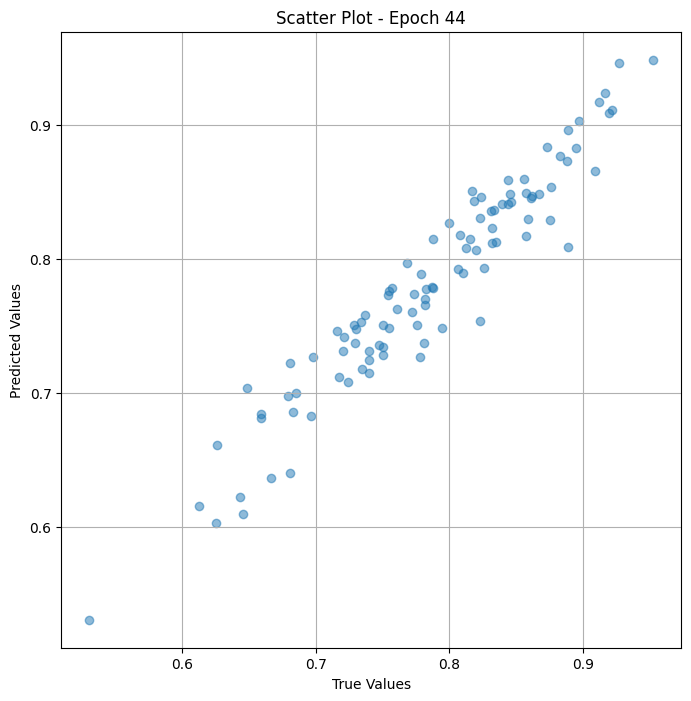

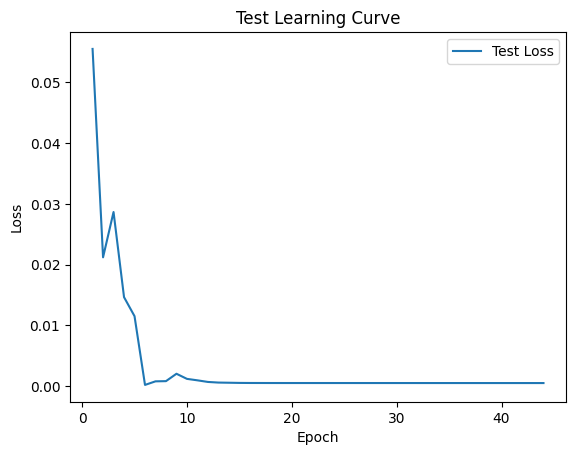


 Epoch: (45/50) Loss = 0.0005236918805167079

 Epoch: (45/50) Loss_rmse = 0.022884314879775047

 Epoch: (45/50) R^2 = 0.931674599647522

 Epoch: (45/50) MAE = 0.021900862455368042
Spearman correlation coefficient: SignificanceResult(statistic=0.9509175203075475, pvalue=1.1229864084341622e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586,

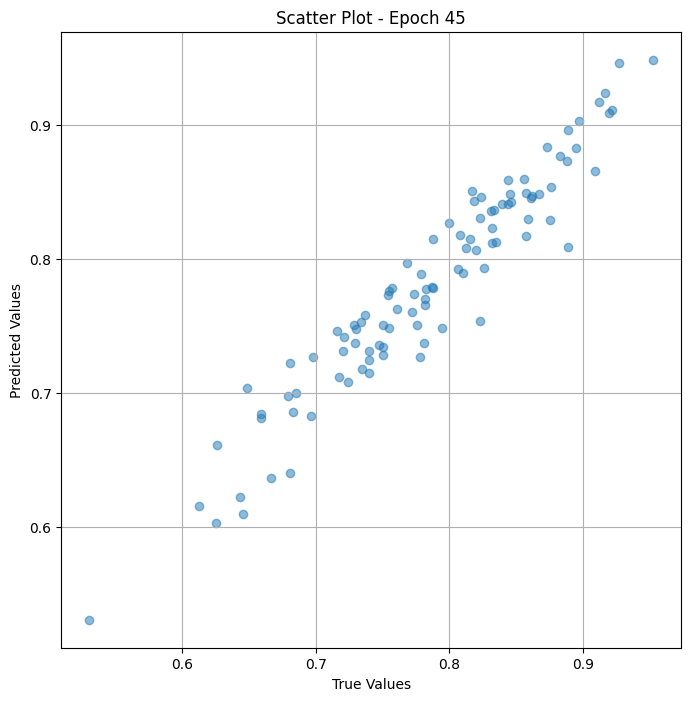

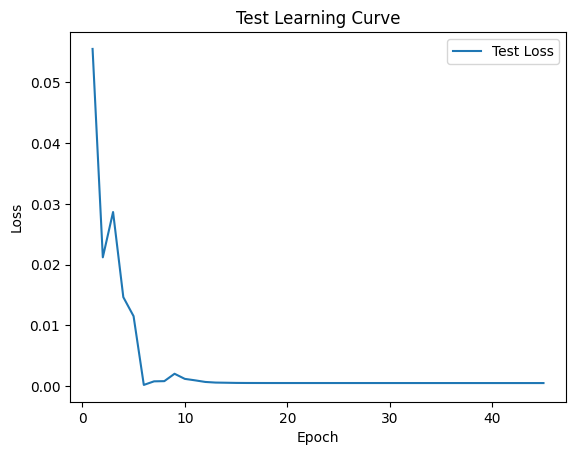


 Epoch: (46/50) Loss = 0.0005234032869338989

 Epoch: (46/50) Loss_rmse = 0.02287800796329975

 Epoch: (46/50) R^2 = 0.93171226978302

 Epoch: (46/50) MAE = 0.021894708275794983
Spearman correlation coefficient: SignificanceResult(statistic=0.9509175203075475, pvalue=1.1229864084341622e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0

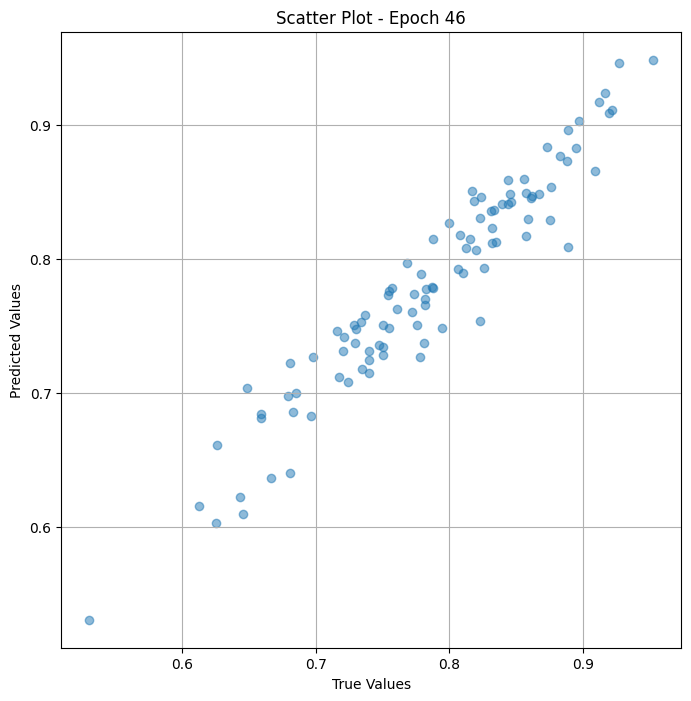

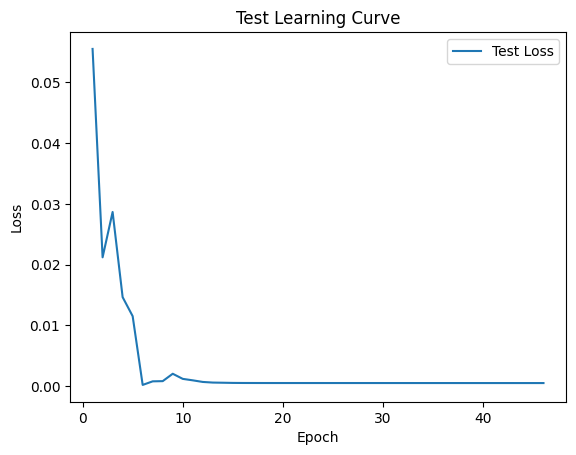


 Epoch: (47/50) Loss = 0.0005231074173934758

 Epoch: (47/50) Loss_rmse = 0.02287154085934162

 Epoch: (47/50) R^2 = 0.9317508935928345

 Epoch: (47/50) MAE = 0.02188839018344879
Spearman correlation coefficient: SignificanceResult(statistic=0.9509175203075475, pvalue=1.1229864084341622e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 

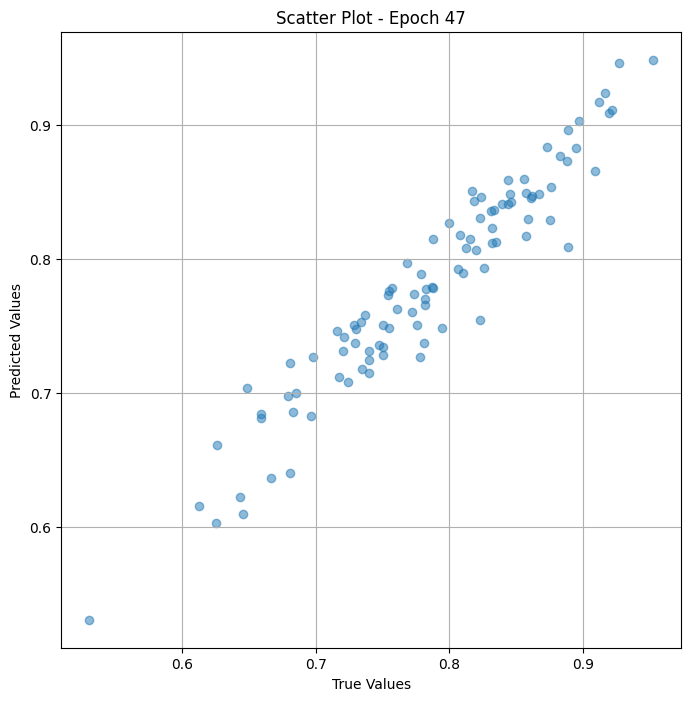

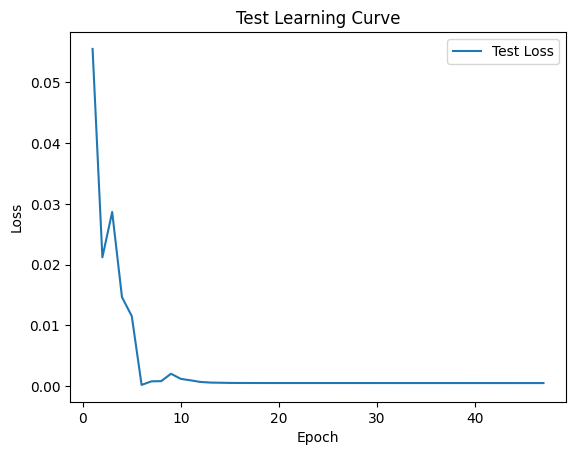


 Epoch: (48/50) Loss = 0.0005228105583228171

 Epoch: (48/50) Loss_rmse = 0.0228650514036417

 Epoch: (48/50) R^2 = 0.9317896366119385

 Epoch: (48/50) MAE = 0.021882057189941406
Spearman correlation coefficient: SignificanceResult(statistic=0.9509175203075475, pvalue=1.1229864084341622e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 

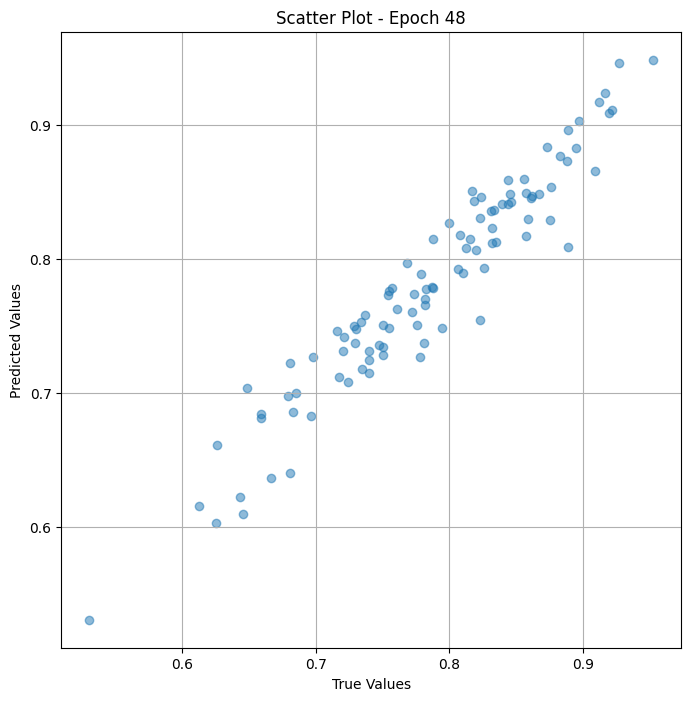

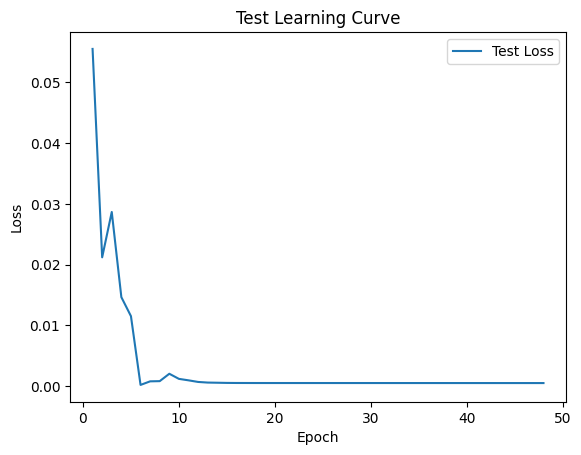


 Epoch: (49/50) Loss = 0.000522509275469929

 Epoch: (49/50) Loss_rmse = 0.02285846136510372

 Epoch: (49/50) R^2 = 0.9318289160728455

 Epoch: (49/50) MAE = 0.02187560498714447
Spearman correlation coefficient: SignificanceResult(statistic=0.9509175203075475, pvalue=1.1229864084341622e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0

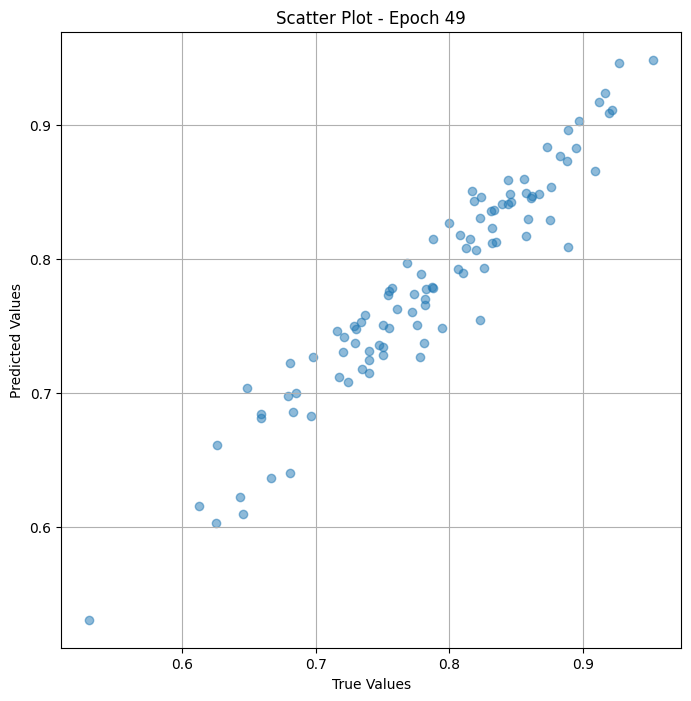

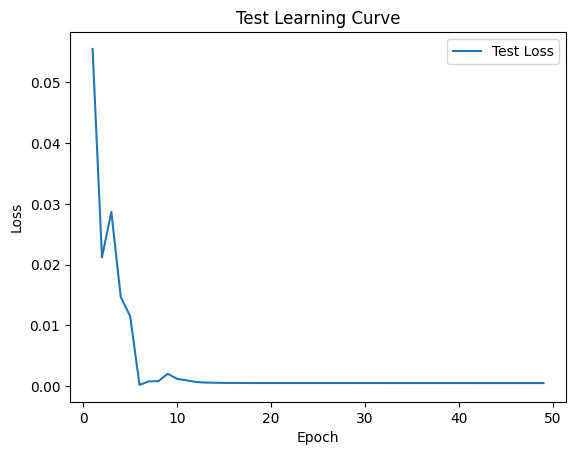


 Epoch: (50/50) Loss = 0.0005222060717642307

 Epoch: (50/50) Loss_rmse = 0.02285182848572731

 Epoch: (50/50) R^2 = 0.9318684935569763

 Epoch: (50/50) MAE = 0.021869122982025146
Spearman correlation coefficient: SignificanceResult(statistic=0.9509175203075475, pvalue=1.1229864084341622e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586,

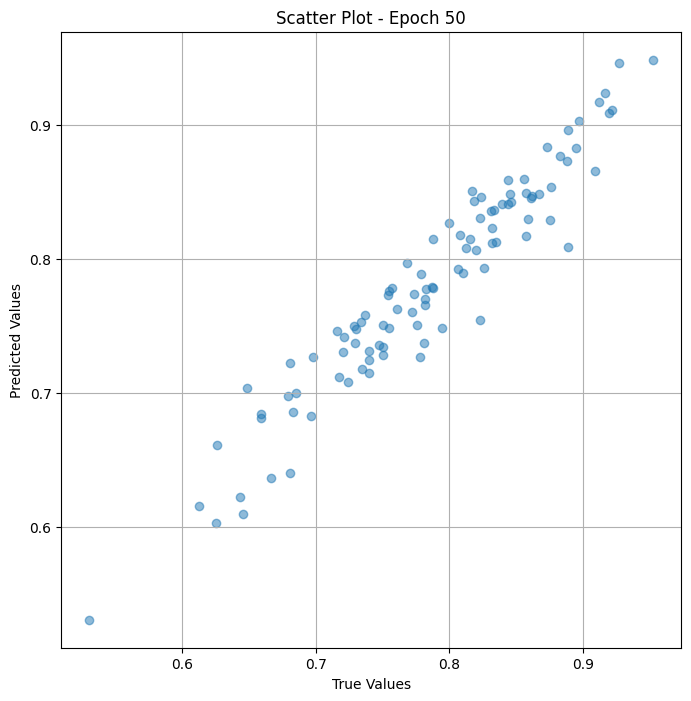

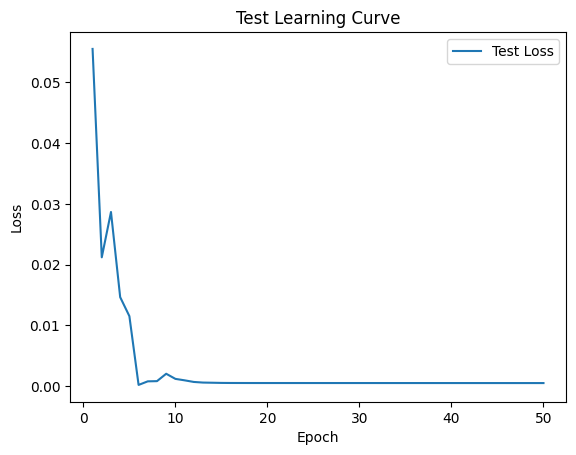

In [ ]:
# val the model and save weights
fit(50, model_vit_test , test_dl )
torch.save(model_vit_test.state_dict(), "model_weights_s")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds = model_vit(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_sports' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_test_sports['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

                                           Image Path  True Value  \
0       /content/sports/000000481014_preprocessed.jpg    0.728395   
1    /content/sports/n00470966_19377_preprocessed.jpg    0.867347   
2     /content/sports/n00445351_8665_preprocessed.jpg    0.835165   
3   /content/sports/a5f627b7166f2f0f_preprocessed.jpg    0.839286   
4   /content/sports/aacabf9b3fe435d3_preprocessed.jpg    0.818182   
..                                                ...         ...   
95  /content/sports/4c0275745141b853_preprocessed.jpg    0.680851   
96      /content/sports/000000421908_preprocessed.jpg    0.659341   
97  /content/sports/7aaf2ad4bd23d9a8_preprocessed.jpg    0.872727   
98   /content/sports/n00440941_10444_preprocessed.jpg    0.698113   
99  /content/sports/a6cff7d33b841d2f_preprocessed.jpg    0.823529   

    Predicted Value  
0          0.767181  
1          0.764105  
2          0.843016  
3          0.791563  
4          0.830910  
..              ...  
95         0.6643

#Finetuning

##Train

In [ ]:
class Dataset_train_fine(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_train_sports["memoscore"]
        self.images = df_train_sports["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
train_ds_fine = Dataset_train_fine(df_train_sports, trans_transform=trans_transform)
train_dl_fine = DataLoader(train_ds_fine, batch_size=16, shuffle=False)

# เรียกดูข้อมูลจาก DataLoader
'''for image_trans, label in train_dl:
    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch
    print(image_trans)
    break'''


'for image_trans, label in train_dl:\n    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch\n    print(image_trans)\n    break'

In [ ]:
class ViTMem_model_fine_sports(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))


    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit_fine =  ViTMem_model_fine_sports( arch="vit_base_patch16_224_miil")

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_fine = DeviceDataLoader(train_dl_fine, device)
model_vit_fine  = to_device(model_vit_fine  , device)

In [ ]:
params = [param for param in list(model_vit_fine.parameters()) if param.requires_grad == True ]
optimizer = torch.optim.Adam(params, lr=1e-4 ,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_fine, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_fine.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_fine(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/30) Loss = 0.00308529962785542

 Epoch: (1/30) Loss_rmse = 0.05554547533392906

 Epoch: (1/30) R^2 = 0.5109468698501587

 Epoch: (1/30) MAE = 0.047750987112522125
Spearman correlation coefficient: SignificanceResult(statistic=0.215116366066003, pvalue=3.3237943779583723e-20)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0

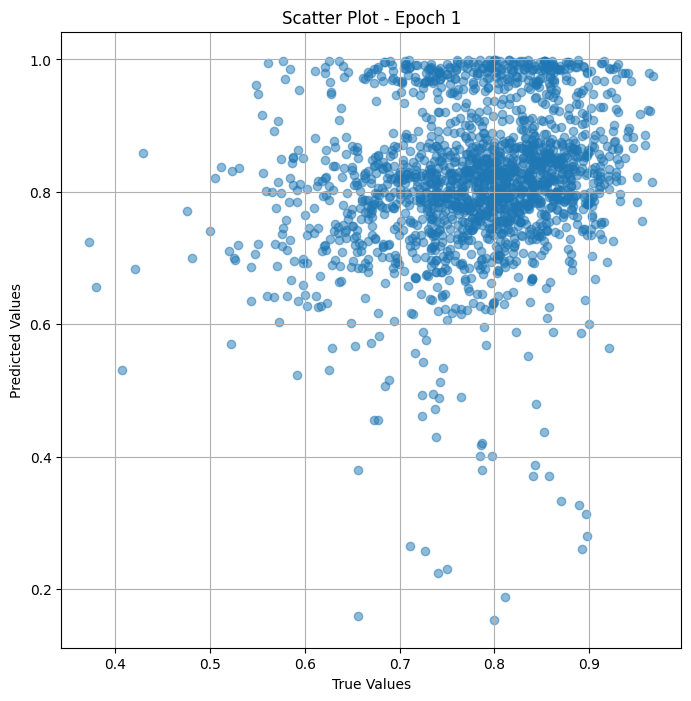

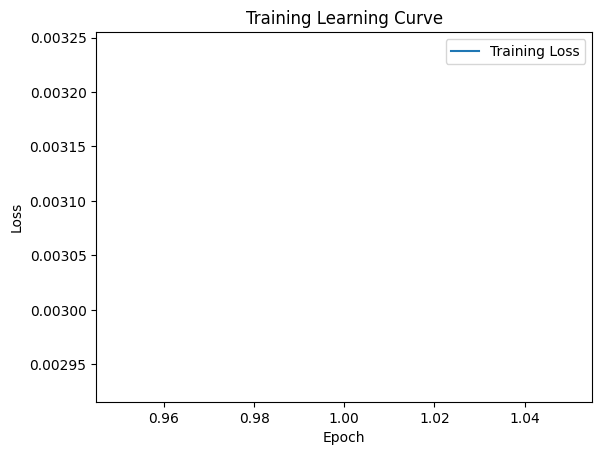


 Epoch: (2/30) Loss = 0.0037422298919409513

 Epoch: (2/30) Loss_rmse = 0.06117376685142517

 Epoch: (2/30) R^2 = 0.40681636333465576

 Epoch: (2/30) MAE = 0.041412726044654846
Spearman correlation coefficient: SignificanceResult(statistic=0.4991693584279359, pvalue=1.535323071367769e-113)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.7040816

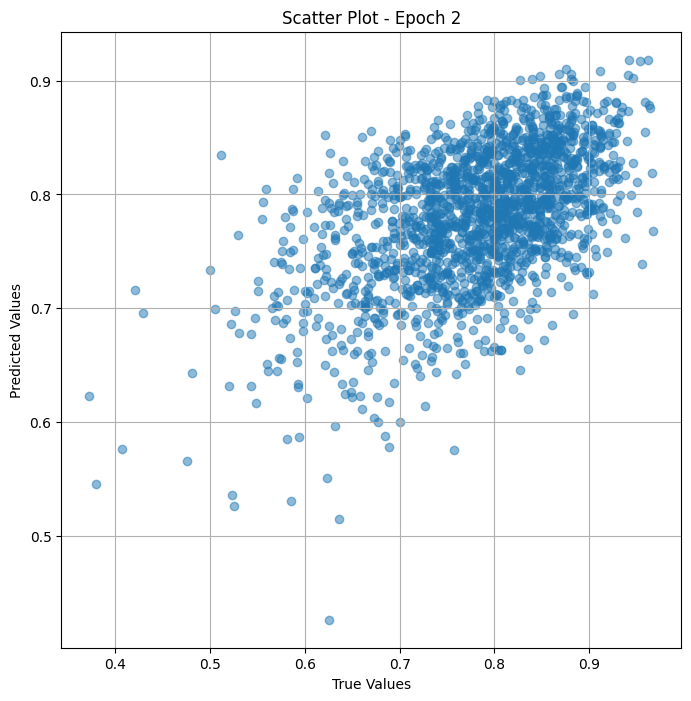

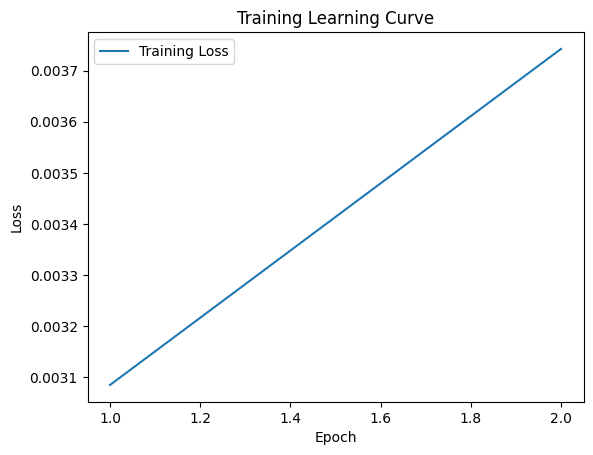


 Epoch: (3/30) Loss = 0.0013137944042682648

 Epoch: (3/30) Loss_rmse = 0.03624630346894264

 Epoch: (3/30) R^2 = 0.7917494773864746

 Epoch: (3/30) MAE = 0.029910579323768616
Spearman correlation coefficient: SignificanceResult(statistic=0.6379079490858155, pvalue=2.5259992725774386e-205)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.7040816

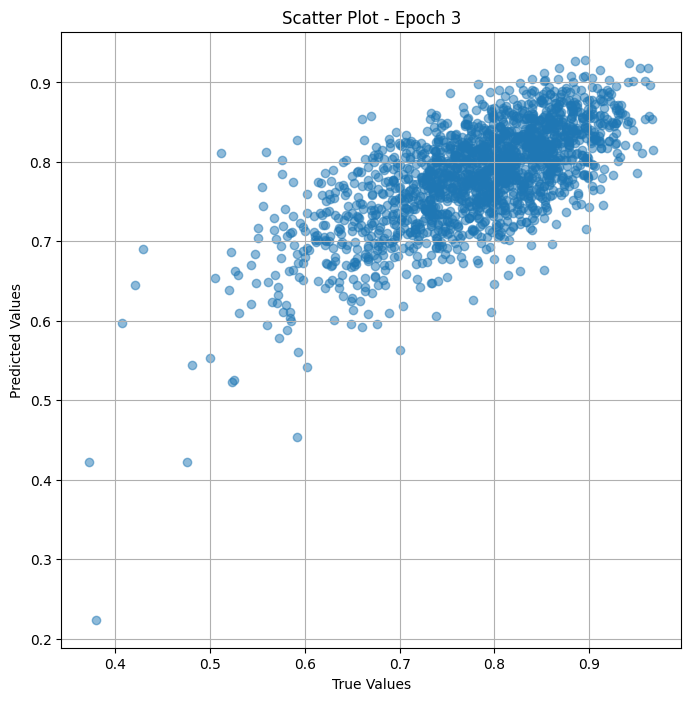

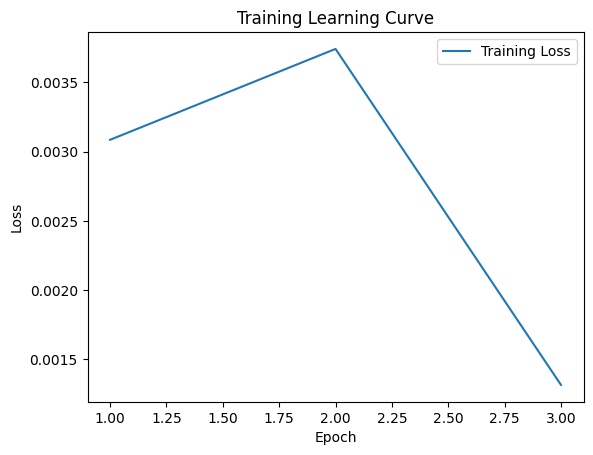


 Epoch: (4/30) Loss = 0.0010142840910702944

 Epoch: (4/30) Loss_rmse = 0.03184782713651657

 Epoch: (4/30) R^2 = 0.8392250537872314

 Epoch: (4/30) MAE = 0.023730166256427765
Spearman correlation coefficient: SignificanceResult(statistic=0.7361609036958011, pvalue=8.706439463585008e-306)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165

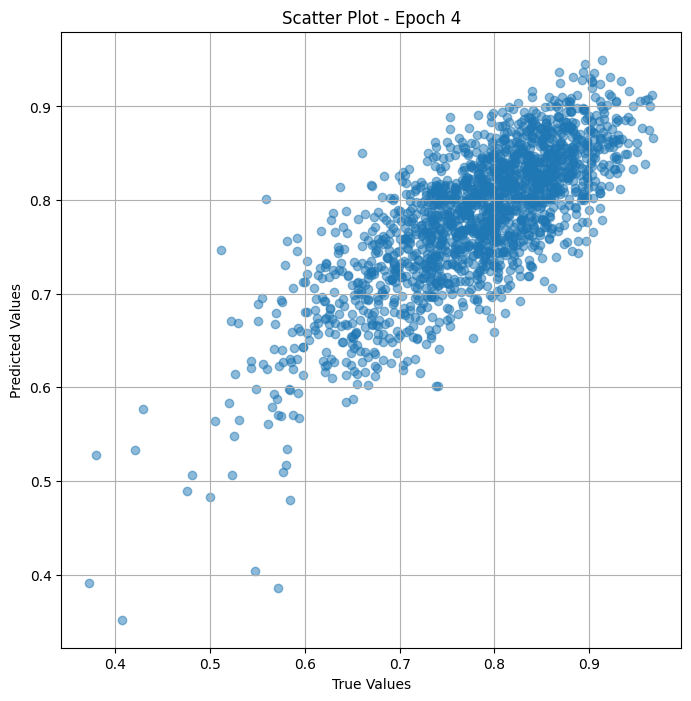

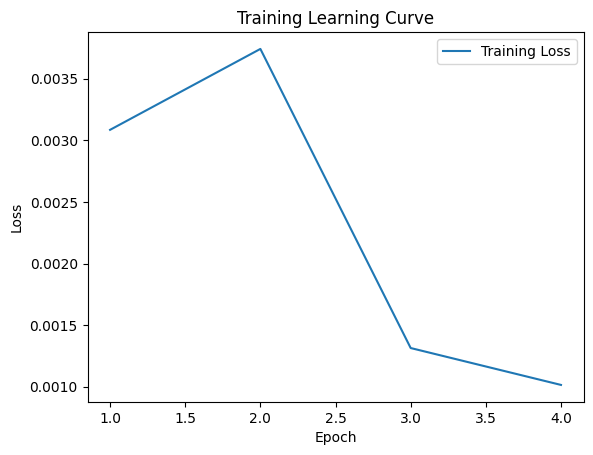


 Epoch: (5/30) Loss = 0.010192090645432472

 Epoch: (5/30) Loss_rmse = 0.10095588117837906

 Epoch: (5/30) R^2 = -0.6155558824539185

 Epoch: (5/30) MAE = 0.08187045902013779
Spearman correlation coefficient: SignificanceResult(statistic=0.6986347659124239, pvalue=1.441537097309585e-262)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165,

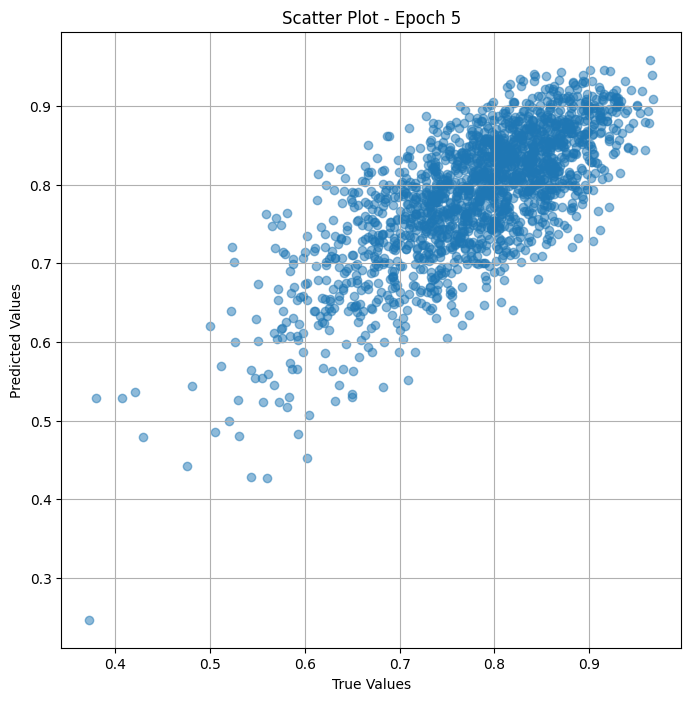

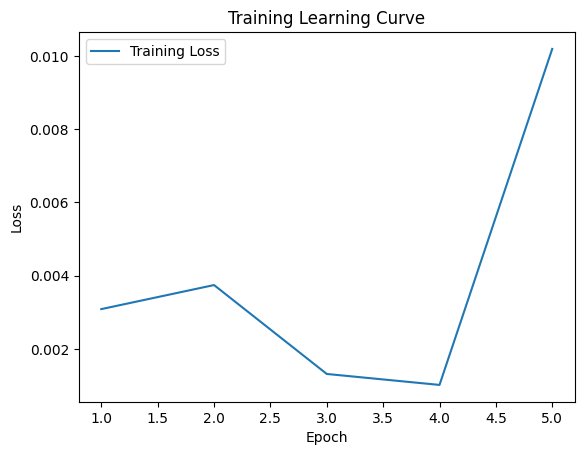


 Epoch: (6/30) Loss = 0.00142517383210361

 Epoch: (6/30) Loss_rmse = 0.03775147348642349

 Epoch: (6/30) R^2 = 0.7740946412086487

 Epoch: (6/30) MAE = 0.02994062751531601
Spearman correlation coefficient: SignificanceResult(statistic=0.6733610214428188, pvalue=4.47215199221487e-237)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.

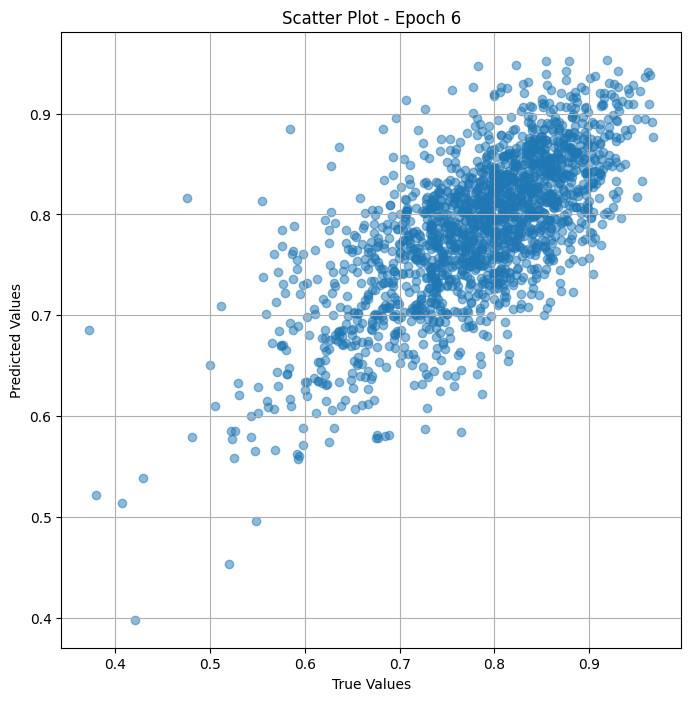

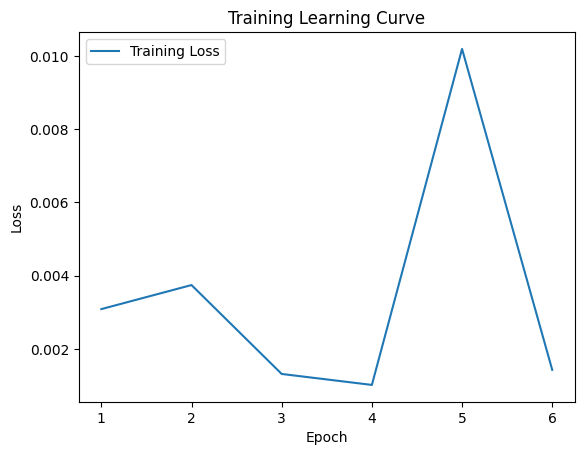


 Epoch: (7/30) Loss = 0.0007269879570230842

 Epoch: (7/30) Loss_rmse = 0.02696271426975727

 Epoch: (7/30) R^2 = 0.8847646117210388

 Epoch: (7/30) MAE = 0.020754508674144745
Spearman correlation coefficient: SignificanceResult(statistic=0.8607320154908872, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.8018

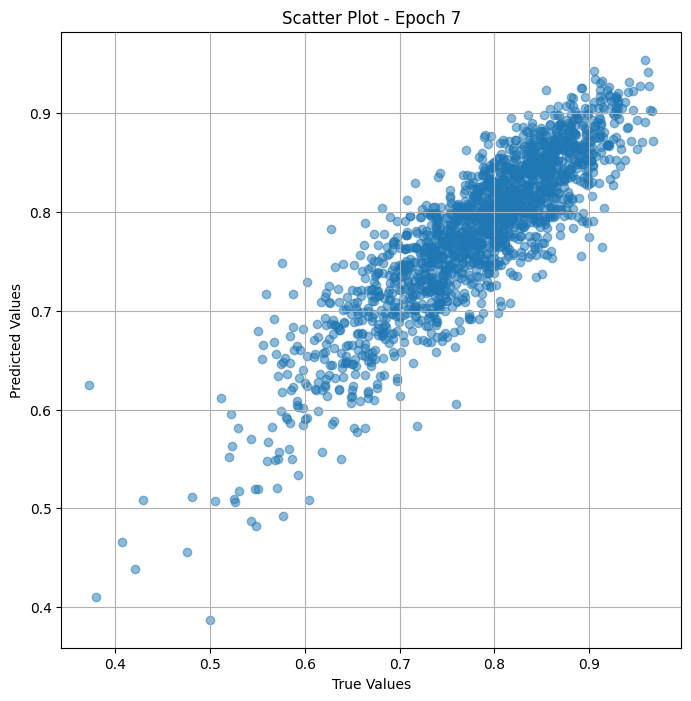

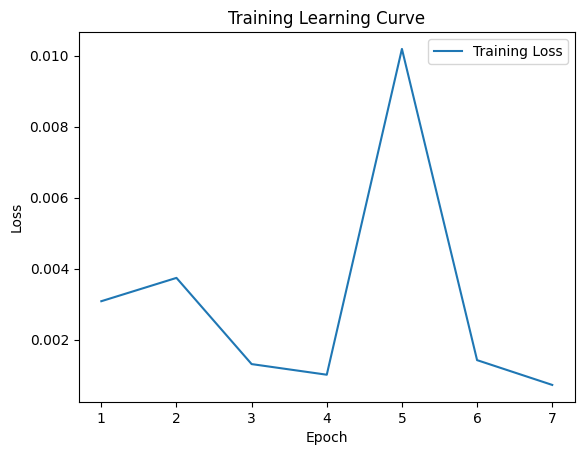


 Epoch: (8/30) Loss = 0.0012140206526964903

 Epoch: (8/30) Loss_rmse = 0.034842800348997116

 Epoch: (8/30) R^2 = 0.8075646758079529

 Epoch: (8/30) MAE = 0.027109965682029724
Spearman correlation coefficient: SignificanceResult(statistic=0.9165435986941802, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.801

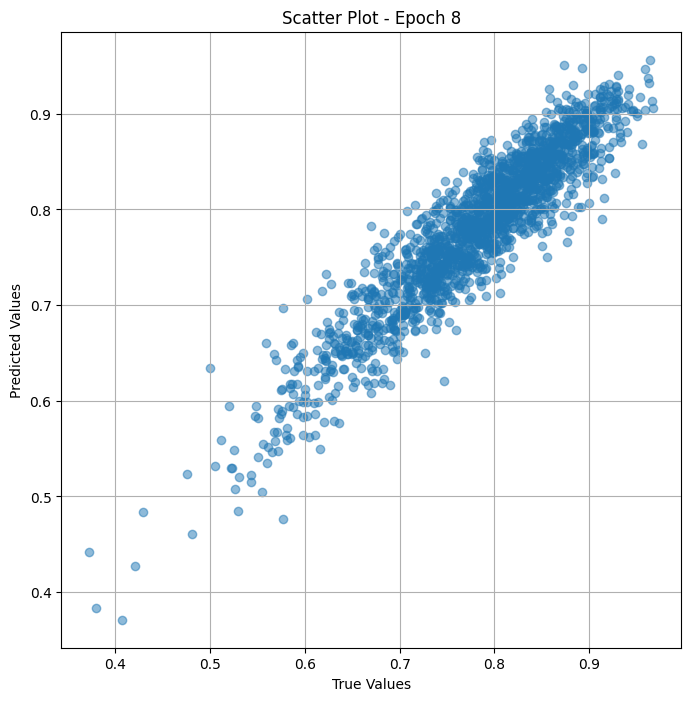

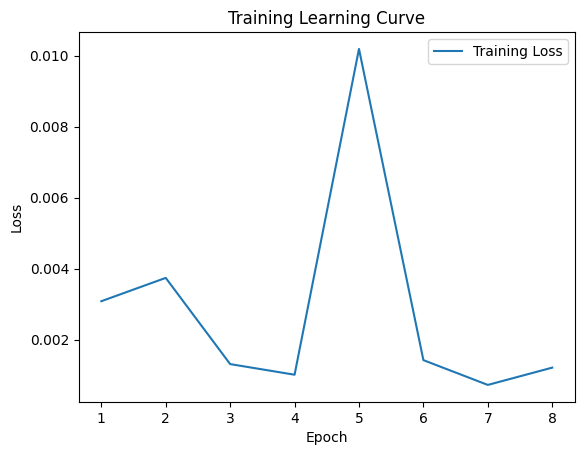


 Epoch: (9/30) Loss = 0.00044888758566230536

 Epoch: (9/30) Loss_rmse = 0.021186966449022293

 Epoch: (9/30) R^2 = 0.9288464784622192

 Epoch: (9/30) MAE = 0.016904965043067932
Spearman correlation coefficient: SignificanceResult(statistic=0.8878376479443452, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.80

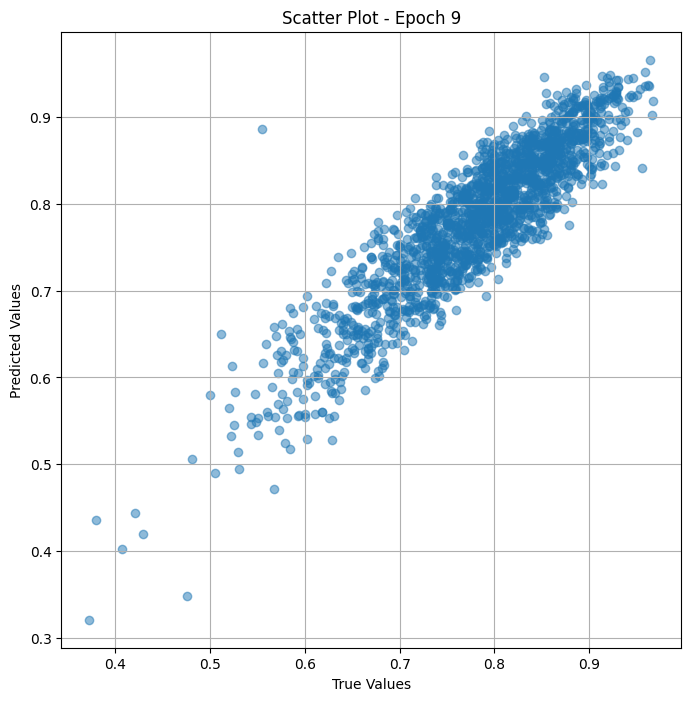

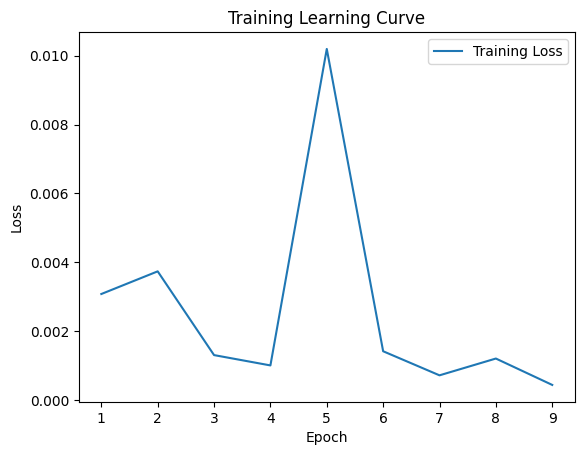


 Epoch: (10/30) Loss = 0.0014460210222750902

 Epoch: (10/30) Loss_rmse = 0.038026582449674606

 Epoch: (10/30) R^2 = 0.7707901000976562

 Epoch: (10/30) MAE = 0.03517953306436539
Spearman correlation coefficient: SignificanceResult(statistic=0.7070708405456714, pvalue=1.1051254974701443e-271)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.704

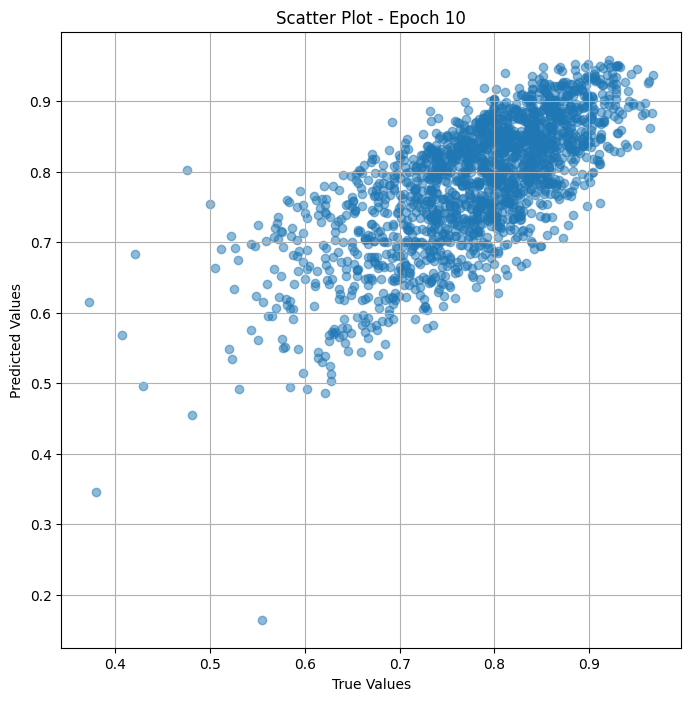

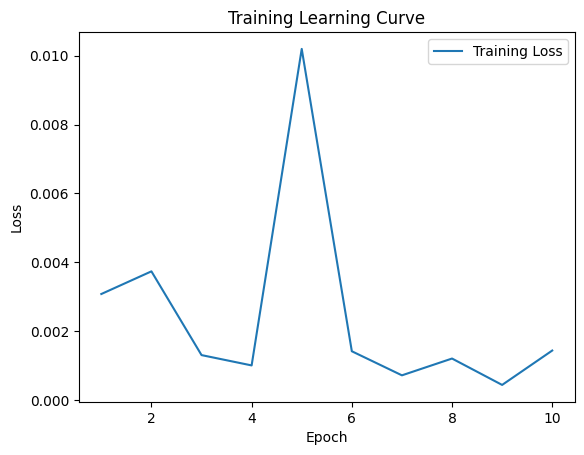


 Epoch: (11/30) Loss = 0.0006960132159292698

 Epoch: (11/30) Loss_rmse = 0.02638206258416176

 Epoch: (11/30) R^2 = 0.8896744251251221

 Epoch: (11/30) MAE = 0.020360320806503296
Spearman correlation coefficient: SignificanceResult(statistic=0.7169433016091155, pvalue=8.975190727190651e-283)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.7040

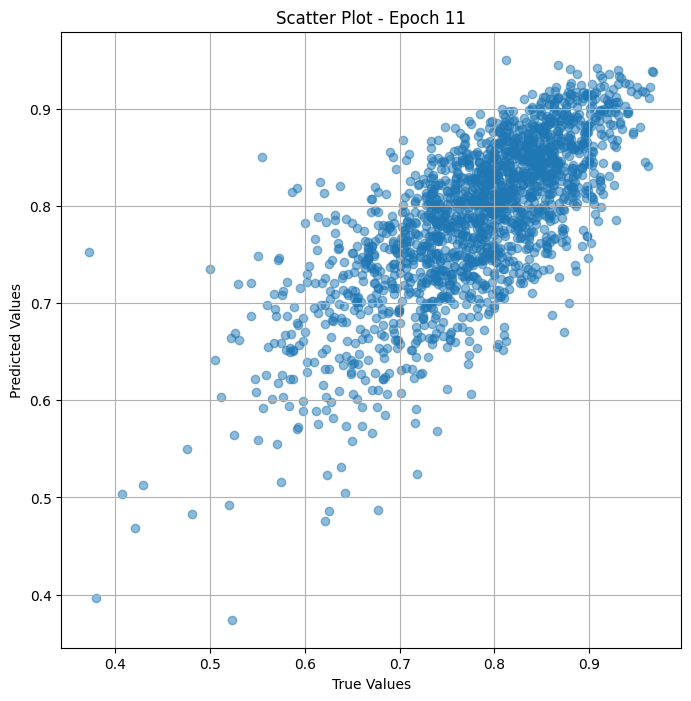

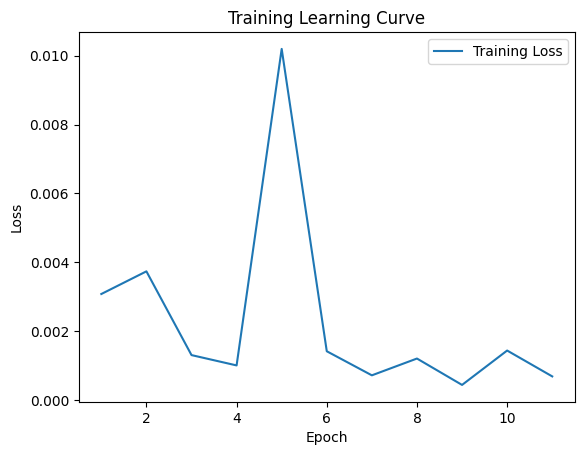

Epoch 0.06: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (12/30) Loss = 0.0035817199386656284

 Epoch: (12/30) Loss_rmse = 0.059847474098205566

 Epoch: (12/30) R^2 = 0.4322589039802551

 Epoch: (12/30) MAE = 0.048808492720127106
Spearman correlation coefficient: SignificanceResult(statistic=0.8091305766356757, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.846846

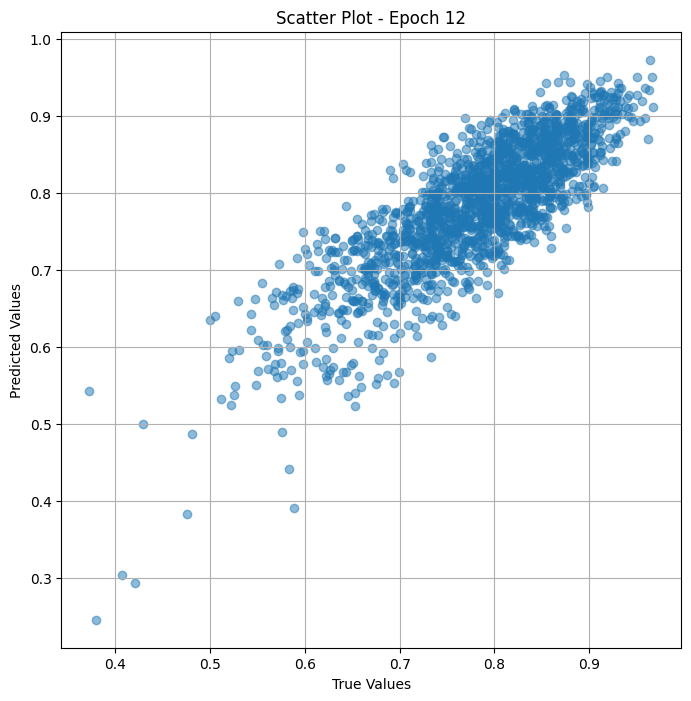

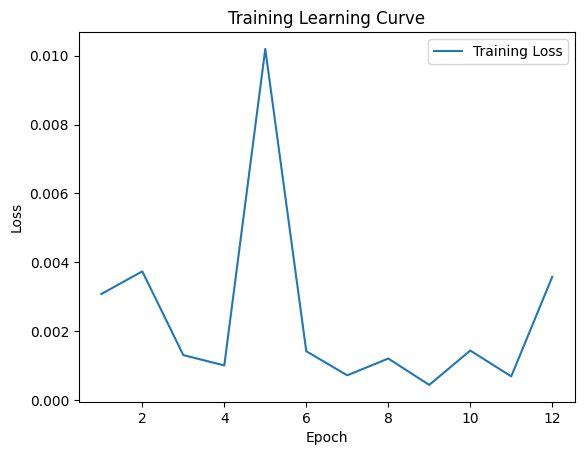


 Epoch: (13/30) Loss = 0.0002944780862890184

 Epoch: (13/30) Loss_rmse = 0.017160363495349884

 Epoch: (13/30) R^2 = 0.9533220529556274

 Epoch: (13/30) MAE = 0.01216866821050644
Spearman correlation coefficient: SignificanceResult(statistic=0.903935780975698, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.8

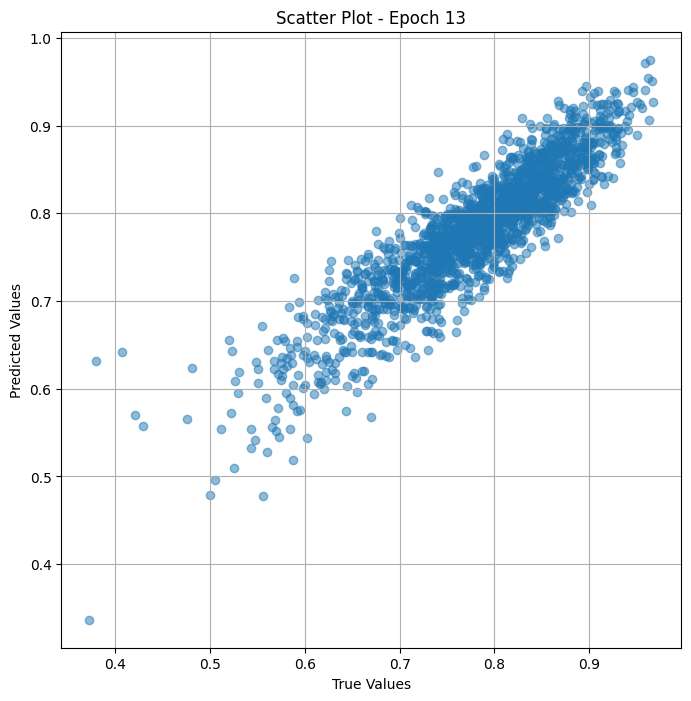

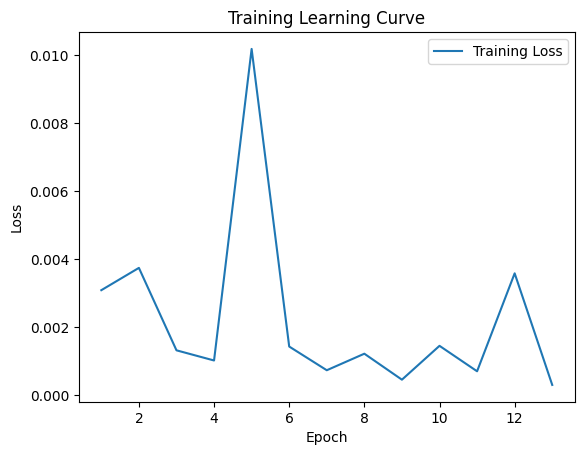


 Epoch: (14/30) Loss = 0.00022564342361874878

 Epoch: (14/30) Loss_rmse = 0.0150214321911335

 Epoch: (14/30) R^2 = 0.9642331004142761

 Epoch: (14/30) MAE = 0.011824473738670349
Spearman correlation coefficient: SignificanceResult(statistic=0.9359450371321661, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.

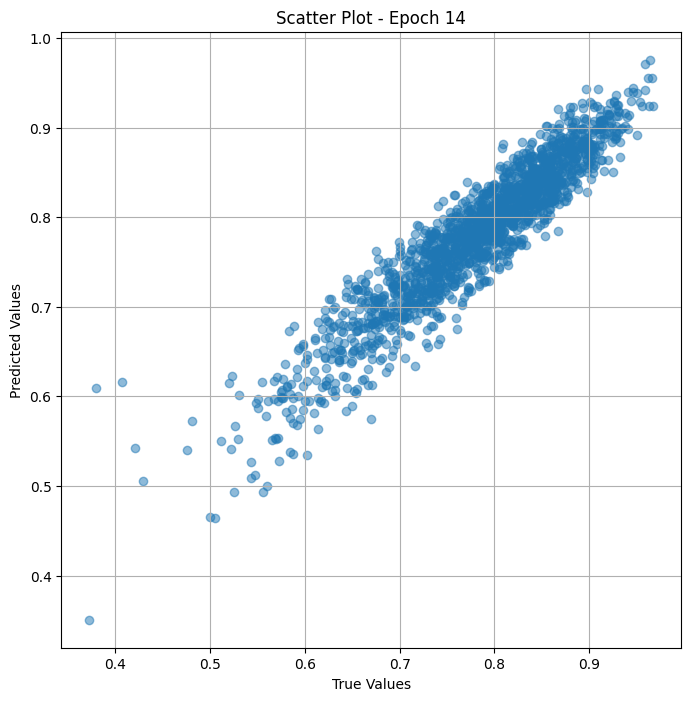

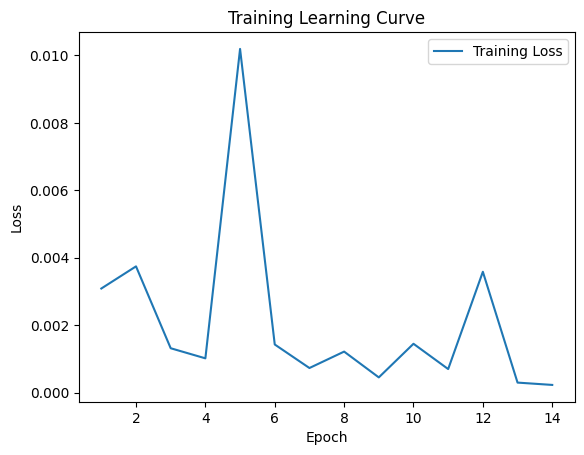


 Epoch: (15/30) Loss = 0.00016767263878136873

 Epoch: (15/30) Loss_rmse = 0.012948847375810146

 Epoch: (15/30) R^2 = 0.973422110080719

 Epoch: (15/30) MAE = 0.01056785136461258
Spearman correlation coefficient: SignificanceResult(statistic=0.9474289180924595, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.

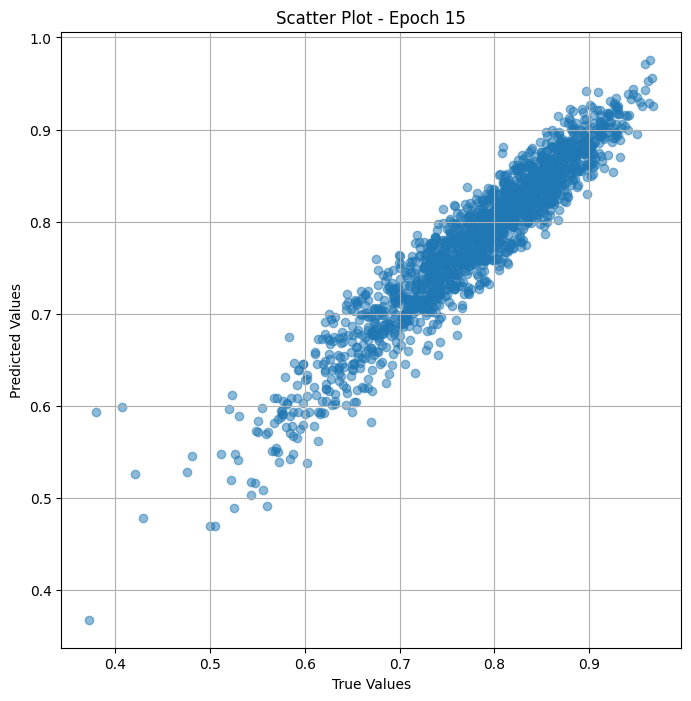

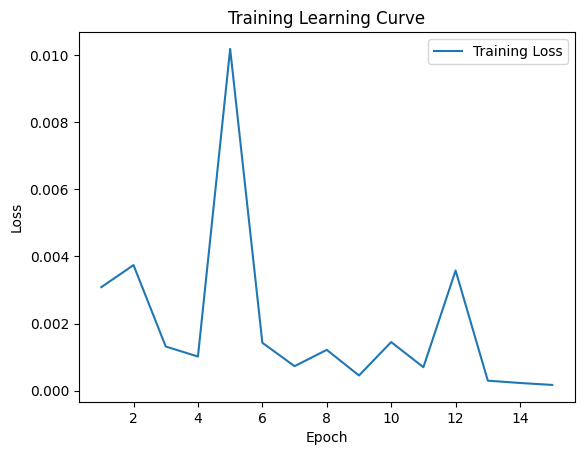


 Epoch: (16/30) Loss = 0.00012075067934347317

 Epoch: (16/30) Loss_rmse = 0.010988661088049412

 Epoch: (16/30) R^2 = 0.9808596968650818

 Epoch: (16/30) MAE = 0.008731134235858917
Spearman correlation coefficient: SignificanceResult(statistic=0.9549931346574897, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 

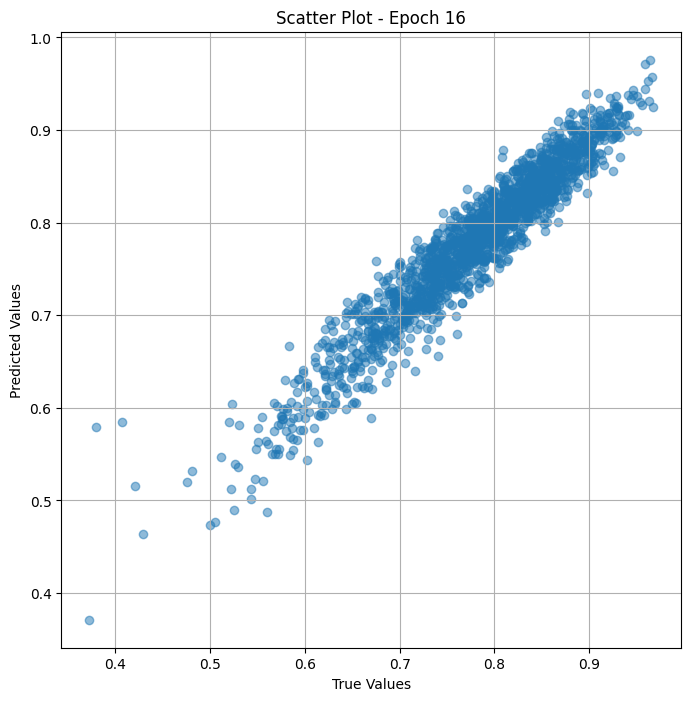

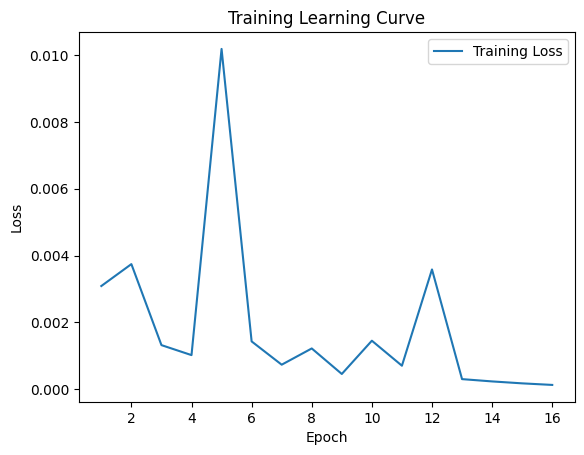


 Epoch: (17/30) Loss = 8.96167621249333e-05

 Epoch: (17/30) Loss_rmse = 0.009466612711548805

 Epoch: (17/30) R^2 = 0.9857947826385498

 Epoch: (17/30) MAE = 0.007161781191825867
Spearman correlation coefficient: SignificanceResult(statistic=0.9610655296110904, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.

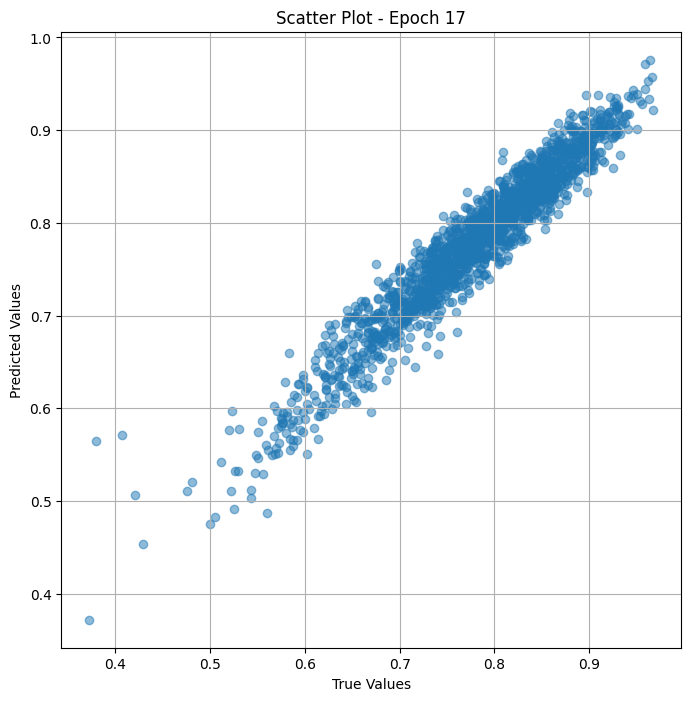

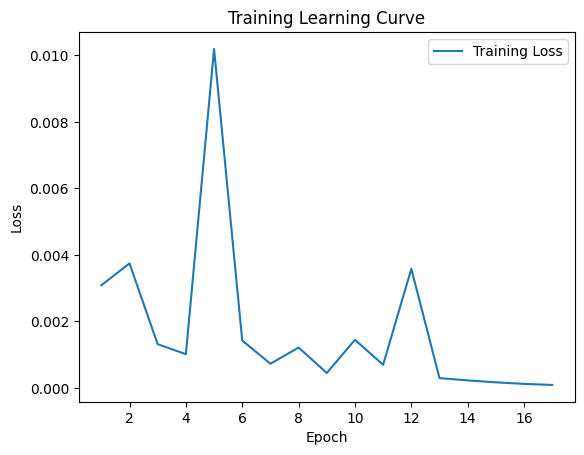


 Epoch: (18/30) Loss = 7.067158003337681e-05

 Epoch: (18/30) Loss_rmse = 0.008406639099121094

 Epoch: (18/30) R^2 = 0.9887977838516235

 Epoch: (18/30) MAE = 0.006231963634490967
Spearman correlation coefficient: SignificanceResult(statistic=0.9662006249747479, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0

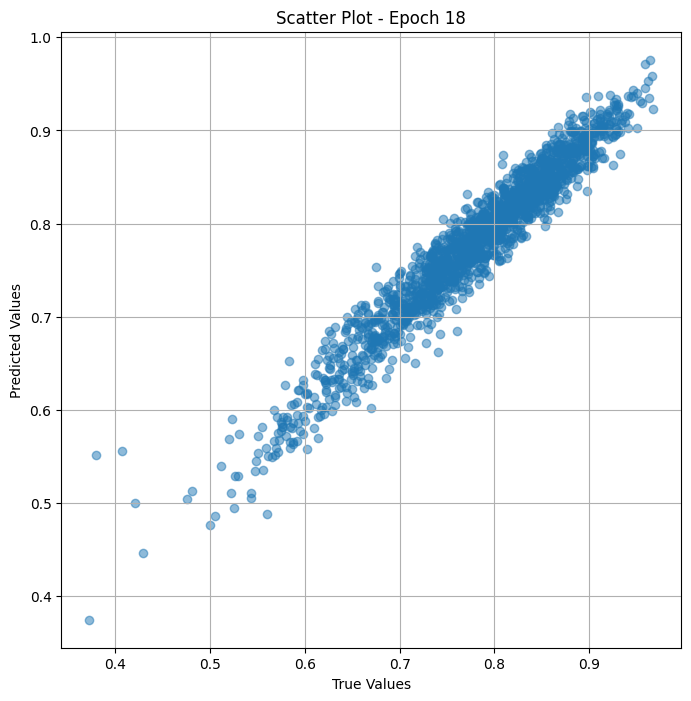

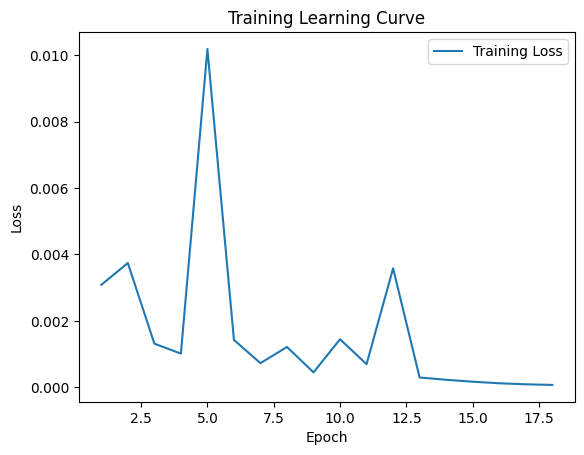


 Epoch: (19/30) Loss = 5.562271689996123e-05

 Epoch: (19/30) Loss_rmse = 0.0074580637738108635

 Epoch: (19/30) R^2 = 0.9911832213401794

 Epoch: (19/30) MAE = 0.0055583566427230835
Spearman correlation coefficient: SignificanceResult(statistic=0.9705012016540631, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769,

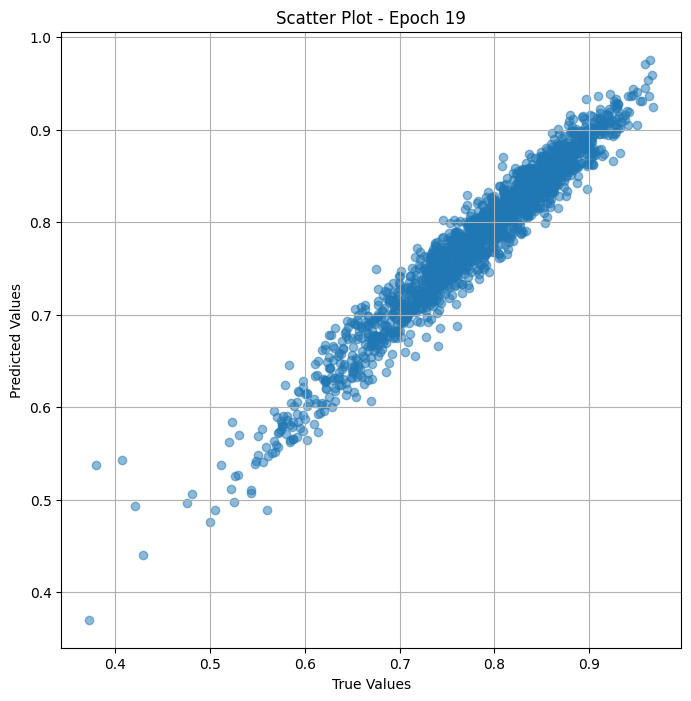

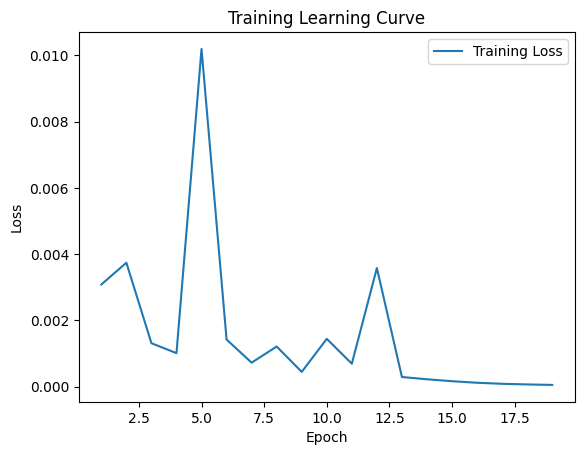


 Epoch: (20/30) Loss = 4.238003748469055e-05

 Epoch: (20/30) Loss_rmse = 0.006509995087981224

 Epoch: (20/30) R^2 = 0.9932823181152344

 Epoch: (20/30) MAE = 0.004870198667049408
Spearman correlation coefficient: SignificanceResult(statistic=0.9744157576810851, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0

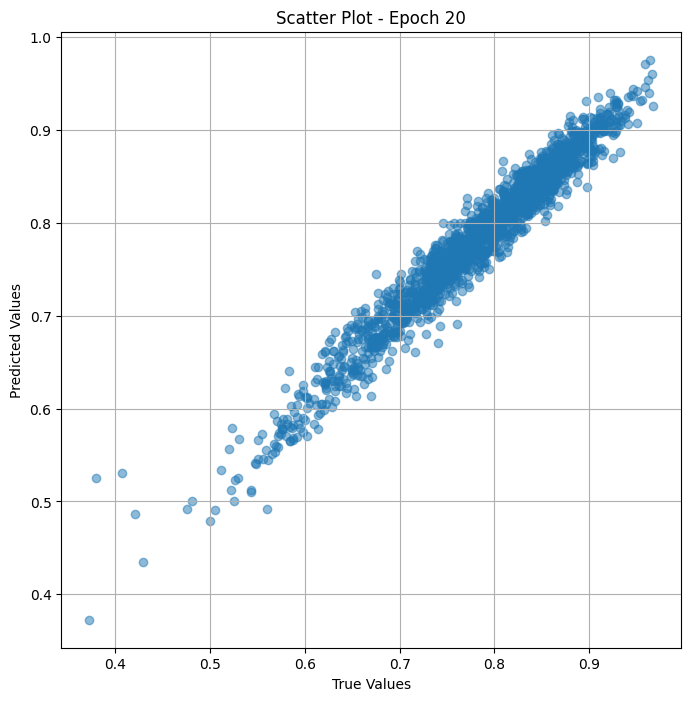

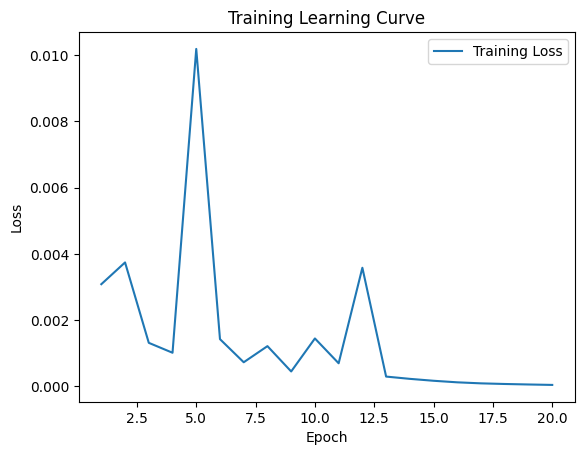


 Epoch: (21/30) Loss = 3.370091144461185e-05

 Epoch: (21/30) Loss_rmse = 0.005805248394608498

 Epoch: (21/30) R^2 = 0.9946580529212952

 Epoch: (21/30) MAE = 0.004200510680675507
Spearman correlation coefficient: SignificanceResult(statistic=0.9778113773216799, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0

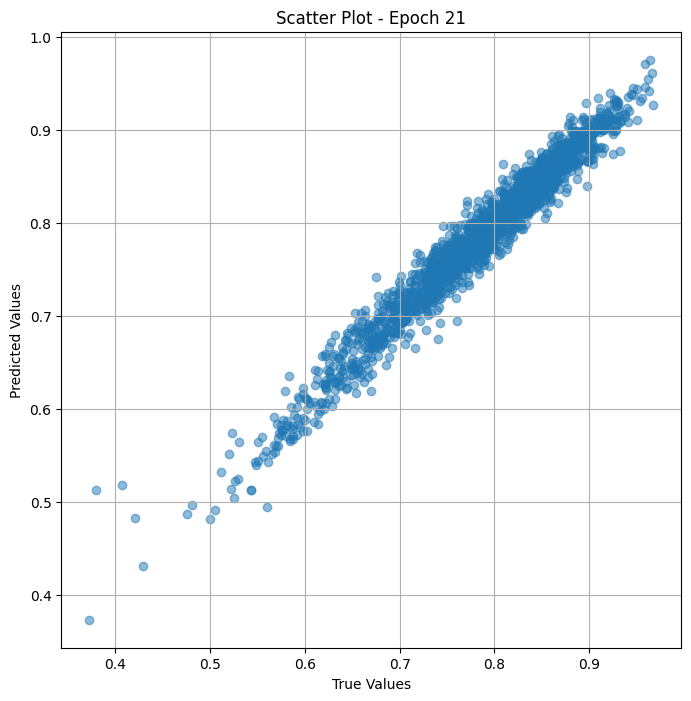

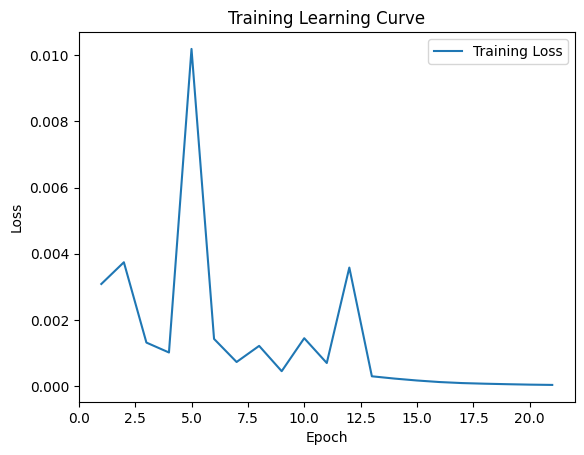


 Epoch: (22/30) Loss = 2.8590460715349764e-05

 Epoch: (22/30) Loss_rmse = 0.005347004625946283

 Epoch: (22/30) R^2 = 0.9954680800437927

 Epoch: (22/30) MAE = 0.0041585639119148254
Spearman correlation coefficient: SignificanceResult(statistic=0.980706352907958, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 

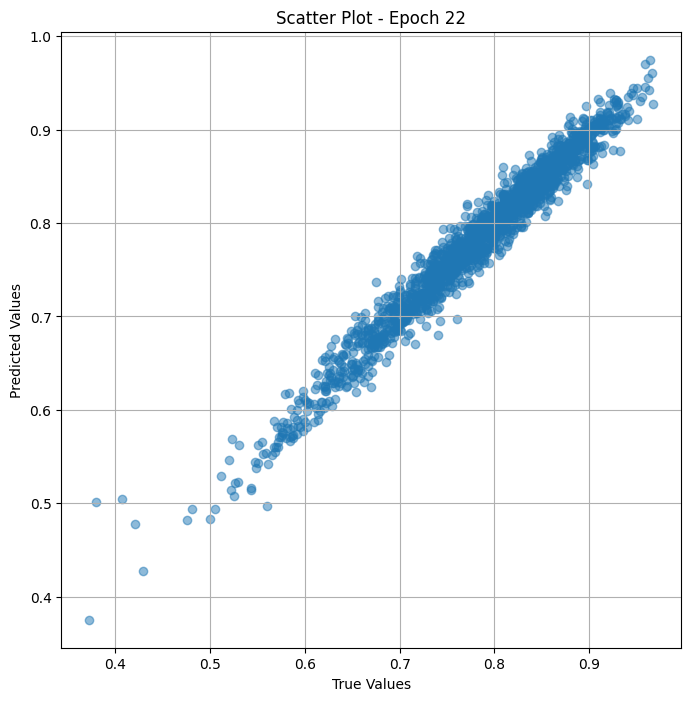

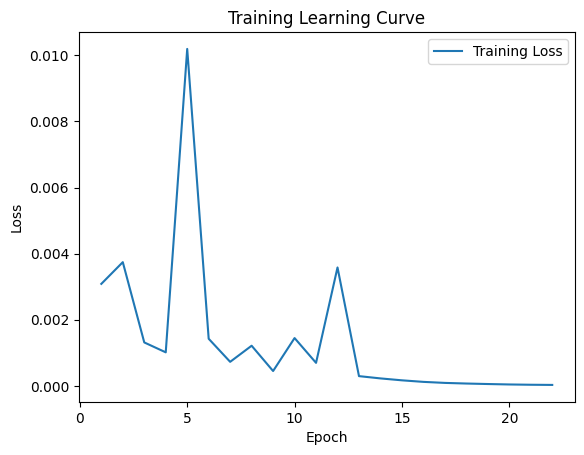


 Epoch: (23/30) Loss = 1.9892795535270125e-05

 Epoch: (23/30) Loss_rmse = 0.004460134077817202

 Epoch: (23/30) R^2 = 0.9968467950820923

 Epoch: (23/30) MAE = 0.0034306496381759644
Spearman correlation coefficient: SignificanceResult(statistic=0.9834863261888412, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769,

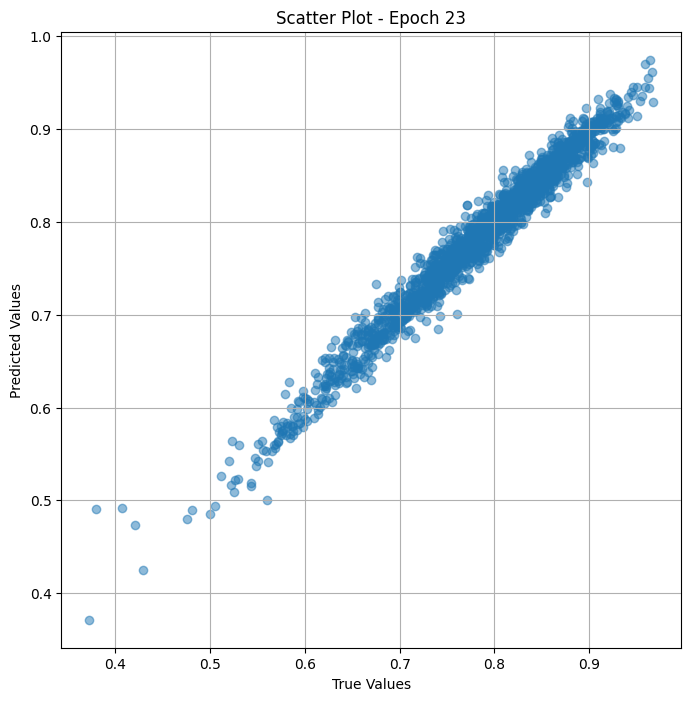

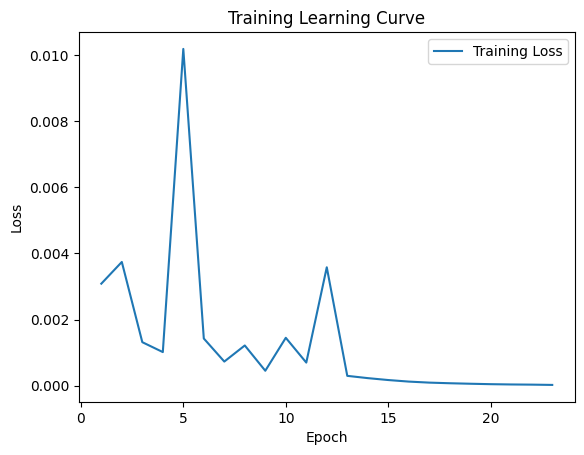


 Epoch: (24/30) Loss = 1.4033424122317228e-05

 Epoch: (24/30) Loss_rmse = 0.0037461211904883385

 Epoch: (24/30) R^2 = 0.9977755546569824

 Epoch: (24/30) MAE = 0.002871982753276825
Spearman correlation coefficient: SignificanceResult(statistic=0.9859874648225396, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769,

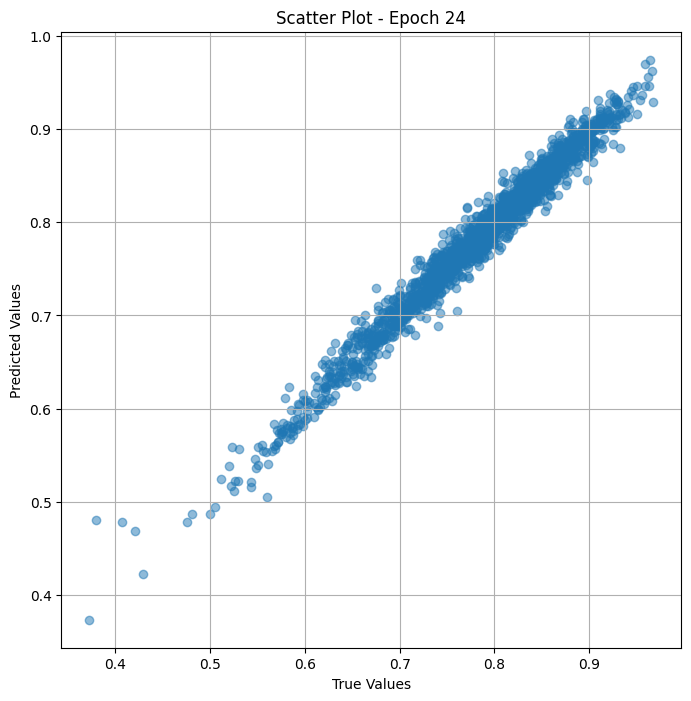

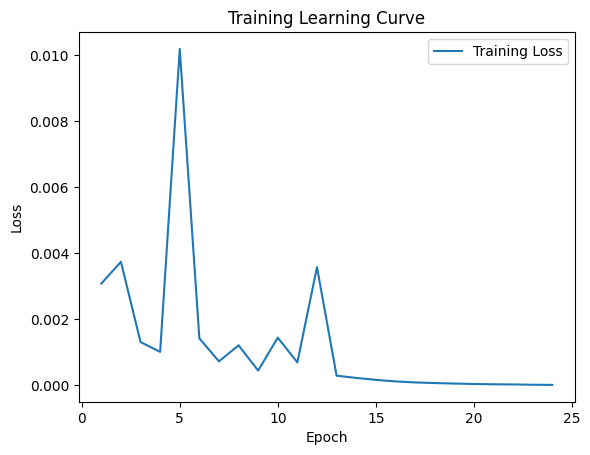


 Epoch: (25/30) Loss = 9.1109104687348e-06

 Epoch: (25/30) Loss_rmse = 0.003018428571522236

 Epoch: (25/30) R^2 = 0.9985558390617371

 Epoch: (25/30) MAE = 0.0023327693343162537
Spearman correlation coefficient: SignificanceResult(statistic=0.9880477549197425, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 0.

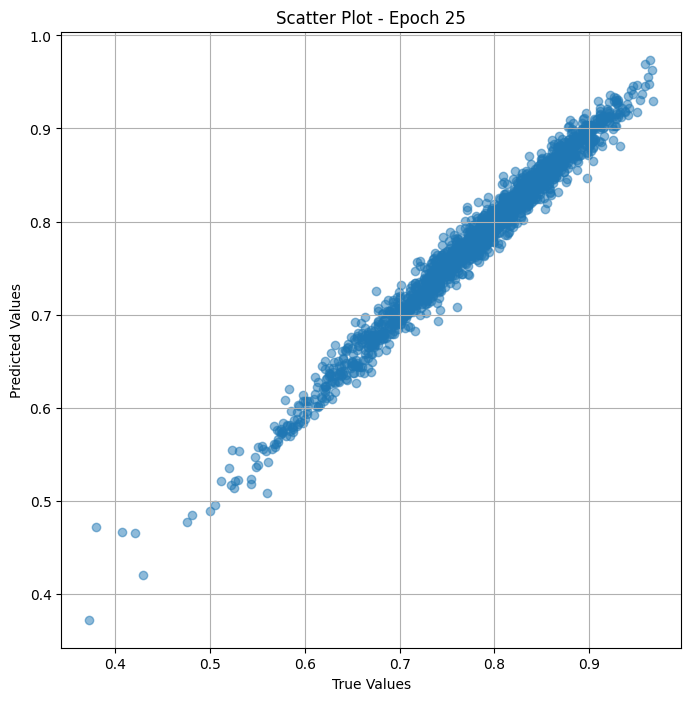

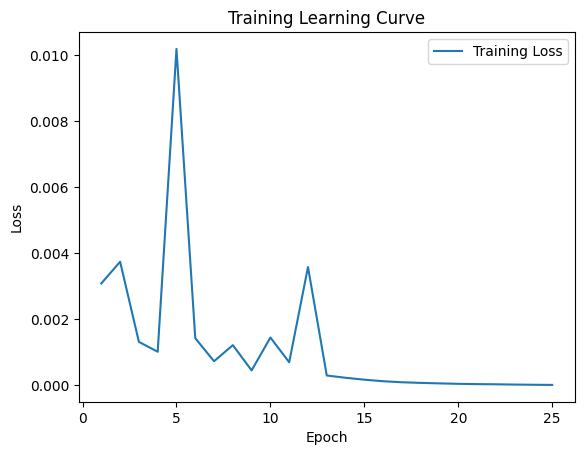


 Epoch: (26/30) Loss = 7.455910690623568e-06

 Epoch: (26/30) Loss_rmse = 0.0027305514086037874

 Epoch: (26/30) R^2 = 0.9988181591033936

 Epoch: (26/30) MAE = 0.0021617934107780457
Spearman correlation coefficient: SignificanceResult(statistic=0.9898295998147736, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769,

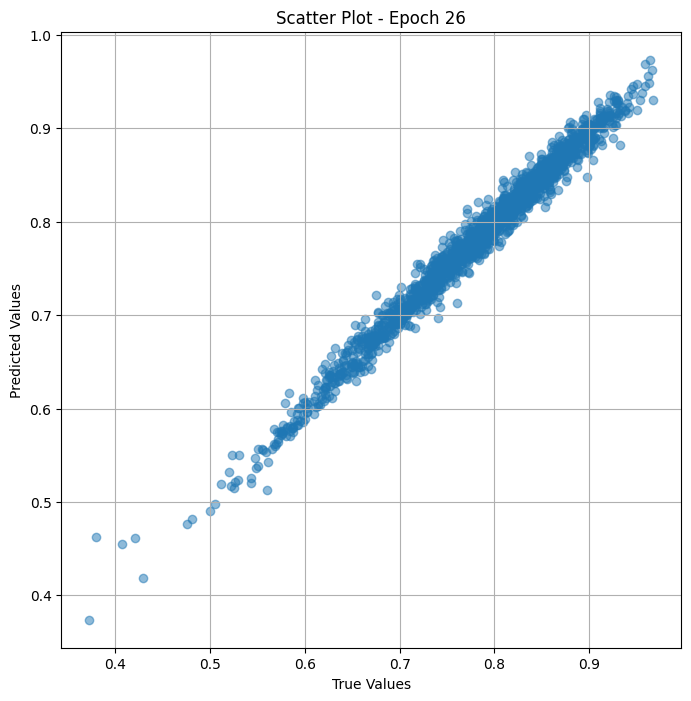

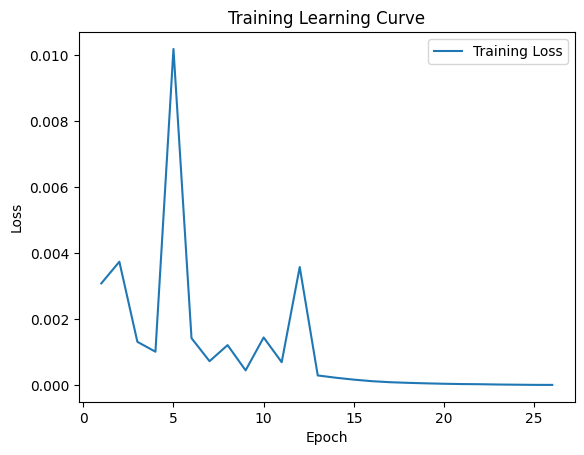


 Epoch: (27/30) Loss = 3.828923581750132e-06

 Epoch: (27/30) Loss_rmse = 0.001956763444468379

 Epoch: (27/30) R^2 = 0.9993930459022522

 Epoch: (27/30) MAE = 0.0015815570950508118
Spearman correlation coefficient: SignificanceResult(statistic=0.9913282622336234, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 

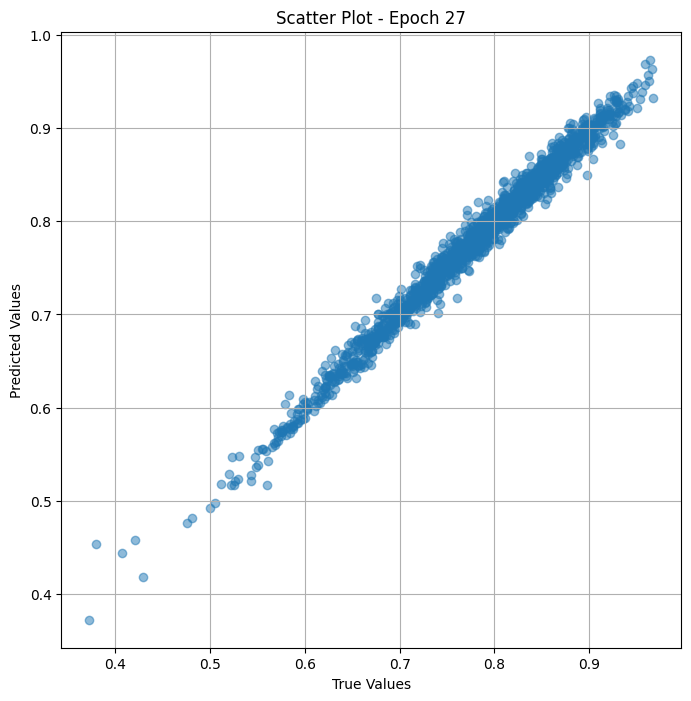

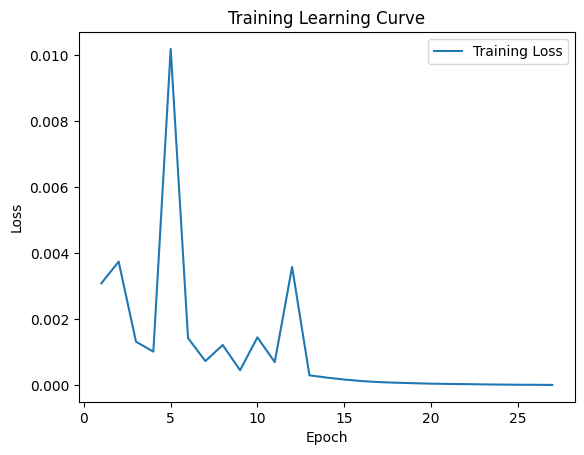


 Epoch: (28/30) Loss = 2.136718421752448e-06

 Epoch: (28/30) Loss_rmse = 0.0014617518754675984

 Epoch: (28/30) R^2 = 0.9996613264083862

 Epoch: (28/30) MAE = 0.001039661467075348
Spearman correlation coefficient: SignificanceResult(statistic=0.9925854174608426, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769, 

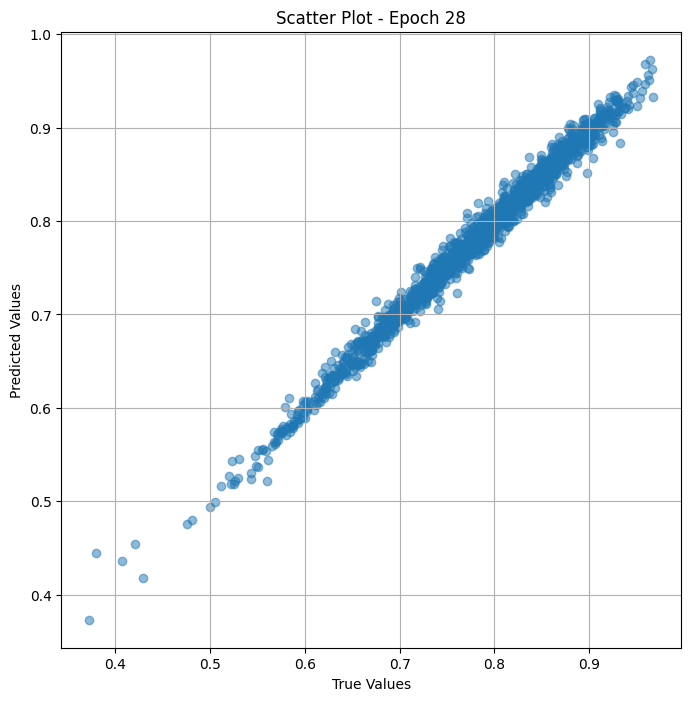

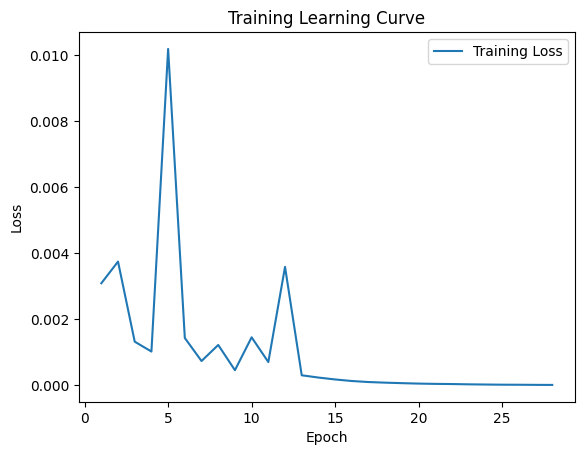


 Epoch: (29/30) Loss = 1.4767309721719357e-06

 Epoch: (29/30) Loss_rmse = 0.0012152082053944468

 Epoch: (29/30) R^2 = 0.999765932559967

 Epoch: (29/30) MAE = 0.0008837282657623291
Spearman correlation coefficient: SignificanceResult(statistic=0.9937865442612234, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769,

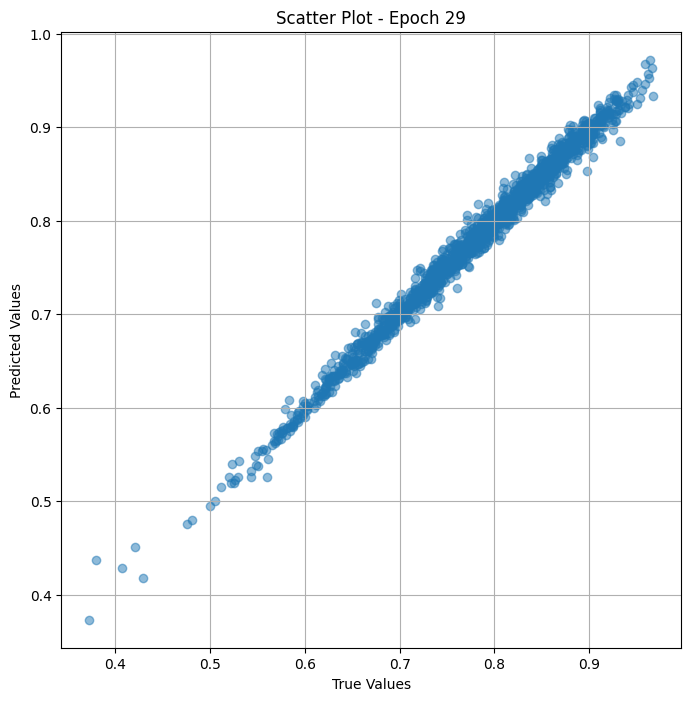

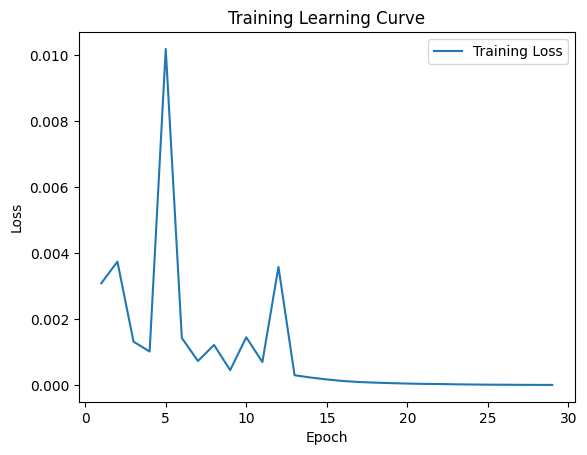


 Epoch: (30/30) Loss = 1.1007190323653049e-06

 Epoch: (30/30) Loss_rmse = 0.0010491515276953578

 Epoch: (30/30) R^2 = 0.9998255372047424

 Epoch: (30/30) MAE = 0.0006555244326591492
Spearman correlation coefficient: SignificanceResult(statistic=0.9947635083677385, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9, 0.8518519, 0.7368421, 0.74285716, 0.65591395, 0.78571427, 0.78651685, 0.65625, 0.89772725, 0.74, 0.8918919, 0.7977528, 0.78504676, 0.7386364, 0.6888889, 0.85714287, 0.7234042, 0.8962264, 0.7647059, 0.72321427, 0.9207921, 0.71568626, 0.84042555, 0.87058824, 0.7113402, 0.7263158, 0.8888889, 0.75, 0.8, 0.8111111, 0.84313726, 0.75789475, 0.7804878, 0.7653061, 0.8773585, 0.75961536, 0.75757575, 0.675, 0.8433735, 0.86915886, 0.7878788, 0.63829786, 0.814433, 0.76106197, 0.7326733, 0.82828283, 0.9191919, 0.85294116, 0.86868685, 0.7755102, 0.84375, 0.76237625, 0.8468468, 0.7920792, 0.6846847, 0.80582523, 0.70408165, 0.5480769

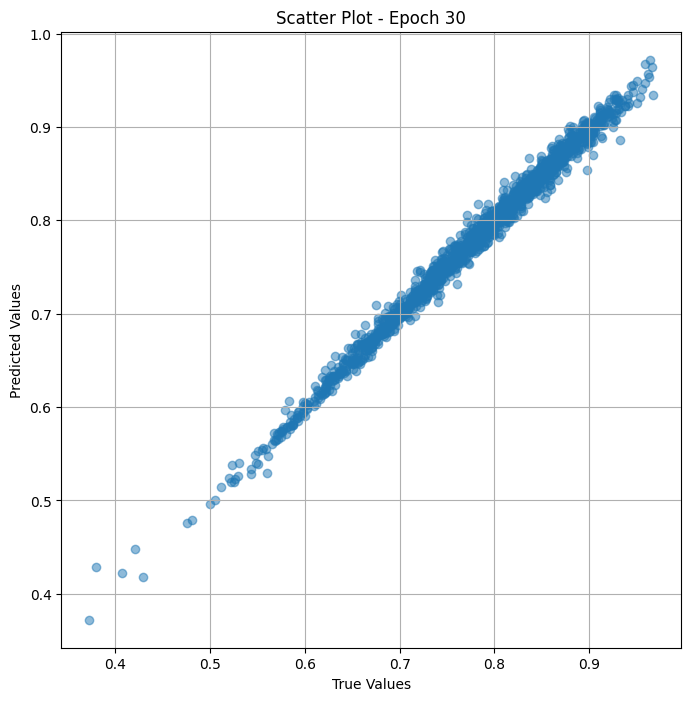

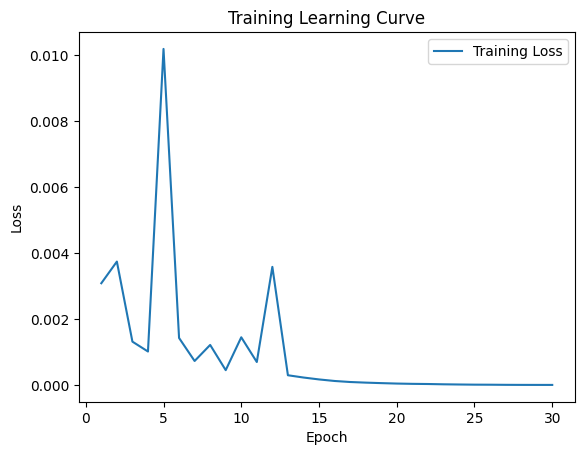

In [ ]:
# Training the model and save weights
fit(30,model_vit_fine , train_dl)
torch.save(model_vit_fine.state_dict(), "model_weights_fine")

## valid

In [ ]:
params = [param for param in list(model_vit_sval.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-4,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Val Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_sval, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_sval.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_sval(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/30) Loss = 0.04614962264895439

 Epoch: (1/30) Loss_rmse = 0.2148246318101883

 Epoch: (1/30) R^2 = -4.208188533782959

 Epoch: (1/30) MAE = 0.19374297559261322
Spearman correlation coefficient: SignificanceResult(statistic=-0.15176600256526832, pvalue=0.13992162474826803)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.77777

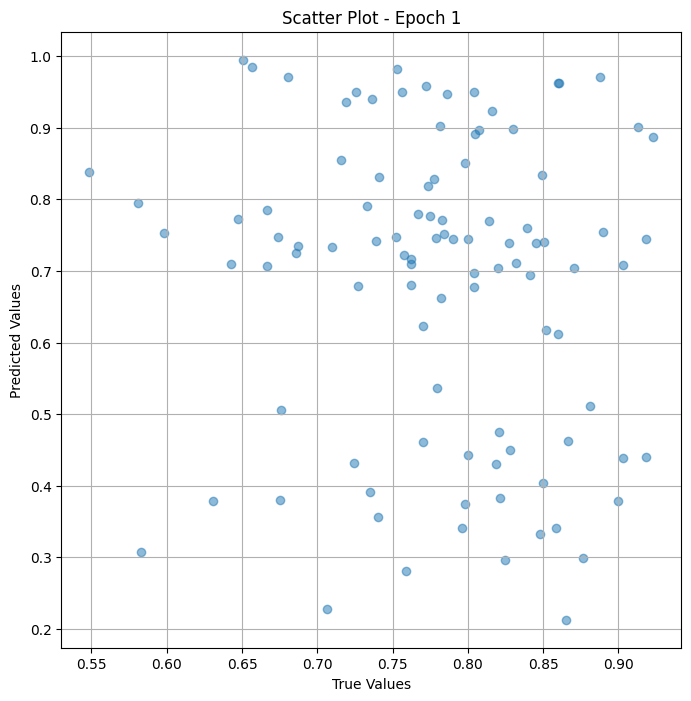

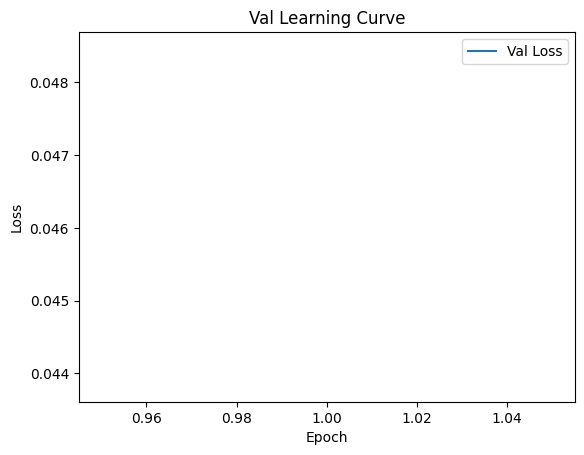


 Epoch: (2/30) Loss = 0.01005302183330059

 Epoch: (2/30) Loss_rmse = 0.10026475787162781

 Epoch: (2/30) R^2 = -0.13452792167663574

 Epoch: (2/30) MAE = 0.09018109738826752
Spearman correlation coefficient: SignificanceResult(statistic=0.06095464180613453, pvalue=0.5552197304711874)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.7777

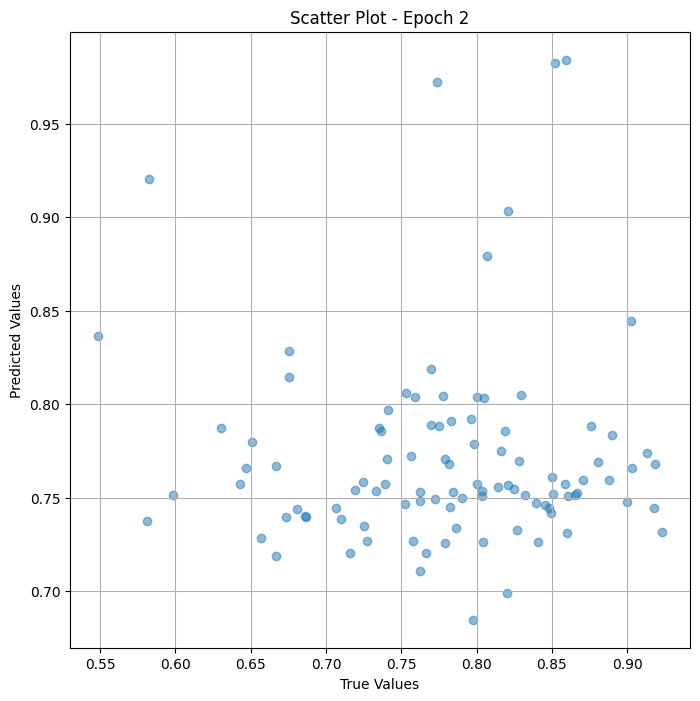

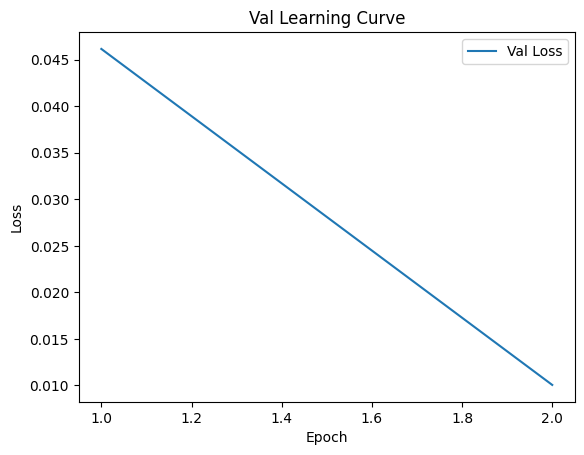


 Epoch: (3/30) Loss = 0.00696834921836853

 Epoch: (3/30) Loss_rmse = 0.08347664028406143

 Epoch: (3/30) R^2 = 0.21359103918075562

 Epoch: (3/30) MAE = 0.07265178859233856
Spearman correlation coefficient: SignificanceResult(statistic=0.12443916915735512, pvalue=0.22705495242769488)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.7777

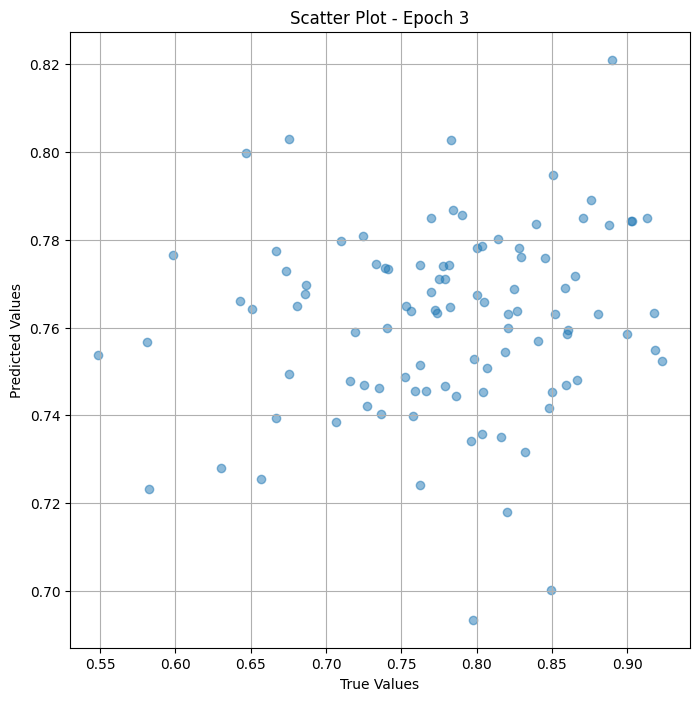

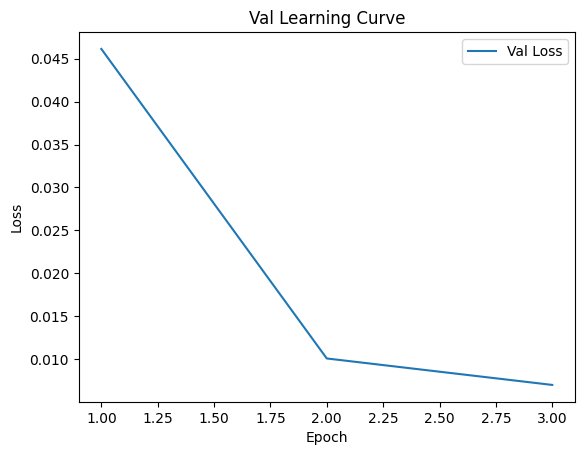


 Epoch: (4/30) Loss = 0.003858281997963786

 Epoch: (4/30) Loss_rmse = 0.06211506947875023

 Epoch: (4/30) R^2 = 0.5645758509635925

 Epoch: (4/30) MAE = 0.0523858368396759
Spearman correlation coefficient: SignificanceResult(statistic=0.2610801187318946, pvalue=0.010191354682914577)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.77777

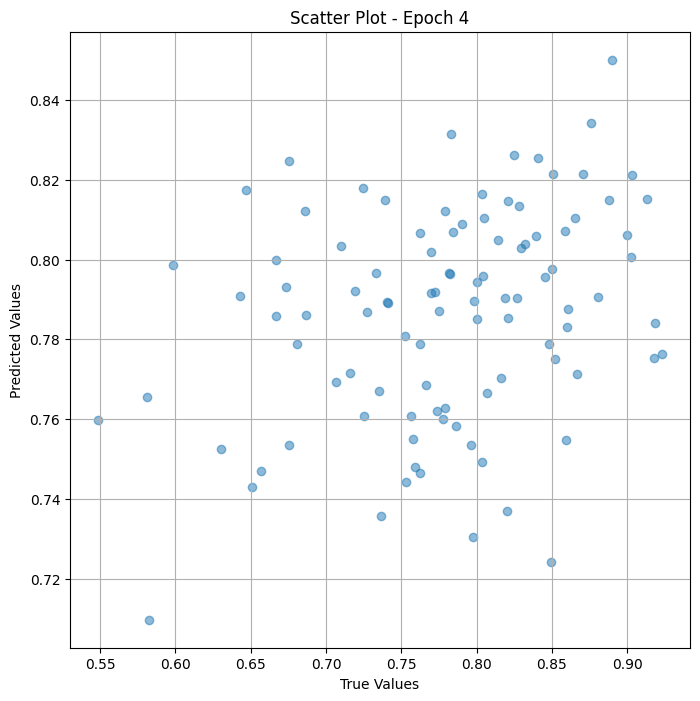

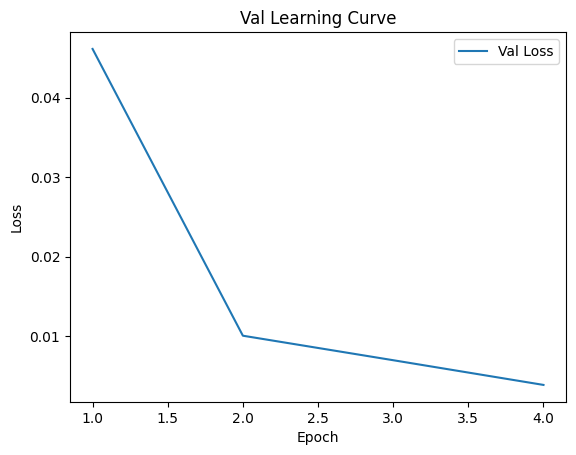


 Epoch: (5/30) Loss = 0.002868272364139557

 Epoch: (5/30) Loss_rmse = 0.053556255996227264

 Epoch: (5/30) R^2 = 0.6763027906417847

 Epoch: (5/30) MAE = 0.04364258050918579
Spearman correlation coefficient: SignificanceResult(statistic=0.40671470968119033, pvalue=3.922460399066812e-05)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.7

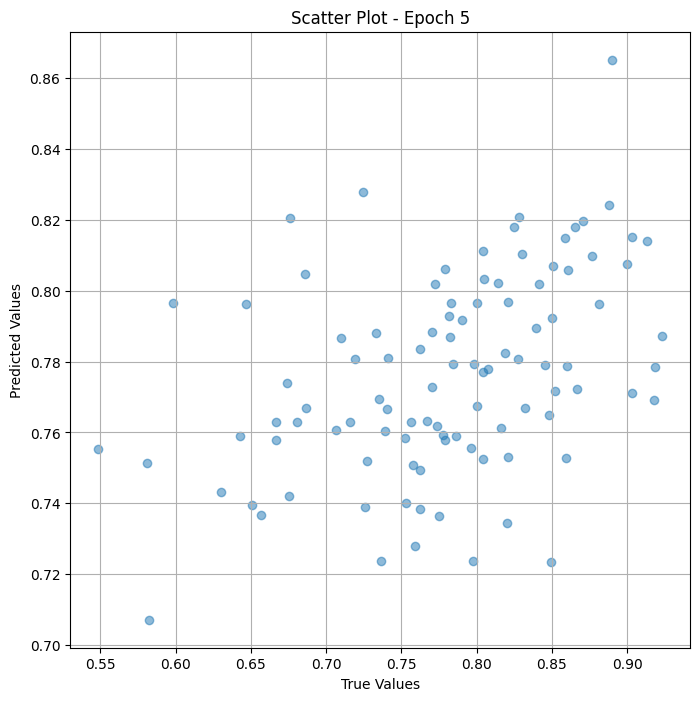

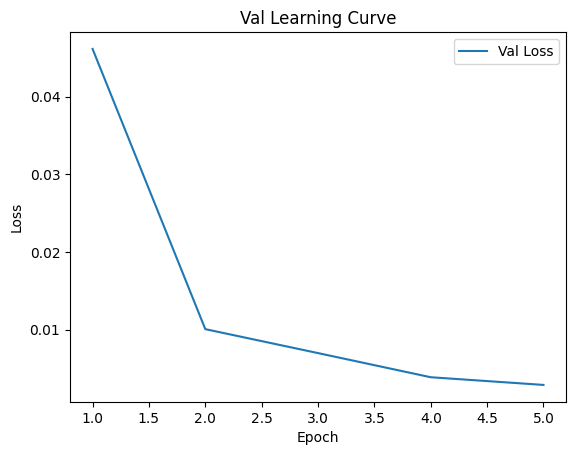


 Epoch: (6/30) Loss = 0.0019085945095866919

 Epoch: (6/30) Loss_rmse = 0.04368746280670166

 Epoch: (6/30) R^2 = 0.7846066951751709

 Epoch: (6/30) MAE = 0.03587785363197327
Spearman correlation coefficient: SignificanceResult(statistic=0.5345112336503888, pvalue=2.0319953450833952e-08)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.7

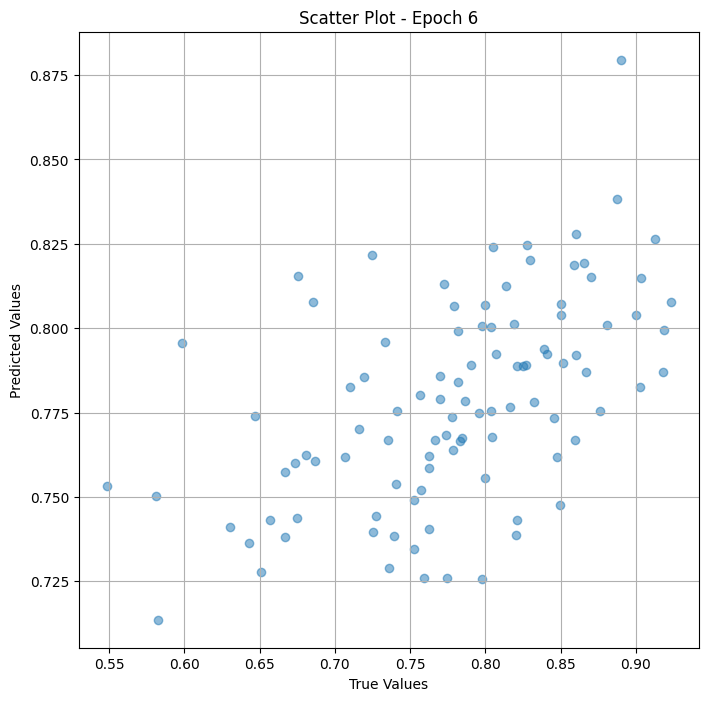

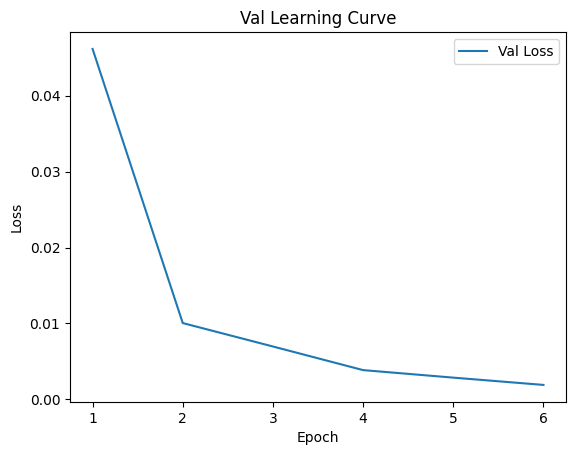


 Epoch: (7/30) Loss = 0.001335546956397593

 Epoch: (7/30) Loss_rmse = 0.03654513508081436

 Epoch: (7/30) R^2 = 0.8492776155471802

 Epoch: (7/30) MAE = 0.0255233496427536
Spearman correlation coefficient: SignificanceResult(statistic=0.6273030946217615, pvalue=7.99401051591672e-12)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.77777

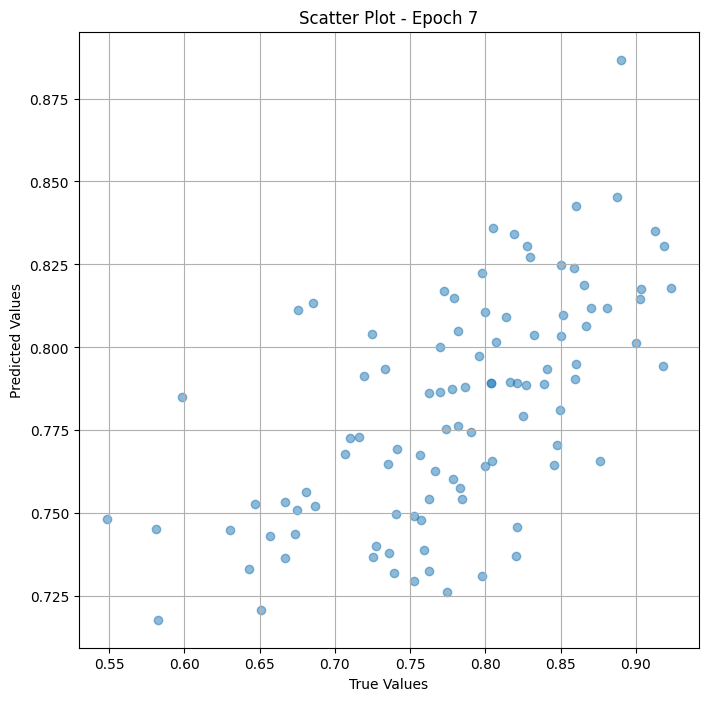

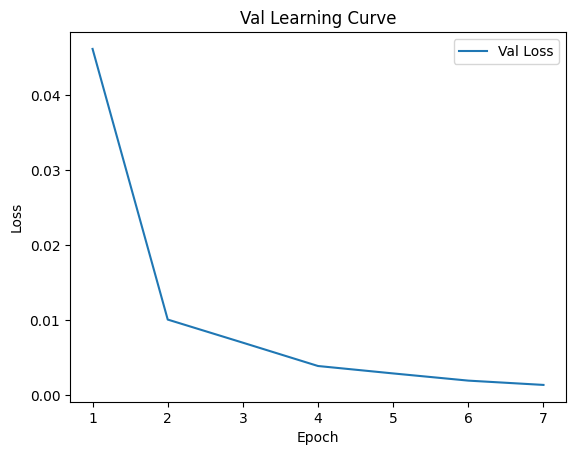


 Epoch: (8/30) Loss = 0.0010805607307702303

 Epoch: (8/30) Loss_rmse = 0.03287188336253166

 Epoch: (8/30) R^2 = 0.8780539631843567

 Epoch: (8/30) MAE = 0.019312813878059387
Spearman correlation coefficient: SignificanceResult(statistic=0.6867316660588763, pvalue=1.1265214992691452e-14)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.

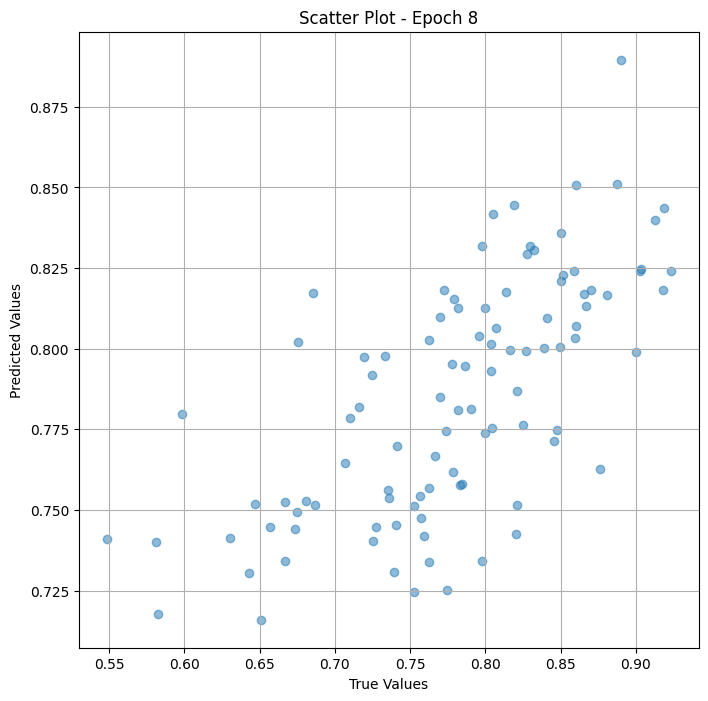

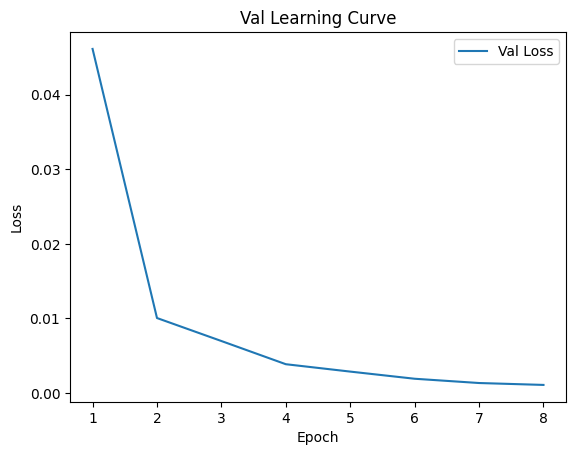


 Epoch: (9/30) Loss = 0.0009078881703317165

 Epoch: (9/30) Loss_rmse = 0.030131183564662933

 Epoch: (9/30) R^2 = 0.897540807723999

 Epoch: (9/30) MAE = 0.020086020231246948
Spearman correlation coefficient: SignificanceResult(statistic=0.7473132684414727, pvalue=2.238783446557602e-18)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 0.7

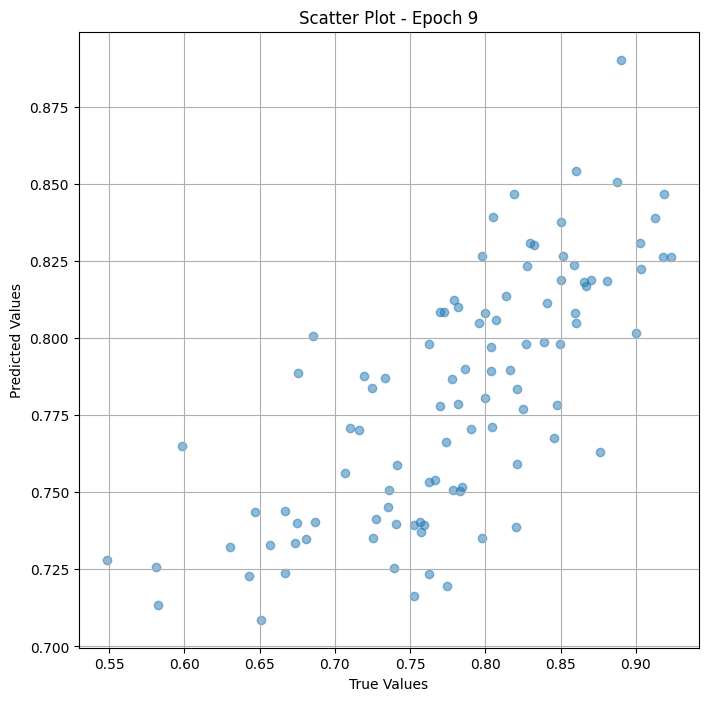

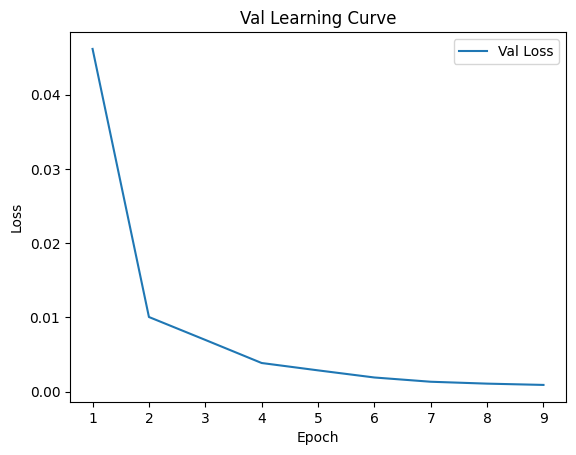


 Epoch: (10/30) Loss = 0.0007076882757246494

 Epoch: (10/30) Loss_rmse = 0.02660241164267063

 Epoch: (10/30) R^2 = 0.9201342463493347

 Epoch: (10/30) MAE = 0.017267271876335144
Spearman correlation coefficient: SignificanceResult(statistic=0.8054735058385578, pvalue=4.44158587421078e-23)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 

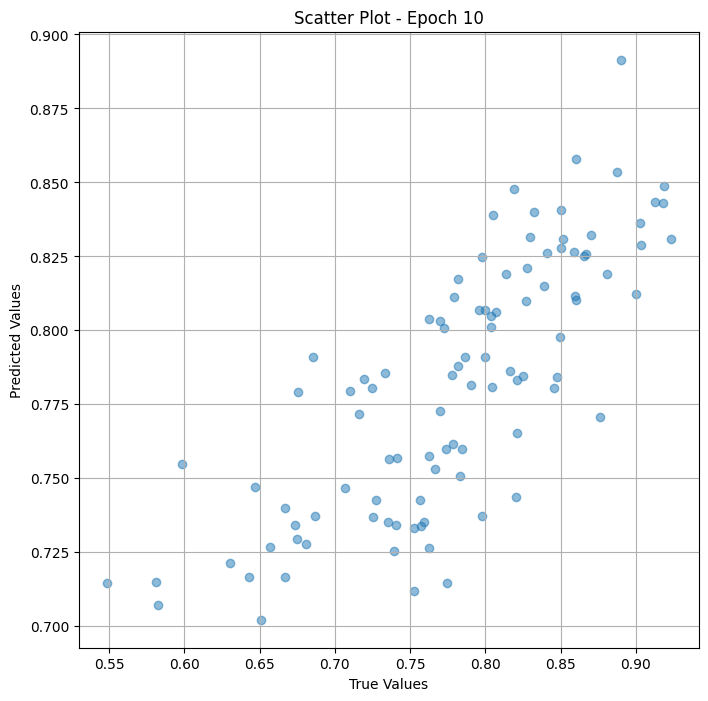

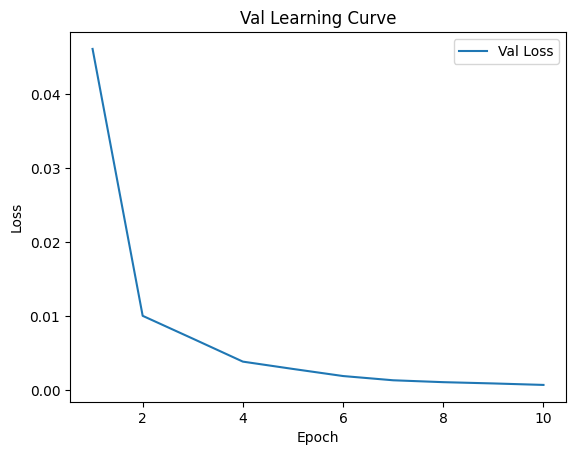


 Epoch: (11/30) Loss = 0.0005034477799199522

 Epoch: (11/30) Loss_rmse = 0.02243764139711857

 Epoch: (11/30) R^2 = 0.9431837201118469

 Epoch: (11/30) MAE = 0.013912498950958252
Spearman correlation coefficient: SignificanceResult(statistic=0.8510996186047608, pvalue=4.762543378528166e-28)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097,

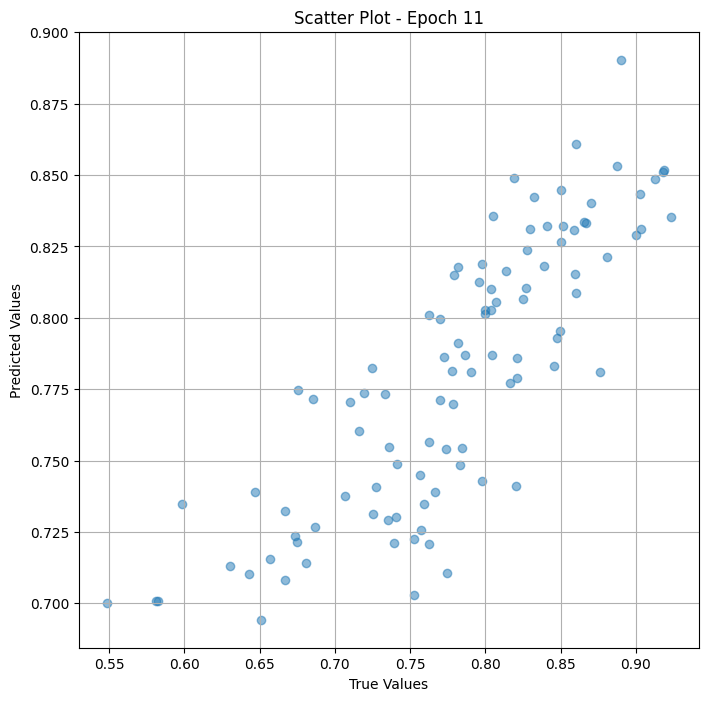

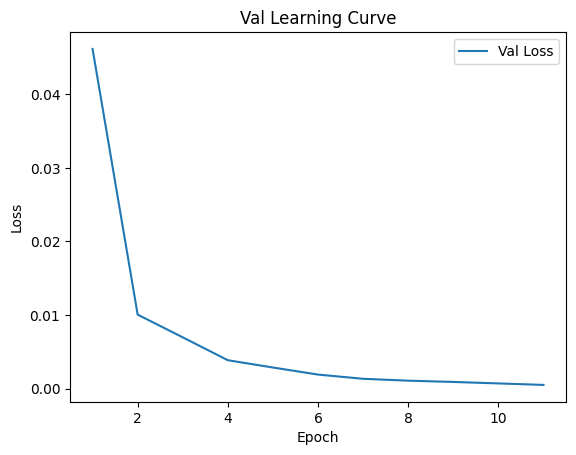


 Epoch: (12/30) Loss = 0.0003441583248786628

 Epoch: (12/30) Loss_rmse = 0.018551504239439964

 Epoch: (12/30) R^2 = 0.9611601829528809

 Epoch: (12/30) MAE = 0.010768786072731018
Spearman correlation coefficient: SignificanceResult(statistic=0.8791250531149364, pvalue=5.182910544779334e-32)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097

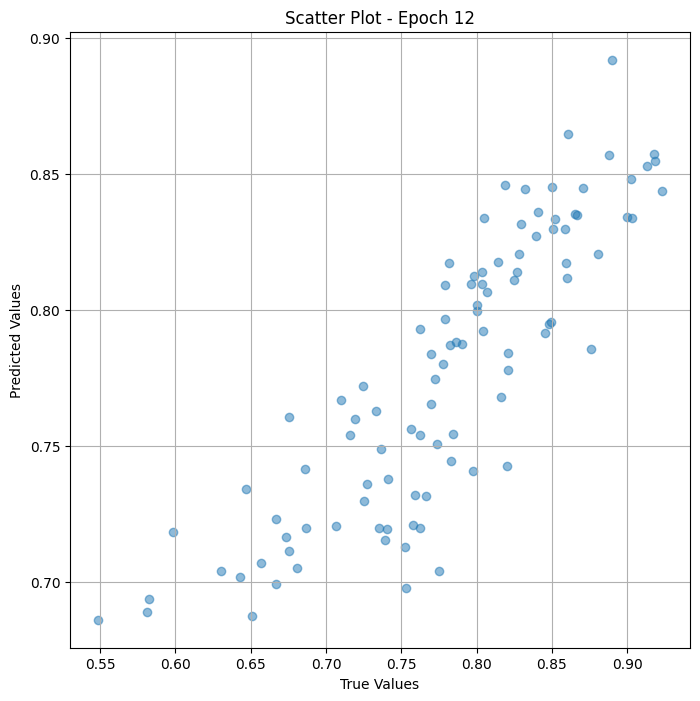

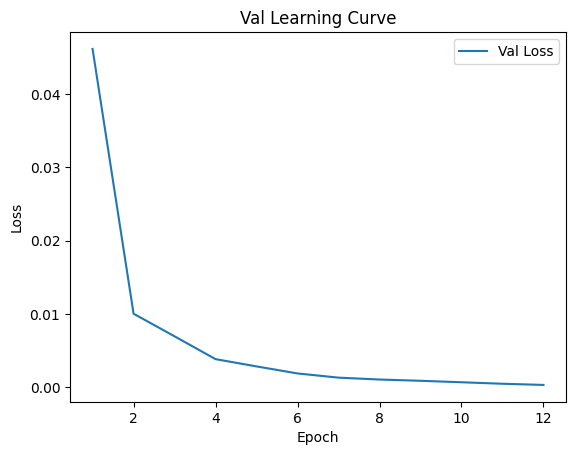


 Epoch: (13/30) Loss = 0.00026887867716141045

 Epoch: (13/30) Loss_rmse = 0.016397520899772644

 Epoch: (13/30) R^2 = 0.9696558713912964

 Epoch: (13/30) MAE = 0.01280122995376587
Spearman correlation coefficient: SignificanceResult(statistic=0.9004018653265581, pvalue=9.6001369995593e-36)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 

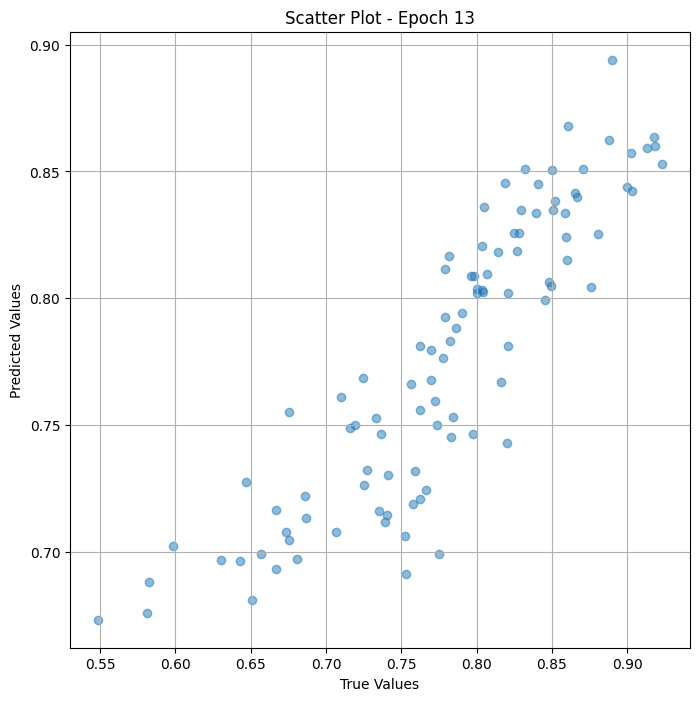

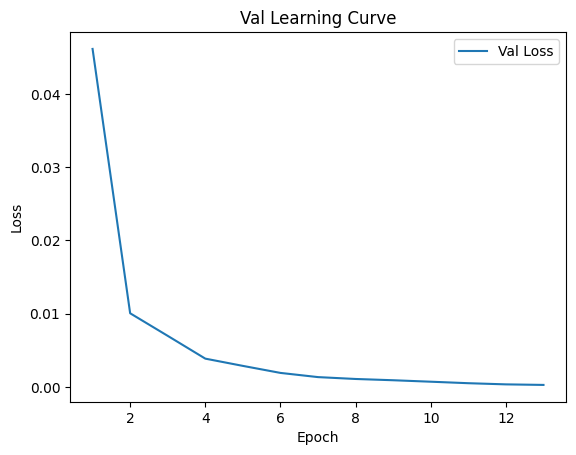


 Epoch: (14/30) Loss = 0.00020214510732330382

 Epoch: (14/30) Loss_rmse = 0.014217774383723736

 Epoch: (14/30) R^2 = 0.9771870374679565

 Epoch: (14/30) MAE = 0.01258482038974762
Spearman correlation coefficient: SignificanceResult(statistic=0.9232793557919072, pvalue=7.7441729807859e-41)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 

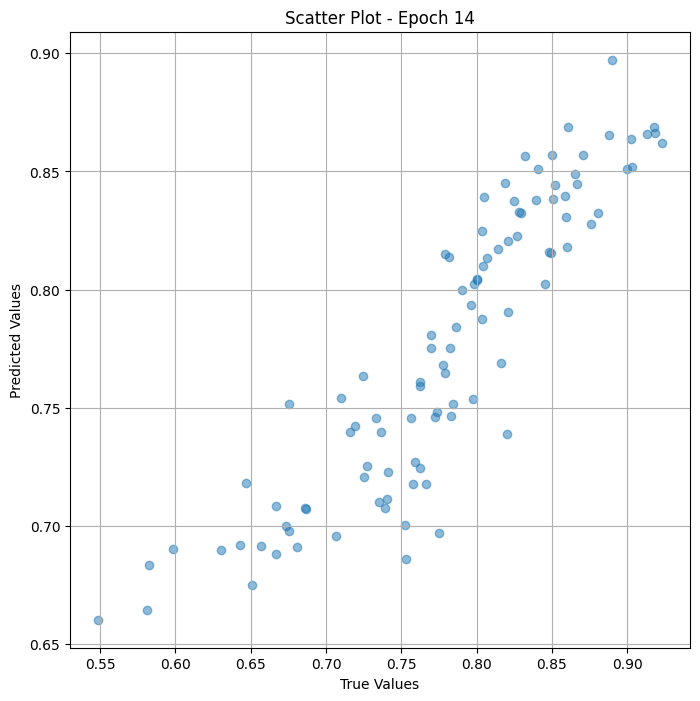

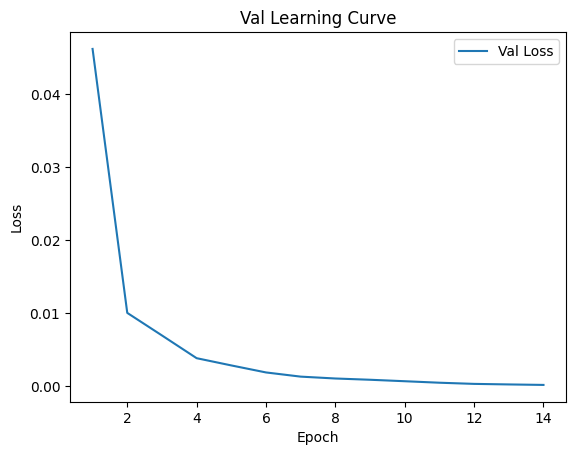


 Epoch: (15/30) Loss = 0.0001390702382195741

 Epoch: (15/30) Loss_rmse = 0.01179280411452055

 Epoch: (15/30) R^2 = 0.9843053221702576

 Epoch: (15/30) MAE = 0.010228782892227173
Spearman correlation coefficient: SignificanceResult(statistic=0.9308147521473779, pvalue=7.1631858884375854e-43)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097

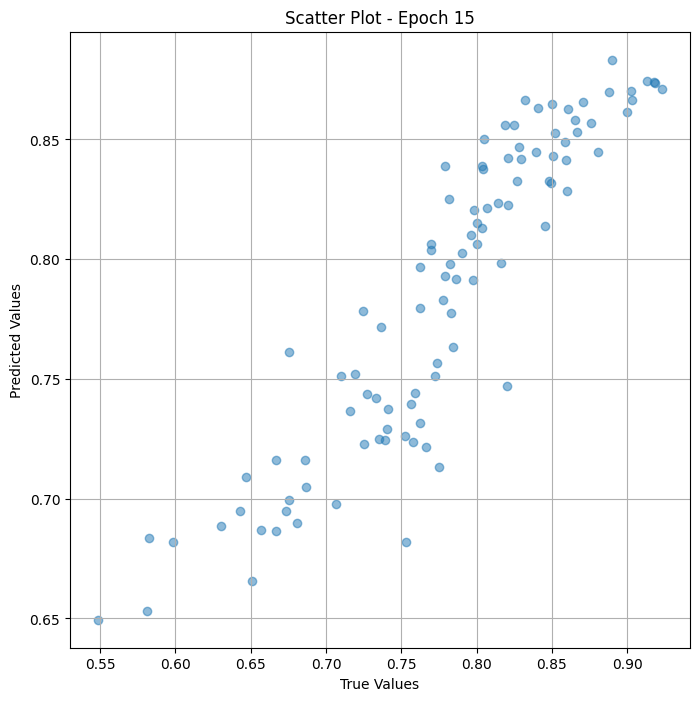

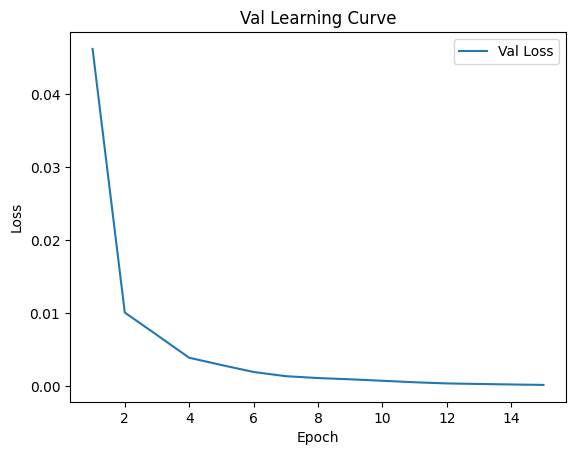


 Epoch: (16/30) Loss = 0.0003411785000935197

 Epoch: (16/30) Loss_rmse = 0.018471017479896545

 Epoch: (16/30) R^2 = 0.9614964723587036

 Epoch: (16/30) MAE = 0.01682606339454651
Spearman correlation coefficient: SignificanceResult(statistic=0.9401814329456724, pvalue=9.55652211884291e-46)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097, 

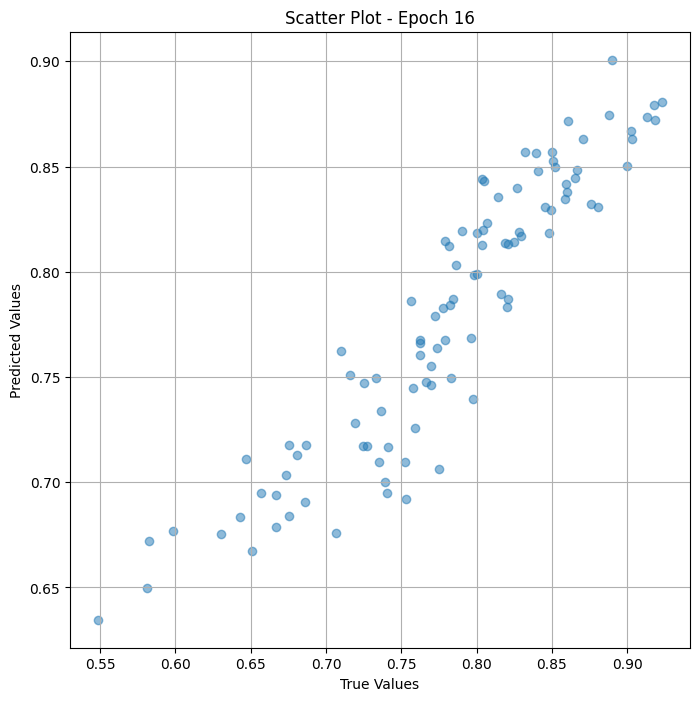

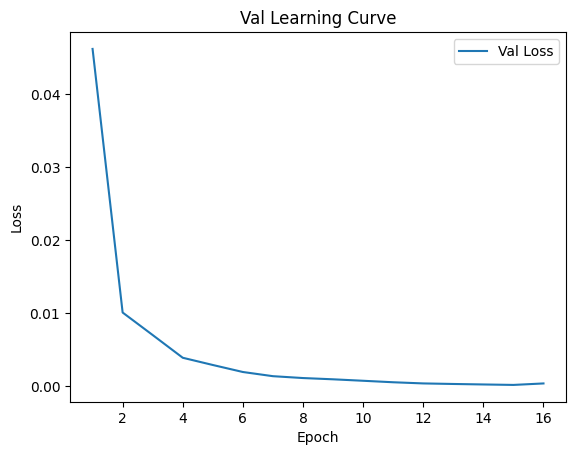


 Epoch: (17/30) Loss = 6.833562656538561e-05

 Epoch: (17/30) Loss_rmse = 0.008266536518931389

 Epoch: (17/30) R^2 = 0.9922879934310913

 Epoch: (17/30) MAE = 0.007273226976394653
Spearman correlation coefficient: SignificanceResult(statistic=0.9527494702514214, pvalue=1.9601289381942993e-50)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.7523809

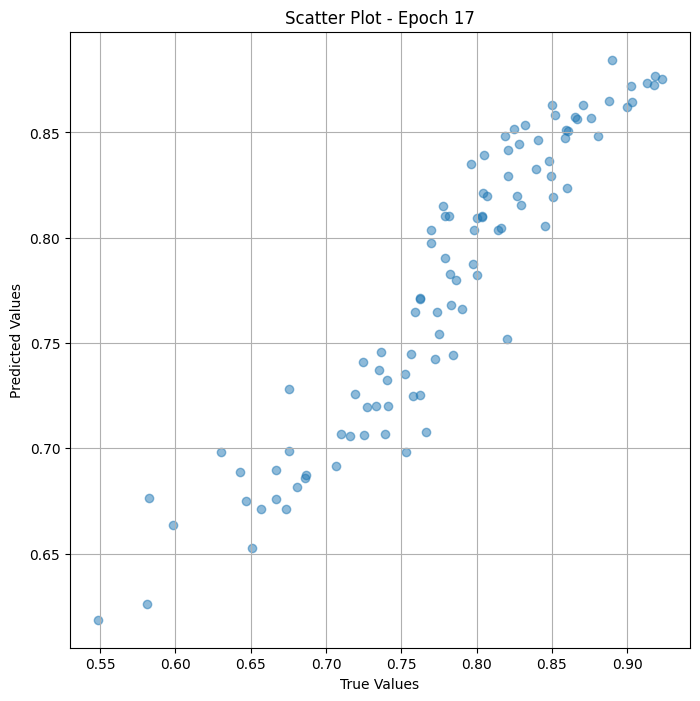

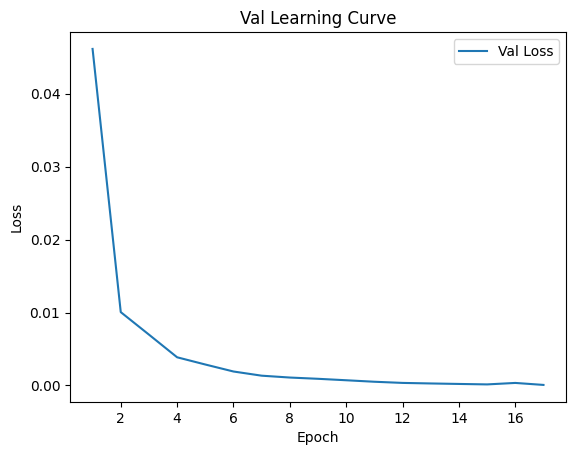


 Epoch: (18/30) Loss = 5.5544369388371706e-05

 Epoch: (18/30) Loss_rmse = 0.00745280971750617

 Epoch: (18/30) R^2 = 0.9937315583229065

 Epoch: (18/30) MAE = 0.0054925233125686646
Spearman correlation coefficient: SignificanceResult(statistic=0.9754641798774083, pvalue=1.3863004012849975e-63)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

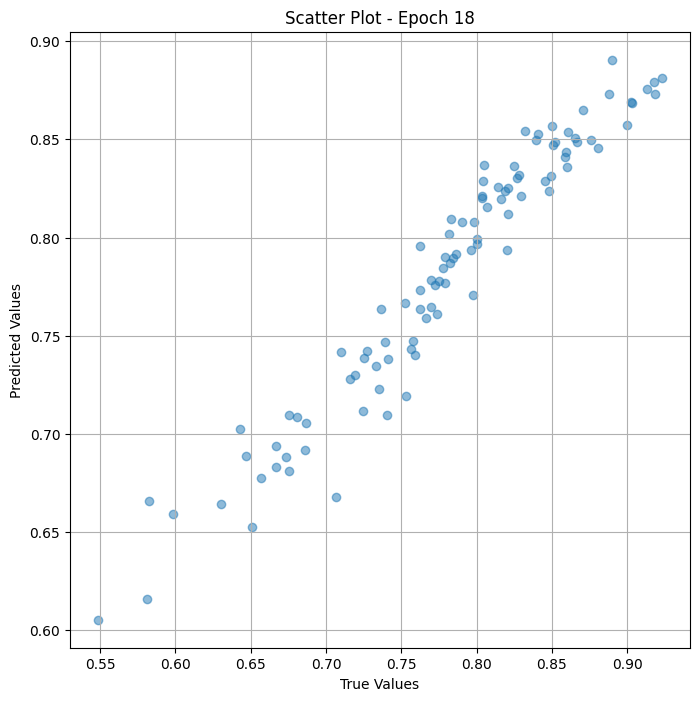

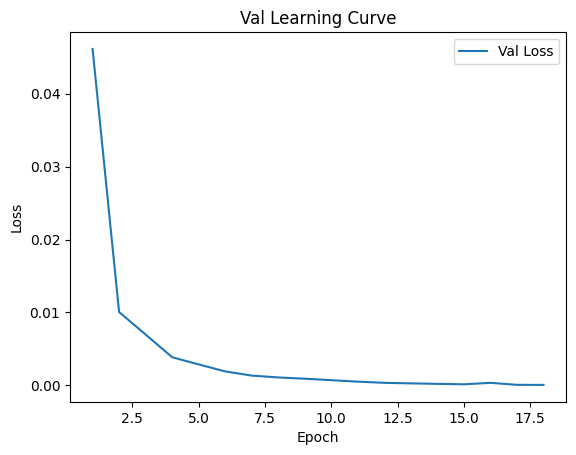


 Epoch: (19/30) Loss = 2.6024736143881455e-05

 Epoch: (19/30) Loss_rmse = 0.005101444665342569

 Epoch: (19/30) R^2 = 0.9970629811286926

 Epoch: (19/30) MAE = 0.004775837063789368
Spearman correlation coefficient: SignificanceResult(statistic=0.9845866894166595, pvalue=5.5262013791989394e-73)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

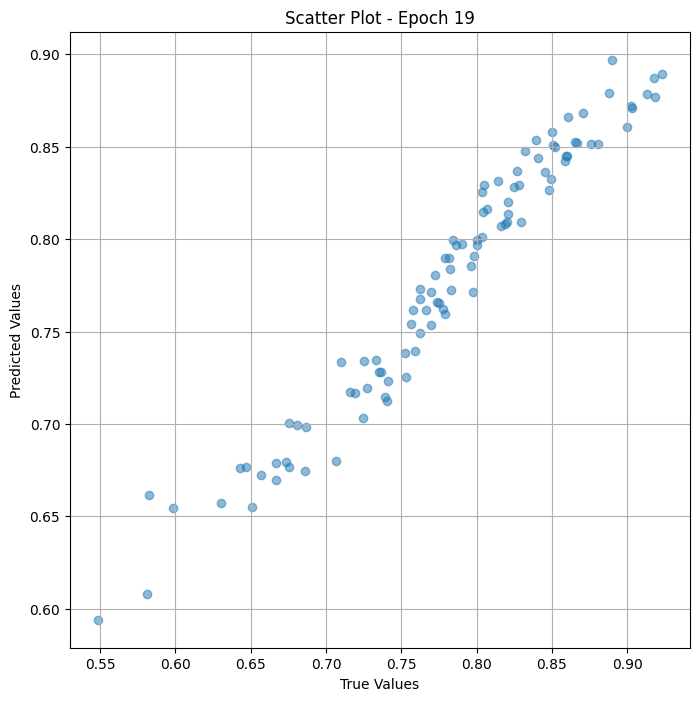

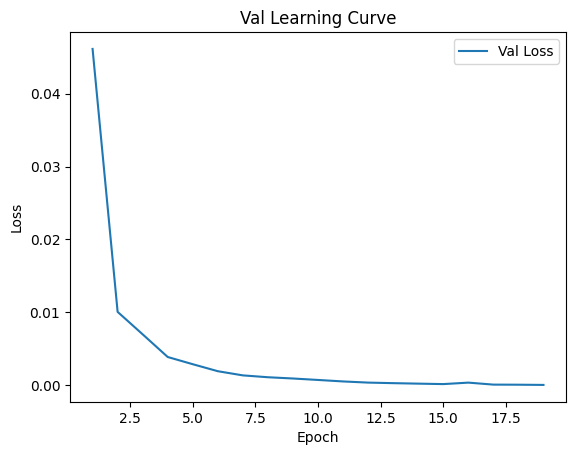


 Epoch: (20/30) Loss = 1.3395277164818253e-05

 Epoch: (20/30) Loss_rmse = 0.0036599559243768454

 Epoch: (20/30) R^2 = 0.9984883069992065

 Epoch: (20/30) MAE = 0.0028778910636901855
Spearman correlation coefficient: SignificanceResult(statistic=0.988412039141669, pvalue=9.063718854903699e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

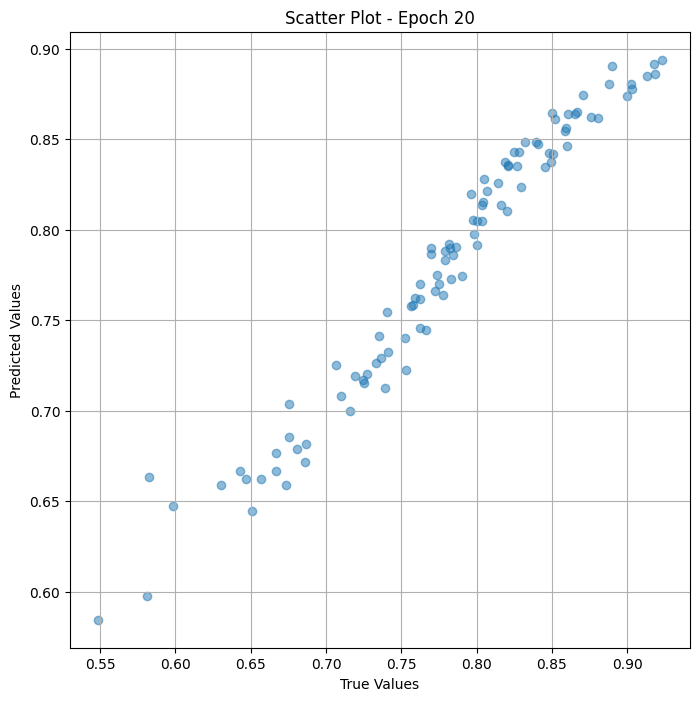

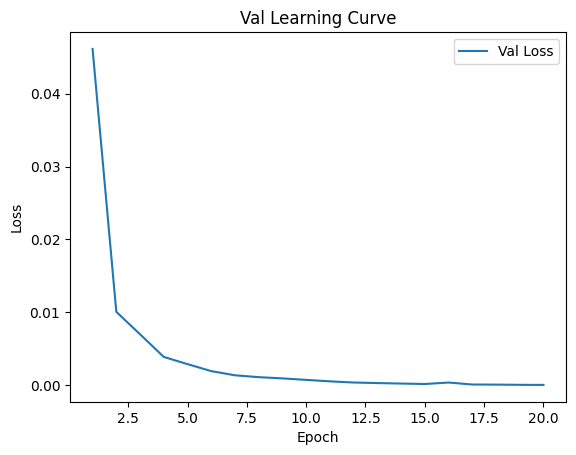


 Epoch: (21/30) Loss = 2.5910969270626083e-05

 Epoch: (21/30) Loss_rmse = 0.005090281832963228

 Epoch: (21/30) R^2 = 0.9970758557319641

 Epoch: (21/30) MAE = 0.00430123507976532
Spearman correlation coefficient: SignificanceResult(statistic=0.9947401442718709, pvalue=7.886622278404388e-95)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097

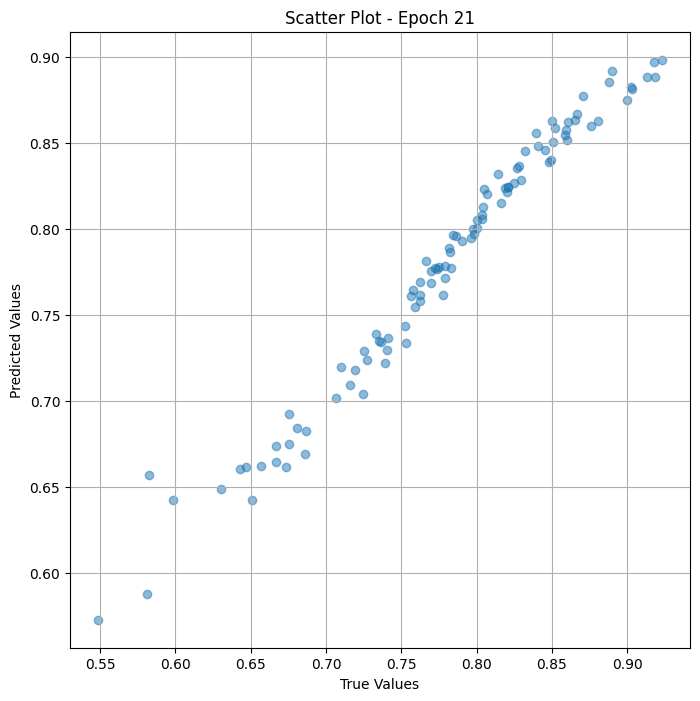

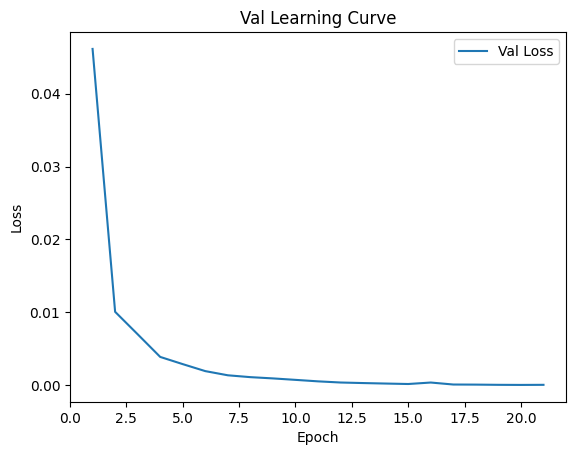


 Epoch: (22/30) Loss = 2.863529334717896e-05

 Epoch: (22/30) Loss_rmse = 0.005351195577532053

 Epoch: (22/30) R^2 = 0.9967683553695679

 Epoch: (22/30) MAE = 0.004539981484413147
Spearman correlation coefficient: SignificanceResult(statistic=0.995499788188894, pvalue=5.254327000977726e-98)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238097,

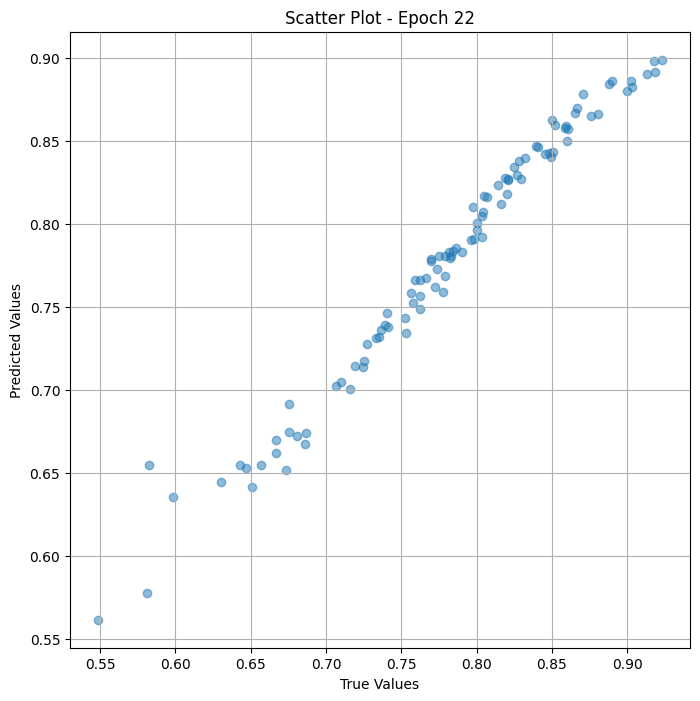

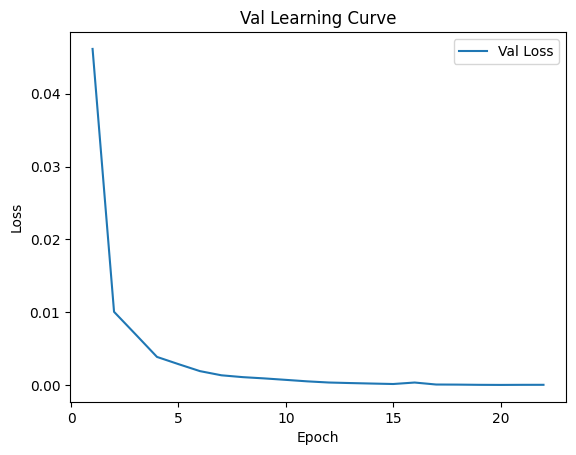

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (23/30) Loss = 2.961959398817271e-05

 Epoch: (23/30) Loss_rmse = 0.005442388821393251

 Epoch: (23/30) R^2 = 0.9966573119163513

 Epoch: (23/30) MAE = 0.004231974482536316
Spearman correlation coefficient: SignificanceResult(statistic=0.9952827470697445, pvalue=4.784442591406563e-97)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0

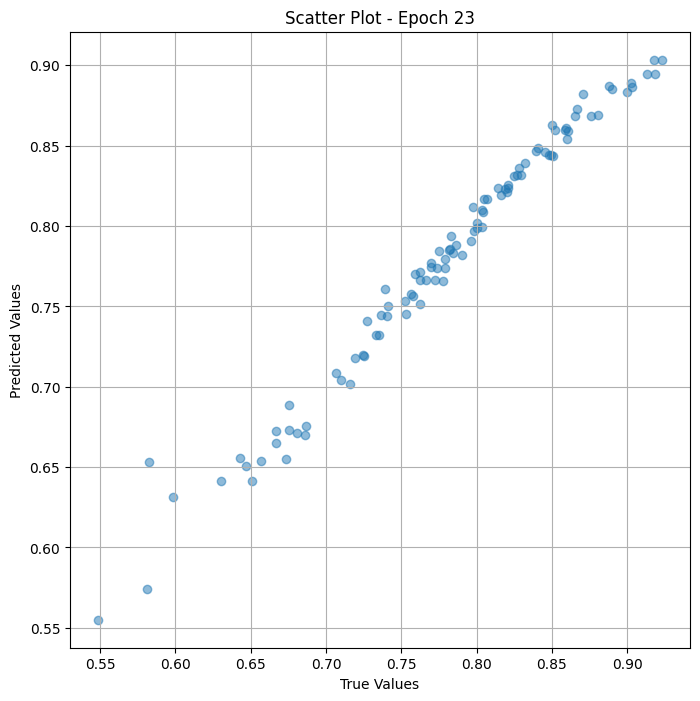

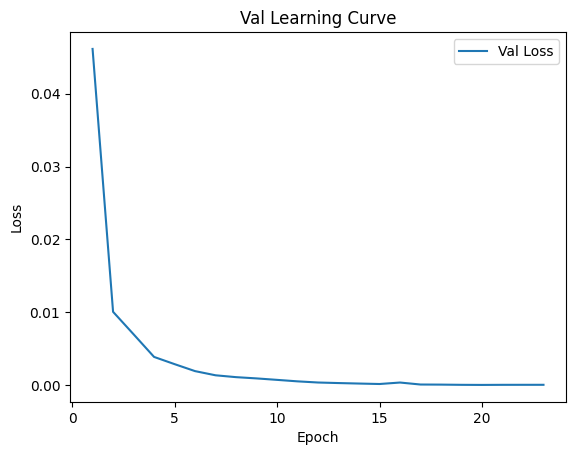


 Epoch: (24/30) Loss = 1.890222483780235e-05

 Epoch: (24/30) Loss_rmse = 0.004347668960690498

 Epoch: (24/30) R^2 = 0.9978668093681335

 Epoch: (24/30) MAE = 0.003389522433280945
Spearman correlation coefficient: SignificanceResult(statistic=0.9953641374894255, pvalue=2.1153111372173379e-97)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.7523809

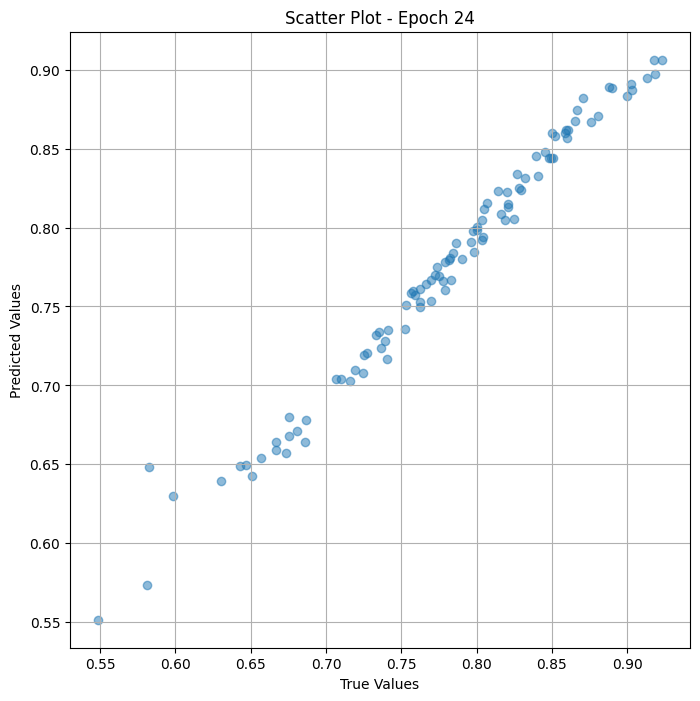

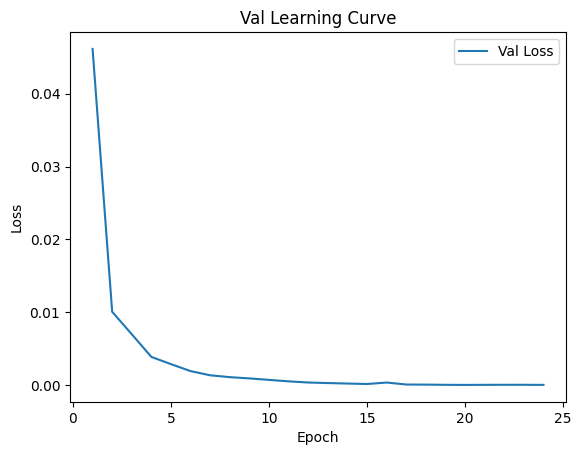


 Epoch: (25/30) Loss = 1.5412129869218916e-05

 Epoch: (25/30) Loss_rmse = 0.003925828728824854

 Epoch: (25/30) R^2 = 0.9982606768608093

 Epoch: (25/30) MAE = 0.003445073962211609
Spearman correlation coefficient: SignificanceResult(statistic=0.9962933447807841, pvalue=5.868242197501862e-102)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

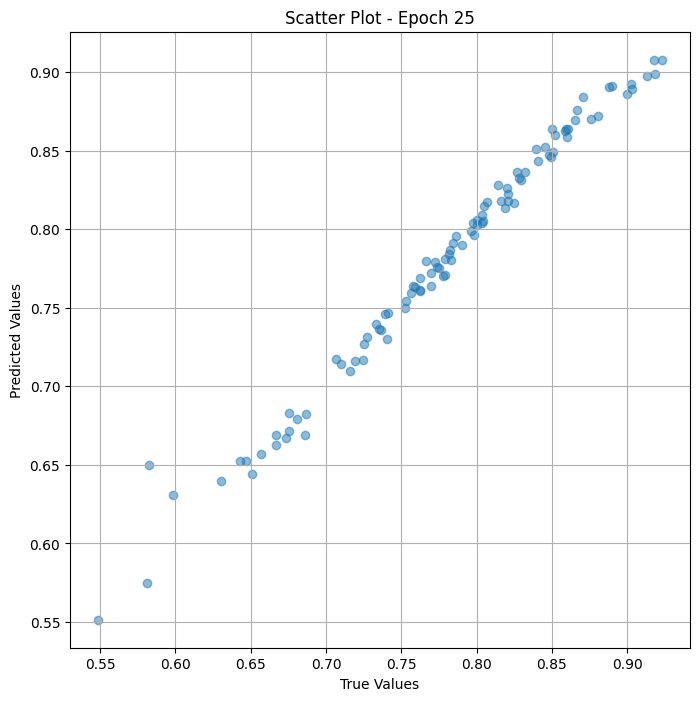

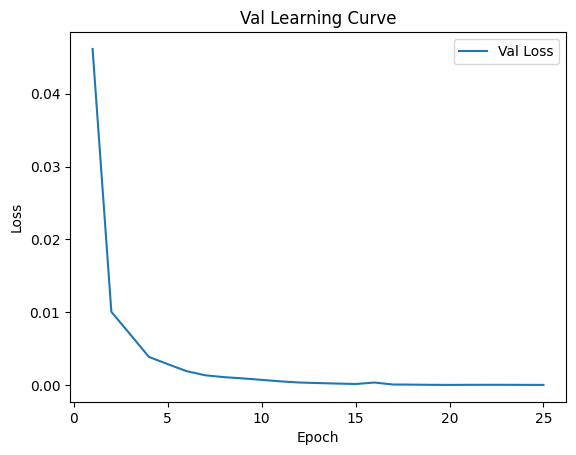


 Epoch: (26/30) Loss = 1.2555482499010395e-05

 Epoch: (26/30) Loss_rmse = 0.003543371567502618

 Epoch: (26/30) R^2 = 0.9985830783843994

 Epoch: (26/30) MAE = 0.002912774682044983
Spearman correlation coefficient: SignificanceResult(statistic=0.9967477746240034, pvalue=1.2684895976099939e-104)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238

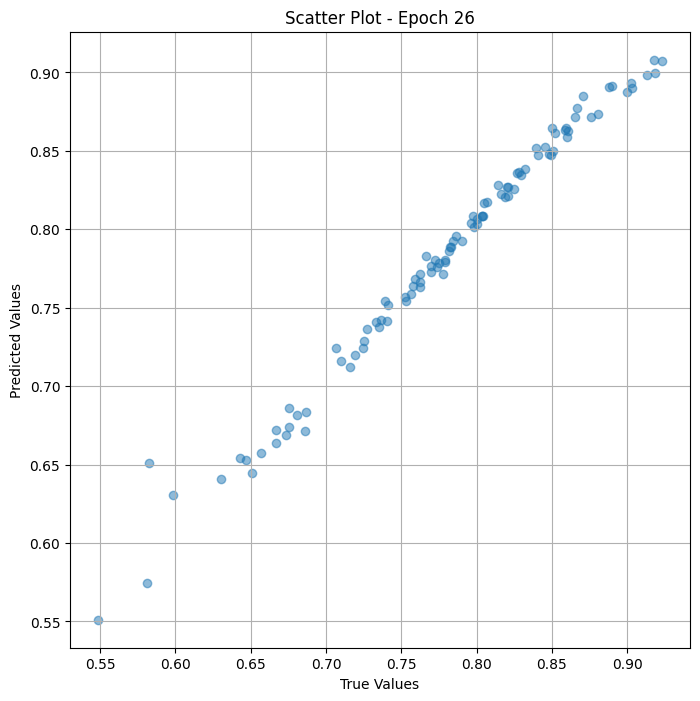

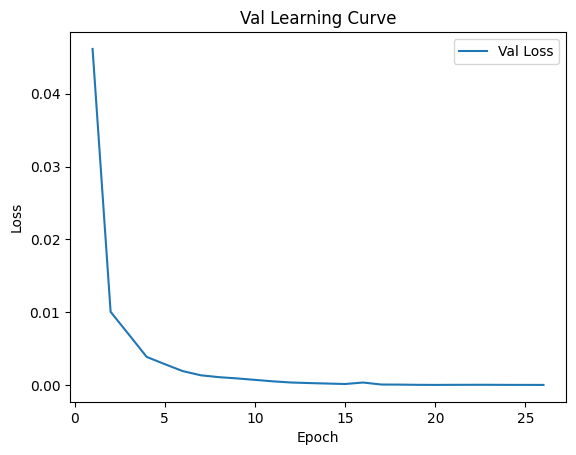


 Epoch: (27/30) Loss = 1.5240872926369775e-05

 Epoch: (27/30) Loss_rmse = 0.003903956152498722

 Epoch: (27/30) R^2 = 0.9982799887657166

 Epoch: (27/30) MAE = 0.0021901875734329224
Spearman correlation coefficient: SignificanceResult(statistic=0.997643069240495, pvalue=3.466300696772485e-111)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.752380

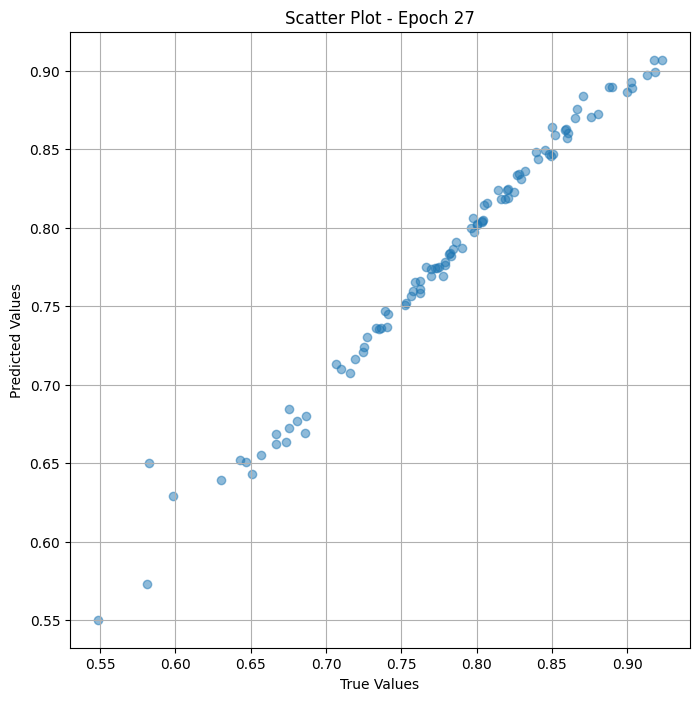

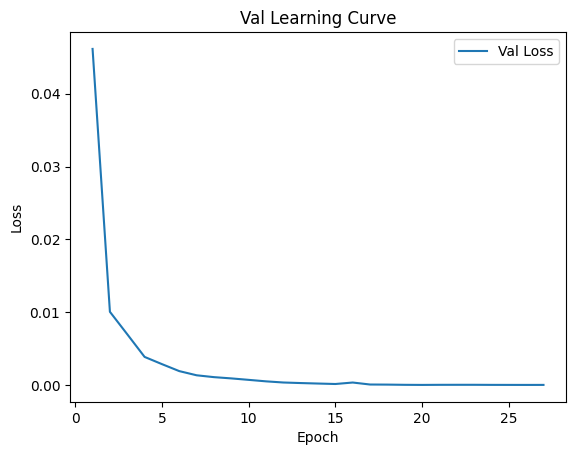


 Epoch: (28/30) Loss = 1.5463956515304744e-05

 Epoch: (28/30) Loss_rmse = 0.003932423889636993

 Epoch: (28/30) R^2 = 0.9982548356056213

 Epoch: (28/30) MAE = 0.0025703758001327515
Spearman correlation coefficient: SignificanceResult(statistic=0.9974192455863721, pvalue=2.451701831621384e-109)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238

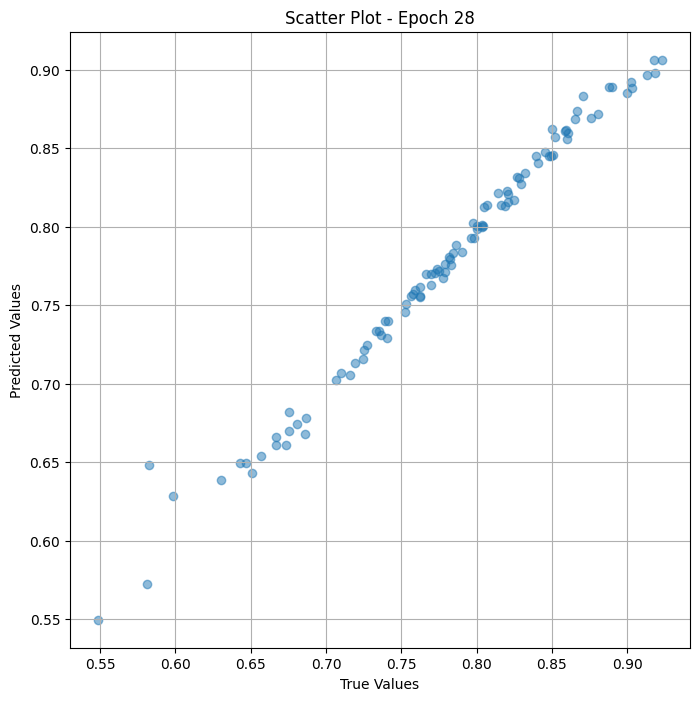

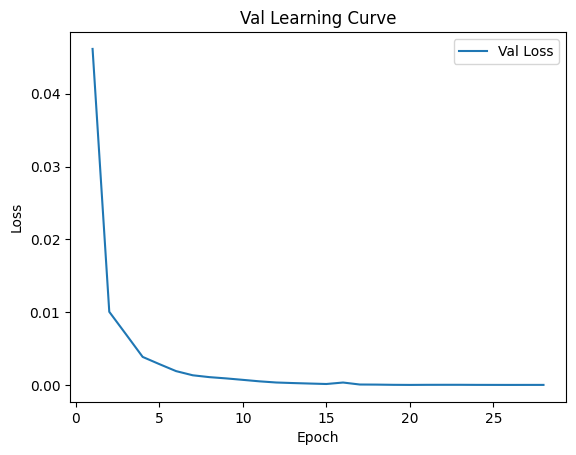


 Epoch: (29/30) Loss = 1.2507221981650218e-05

 Epoch: (29/30) Loss_rmse = 0.0035365549847483635

 Epoch: (29/30) R^2 = 0.998588502407074

 Epoch: (29/30) MAE = 0.0019792020320892334
Spearman correlation coefficient: SignificanceResult(statistic=0.9972361171420897, pvalue=6.123546914253919e-108)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.75238

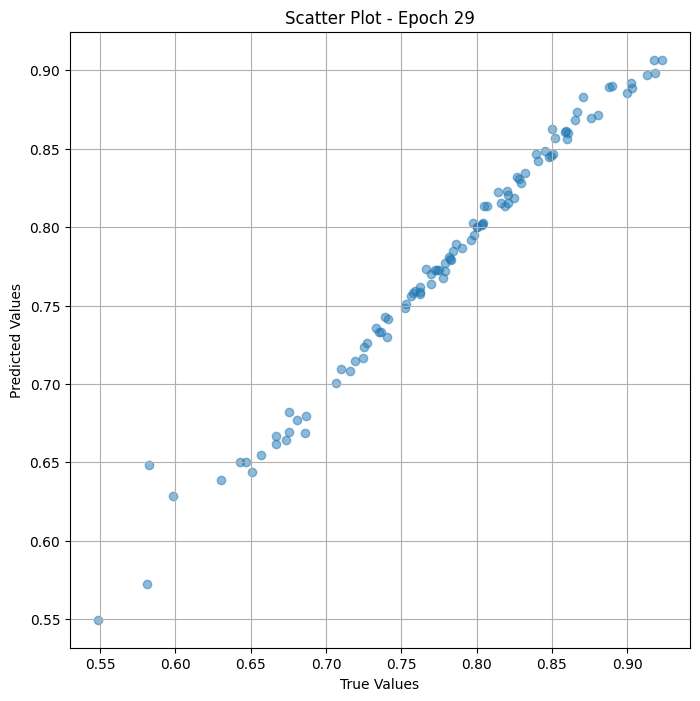

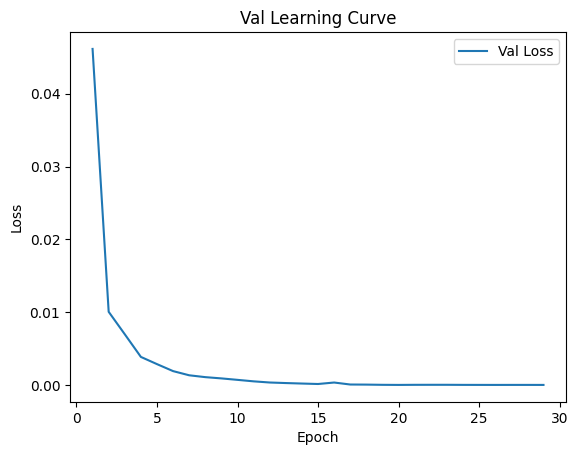


 Epoch: (30/30) Loss = 1.0190855391556397e-05

 Epoch: (30/30) Loss_rmse = 0.0031923118513077497

 Epoch: (30/30) R^2 = 0.9988499283790588

 Epoch: (30/30) MAE = 0.001819223165512085
Spearman correlation coefficient: SignificanceResult(statistic=0.9976973295202823, pvalue=1.1614247504689474e-111)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.70652175, 0.87628865, 0.77922076, 0.9183673, 0.77, 0.6304348, 0.7592593, 0.79611653, 0.77, 0.74038464, 0.6756757, 0.88095236, 0.79787236, 0.84782606, 0.8207547, 0.7352941, 0.6752137, 0.8666667, 0.8518519, 0.5826087, 0.72440946, 0.86538464, 0.8210526, 0.9, 0.8596491, 0.81904763, 0.827957, 0.8, 0.9029126, 0.85858583, 0.82474226, 0.85, 0.8041237, 0.80487806, 0.7816092, 0.7747748, 0.73626375, 0.82978725, 0.54867256, 0.7735849, 0.7979798, 0.71910113, 0.81609195, 0.9032258, 0.83206105, 0.8495575, 0.8039216, 0.64285713, 0.9130435, 0.8072289, 0.6666667, 0.6857143, 0.7821782, 0.8703704, 0.8411215, 0.7625, 0.7523

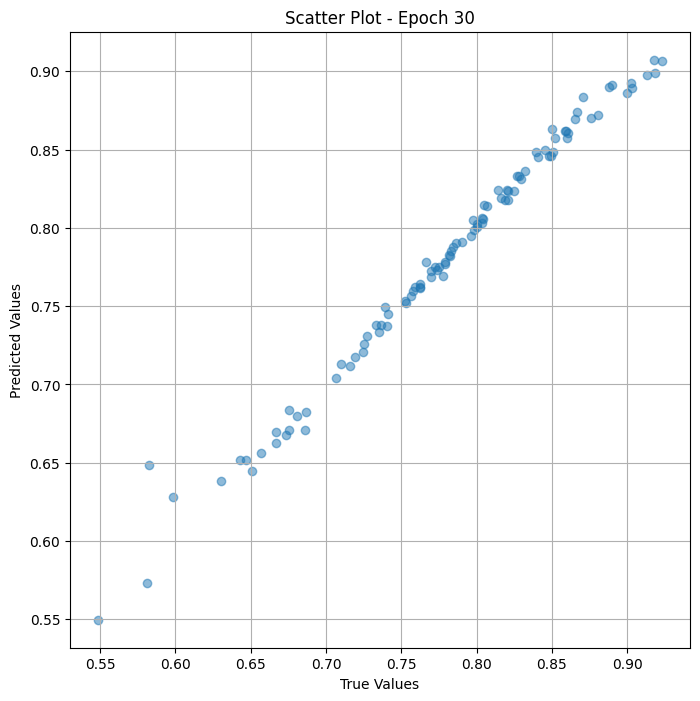

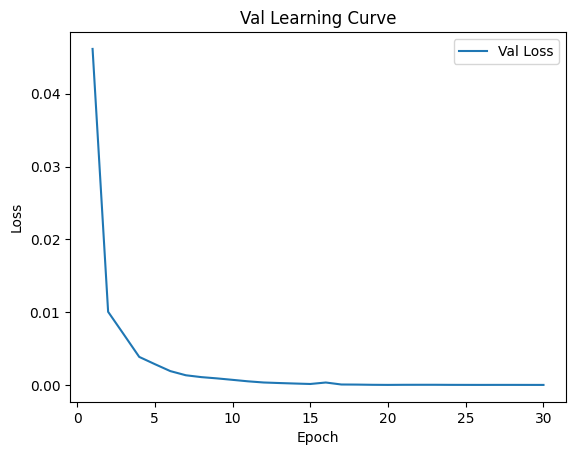

In [ ]:
# val the model and save weights
fit(30, model_vit_sval , val_dl )
torch.save(model_vit_sval.state_dict(), "model_weights_s")

## Test

In [ ]:
params = [param for param in list(model_vit_test.parameters()) if param.requires_grad == True ]
optimizer = torch.optim.Adam(params, lr=1e-4 ,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/30) Loss = 0.006624797824770212

 Epoch: (1/30) Loss_rmse = 0.08139286190271378

 Epoch: (1/30) R^2 = 0.1356714963912964

 Epoch: (1/30) MAE = 0.07940858602523804
Spearman correlation coefficient: SignificanceResult(statistic=0.8448643648105124, pvalue=2.8145620511002797e-27)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0.919

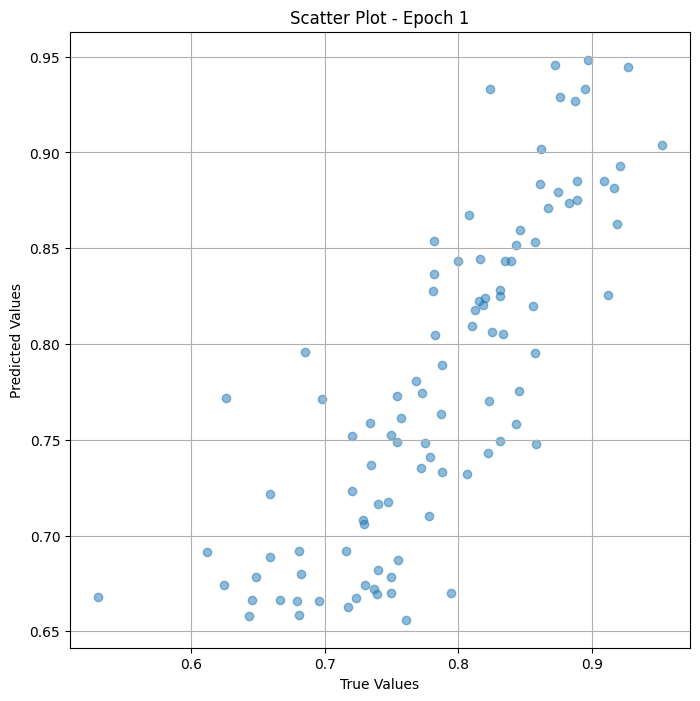

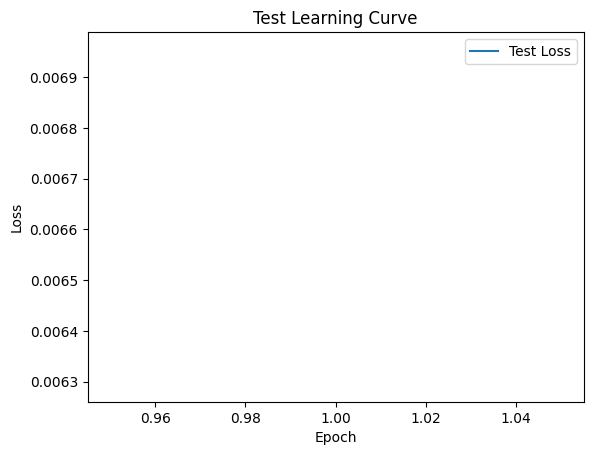


 Epoch: (2/30) Loss = 0.003923600073903799

 Epoch: (2/30) Loss_rmse = 0.06263864785432816

 Epoch: (2/30) R^2 = 0.48809313774108887

 Epoch: (2/30) MAE = 0.054564282298088074
Spearman correlation coefficient: SignificanceResult(statistic=0.6905596009605798, pvalue=6.9942486517830606e-15)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0.9

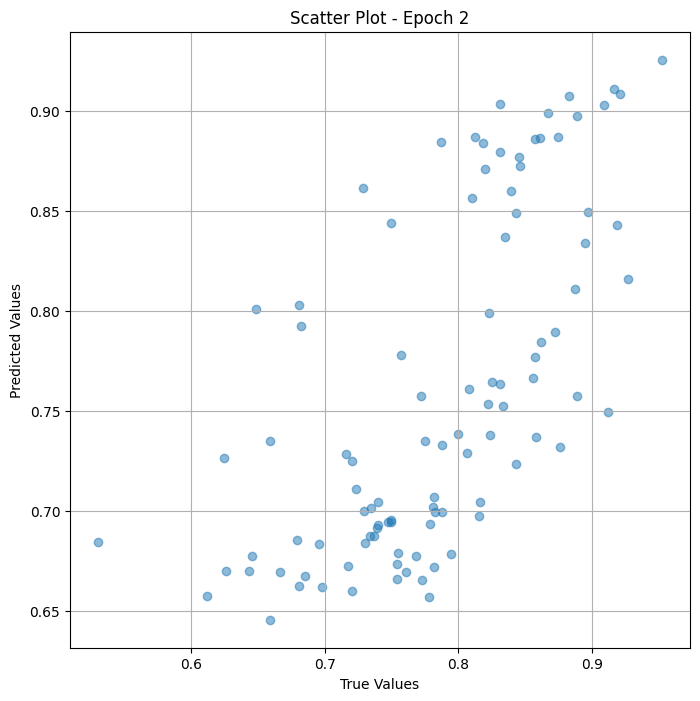

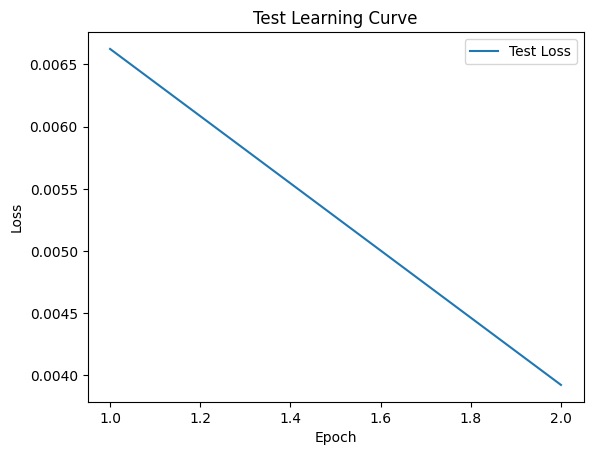


 Epoch: (3/30) Loss = 0.001142492750659585

 Epoch: (3/30) Loss_rmse = 0.03380078077316284

 Epoch: (3/30) R^2 = 0.850940465927124

 Epoch: (3/30) MAE = 0.030791357159614563
Spearman correlation coefficient: SignificanceResult(statistic=0.6561106385168959, pvalue=3.9840821605578075e-13)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0.919

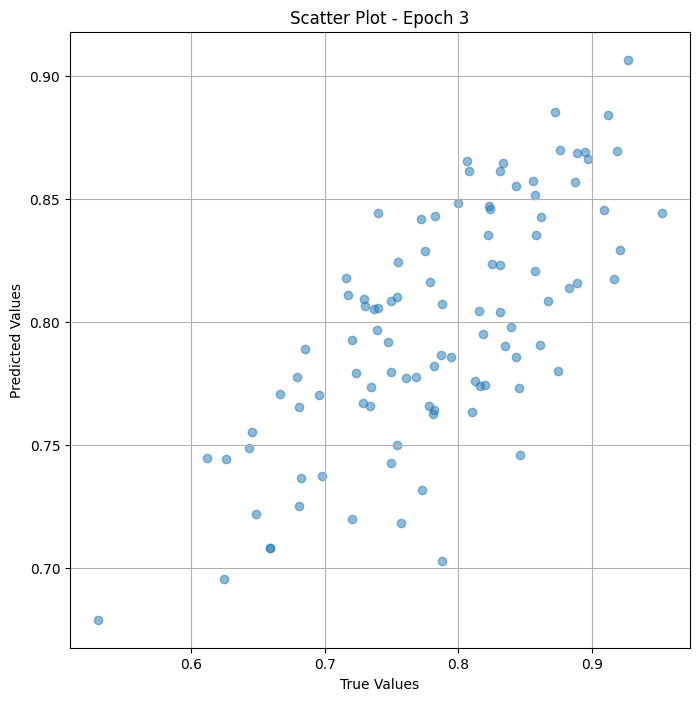

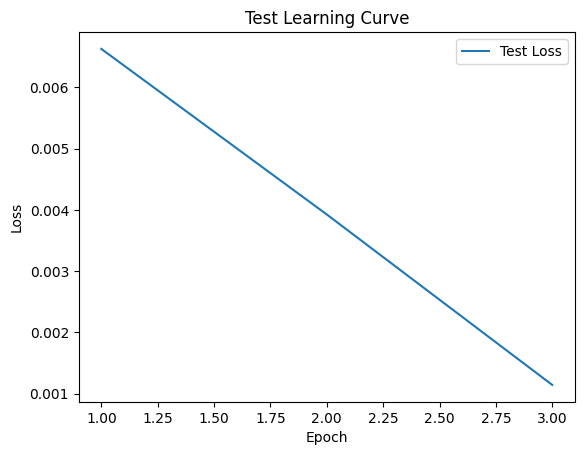


 Epoch: (4/30) Loss = 0.0007040707860141993

 Epoch: (4/30) Loss_rmse = 0.02653433196246624

 Epoch: (4/30) R^2 = 0.9081408381462097

 Epoch: (4/30) MAE = 0.024224087595939636
Spearman correlation coefficient: SignificanceResult(statistic=0.8644322436547787, pvalue=7.9986098213909e-30)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0.9191

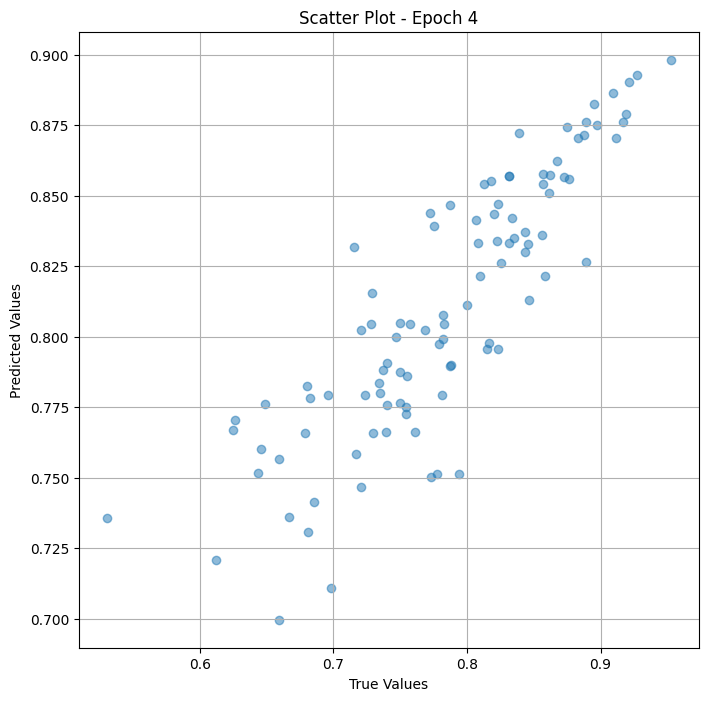

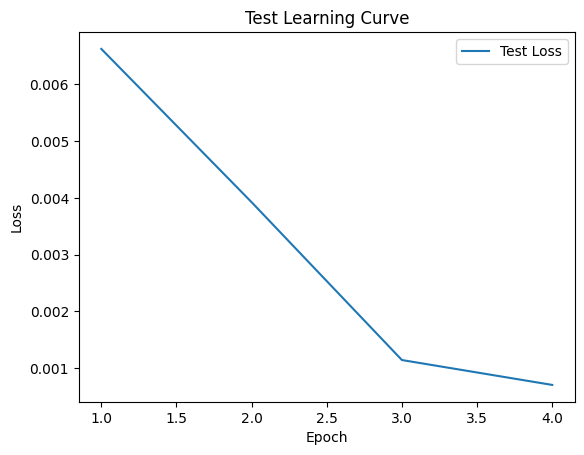


 Epoch: (5/30) Loss = 0.000406042265240103

 Epoch: (5/30) Loss_rmse = 0.02015049010515213

 Epoch: (5/30) R^2 = 0.9470242261886597

 Epoch: (5/30) MAE = 0.017443731427192688
Spearman correlation coefficient: SignificanceResult(statistic=0.9143048998564733, pvalue=1.1368429276392905e-38)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0.91

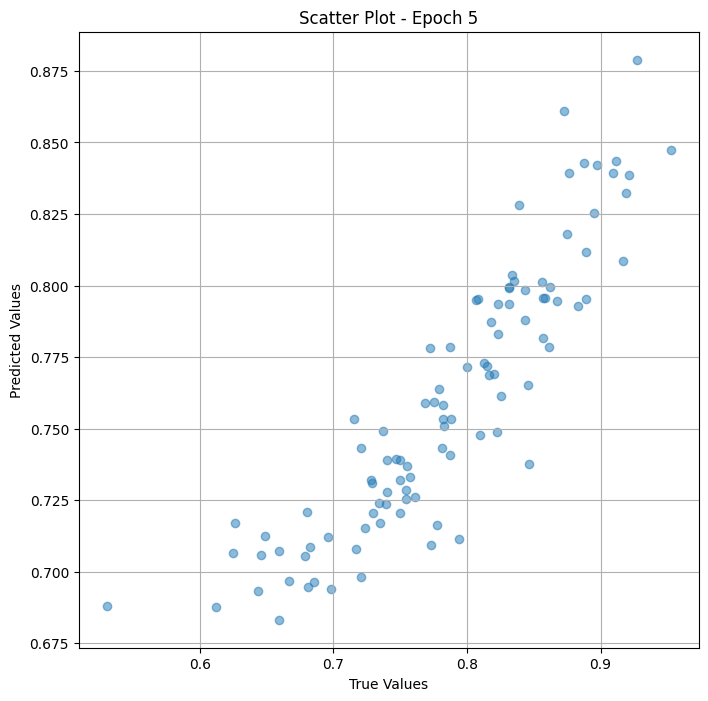

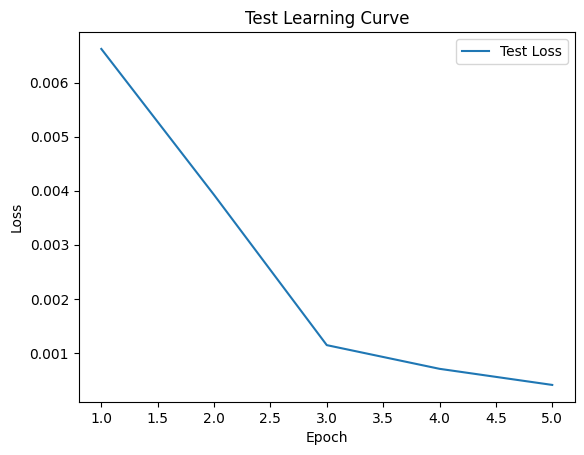


 Epoch: (6/30) Loss = 0.0005774183664470911

 Epoch: (6/30) Loss_rmse = 0.024029530584812164

 Epoch: (6/30) R^2 = 0.9246649742126465

 Epoch: (6/30) MAE = 0.0224124938249588
Spearman correlation coefficient: SignificanceResult(statistic=0.8884902215614033, pvalue=1.4637648863888711e-33)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0.91

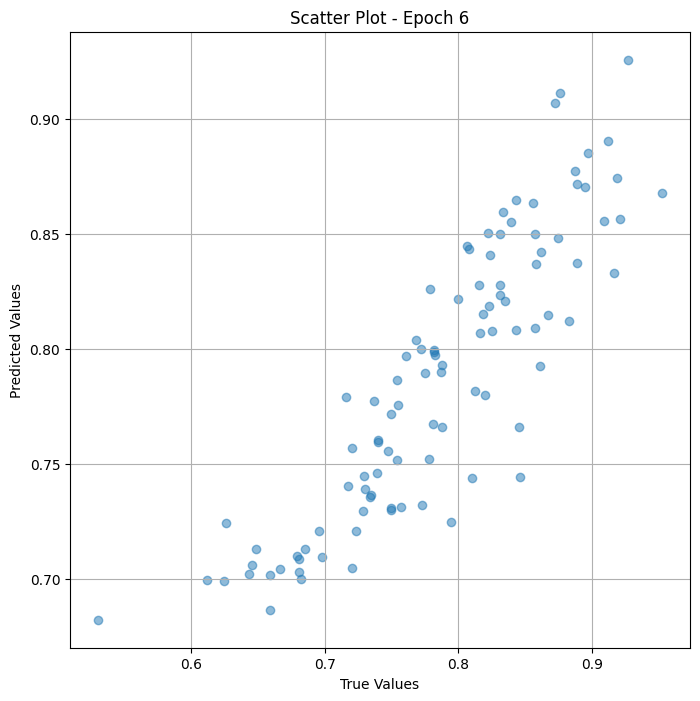

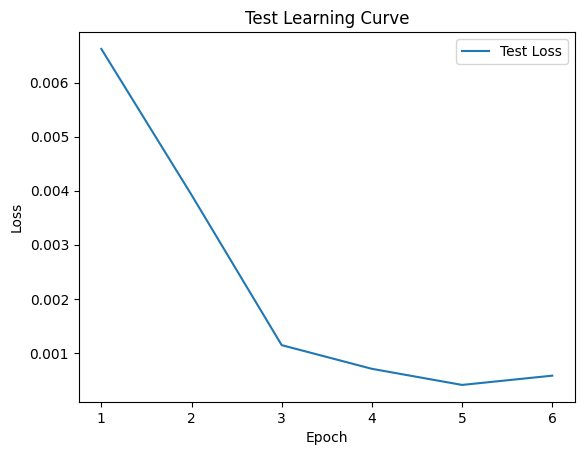


 Epoch: (7/30) Loss = 0.00031180004589259624

 Epoch: (7/30) Loss_rmse = 0.01765786111354828

 Epoch: (7/30) R^2 = 0.9593198895454407

 Epoch: (7/30) MAE = 0.014554306864738464
Spearman correlation coefficient: SignificanceResult(statistic=0.9496695169427832, pvalue=3.551292642598012e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0.9

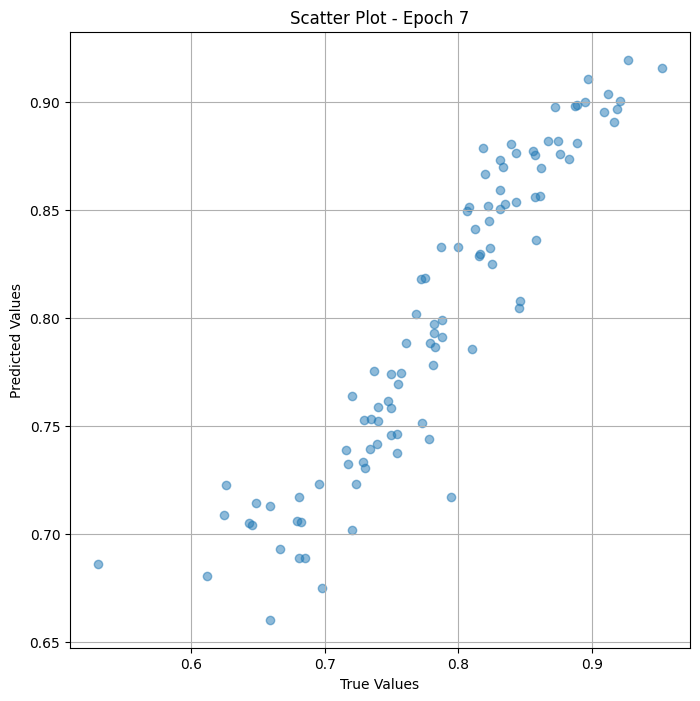

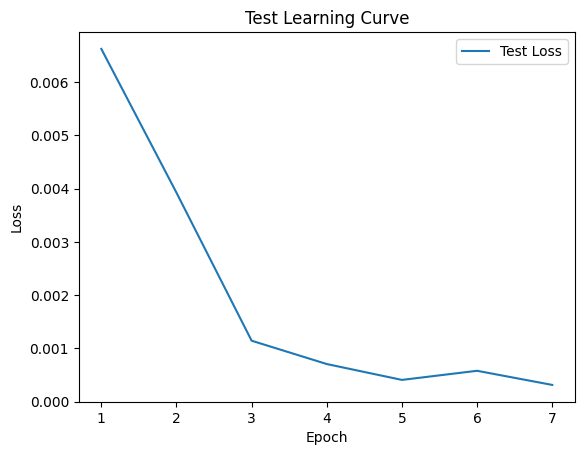


 Epoch: (8/30) Loss = 0.0004131545138079673

 Epoch: (8/30) Loss_rmse = 0.020326202735304832

 Epoch: (8/30) R^2 = 0.9460963010787964

 Epoch: (8/30) MAE = 0.01692543923854828
Spearman correlation coefficient: SignificanceResult(statistic=0.9518128270692262, pvalue=4.825841650085854e-50)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0.91

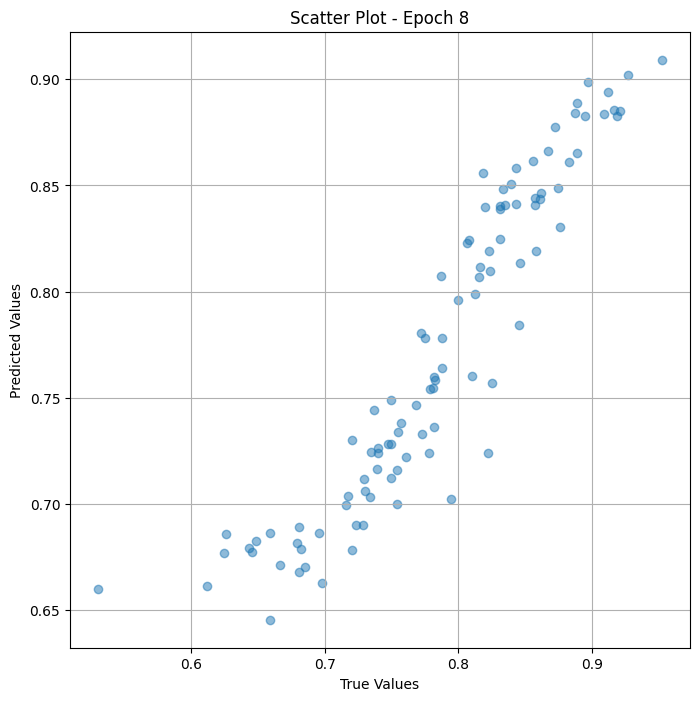

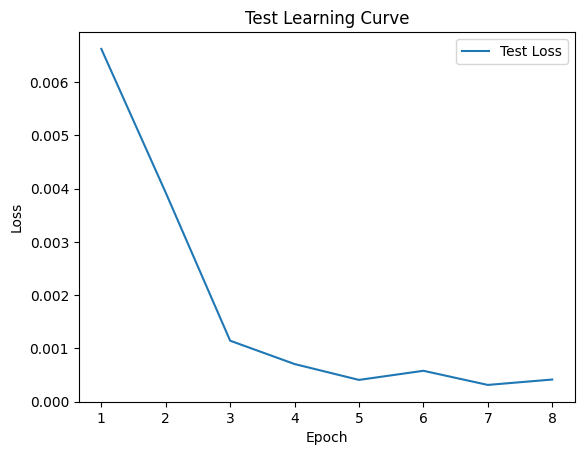


 Epoch: (9/30) Loss = 0.00017939438112080097

 Epoch: (9/30) Loss_rmse = 0.013393818400800228

 Epoch: (9/30) R^2 = 0.9765946269035339

 Epoch: (9/30) MAE = 0.010438933968544006
Spearman correlation coefficient: SignificanceResult(statistic=0.9684166979221771, pvalue=1.6821490221204905e-58)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 0

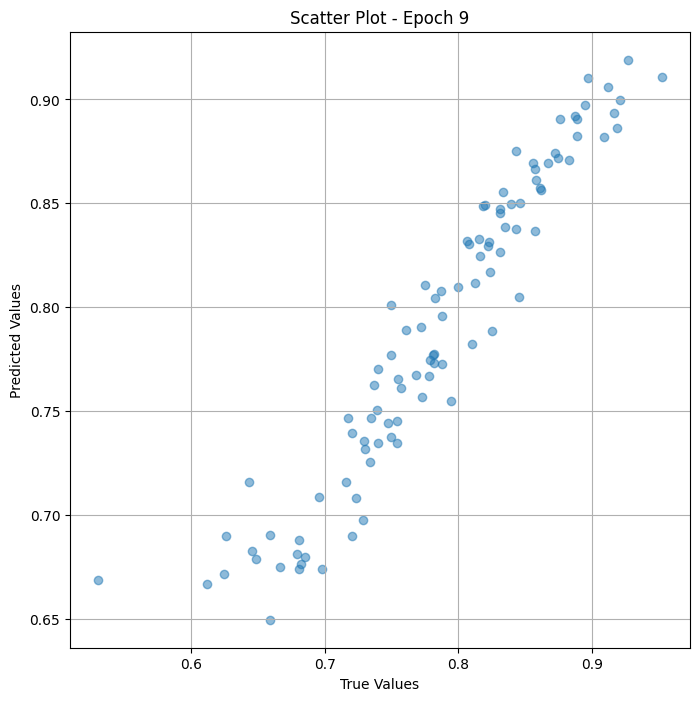

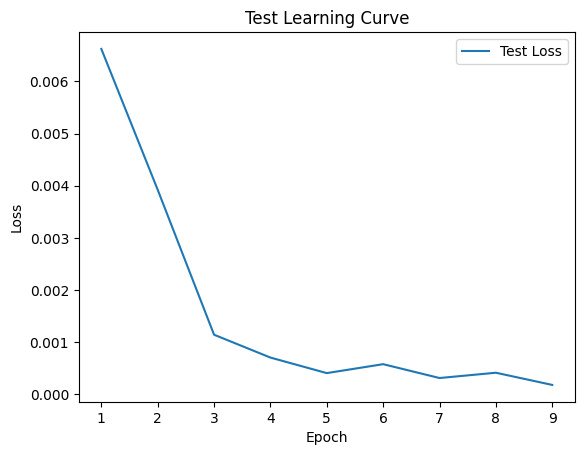


 Epoch: (10/30) Loss = 0.00011390747386030853

 Epoch: (10/30) Loss_rmse = 0.010672744363546371

 Epoch: (10/30) R^2 = 0.9851386547088623

 Epoch: (10/30) MAE = 0.009609892964363098
Spearman correlation coefficient: SignificanceResult(statistic=0.9850205687751282, pvalue=1.458387775231611e-73)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586

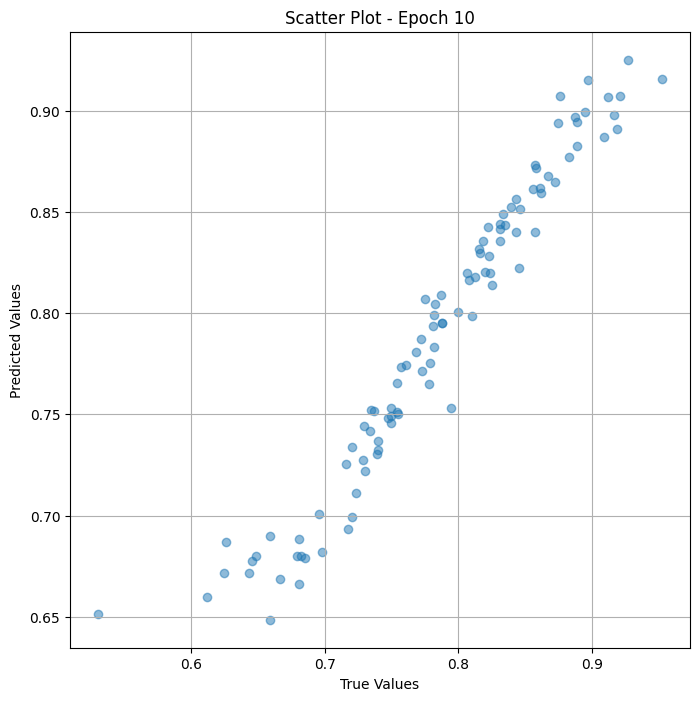

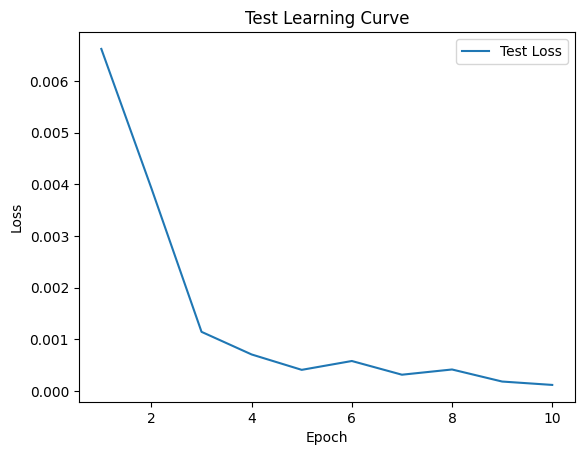


 Epoch: (11/30) Loss = 4.537215500022285e-05

 Epoch: (11/30) Loss_rmse = 0.006735885515809059

 Epoch: (11/30) R^2 = 0.9940803647041321

 Epoch: (11/30) MAE = 0.006432637572288513
Spearman correlation coefficient: SignificanceResult(statistic=0.9883847517584058, pvalue=1.011689946024579e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586,

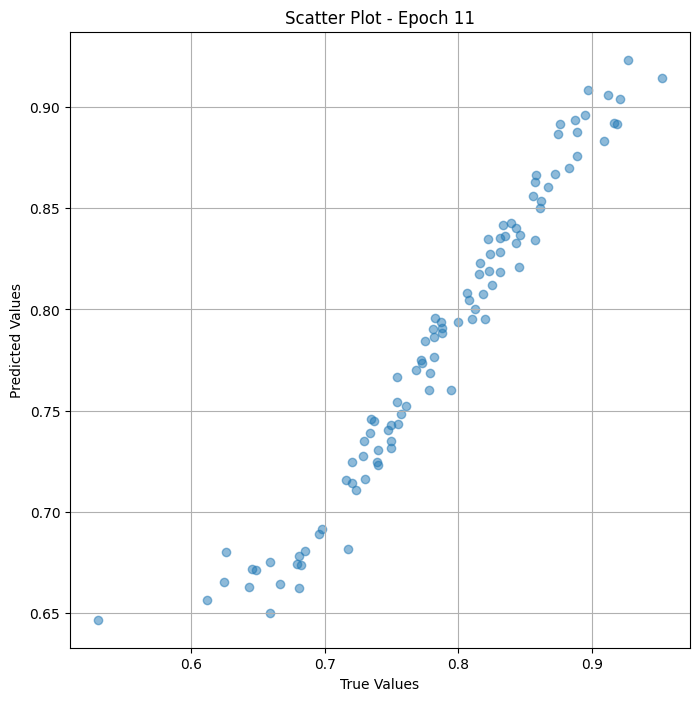

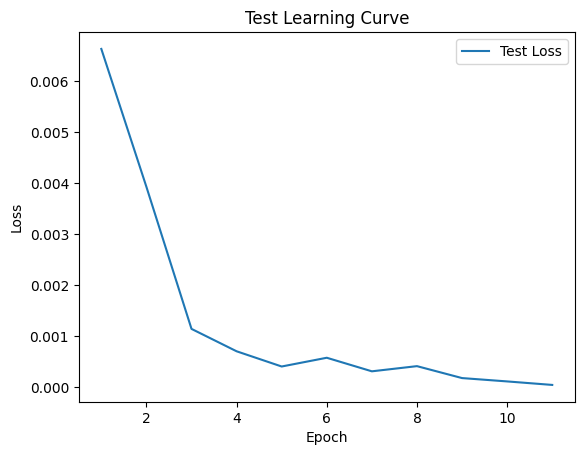


 Epoch: (12/30) Loss = 3.919612936442718e-05

 Epoch: (12/30) Loss_rmse = 0.006260681431740522

 Epoch: (12/30) R^2 = 0.9948861598968506

 Epoch: (12/30) MAE = 0.005328088998794556
Spearman correlation coefficient: SignificanceResult(statistic=0.9919659788051208, pvalue=3.279069481218948e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586,

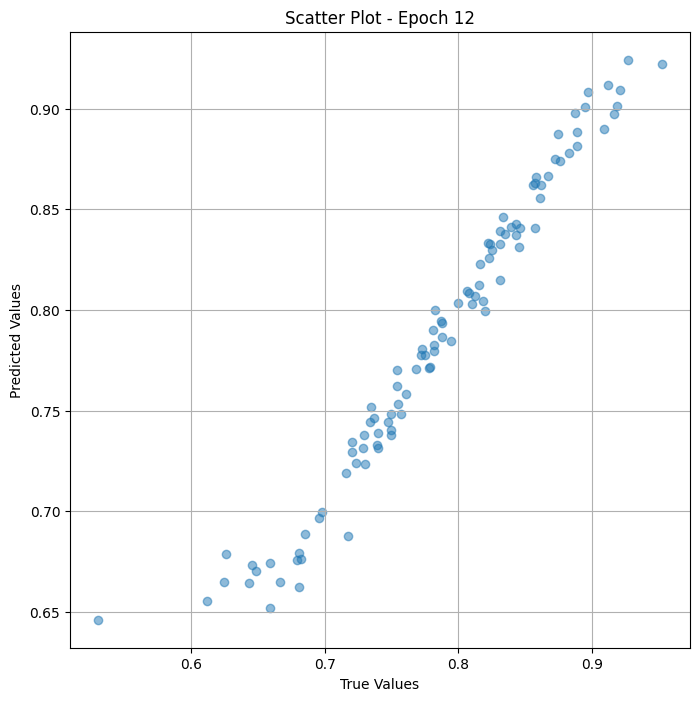

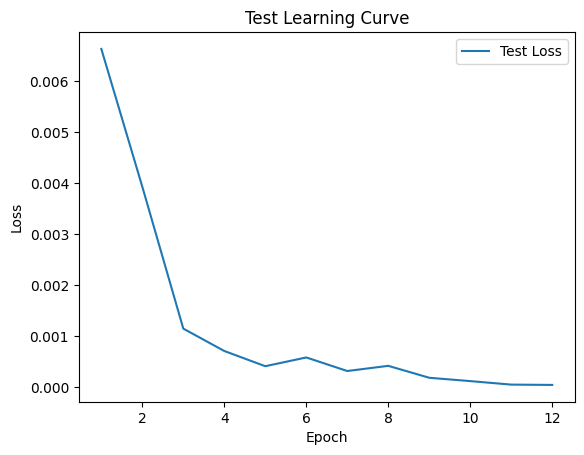


 Epoch: (13/30) Loss = 1.8505186744732782e-05

 Epoch: (13/30) Loss_rmse = 0.004301765467971563

 Epoch: (13/30) R^2 = 0.997585654258728

 Epoch: (13/30) MAE = 0.0028234124183654785
Spearman correlation coefficient: SignificanceResult(statistic=0.9946993774790337, pvalue=1.1326205362286032e-94)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.7731958

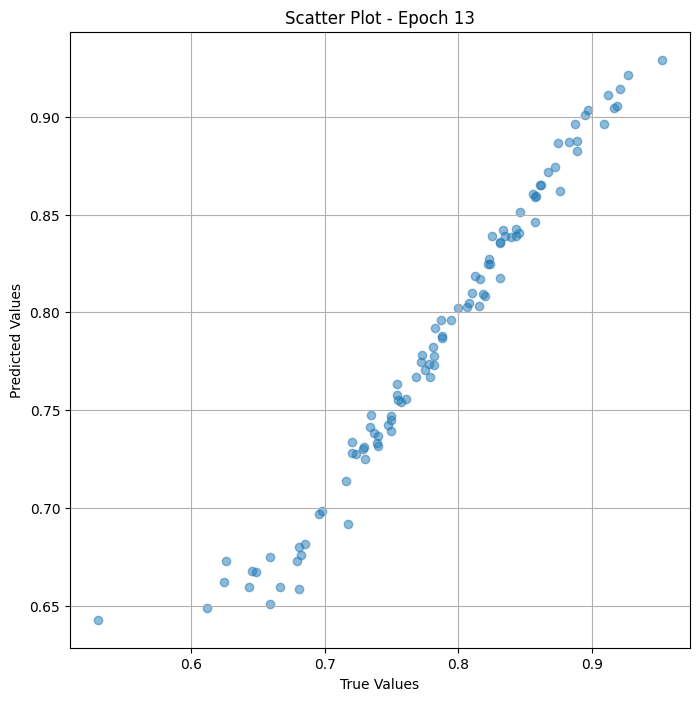

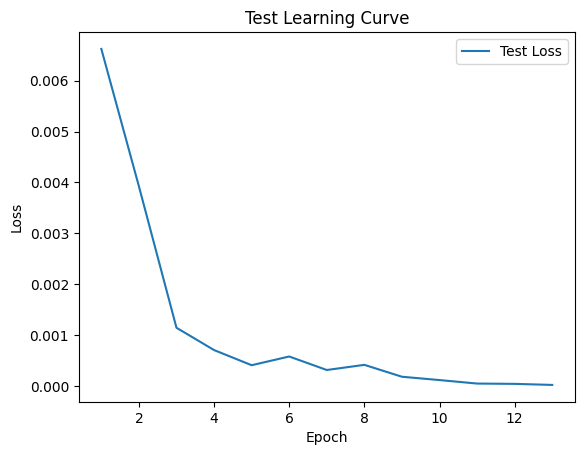


 Epoch: (14/30) Loss = 6.345899237203412e-06

 Epoch: (14/30) Loss_rmse = 0.002519106725230813

 Epoch: (14/30) R^2 = 0.999172031879425

 Epoch: (14/30) MAE = 0.0020851492881774902
Spearman correlation coefficient: SignificanceResult(statistic=0.9966527740499691, pvalue=4.898497190119537e-104)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586

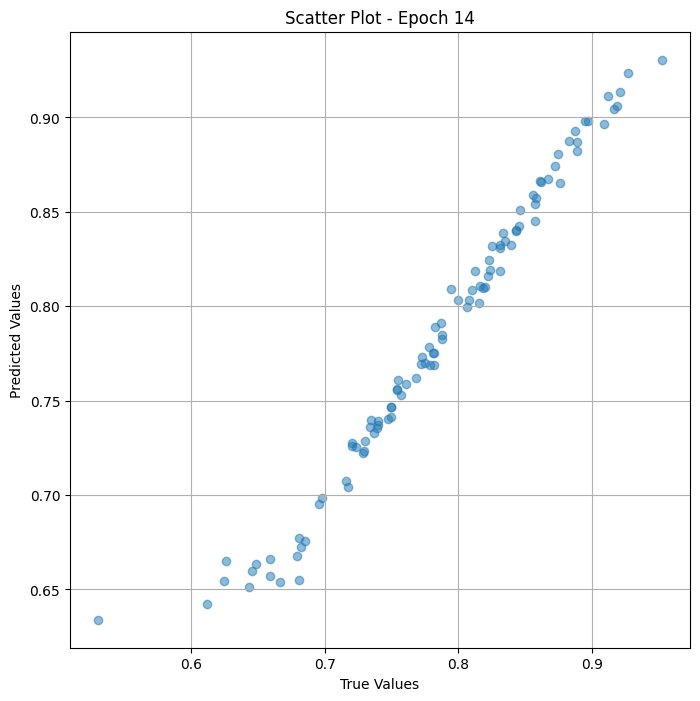

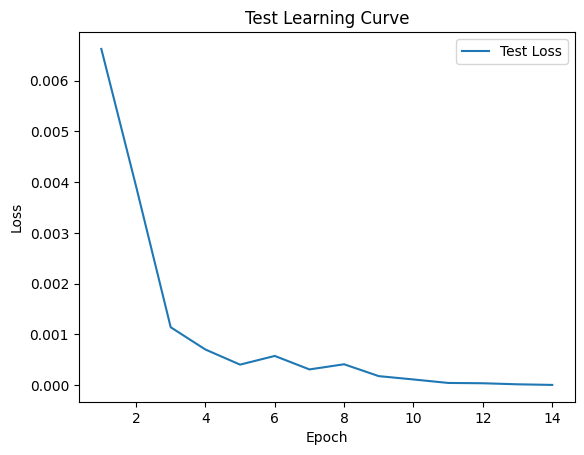


 Epoch: (15/30) Loss = 1.6066996977315284e-05

 Epoch: (15/30) Loss_rmse = 0.004008365795016289

 Epoch: (15/30) R^2 = 0.9979037642478943

 Epoch: (15/30) MAE = 0.003279358148574829
Spearman correlation coefficient: SignificanceResult(statistic=0.9974870371688063, pvalue=7.027205715023152e-110)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.7731958

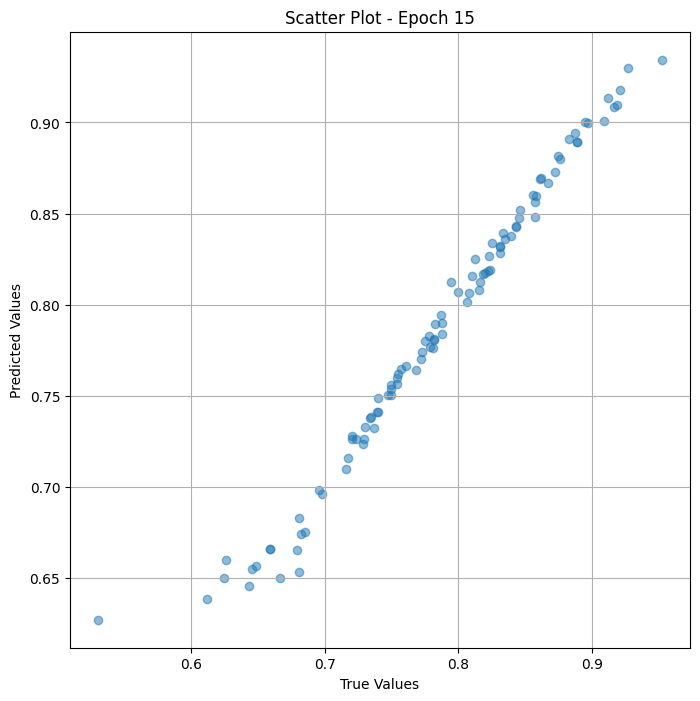

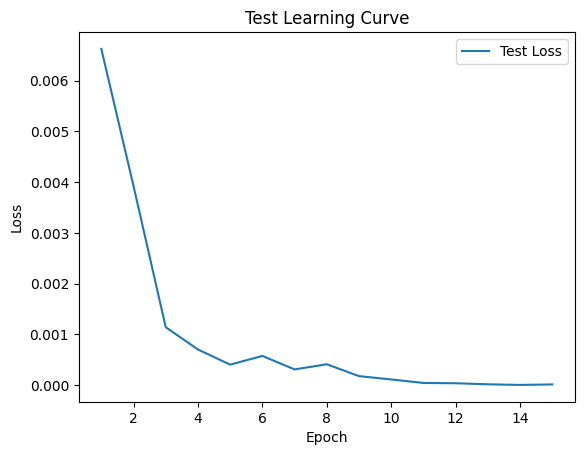


 Epoch: (16/30) Loss = 4.8940846681944095e-06

 Epoch: (16/30) Loss_rmse = 0.0022122578229755163

 Epoch: (16/30) R^2 = 0.9993614554405212

 Epoch: (16/30) MAE = 0.0019288361072540283
Spearman correlation coefficient: SignificanceResult(statistic=0.9985993879939222, pvalue=8.430747536387995e-122)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319

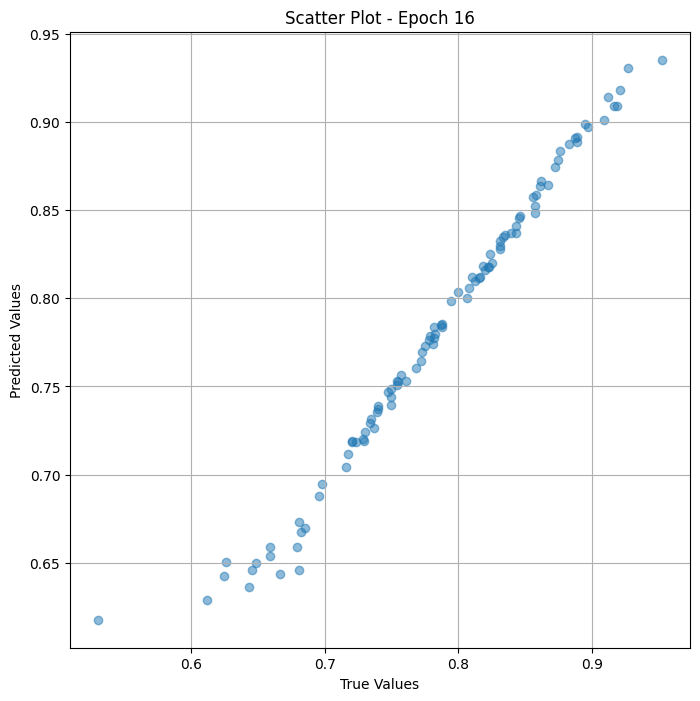

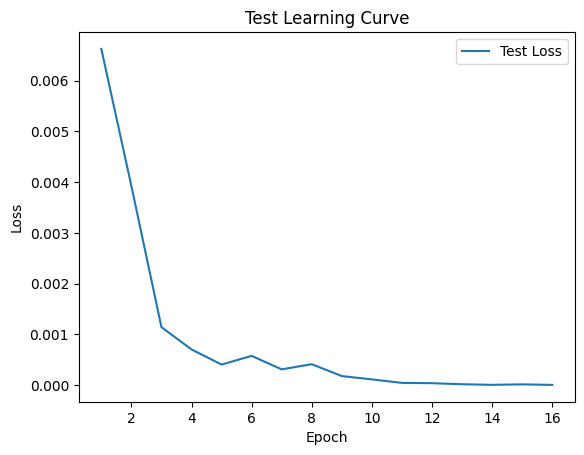


 Epoch: (17/30) Loss = 4.639436156139709e-06

 Epoch: (17/30) Loss_rmse = 0.002153935143724084

 Epoch: (17/30) R^2 = 0.9993947148323059

 Epoch: (17/30) MAE = 0.001823335886001587
Spearman correlation coefficient: SignificanceResult(statistic=0.9983552134225552, pvalue=1.5984035663616717e-118)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.7731958

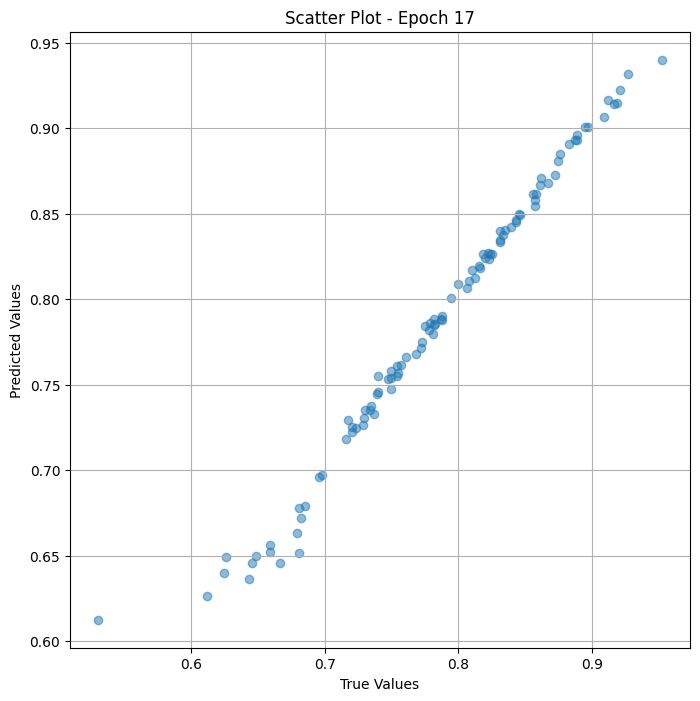

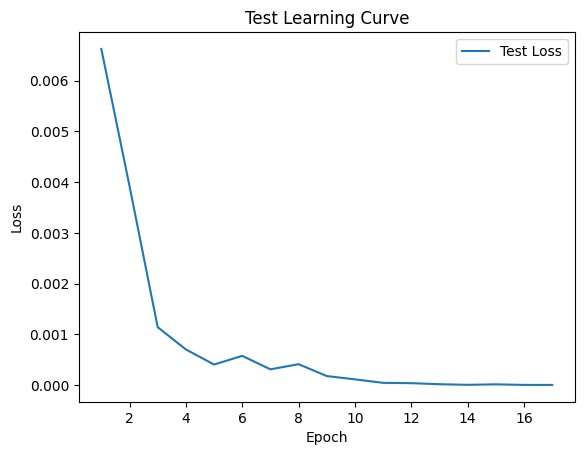


 Epoch: (18/30) Loss = 6.1141167861933354e-06

 Epoch: (18/30) Loss_rmse = 0.0024726740084588528

 Epoch: (18/30) R^2 = 0.999202311038971

 Epoch: (18/30) MAE = 0.0021345913410186768
Spearman correlation coefficient: SignificanceResult(statistic=0.998579040112975, pvalue=1.659868496152006e-121)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.7731958

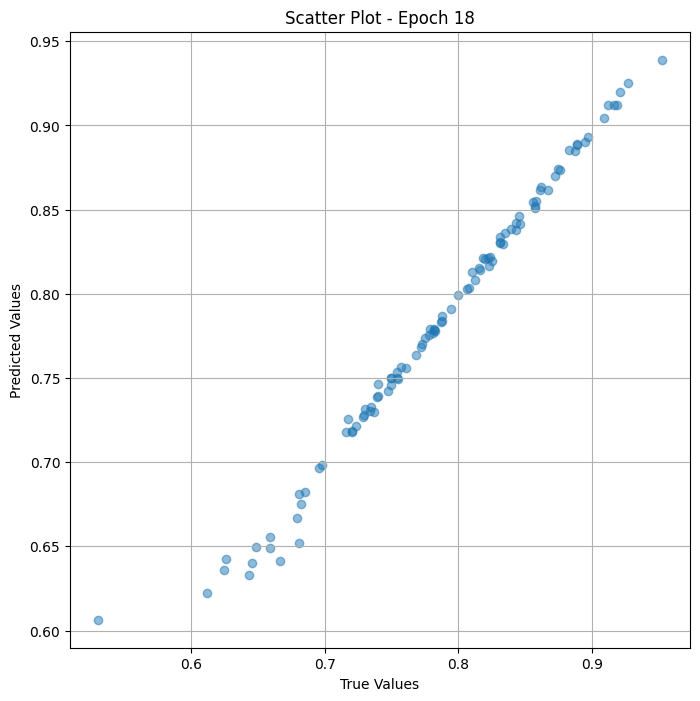

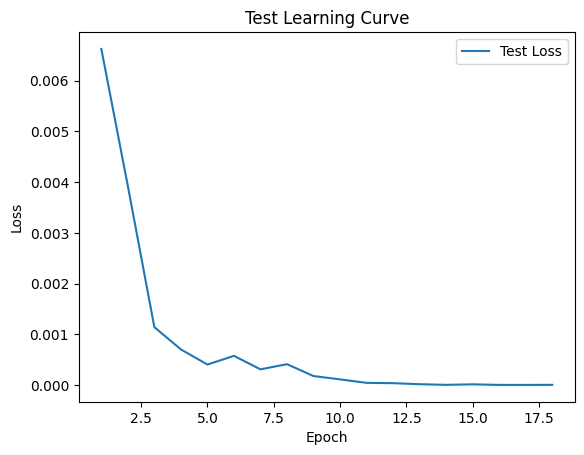


 Epoch: (19/30) Loss = 3.85988641937729e-06

 Epoch: (19/30) Loss_rmse = 0.0019646594300866127

 Epoch: (19/30) R^2 = 0.9994964003562927

 Epoch: (19/30) MAE = 0.001610398292541504
Spearman correlation coefficient: SignificanceResult(statistic=0.99856547485901, pvalue=2.593457672949944e-121)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586, 

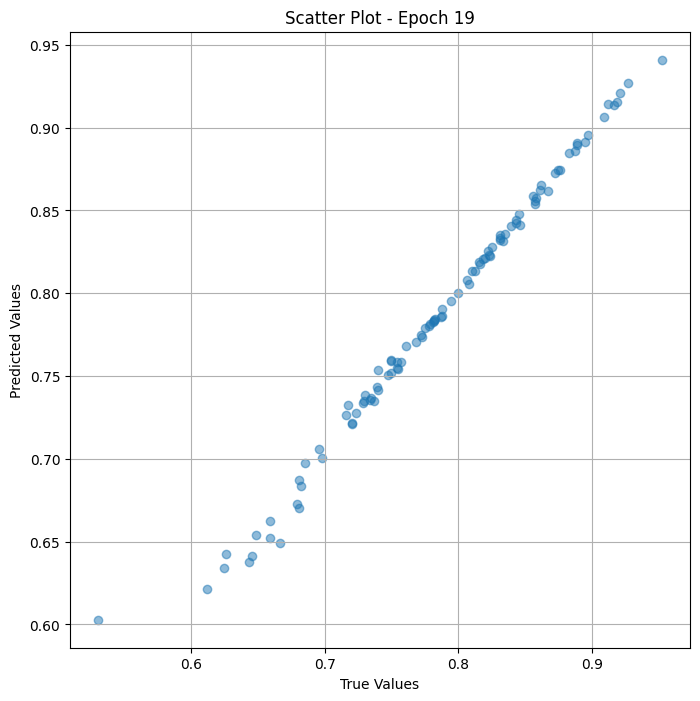

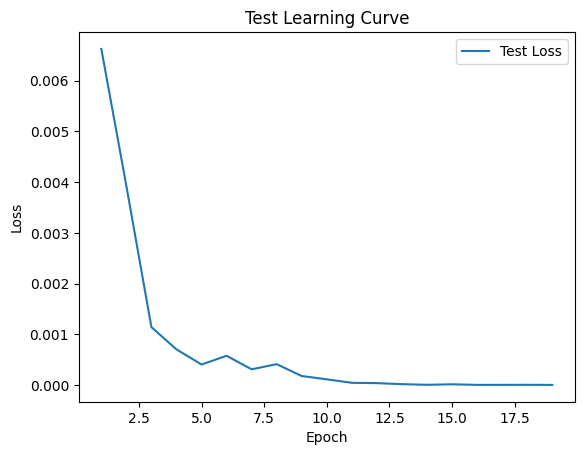


 Epoch: (20/30) Loss = 2.117559233738575e-06

 Epoch: (20/30) Loss_rmse = 0.001455183606594801

 Epoch: (20/30) R^2 = 0.9997237324714661

 Epoch: (20/30) MAE = 0.0011623799800872803
Spearman correlation coefficient: SignificanceResult(statistic=0.9992098244223394, pvalue=1.7697434800127793e-133)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.773195

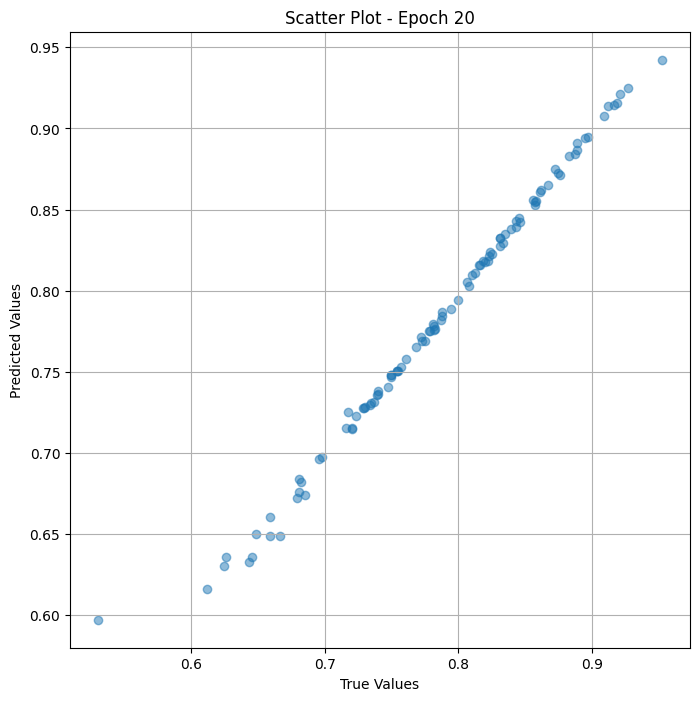

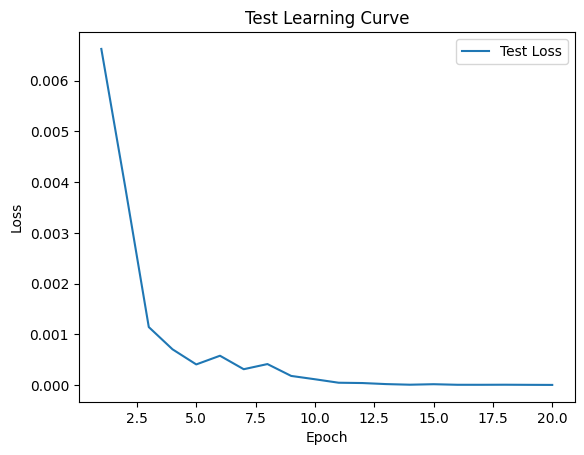


 Epoch: (21/30) Loss = 3.607526650739601e-06

 Epoch: (21/30) Loss_rmse = 0.0018993490375578403

 Epoch: (21/30) R^2 = 0.9995293021202087

 Epoch: (21/30) MAE = 0.0016386806964874268
Spearman correlation coefficient: SignificanceResult(statistic=0.9994607816206889, pvalue=2.8203083275040617e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319

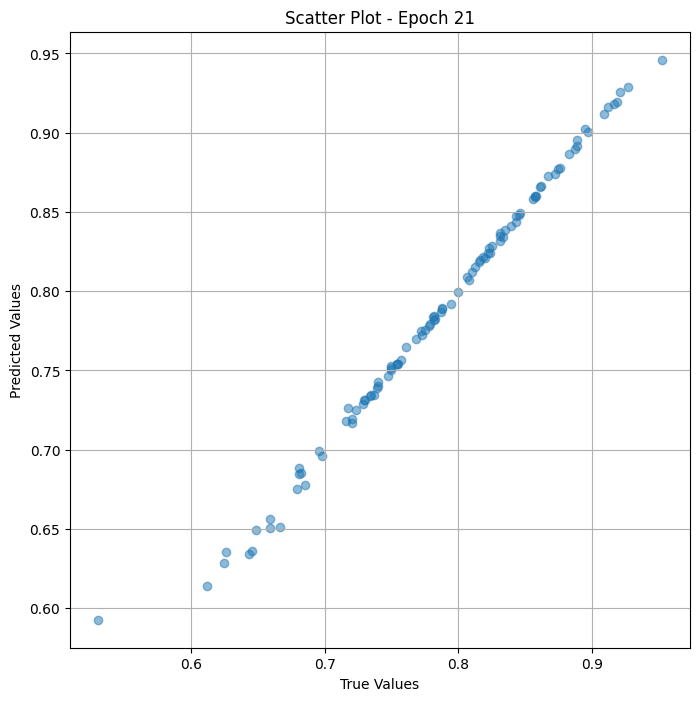

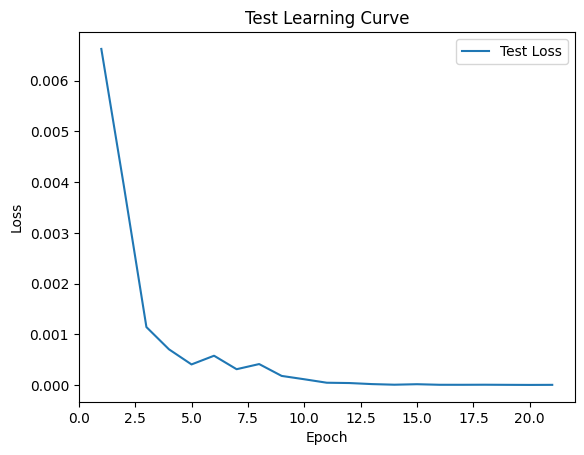


 Epoch: (22/30) Loss = 2.0234954718034714e-05

 Epoch: (22/30) Loss_rmse = 0.00449832808226347

 Epoch: (22/30) R^2 = 0.9973599910736084

 Epoch: (22/30) MAE = 0.003113359212875366
Spearman correlation coefficient: SignificanceResult(statistic=0.9996642604301613, pvalue=6.0459671668796196e-151)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.7731958

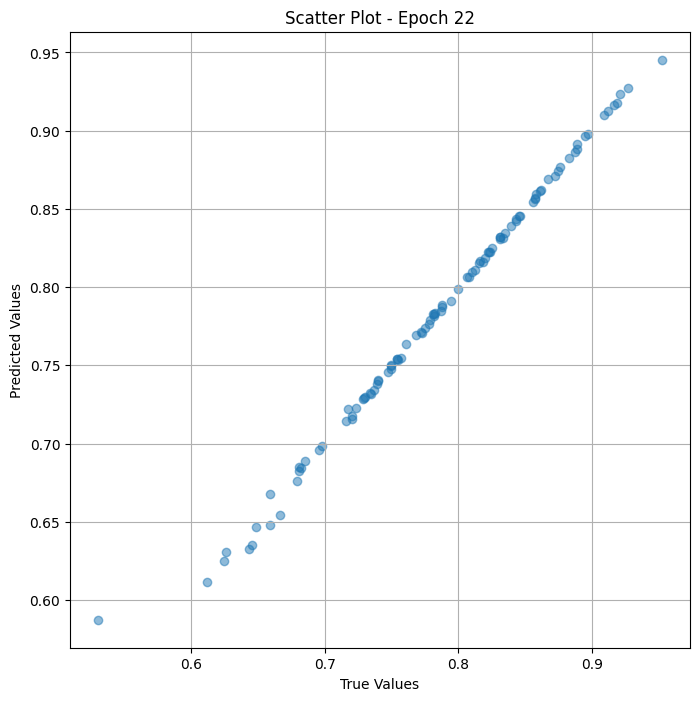

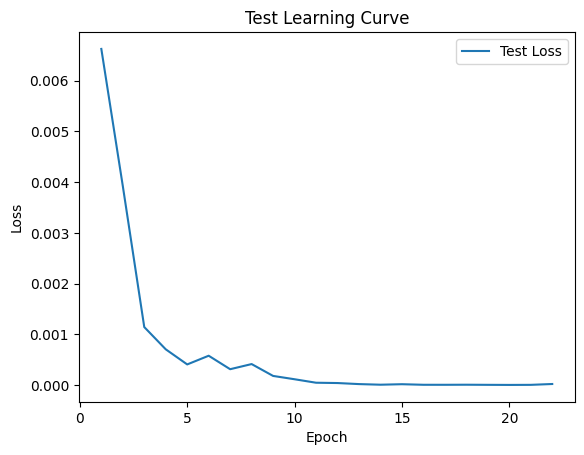

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (23/30) Loss = 1.2682065971603151e-05

 Epoch: (23/30) Loss_rmse = 0.00356118893250823

 Epoch: (23/30) R^2 = 0.9983453750610352

 Epoch: (23/30) MAE = 0.002351328730583191
Spearman correlation coefficient: SignificanceResult(statistic=0.9997253040730031, pvalue=4.852866765552048e-155)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291

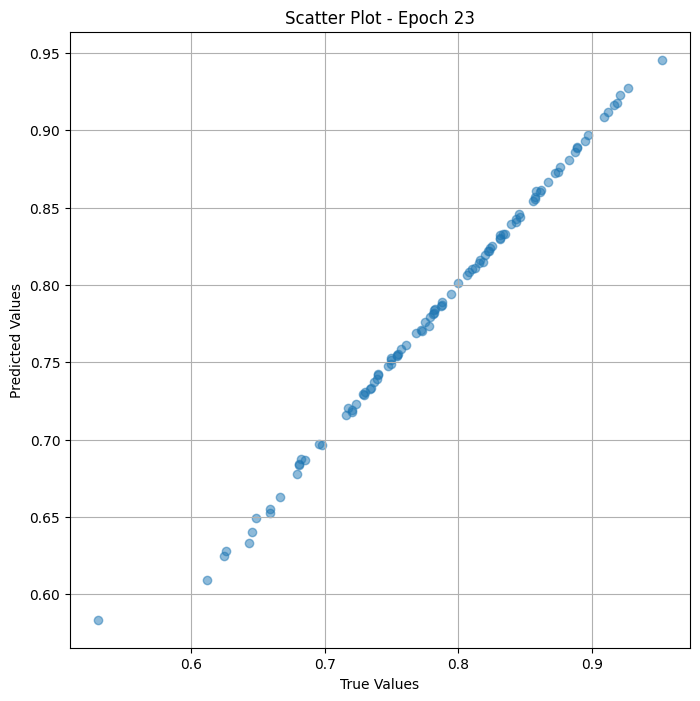

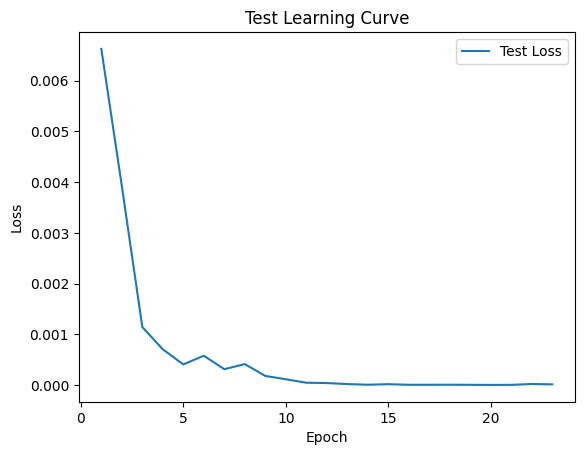


 Epoch: (24/30) Loss = 1.0678942089725751e-05

 Epoch: (24/30) Loss_rmse = 0.003267865162342787

 Epoch: (24/30) R^2 = 0.9986067414283752

 Epoch: (24/30) MAE = 0.002050653100013733
Spearman correlation coefficient: SignificanceResult(statistic=0.9997795650888623, pvalue=1.5654979221856352e-159)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.773195

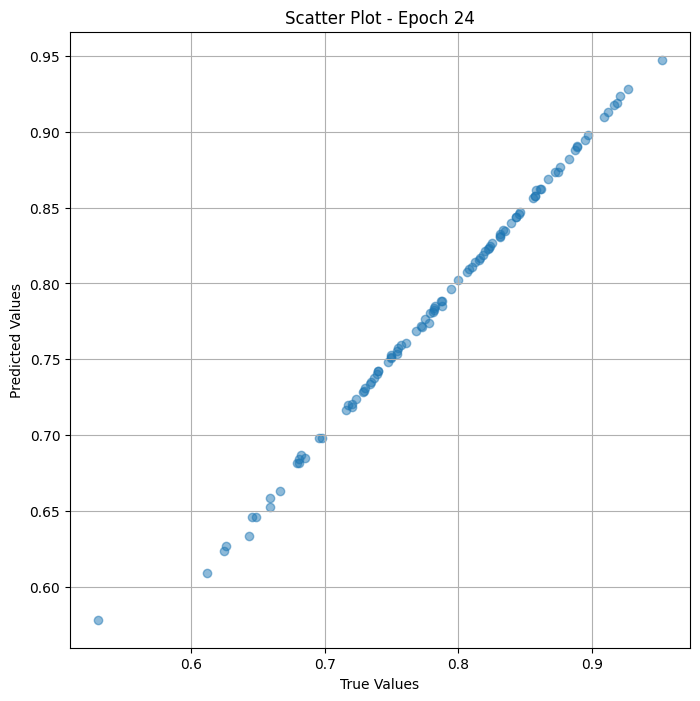

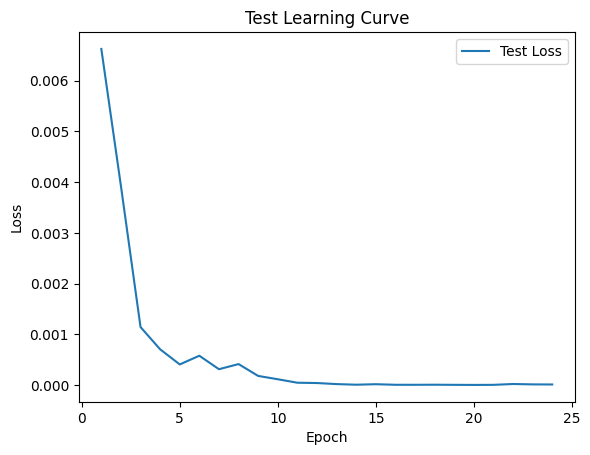


 Epoch: (25/30) Loss = 9.231262083631009e-06

 Epoch: (25/30) Loss_rmse = 0.0030382992699742317

 Epoch: (25/30) R^2 = 0.9987956285476685

 Epoch: (25/30) MAE = 0.0018432289361953735
Spearman correlation coefficient: SignificanceResult(statistic=0.999806695596792, pvalue=3.266647534543311e-162)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.7731958

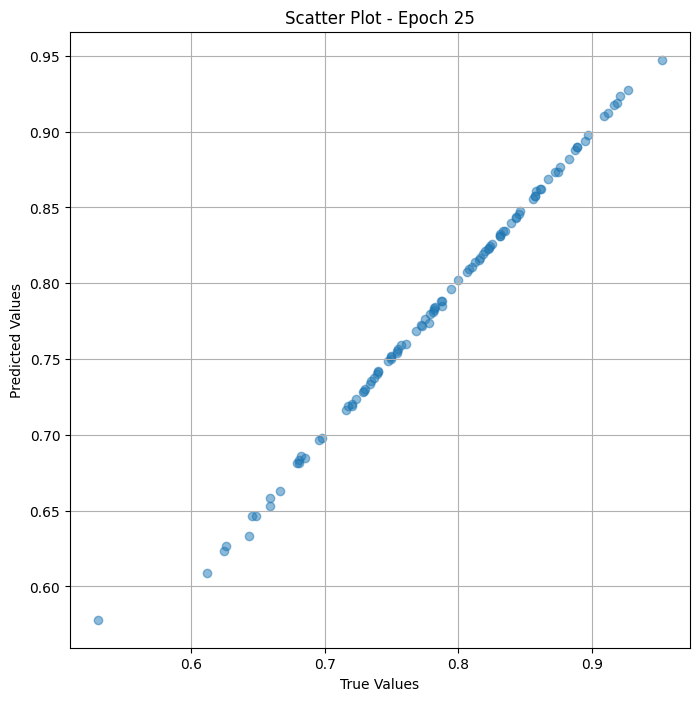

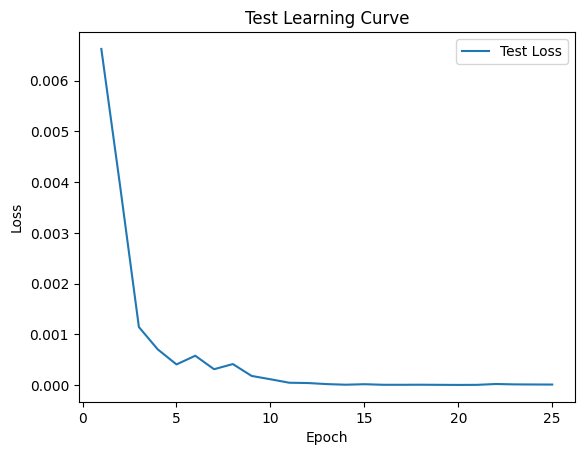

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (26/30) Loss = 7.041012395347934e-06

 Epoch: (26/30) Loss_rmse = 0.0026534905191510916

 Epoch: (26/30) R^2 = 0.9990813732147217

 Epoch: (26/30) MAE = 0.0015196502208709717
Spearman correlation coefficient: SignificanceResult(statistic=0.9998338261047217, pvalue=2.6758216882579277e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7

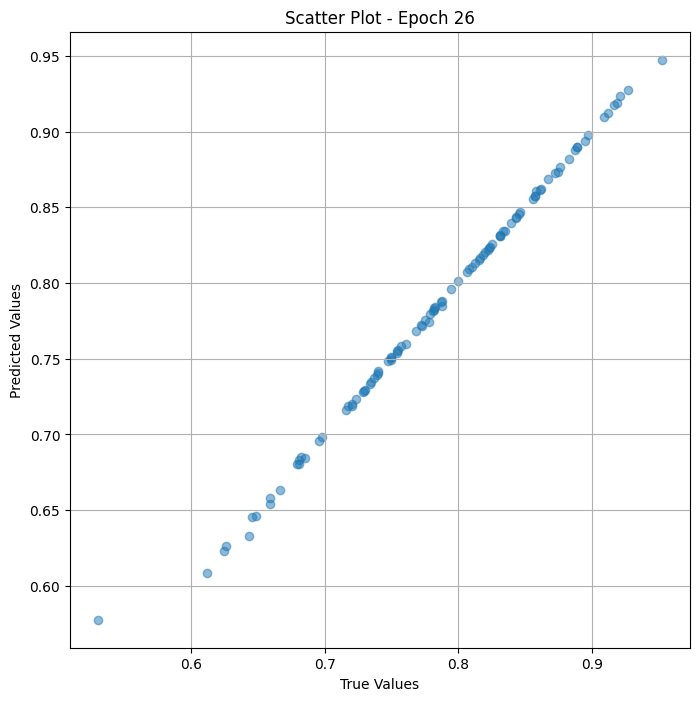

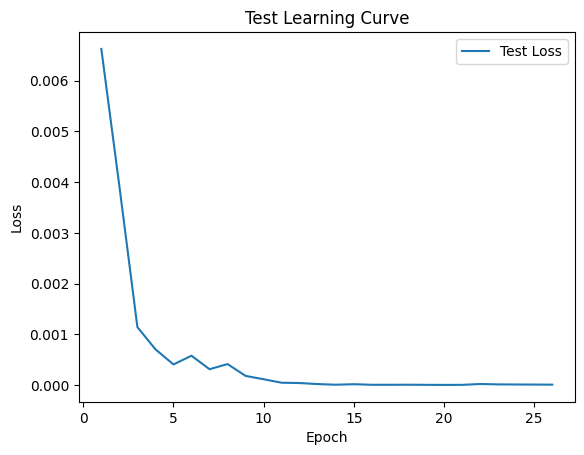


 Epoch: (27/30) Loss = 6.106412001827266e-06

 Epoch: (27/30) Loss_rmse = 0.0024711154401302338

 Epoch: (27/30) R^2 = 0.9992033243179321

 Epoch: (27/30) MAE = 0.0014126300811767578
Spearman correlation coefficient: SignificanceResult(statistic=0.9998338261047217, pvalue=2.6758216882579277e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319

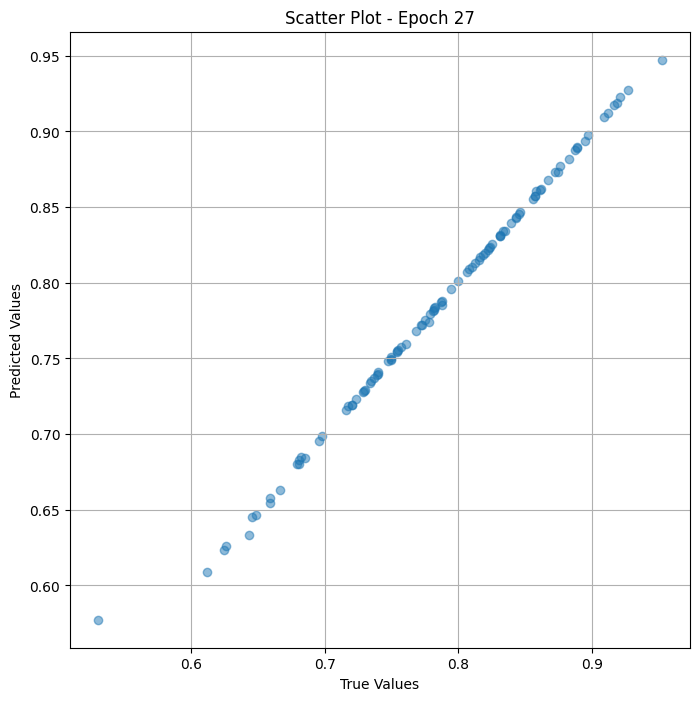

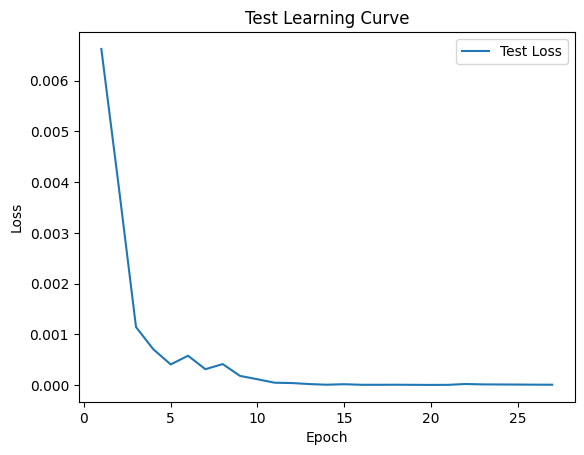


 Epoch: (28/30) Loss = 5.83533483222709e-06

 Epoch: (28/30) Loss_rmse = 0.002415643772110343

 Epoch: (28/30) R^2 = 0.9992386698722839

 Epoch: (28/30) MAE = 0.001388058066368103
Spearman correlation coefficient: SignificanceResult(statistic=0.9998338261047217, pvalue=2.6758216882579277e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.77319586

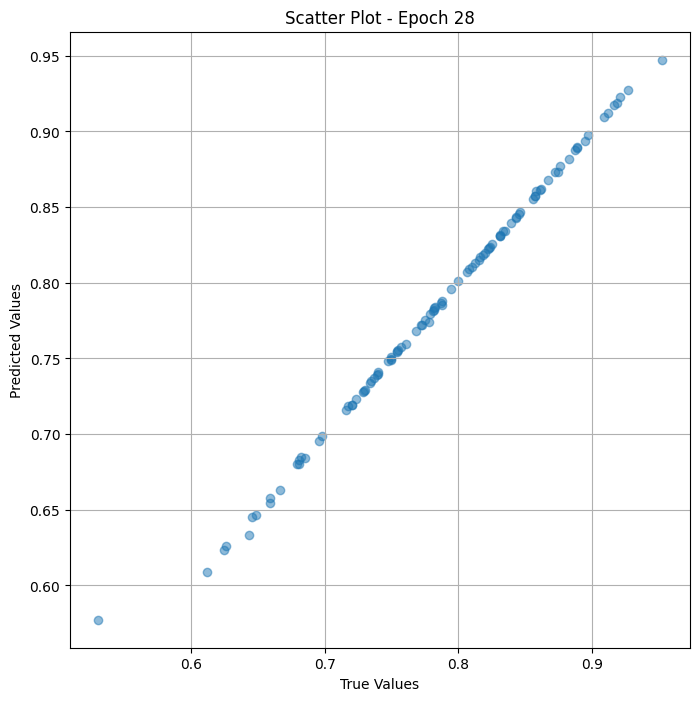

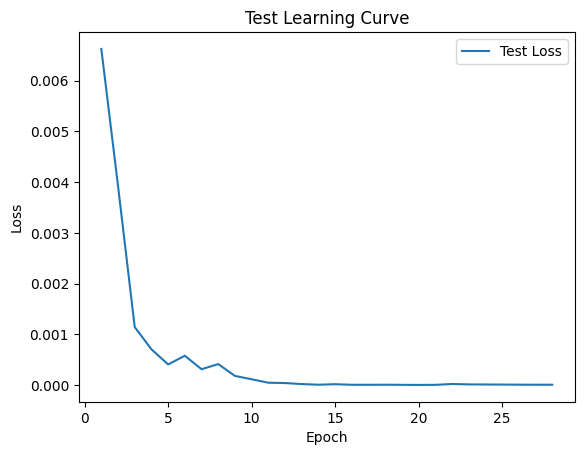

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (29/30) Loss = 5.5521622925880365e-06

 Epoch: (29/30) Loss_rmse = 0.0023563026916235685

 Epoch: (29/30) R^2 = 0.9992756247520447

 Epoch: (29/30) MAE = 0.0013663023710250854
Spearman correlation coefficient: SignificanceResult(statistic=0.9998338261047217, pvalue=2.6758216882579277e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.

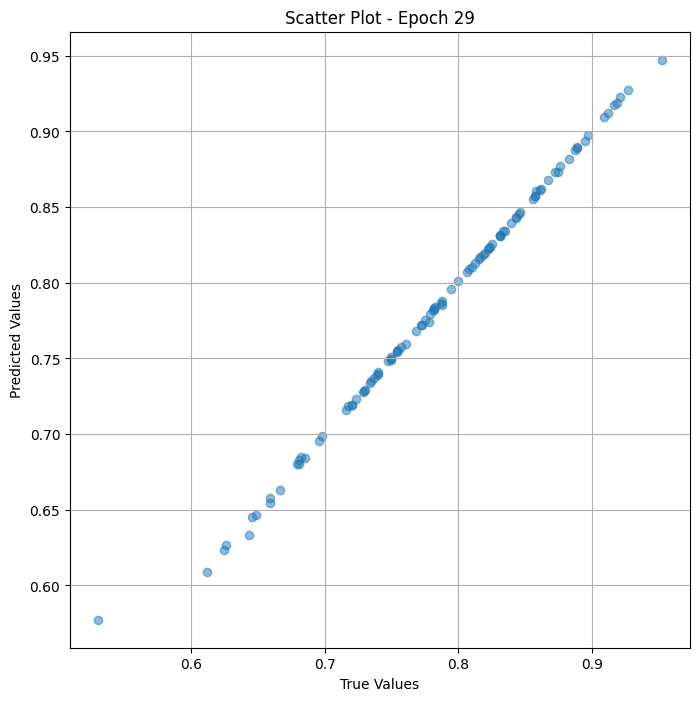

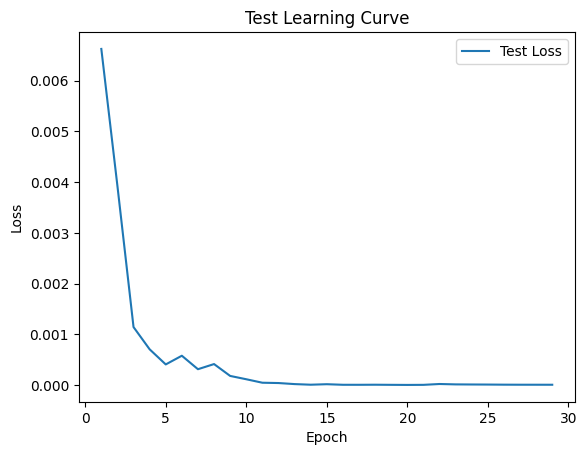


 Epoch: (30/30) Loss = 5.447373496281216e-06

 Epoch: (30/30) Loss_rmse = 0.002333960961550474

 Epoch: (30/30) R^2 = 0.9992892742156982

 Epoch: (30/30) MAE = 0.0013588368892669678
Spearman correlation coefficient: SignificanceResult(statistic=0.9998338261047217, pvalue=2.6758216882579277e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.72839504, 0.86734694, 0.83516484, 0.83928573, 0.8181818, 0.8125, 0.625, 0.8888889, 0.83157897, 0.75, 0.6486486, 0.7876106, 0.92134833, 0.6826923, 0.8453608, 0.78723407, 0.82, 0.84347826, 0.875, 0.7570093, 0.90909094, 0.8613861, 0.81, 0.6593407, 0.8313253, 0.95238096, 0.85714287, 0.9166667, 0.53061223, 0.84615386, 0.88297874, 0.6806723, 0.8229167, 0.8947368, 0.82258064, 0.6458333, 0.86206895, 0.67901236, 0.89719623, 0.75454545, 0.6262626, 0.75, 0.74725276, 0.7346939, 0.8165138, 0.6434783, 0.7755102, 0.7818182, 0.7685185, 0.78125, 0.7207207, 0.7291667, 0.71568626, 0.7818182, 0.72380954, 0.6960784, 0.773195

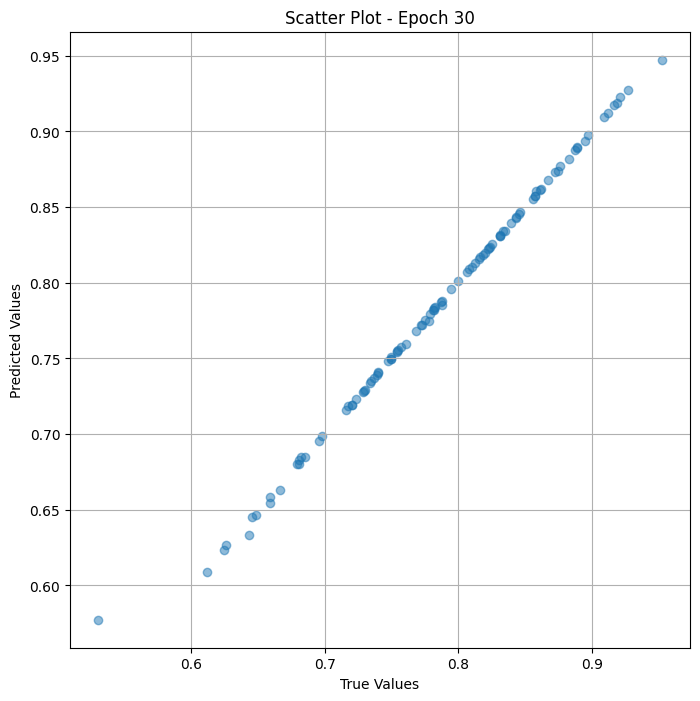

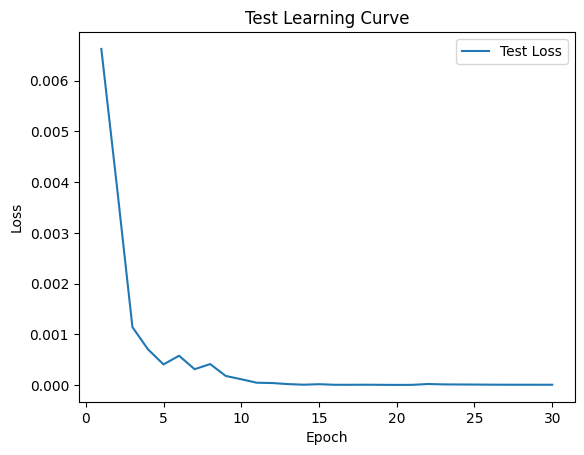

In [ ]:
# val the model and save weights
fit(30, model_vit_test , test_dl )
torch.save(model_vit_test.state_dict(), "model_weights_s")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds = model_vit_test(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_vehicle' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result_fine = pd.DataFrame({
    'Image Path': df_test_sports['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result_fine)

                                           Image Path  True Value  \
0       /content/sports/000000481014_preprocessed.jpg    0.728395   
1    /content/sports/n00470966_19377_preprocessed.jpg    0.867347   
2     /content/sports/n00445351_8665_preprocessed.jpg    0.835165   
3   /content/sports/a5f627b7166f2f0f_preprocessed.jpg    0.839286   
4   /content/sports/aacabf9b3fe435d3_preprocessed.jpg    0.818182   
..                                                ...         ...   
95  /content/sports/4c0275745141b853_preprocessed.jpg    0.680851   
96      /content/sports/000000421908_preprocessed.jpg    0.659341   
97  /content/sports/7aaf2ad4bd23d9a8_preprocessed.jpg    0.872727   
98   /content/sports/n00440941_10444_preprocessed.jpg    0.698113   
99  /content/sports/a6cff7d33b841d2f_preprocessed.jpg    0.823529   

    Predicted Value  
0          0.708055  
1          0.871131  
2          0.843431  
3          0.843496  
4          0.820528  
..              ...  
95         0.6773